In [1]:
from src.time_series_prep import *
import pandas as pd
from models.shared_layer import *
from torchviz import make_dot
from torchsummary import summary
from src.data_preprocessing import *
from src.visualizations import *
from src.global_configs import *
from src.time_series_prep import *
import logging

# Initialize logger
logging.basicConfig(
    filename='training.log',  # File where logs will be saved
    level=logging.INFO,  # Set logging level to INFO
    format='%(asctime)s - %(levelname)s - %(message)s',  # Log format
    # filemode='w'  # Overwrite log file on each run
)
logger = logging.getLogger()


In [2]:
# BATCH_SIZE = 64
# window_size = 6
# prediction_horizon = 6
# target_col = 'value'

# input_folder = 'data/ohio-data/processed'
# output_folder_train = 'data/ohio-data/processed/cleaned'  # Create a subfolder for processed files
# output_folder_test = 'data/ohio-data/processed/cleaned_test'
scaler = process_all_csv_files(input_folder, output_folder_train, timestamp_col='ts', freq='5min', agg_func='mean')

In [3]:
model_type = 'shared-layer'
patients_list = ['559', '563', '570', '575', '588', '591', '540', '544', '552', '567', '584', '596']

# train_loader, validation_loader, all_train_loader, test_loader, input_shape, input_shape_test, output_shape, output_shape_test =  prepare_data_loader(
#                                                                                     window_size,BATCH_SIZE, prediction_horizon,
#                                                                                     model_type, split_ratio = 0.7, df = None, df_test = None, output_folder_train=output_folder_train, shuffle = True)


In [4]:
# prediction_horizons = [15,30,60,90,120,150,180]
prediction_horizons = [3, 6, 12, 18, 24, 30, 36]
# prediction_horizons = [6]

histories_withval_PHs =  {key: [] for key in prediction_horizons}
histories_noval_PHs = {key: [] for key in prediction_horizons}
abs_patients_errors_PHs =  {key: [] for key in prediction_horizons}
squared_patients_errors_PHs =  {key: [] for key in prediction_horizons}

MAE_Patients_PHs =  {key: [] for key in prediction_horizons}
RMSE_Patients_PHs =  {key: [] for key in prediction_horizons}


In [5]:
# BATCH_SIZE = 64

In [6]:
# train_loader, validation_loader, all_train_loader, test_loader, input_shape, input_shape_test, output_shape, output_shape_test =  prepare_data_loader(
#                                                                                     window_size,BATCH_SIZE, prediction_horizon,
#                                                                                     model_type, split_ratio = 0.7, df = None, df_test = None, output_folder_train=output_folder_train, shuffle = True)
    

In [7]:
for prediction_horizon in prediction_horizons:
    logger.info(f"Start Prediction Horizon {prediction_horizon} of {model_type} model")
    print(f"Start Prediction Horizon {prediction_horizon} of {model_type} model")
   
    train_loader, validation_loader, all_train_loader, test_loader, input_shape, input_shape_test, output_shape, output_shape_test =  prepare_data_loader(
                                                                                    window_size,BATCH_SIZE, prediction_horizon,
                                                                                    model_type, split_ratio = 0.7, df = None, df_test = None, output_folder_train=output_folder_train, shuffle = True)
    
    # model = SharedLayerModel(input_shape =input_shape , output_shape=output_shape) 
    # model = model.to(device)
    # model, history = train_model(model, train_loader, val_loader = validation_loader, epochs=100, learning_rate=0.00001, model_type = model_type)
    # histories_withval_PHs[prediction_horizon] = history

    model_all_train = SharedLayerModel(input_shape =input_shape , output_shape=output_shape) 
    model_all_train = model_all_train.to(device)
    model_all_train, history2 = train_model(model_all_train, all_train_loader, val_loader = test_loader, epochs=200, learning_rate=0.00001, model_type = model_type)
    histories_noval_PHs[prediction_horizon] = history2


    model_all_train.eval()
    each_patient_mae, each_patient_rmse= evaluate_test(model_all_train,test_loader, device ,scaler, mask_value, model_type = model_type)


    # logger.info(f"Average MAE of Prediction Horizon {str(prediction_horizon)}: {mae}")
    # logger.info(f"Average RMSE of Prediction Horizon {str(prediction_horizon)}: {rmse}")
    # print(f"Average MAE of Prediction Horizon {str(prediction_horizon)}: {mae}")
    # print(f"Average RMSE of Prediction Horizon {str(prediction_horizon)}: {rmse}")

    
    abs_patients_errors_PHs[prediction_horizon] = each_patient_mae
    squared_patients_errors_PHs[prediction_horizon] = each_patient_rmse
    # MAE_Patients_PHs[prediction_horizon] = mae
    # RMSE_Patients_PHs[prediction_horizon] = rmse


    logger.info(f"End Prediction Horizon of {prediction_horizon} of {model_type} Model")
    print(f"End Prediction Horizon of {prediction_horizon} of {model_type} Model")
    torch.save(model_all_train.state_dict(), f'saved_models//model_{model_type}_{str(prediction_horizon)}.pth')
    print(f"model_{model_type}_{str(prediction_horizon)} saved")
    logger.info(f"model_{model_type}_{str(prediction_horizon)} saved")


Start Prediction Horizon 3 of shared-layer model
Shape of X (features): (12, 13621, 6)
Shape of y (targets): (12, 13621)
Shape of X_test (features): (12, 3942, 6)
Shape of y_test (targets): (12, 3942)


Epoch 1/200: 100%|██████████| 213/213 [00:23<00:00,  9.23batch/s, mae_loss=0.633]


Epoch [1/200], Training MAE: 0.6597, Training RMSE: 0.9027
Epoch [1/200], Validation MAE: 0.5337, Validation RMSE: 0.8078


Epoch 2/200: 100%|██████████| 213/213 [00:21<00:00,  9.95batch/s, mae_loss=0.692]


Epoch [2/200], Training MAE: 0.6488, Training RMSE: 0.8894
Epoch [2/200], Validation MAE: 0.5248, Validation RMSE: 0.7951


Epoch 3/200: 100%|██████████| 213/213 [00:27<00:00,  7.62batch/s, mae_loss=0.659]


Epoch [3/200], Training MAE: 0.6365, Training RMSE: 0.8737
Epoch [3/200], Validation MAE: 0.5149, Validation RMSE: 0.7801


Epoch 4/200: 100%|██████████| 213/213 [00:26<00:00,  8.15batch/s, mae_loss=0.626]


Epoch [4/200], Training MAE: 0.6213, Training RMSE: 0.8540
Epoch [4/200], Validation MAE: 0.5016, Validation RMSE: 0.7603


Epoch 5/200: 100%|██████████| 213/213 [00:23<00:00,  8.94batch/s, mae_loss=0.556]


Epoch [5/200], Training MAE: 0.6015, Training RMSE: 0.8283
Epoch [5/200], Validation MAE: 0.4840, Validation RMSE: 0.7352


Epoch 6/200: 100%|██████████| 213/213 [00:22<00:00,  9.29batch/s, mae_loss=0.588]


Epoch [6/200], Training MAE: 0.5759, Training RMSE: 0.7954
Epoch [6/200], Validation MAE: 0.4616, Validation RMSE: 0.7028


Epoch 7/200: 100%|██████████| 213/213 [00:16<00:00, 12.68batch/s, mae_loss=0.508]


Epoch [7/200], Training MAE: 0.5435, Training RMSE: 0.7537
Epoch [7/200], Validation MAE: 0.4328, Validation RMSE: 0.6615


Epoch 8/200: 100%|██████████| 213/213 [00:18<00:00, 11.41batch/s, mae_loss=0.446]


Epoch [8/200], Training MAE: 0.5042, Training RMSE: 0.7032
Epoch [8/200], Validation MAE: 0.3998, Validation RMSE: 0.6131


Epoch 9/200: 100%|██████████| 213/213 [00:20<00:00, 10.27batch/s, mae_loss=0.473]


Epoch [9/200], Training MAE: 0.4602, Training RMSE: 0.6464
Epoch [9/200], Validation MAE: 0.3636, Validation RMSE: 0.5587


Epoch 10/200: 100%|██████████| 213/213 [00:22<00:00,  9.56batch/s, mae_loss=0.403]


Epoch [10/200], Training MAE: 0.4139, Training RMSE: 0.5862
Epoch [10/200], Validation MAE: 0.3256, Validation RMSE: 0.5018


Epoch 11/200: 100%|██████████| 213/213 [00:22<00:00,  9.65batch/s, mae_loss=0.346]


Epoch [11/200], Training MAE: 0.3703, Training RMSE: 0.5282
Epoch [11/200], Validation MAE: 0.2905, Validation RMSE: 0.4483


Epoch 12/200: 100%|██████████| 213/213 [00:23<00:00,  9.19batch/s, mae_loss=0.322]


Epoch [12/200], Training MAE: 0.3339, Training RMSE: 0.4790
Epoch [12/200], Validation MAE: 0.2614, Validation RMSE: 0.4034


Epoch 13/200: 100%|██████████| 213/213 [00:22<00:00,  9.31batch/s, mae_loss=0.274]


Epoch [13/200], Training MAE: 0.3076, Training RMSE: 0.4425
Epoch [13/200], Validation MAE: 0.2398, Validation RMSE: 0.3709


Epoch 14/200: 100%|██████████| 213/213 [00:23<00:00,  8.91batch/s, mae_loss=0.288]


Epoch [14/200], Training MAE: 0.2909, Training RMSE: 0.4184
Epoch [14/200], Validation MAE: 0.2250, Validation RMSE: 0.3490


Epoch 15/200: 100%|██████████| 213/213 [00:23<00:00,  8.94batch/s, mae_loss=0.264]


Epoch [15/200], Training MAE: 0.2808, Training RMSE: 0.4039
Epoch [15/200], Validation MAE: 0.2154, Validation RMSE: 0.3350


Epoch 16/200: 100%|██████████| 213/213 [00:23<00:00,  8.90batch/s, mae_loss=0.272]


Epoch [16/200], Training MAE: 0.2737, Training RMSE: 0.3943
Epoch [16/200], Validation MAE: 0.2093, Validation RMSE: 0.3264


Epoch 17/200: 100%|██████████| 213/213 [00:20<00:00, 10.47batch/s, mae_loss=0.262]


Epoch [17/200], Training MAE: 0.2692, Training RMSE: 0.3877
Epoch [17/200], Validation MAE: 0.2044, Validation RMSE: 0.3198


Epoch 18/200: 100%|██████████| 213/213 [00:19<00:00, 11.21batch/s, mae_loss=0.258]


Epoch [18/200], Training MAE: 0.2649, Training RMSE: 0.3823
Epoch [18/200], Validation MAE: 0.2003, Validation RMSE: 0.3148


Epoch 19/200: 100%|██████████| 213/213 [00:17<00:00, 12.11batch/s, mae_loss=0.244]


Epoch [19/200], Training MAE: 0.2615, Training RMSE: 0.3776
Epoch [19/200], Validation MAE: 0.1973, Validation RMSE: 0.3104


Epoch 20/200: 100%|██████████| 213/213 [00:18<00:00, 11.32batch/s, mae_loss=0.256]


Epoch [20/200], Training MAE: 0.2576, Training RMSE: 0.3723
Epoch [20/200], Validation MAE: 0.1931, Validation RMSE: 0.3059


Epoch 21/200: 100%|██████████| 213/213 [00:18<00:00, 11.24batch/s, mae_loss=0.263]


Epoch [21/200], Training MAE: 0.2544, Training RMSE: 0.3683
Epoch [21/200], Validation MAE: 0.1901, Validation RMSE: 0.3019


Epoch 22/200: 100%|██████████| 213/213 [00:18<00:00, 11.63batch/s, mae_loss=0.252]


Epoch [22/200], Training MAE: 0.2513, Training RMSE: 0.3644
Epoch [22/200], Validation MAE: 0.1867, Validation RMSE: 0.2982


Epoch 23/200: 100%|██████████| 213/213 [00:19<00:00, 11.13batch/s, mae_loss=0.254]


Epoch [23/200], Training MAE: 0.2483, Training RMSE: 0.3606
Epoch [23/200], Validation MAE: 0.1840, Validation RMSE: 0.2944


Epoch 24/200: 100%|██████████| 213/213 [00:17<00:00, 12.13batch/s, mae_loss=0.248]


Epoch [24/200], Training MAE: 0.2447, Training RMSE: 0.3563
Epoch [24/200], Validation MAE: 0.1812, Validation RMSE: 0.2906


Epoch 25/200: 100%|██████████| 213/213 [00:22<00:00,  9.61batch/s, mae_loss=0.234]


Epoch [25/200], Training MAE: 0.2416, Training RMSE: 0.3526
Epoch [25/200], Validation MAE: 0.1785, Validation RMSE: 0.2869


Epoch 26/200: 100%|██████████| 213/213 [00:21<00:00, 10.06batch/s, mae_loss=0.243]


Epoch [26/200], Training MAE: 0.2385, Training RMSE: 0.3487
Epoch [26/200], Validation MAE: 0.1756, Validation RMSE: 0.2831


Epoch 27/200: 100%|██████████| 213/213 [00:21<00:00, 10.07batch/s, mae_loss=0.222]


Epoch [27/200], Training MAE: 0.2353, Training RMSE: 0.3447
Epoch [27/200], Validation MAE: 0.1727, Validation RMSE: 0.2795


Epoch 28/200: 100%|██████████| 213/213 [00:20<00:00, 10.42batch/s, mae_loss=0.229]


Epoch [28/200], Training MAE: 0.2322, Training RMSE: 0.3403
Epoch [28/200], Validation MAE: 0.1700, Validation RMSE: 0.2759


Epoch 29/200: 100%|██████████| 213/213 [00:20<00:00, 10.43batch/s, mae_loss=0.225]


Epoch [29/200], Training MAE: 0.2296, Training RMSE: 0.3373
Epoch [29/200], Validation MAE: 0.1673, Validation RMSE: 0.2724


Epoch 30/200: 100%|██████████| 213/213 [00:20<00:00, 10.59batch/s, mae_loss=0.212]


Epoch [30/200], Training MAE: 0.2263, Training RMSE: 0.3332
Epoch [30/200], Validation MAE: 0.1644, Validation RMSE: 0.2686


Epoch 31/200: 100%|██████████| 213/213 [00:20<00:00, 10.32batch/s, mae_loss=0.219]


Epoch [31/200], Training MAE: 0.2232, Training RMSE: 0.3300
Epoch [31/200], Validation MAE: 0.1619, Validation RMSE: 0.2651


Epoch 32/200: 100%|██████████| 213/213 [00:21<00:00,  9.97batch/s, mae_loss=0.218]


Epoch [32/200], Training MAE: 0.2194, Training RMSE: 0.3249
Epoch [32/200], Validation MAE: 0.1592, Validation RMSE: 0.2617


Epoch 33/200: 100%|██████████| 213/213 [00:20<00:00, 10.46batch/s, mae_loss=0.21] 


Epoch [33/200], Training MAE: 0.2168, Training RMSE: 0.3218
Epoch [33/200], Validation MAE: 0.1566, Validation RMSE: 0.2583


Epoch 34/200: 100%|██████████| 213/213 [00:20<00:00, 10.19batch/s, mae_loss=0.209]


Epoch [34/200], Training MAE: 0.2143, Training RMSE: 0.3185
Epoch [34/200], Validation MAE: 0.1540, Validation RMSE: 0.2550


Epoch 35/200: 100%|██████████| 213/213 [00:21<00:00, 10.10batch/s, mae_loss=0.204]


Epoch [35/200], Training MAE: 0.2108, Training RMSE: 0.3147
Epoch [35/200], Validation MAE: 0.1515, Validation RMSE: 0.2518


Epoch 36/200: 100%|██████████| 213/213 [00:20<00:00, 10.37batch/s, mae_loss=0.206]


Epoch [36/200], Training MAE: 0.2081, Training RMSE: 0.3111
Epoch [36/200], Validation MAE: 0.1490, Validation RMSE: 0.2488


Epoch 37/200: 100%|██████████| 213/213 [00:21<00:00,  9.80batch/s, mae_loss=0.205]


Epoch [37/200], Training MAE: 0.2049, Training RMSE: 0.3075
Epoch [37/200], Validation MAE: 0.1462, Validation RMSE: 0.2458


Epoch 38/200: 100%|██████████| 213/213 [00:20<00:00, 10.33batch/s, mae_loss=0.201]


Epoch [38/200], Training MAE: 0.2026, Training RMSE: 0.3048
Epoch [38/200], Validation MAE: 0.1442, Validation RMSE: 0.2432


Epoch 39/200: 100%|██████████| 213/213 [00:20<00:00, 10.28batch/s, mae_loss=0.202]


Epoch [39/200], Training MAE: 0.2004, Training RMSE: 0.3023
Epoch [39/200], Validation MAE: 0.1421, Validation RMSE: 0.2407


Epoch 40/200: 100%|██████████| 213/213 [00:20<00:00, 10.14batch/s, mae_loss=0.199]


Epoch [40/200], Training MAE: 0.1977, Training RMSE: 0.2993
Epoch [40/200], Validation MAE: 0.1402, Validation RMSE: 0.2379


Epoch 41/200: 100%|██████████| 213/213 [00:20<00:00, 10.35batch/s, mae_loss=0.191]


Epoch [41/200], Training MAE: 0.1959, Training RMSE: 0.2972
Epoch [41/200], Validation MAE: 0.1383, Validation RMSE: 0.2360


Epoch 42/200: 100%|██████████| 213/213 [00:21<00:00, 10.01batch/s, mae_loss=0.191]


Epoch [42/200], Training MAE: 0.1939, Training RMSE: 0.2950
Epoch [42/200], Validation MAE: 0.1360, Validation RMSE: 0.2336


Epoch 43/200: 100%|██████████| 213/213 [00:20<00:00, 10.30batch/s, mae_loss=0.19] 


Epoch [43/200], Training MAE: 0.1916, Training RMSE: 0.2932
Epoch [43/200], Validation MAE: 0.1346, Validation RMSE: 0.2320


Epoch 44/200: 100%|██████████| 213/213 [00:20<00:00, 10.36batch/s, mae_loss=0.184]


Epoch [44/200], Training MAE: 0.1892, Training RMSE: 0.2898
Epoch [44/200], Validation MAE: 0.1328, Validation RMSE: 0.2297


Epoch 45/200: 100%|██████████| 213/213 [00:21<00:00,  9.95batch/s, mae_loss=0.175]


Epoch [45/200], Training MAE: 0.1879, Training RMSE: 0.2886
Epoch [45/200], Validation MAE: 0.1312, Validation RMSE: 0.2281


Epoch 46/200: 100%|██████████| 213/213 [00:20<00:00, 10.47batch/s, mae_loss=0.184]


Epoch [46/200], Training MAE: 0.1859, Training RMSE: 0.2865
Epoch [46/200], Validation MAE: 0.1295, Validation RMSE: 0.2265


Epoch 47/200: 100%|██████████| 213/213 [00:20<00:00, 10.24batch/s, mae_loss=0.208]


Epoch [47/200], Training MAE: 0.1846, Training RMSE: 0.2859
Epoch [47/200], Validation MAE: 0.1285, Validation RMSE: 0.2252


Epoch 48/200: 100%|██████████| 213/213 [00:21<00:00, 10.09batch/s, mae_loss=0.193]


Epoch [48/200], Training MAE: 0.1841, Training RMSE: 0.2847
Epoch [48/200], Validation MAE: 0.1271, Validation RMSE: 0.2237


Epoch 49/200: 100%|██████████| 213/213 [00:20<00:00, 10.51batch/s, mae_loss=0.194]


Epoch [49/200], Training MAE: 0.1821, Training RMSE: 0.2826
Epoch [49/200], Validation MAE: 0.1261, Validation RMSE: 0.2227


Epoch 50/200: 100%|██████████| 213/213 [00:21<00:00, 10.02batch/s, mae_loss=0.172]


Epoch [50/200], Training MAE: 0.1809, Training RMSE: 0.2815
Epoch [50/200], Validation MAE: 0.1250, Validation RMSE: 0.2213


Epoch 51/200: 100%|██████████| 213/213 [00:20<00:00, 10.33batch/s, mae_loss=0.163]


Epoch [51/200], Training MAE: 0.1800, Training RMSE: 0.2810
Epoch [51/200], Validation MAE: 0.1241, Validation RMSE: 0.2207


Epoch 52/200: 100%|██████████| 213/213 [00:20<00:00, 10.53batch/s, mae_loss=0.161]


Epoch [52/200], Training MAE: 0.1785, Training RMSE: 0.2793
Epoch [52/200], Validation MAE: 0.1230, Validation RMSE: 0.2195


Epoch 53/200: 100%|██████████| 213/213 [00:21<00:00, 10.14batch/s, mae_loss=0.159]


Epoch [53/200], Training MAE: 0.1781, Training RMSE: 0.2789
Epoch [53/200], Validation MAE: 0.1220, Validation RMSE: 0.2186


Epoch 54/200: 100%|██████████| 213/213 [00:20<00:00, 10.51batch/s, mae_loss=0.183]


Epoch [54/200], Training MAE: 0.1771, Training RMSE: 0.2777
Epoch [54/200], Validation MAE: 0.1212, Validation RMSE: 0.2179


Epoch 55/200: 100%|██████████| 213/213 [00:20<00:00, 10.47batch/s, mae_loss=0.174]


Epoch [55/200], Training MAE: 0.1759, Training RMSE: 0.2768
Epoch [55/200], Validation MAE: 0.1207, Validation RMSE: 0.2173


Epoch 56/200: 100%|██████████| 213/213 [00:21<00:00,  9.94batch/s, mae_loss=0.176]


Epoch [56/200], Training MAE: 0.1755, Training RMSE: 0.2766
Epoch [56/200], Validation MAE: 0.1203, Validation RMSE: 0.2166


Epoch 57/200: 100%|██████████| 213/213 [00:20<00:00, 10.26batch/s, mae_loss=0.16] 


Epoch [57/200], Training MAE: 0.1747, Training RMSE: 0.2758
Epoch [57/200], Validation MAE: 0.1195, Validation RMSE: 0.2158


Epoch 58/200: 100%|██████████| 213/213 [00:20<00:00, 10.40batch/s, mae_loss=0.176]


Epoch [58/200], Training MAE: 0.1736, Training RMSE: 0.2749
Epoch [58/200], Validation MAE: 0.1187, Validation RMSE: 0.2151


Epoch 59/200: 100%|██████████| 213/213 [00:20<00:00, 10.26batch/s, mae_loss=0.183]


Epoch [59/200], Training MAE: 0.1732, Training RMSE: 0.2746
Epoch [59/200], Validation MAE: 0.1183, Validation RMSE: 0.2148


Epoch 60/200: 100%|██████████| 213/213 [00:20<00:00, 10.17batch/s, mae_loss=0.163]


Epoch [60/200], Training MAE: 0.1722, Training RMSE: 0.2733
Epoch [60/200], Validation MAE: 0.1174, Validation RMSE: 0.2141


Epoch 61/200: 100%|██████████| 213/213 [00:21<00:00,  9.87batch/s, mae_loss=0.17] 


Epoch [61/200], Training MAE: 0.1721, Training RMSE: 0.2735
Epoch [61/200], Validation MAE: 0.1169, Validation RMSE: 0.2135


Epoch 62/200: 100%|██████████| 213/213 [00:21<00:00, 10.14batch/s, mae_loss=0.177]


Epoch [62/200], Training MAE: 0.1712, Training RMSE: 0.2732
Epoch [62/200], Validation MAE: 0.1168, Validation RMSE: 0.2134


Epoch 63/200: 100%|██████████| 213/213 [00:20<00:00, 10.19batch/s, mae_loss=0.174]


Epoch [63/200], Training MAE: 0.1711, Training RMSE: 0.2727
Epoch [63/200], Validation MAE: 0.1166, Validation RMSE: 0.2134


Epoch 64/200: 100%|██████████| 213/213 [00:21<00:00, 10.01batch/s, mae_loss=0.157]


Epoch [64/200], Training MAE: 0.1701, Training RMSE: 0.2717
Epoch [64/200], Validation MAE: 0.1159, Validation RMSE: 0.2127


Epoch 65/200: 100%|██████████| 213/213 [00:20<00:00, 10.46batch/s, mae_loss=0.157]


Epoch [65/200], Training MAE: 0.1701, Training RMSE: 0.2720
Epoch [65/200], Validation MAE: 0.1156, Validation RMSE: 0.2125


Epoch 66/200: 100%|██████████| 213/213 [00:20<00:00, 10.35batch/s, mae_loss=0.167]


Epoch [66/200], Training MAE: 0.1695, Training RMSE: 0.2713
Epoch [66/200], Validation MAE: 0.1152, Validation RMSE: 0.2120


Epoch 67/200: 100%|██████████| 213/213 [00:21<00:00,  9.95batch/s, mae_loss=0.162]


Epoch [67/200], Training MAE: 0.1691, Training RMSE: 0.2712
Epoch [67/200], Validation MAE: 0.1150, Validation RMSE: 0.2121


Epoch 68/200: 100%|██████████| 213/213 [00:20<00:00, 10.37batch/s, mae_loss=0.169]


Epoch [68/200], Training MAE: 0.1687, Training RMSE: 0.2706
Epoch [68/200], Validation MAE: 0.1146, Validation RMSE: 0.2118


Epoch 69/200: 100%|██████████| 213/213 [00:21<00:00, 10.07batch/s, mae_loss=0.168]


Epoch [69/200], Training MAE: 0.1684, Training RMSE: 0.2708
Epoch [69/200], Validation MAE: 0.1143, Validation RMSE: 0.2114


Epoch 70/200: 100%|██████████| 213/213 [00:20<00:00, 10.37batch/s, mae_loss=0.158]


Epoch [70/200], Training MAE: 0.1683, Training RMSE: 0.2705
Epoch [70/200], Validation MAE: 0.1142, Validation RMSE: 0.2113


Epoch 71/200: 100%|██████████| 213/213 [00:20<00:00, 10.64batch/s, mae_loss=0.177]


Epoch [71/200], Training MAE: 0.1680, Training RMSE: 0.2708
Epoch [71/200], Validation MAE: 0.1141, Validation RMSE: 0.2114


Epoch 72/200: 100%|██████████| 213/213 [00:21<00:00,  9.98batch/s, mae_loss=0.179]


Epoch [72/200], Training MAE: 0.1673, Training RMSE: 0.2699
Epoch [72/200], Validation MAE: 0.1139, Validation RMSE: 0.2113


Epoch 73/200: 100%|██████████| 213/213 [00:20<00:00, 10.36batch/s, mae_loss=0.159]


Epoch [73/200], Training MAE: 0.1669, Training RMSE: 0.2692
Epoch [73/200], Validation MAE: 0.1134, Validation RMSE: 0.2111


Epoch 74/200: 100%|██████████| 213/213 [00:20<00:00, 10.15batch/s, mae_loss=0.167]


Epoch [74/200], Training MAE: 0.1672, Training RMSE: 0.2700
Epoch [74/200], Validation MAE: 0.1132, Validation RMSE: 0.2104


Epoch 75/200: 100%|██████████| 213/213 [00:20<00:00, 10.23batch/s, mae_loss=0.164]


Epoch [75/200], Training MAE: 0.1667, Training RMSE: 0.2691
Epoch [75/200], Validation MAE: 0.1133, Validation RMSE: 0.2108


Epoch 76/200: 100%|██████████| 213/213 [00:20<00:00, 10.27batch/s, mae_loss=0.16] 


Epoch [76/200], Training MAE: 0.1664, Training RMSE: 0.2692
Epoch [76/200], Validation MAE: 0.1129, Validation RMSE: 0.2108


Epoch 77/200: 100%|██████████| 213/213 [00:21<00:00, 10.02batch/s, mae_loss=0.161]


Epoch [77/200], Training MAE: 0.1661, Training RMSE: 0.2692
Epoch [77/200], Validation MAE: 0.1125, Validation RMSE: 0.2105


Epoch 78/200: 100%|██████████| 213/213 [00:20<00:00, 10.23batch/s, mae_loss=0.161]


Epoch [78/200], Training MAE: 0.1657, Training RMSE: 0.2688
Epoch [78/200], Validation MAE: 0.1128, Validation RMSE: 0.2104


Epoch 79/200: 100%|██████████| 213/213 [00:20<00:00, 10.15batch/s, mae_loss=0.146]


Epoch [79/200], Training MAE: 0.1656, Training RMSE: 0.2682
Epoch [79/200], Validation MAE: 0.1125, Validation RMSE: 0.2105


Epoch 80/200: 100%|██████████| 213/213 [00:21<00:00,  9.90batch/s, mae_loss=0.185]


Epoch [80/200], Training MAE: 0.1652, Training RMSE: 0.2682
Epoch [80/200], Validation MAE: 0.1121, Validation RMSE: 0.2100


Epoch 81/200: 100%|██████████| 213/213 [00:20<00:00, 10.56batch/s, mae_loss=0.163]


Epoch [81/200], Training MAE: 0.1653, Training RMSE: 0.2684
Epoch [81/200], Validation MAE: 0.1121, Validation RMSE: 0.2098


Epoch 82/200: 100%|██████████| 213/213 [00:21<00:00, 10.14batch/s, mae_loss=0.163]


Epoch [82/200], Training MAE: 0.1648, Training RMSE: 0.2676
Epoch [82/200], Validation MAE: 0.1122, Validation RMSE: 0.2100


Epoch 83/200: 100%|██████████| 213/213 [00:21<00:00, 10.01batch/s, mae_loss=0.166]


Epoch [83/200], Training MAE: 0.1649, Training RMSE: 0.2680
Epoch [83/200], Validation MAE: 0.1121, Validation RMSE: 0.2099


Epoch 84/200: 100%|██████████| 213/213 [00:20<00:00, 10.62batch/s, mae_loss=0.154]


Epoch [84/200], Training MAE: 0.1645, Training RMSE: 0.2676
Epoch [84/200], Validation MAE: 0.1121, Validation RMSE: 0.2099


Epoch 85/200: 100%|██████████| 213/213 [00:20<00:00, 10.41batch/s, mae_loss=0.164]


Epoch [85/200], Training MAE: 0.1645, Training RMSE: 0.2678
Epoch [85/200], Validation MAE: 0.1118, Validation RMSE: 0.2097


Epoch 86/200: 100%|██████████| 213/213 [00:21<00:00, 10.00batch/s, mae_loss=0.163]


Epoch [86/200], Training MAE: 0.1641, Training RMSE: 0.2670
Epoch [86/200], Validation MAE: 0.1119, Validation RMSE: 0.2097


Epoch 87/200: 100%|██████████| 213/213 [00:20<00:00, 10.20batch/s, mae_loss=0.152]


Epoch [87/200], Training MAE: 0.1642, Training RMSE: 0.2675
Epoch [87/200], Validation MAE: 0.1115, Validation RMSE: 0.2093


Epoch 88/200: 100%|██████████| 213/213 [00:21<00:00, 10.02batch/s, mae_loss=0.176]


Epoch [88/200], Training MAE: 0.1637, Training RMSE: 0.2669
Epoch [88/200], Validation MAE: 0.1112, Validation RMSE: 0.2094


Epoch 89/200: 100%|██████████| 213/213 [00:21<00:00, 10.08batch/s, mae_loss=0.156]


Epoch [89/200], Training MAE: 0.1634, Training RMSE: 0.2671
Epoch [89/200], Validation MAE: 0.1112, Validation RMSE: 0.2091


Epoch 90/200: 100%|██████████| 213/213 [00:20<00:00, 10.30batch/s, mae_loss=0.155]


Epoch [90/200], Training MAE: 0.1633, Training RMSE: 0.2668
Epoch [90/200], Validation MAE: 0.1113, Validation RMSE: 0.2094


Epoch 91/200: 100%|██████████| 213/213 [00:21<00:00, 10.01batch/s, mae_loss=0.174]


Epoch [91/200], Training MAE: 0.1633, Training RMSE: 0.2668
Epoch [91/200], Validation MAE: 0.1109, Validation RMSE: 0.2089


Epoch 92/200: 100%|██████████| 213/213 [00:20<00:00, 10.44batch/s, mae_loss=0.158]


Epoch [92/200], Training MAE: 0.1629, Training RMSE: 0.2665
Epoch [92/200], Validation MAE: 0.1111, Validation RMSE: 0.2093


Epoch 93/200: 100%|██████████| 213/213 [00:20<00:00, 10.28batch/s, mae_loss=0.149]


Epoch [93/200], Training MAE: 0.1632, Training RMSE: 0.2670
Epoch [93/200], Validation MAE: 0.1111, Validation RMSE: 0.2093


Epoch 94/200: 100%|██████████| 213/213 [00:21<00:00, 10.09batch/s, mae_loss=0.165]


Epoch [94/200], Training MAE: 0.1627, Training RMSE: 0.2663
Epoch [94/200], Validation MAE: 0.1111, Validation RMSE: 0.2097


Epoch 95/200: 100%|██████████| 213/213 [00:21<00:00, 10.10batch/s, mae_loss=0.174]


Epoch [95/200], Training MAE: 0.1623, Training RMSE: 0.2656
Epoch [95/200], Validation MAE: 0.1109, Validation RMSE: 0.2090


Epoch 96/200: 100%|██████████| 213/213 [00:20<00:00, 10.51batch/s, mae_loss=0.165]


Epoch [96/200], Training MAE: 0.1623, Training RMSE: 0.2657
Epoch [96/200], Validation MAE: 0.1107, Validation RMSE: 0.2088


Epoch 97/200: 100%|██████████| 213/213 [00:21<00:00, 10.14batch/s, mae_loss=0.172]


Epoch [97/200], Training MAE: 0.1624, Training RMSE: 0.2661
Epoch [97/200], Validation MAE: 0.1108, Validation RMSE: 0.2093


Epoch 98/200: 100%|██████████| 213/213 [00:20<00:00, 10.19batch/s, mae_loss=0.154]


Epoch [98/200], Training MAE: 0.1618, Training RMSE: 0.2655
Epoch [98/200], Validation MAE: 0.1111, Validation RMSE: 0.2090


Epoch 99/200: 100%|██████████| 213/213 [00:21<00:00,  9.96batch/s, mae_loss=0.156]


Epoch [99/200], Training MAE: 0.1614, Training RMSE: 0.2651
Epoch [99/200], Validation MAE: 0.1107, Validation RMSE: 0.2091


Epoch 100/200: 100%|██████████| 213/213 [00:20<00:00, 10.35batch/s, mae_loss=0.161]


Epoch [100/200], Training MAE: 0.1613, Training RMSE: 0.2653
Epoch [100/200], Validation MAE: 0.1104, Validation RMSE: 0.2088


Epoch 101/200: 100%|██████████| 213/213 [00:21<00:00, 10.08batch/s, mae_loss=0.17] 


Epoch [101/200], Training MAE: 0.1612, Training RMSE: 0.2646
Epoch [101/200], Validation MAE: 0.1101, Validation RMSE: 0.2084


Epoch 102/200: 100%|██████████| 213/213 [00:21<00:00, 10.14batch/s, mae_loss=0.155]


Epoch [102/200], Training MAE: 0.1612, Training RMSE: 0.2653
Epoch [102/200], Validation MAE: 0.1104, Validation RMSE: 0.2088


Epoch 103/200: 100%|██████████| 213/213 [00:22<00:00,  9.64batch/s, mae_loss=0.157]


Epoch [103/200], Training MAE: 0.1609, Training RMSE: 0.2645
Epoch [103/200], Validation MAE: 0.1103, Validation RMSE: 0.2088


Epoch 104/200: 100%|██████████| 213/213 [00:23<00:00,  9.17batch/s, mae_loss=0.171]


Epoch [104/200], Training MAE: 0.1612, Training RMSE: 0.2655
Epoch [104/200], Validation MAE: 0.1103, Validation RMSE: 0.2089


Epoch 105/200: 100%|██████████| 213/213 [00:23<00:00,  9.08batch/s, mae_loss=0.159]


Epoch [105/200], Training MAE: 0.1610, Training RMSE: 0.2650
Epoch [105/200], Validation MAE: 0.1101, Validation RMSE: 0.2088


Epoch 106/200: 100%|██████████| 213/213 [00:21<00:00,  9.75batch/s, mae_loss=0.172]


Epoch [106/200], Training MAE: 0.1607, Training RMSE: 0.2648
Epoch [106/200], Validation MAE: 0.1100, Validation RMSE: 0.2084


Epoch 107/200: 100%|██████████| 213/213 [00:24<00:00,  8.62batch/s, mae_loss=0.177]


Epoch [107/200], Training MAE: 0.1608, Training RMSE: 0.2646
Epoch [107/200], Validation MAE: 0.1102, Validation RMSE: 0.2089


Epoch 108/200: 100%|██████████| 213/213 [00:24<00:00,  8.78batch/s, mae_loss=0.154]


Epoch [108/200], Training MAE: 0.1605, Training RMSE: 0.2646
Epoch [108/200], Validation MAE: 0.1098, Validation RMSE: 0.2082


Epoch 109/200: 100%|██████████| 213/213 [00:19<00:00, 11.15batch/s, mae_loss=0.164]


Epoch [109/200], Training MAE: 0.1604, Training RMSE: 0.2643
Epoch [109/200], Validation MAE: 0.1097, Validation RMSE: 0.2083


Epoch 110/200: 100%|██████████| 213/213 [00:15<00:00, 13.93batch/s, mae_loss=0.158]


Epoch [110/200], Training MAE: 0.1601, Training RMSE: 0.2637
Epoch [110/200], Validation MAE: 0.1097, Validation RMSE: 0.2082


Epoch 111/200: 100%|██████████| 213/213 [00:20<00:00, 10.52batch/s, mae_loss=0.165]


Epoch [111/200], Training MAE: 0.1602, Training RMSE: 0.2641
Epoch [111/200], Validation MAE: 0.1099, Validation RMSE: 0.2085


Epoch 112/200: 100%|██████████| 213/213 [00:20<00:00, 10.63batch/s, mae_loss=0.149]


Epoch [112/200], Training MAE: 0.1600, Training RMSE: 0.2636
Epoch [112/200], Validation MAE: 0.1097, Validation RMSE: 0.2080


Epoch 113/200: 100%|██████████| 213/213 [00:21<00:00, 10.05batch/s, mae_loss=0.152]


Epoch [113/200], Training MAE: 0.1597, Training RMSE: 0.2635
Epoch [113/200], Validation MAE: 0.1098, Validation RMSE: 0.2082


Epoch 114/200: 100%|██████████| 213/213 [00:19<00:00, 10.83batch/s, mae_loss=0.16] 


Epoch [114/200], Training MAE: 0.1595, Training RMSE: 0.2633
Epoch [114/200], Validation MAE: 0.1096, Validation RMSE: 0.2080


Epoch 115/200: 100%|██████████| 213/213 [00:21<00:00,  9.95batch/s, mae_loss=0.164]


Epoch [115/200], Training MAE: 0.1597, Training RMSE: 0.2637
Epoch [115/200], Validation MAE: 0.1098, Validation RMSE: 0.2082


Epoch 116/200: 100%|██████████| 213/213 [00:18<00:00, 11.26batch/s, mae_loss=0.15] 


Epoch [116/200], Training MAE: 0.1595, Training RMSE: 0.2640
Epoch [116/200], Validation MAE: 0.1098, Validation RMSE: 0.2082


Epoch 117/200: 100%|██████████| 213/213 [00:19<00:00, 11.09batch/s, mae_loss=0.151]


Epoch [117/200], Training MAE: 0.1595, Training RMSE: 0.2640
Epoch [117/200], Validation MAE: 0.1097, Validation RMSE: 0.2082


Epoch 118/200: 100%|██████████| 213/213 [00:19<00:00, 10.66batch/s, mae_loss=0.169]


Epoch [118/200], Training MAE: 0.1593, Training RMSE: 0.2634
Epoch [118/200], Validation MAE: 0.1095, Validation RMSE: 0.2078


Epoch 119/200: 100%|██████████| 213/213 [00:19<00:00, 10.70batch/s, mae_loss=0.172]


Epoch [119/200], Training MAE: 0.1590, Training RMSE: 0.2631
Epoch [119/200], Validation MAE: 0.1094, Validation RMSE: 0.2082


Epoch 120/200: 100%|██████████| 213/213 [00:22<00:00,  9.36batch/s, mae_loss=0.138]


Epoch [120/200], Training MAE: 0.1591, Training RMSE: 0.2635
Epoch [120/200], Validation MAE: 0.1094, Validation RMSE: 0.2080


Epoch 121/200: 100%|██████████| 213/213 [00:18<00:00, 11.27batch/s, mae_loss=0.151]


Epoch [121/200], Training MAE: 0.1592, Training RMSE: 0.2634
Epoch [121/200], Validation MAE: 0.1093, Validation RMSE: 0.2077


Epoch 122/200: 100%|██████████| 213/213 [00:19<00:00, 10.88batch/s, mae_loss=0.156]


Epoch [122/200], Training MAE: 0.1589, Training RMSE: 0.2631
Epoch [122/200], Validation MAE: 0.1091, Validation RMSE: 0.2077


Epoch 123/200: 100%|██████████| 213/213 [00:14<00:00, 14.78batch/s, mae_loss=0.156]


Epoch [123/200], Training MAE: 0.1588, Training RMSE: 0.2628
Epoch [123/200], Validation MAE: 0.1092, Validation RMSE: 0.2077


Epoch 124/200: 100%|██████████| 213/213 [00:14<00:00, 14.44batch/s, mae_loss=0.159]


Epoch [124/200], Training MAE: 0.1586, Training RMSE: 0.2626
Epoch [124/200], Validation MAE: 0.1091, Validation RMSE: 0.2076


Epoch 125/200: 100%|██████████| 213/213 [00:19<00:00, 10.96batch/s, mae_loss=0.169]


Epoch [125/200], Training MAE: 0.1584, Training RMSE: 0.2628
Epoch [125/200], Validation MAE: 0.1092, Validation RMSE: 0.2075


Epoch 126/200: 100%|██████████| 213/213 [00:17<00:00, 12.13batch/s, mae_loss=0.141]


Epoch [126/200], Training MAE: 0.1579, Training RMSE: 0.2622
Epoch [126/200], Validation MAE: 0.1093, Validation RMSE: 0.2080


Epoch 127/200: 100%|██████████| 213/213 [00:20<00:00, 10.24batch/s, mae_loss=0.159]


Epoch [127/200], Training MAE: 0.1584, Training RMSE: 0.2626
Epoch [127/200], Validation MAE: 0.1089, Validation RMSE: 0.2074


Epoch 128/200: 100%|██████████| 213/213 [00:21<00:00,  9.88batch/s, mae_loss=0.173]


Epoch [128/200], Training MAE: 0.1585, Training RMSE: 0.2627
Epoch [128/200], Validation MAE: 0.1089, Validation RMSE: 0.2073


Epoch 129/200: 100%|██████████| 213/213 [00:19<00:00, 10.87batch/s, mae_loss=0.148]


Epoch [129/200], Training MAE: 0.1580, Training RMSE: 0.2626
Epoch [129/200], Validation MAE: 0.1090, Validation RMSE: 0.2075


Epoch 130/200: 100%|██████████| 213/213 [00:20<00:00, 10.59batch/s, mae_loss=0.168]


Epoch [130/200], Training MAE: 0.1585, Training RMSE: 0.2628
Epoch [130/200], Validation MAE: 0.1089, Validation RMSE: 0.2075


Epoch 131/200: 100%|██████████| 213/213 [00:21<00:00, 10.09batch/s, mae_loss=0.167]


Epoch [131/200], Training MAE: 0.1576, Training RMSE: 0.2620
Epoch [131/200], Validation MAE: 0.1089, Validation RMSE: 0.2075


Epoch 132/200: 100%|██████████| 213/213 [00:23<00:00,  8.93batch/s, mae_loss=0.154]


Epoch [132/200], Training MAE: 0.1579, Training RMSE: 0.2622
Epoch [132/200], Validation MAE: 0.1091, Validation RMSE: 0.2073


Epoch 133/200: 100%|██████████| 213/213 [00:24<00:00,  8.86batch/s, mae_loss=0.159]


Epoch [133/200], Training MAE: 0.1574, Training RMSE: 0.2622
Epoch [133/200], Validation MAE: 0.1087, Validation RMSE: 0.2074


Epoch 134/200: 100%|██████████| 213/213 [00:20<00:00, 10.59batch/s, mae_loss=0.147]


Epoch [134/200], Training MAE: 0.1574, Training RMSE: 0.2619
Epoch [134/200], Validation MAE: 0.1086, Validation RMSE: 0.2073


Epoch 135/200: 100%|██████████| 213/213 [00:22<00:00,  9.26batch/s, mae_loss=0.146]


Epoch [135/200], Training MAE: 0.1573, Training RMSE: 0.2618
Epoch [135/200], Validation MAE: 0.1087, Validation RMSE: 0.2072


Epoch 136/200: 100%|██████████| 213/213 [00:27<00:00,  7.77batch/s, mae_loss=0.154]


Epoch [136/200], Training MAE: 0.1573, Training RMSE: 0.2616
Epoch [136/200], Validation MAE: 0.1086, Validation RMSE: 0.2072


Epoch 137/200: 100%|██████████| 213/213 [00:23<00:00,  9.20batch/s, mae_loss=0.173]


Epoch [137/200], Training MAE: 0.1572, Training RMSE: 0.2620
Epoch [137/200], Validation MAE: 0.1087, Validation RMSE: 0.2078


Epoch 138/200: 100%|██████████| 213/213 [00:17<00:00, 12.07batch/s, mae_loss=0.15] 


Epoch [138/200], Training MAE: 0.1571, Training RMSE: 0.2615
Epoch [138/200], Validation MAE: 0.1086, Validation RMSE: 0.2071


Epoch 139/200: 100%|██████████| 213/213 [00:16<00:00, 13.11batch/s, mae_loss=0.16] 


Epoch [139/200], Training MAE: 0.1571, Training RMSE: 0.2616
Epoch [139/200], Validation MAE: 0.1085, Validation RMSE: 0.2074


Epoch 140/200: 100%|██████████| 213/213 [00:17<00:00, 12.39batch/s, mae_loss=0.157]


Epoch [140/200], Training MAE: 0.1568, Training RMSE: 0.2614
Epoch [140/200], Validation MAE: 0.1087, Validation RMSE: 0.2078


Epoch 141/200: 100%|██████████| 213/213 [00:17<00:00, 12.25batch/s, mae_loss=0.154]


Epoch [141/200], Training MAE: 0.1570, Training RMSE: 0.2617
Epoch [141/200], Validation MAE: 0.1083, Validation RMSE: 0.2070


Epoch 142/200: 100%|██████████| 213/213 [00:22<00:00,  9.37batch/s, mae_loss=0.164]


Epoch [142/200], Training MAE: 0.1567, Training RMSE: 0.2615
Epoch [142/200], Validation MAE: 0.1085, Validation RMSE: 0.2073


Epoch 143/200: 100%|██████████| 213/213 [00:24<00:00,  8.85batch/s, mae_loss=0.156]


Epoch [143/200], Training MAE: 0.1565, Training RMSE: 0.2608
Epoch [143/200], Validation MAE: 0.1085, Validation RMSE: 0.2070


Epoch 144/200: 100%|██████████| 213/213 [00:23<00:00,  8.97batch/s, mae_loss=0.168]


Epoch [144/200], Training MAE: 0.1563, Training RMSE: 0.2609
Epoch [144/200], Validation MAE: 0.1085, Validation RMSE: 0.2071


Epoch 145/200: 100%|██████████| 213/213 [00:22<00:00,  9.26batch/s, mae_loss=0.16] 


Epoch [145/200], Training MAE: 0.1565, Training RMSE: 0.2610
Epoch [145/200], Validation MAE: 0.1089, Validation RMSE: 0.2070


Epoch 146/200: 100%|██████████| 213/213 [00:23<00:00,  8.90batch/s, mae_loss=0.153]


Epoch [146/200], Training MAE: 0.1567, Training RMSE: 0.2617
Epoch [146/200], Validation MAE: 0.1084, Validation RMSE: 0.2069


Epoch 147/200: 100%|██████████| 213/213 [00:24<00:00,  8.79batch/s, mae_loss=0.158]


Epoch [147/200], Training MAE: 0.1562, Training RMSE: 0.2611
Epoch [147/200], Validation MAE: 0.1084, Validation RMSE: 0.2070


Epoch 148/200: 100%|██████████| 213/213 [00:23<00:00,  9.00batch/s, mae_loss=0.158]


Epoch [148/200], Training MAE: 0.1563, Training RMSE: 0.2613
Epoch [148/200], Validation MAE: 0.1084, Validation RMSE: 0.2069


Epoch 149/200: 100%|██████████| 213/213 [00:22<00:00,  9.43batch/s, mae_loss=0.166]


Epoch [149/200], Training MAE: 0.1563, Training RMSE: 0.2611
Epoch [149/200], Validation MAE: 0.1083, Validation RMSE: 0.2069


Epoch 150/200: 100%|██████████| 213/213 [00:19<00:00, 11.04batch/s, mae_loss=0.167]


Epoch [150/200], Training MAE: 0.1562, Training RMSE: 0.2614
Epoch [150/200], Validation MAE: 0.1082, Validation RMSE: 0.2071


Epoch 151/200: 100%|██████████| 213/213 [00:11<00:00, 18.33batch/s, mae_loss=0.157]


Epoch [151/200], Training MAE: 0.1562, Training RMSE: 0.2612
Epoch [151/200], Validation MAE: 0.1082, Validation RMSE: 0.2069


Epoch 152/200: 100%|██████████| 213/213 [00:12<00:00, 17.58batch/s, mae_loss=0.15] 


Epoch [152/200], Training MAE: 0.1559, Training RMSE: 0.2608
Epoch [152/200], Validation MAE: 0.1082, Validation RMSE: 0.2070


Epoch 153/200: 100%|██████████| 213/213 [00:11<00:00, 18.55batch/s, mae_loss=0.156]


Epoch [153/200], Training MAE: 0.1559, Training RMSE: 0.2606
Epoch [153/200], Validation MAE: 0.1082, Validation RMSE: 0.2068


Epoch 154/200: 100%|██████████| 213/213 [00:11<00:00, 18.75batch/s, mae_loss=0.163]


Epoch [154/200], Training MAE: 0.1556, Training RMSE: 0.2607
Epoch [154/200], Validation MAE: 0.1082, Validation RMSE: 0.2073


Epoch 155/200: 100%|██████████| 213/213 [00:11<00:00, 18.61batch/s, mae_loss=0.144]


Epoch [155/200], Training MAE: 0.1555, Training RMSE: 0.2606
Epoch [155/200], Validation MAE: 0.1080, Validation RMSE: 0.2069


Epoch 156/200: 100%|██████████| 213/213 [00:12<00:00, 16.71batch/s, mae_loss=0.161]


Epoch [156/200], Training MAE: 0.1558, Training RMSE: 0.2607
Epoch [156/200], Validation MAE: 0.1081, Validation RMSE: 0.2068


Epoch 157/200: 100%|██████████| 213/213 [00:11<00:00, 18.38batch/s, mae_loss=0.157]


Epoch [157/200], Training MAE: 0.1553, Training RMSE: 0.2604
Epoch [157/200], Validation MAE: 0.1081, Validation RMSE: 0.2069


Epoch 158/200: 100%|██████████| 213/213 [00:11<00:00, 18.67batch/s, mae_loss=0.163]


Epoch [158/200], Training MAE: 0.1558, Training RMSE: 0.2613
Epoch [158/200], Validation MAE: 0.1081, Validation RMSE: 0.2066


Epoch 159/200: 100%|██████████| 213/213 [00:11<00:00, 18.41batch/s, mae_loss=0.148]


Epoch [159/200], Training MAE: 0.1555, Training RMSE: 0.2605
Epoch [159/200], Validation MAE: 0.1081, Validation RMSE: 0.2071


Epoch 160/200: 100%|██████████| 213/213 [00:11<00:00, 18.13batch/s, mae_loss=0.148]


Epoch [160/200], Training MAE: 0.1555, Training RMSE: 0.2607
Epoch [160/200], Validation MAE: 0.1078, Validation RMSE: 0.2066


Epoch 161/200: 100%|██████████| 213/213 [00:12<00:00, 17.46batch/s, mae_loss=0.157]


Epoch [161/200], Training MAE: 0.1551, Training RMSE: 0.2602
Epoch [161/200], Validation MAE: 0.1080, Validation RMSE: 0.2067


Epoch 162/200: 100%|██████████| 213/213 [00:11<00:00, 18.48batch/s, mae_loss=0.154]


Epoch [162/200], Training MAE: 0.1553, Training RMSE: 0.2606
Epoch [162/200], Validation MAE: 0.1083, Validation RMSE: 0.2068


Epoch 163/200: 100%|██████████| 213/213 [00:11<00:00, 18.26batch/s, mae_loss=0.168]


Epoch [163/200], Training MAE: 0.1552, Training RMSE: 0.2601
Epoch [163/200], Validation MAE: 0.1077, Validation RMSE: 0.2066


Epoch 164/200: 100%|██████████| 213/213 [00:11<00:00, 18.92batch/s, mae_loss=0.169]


Epoch [164/200], Training MAE: 0.1549, Training RMSE: 0.2602
Epoch [164/200], Validation MAE: 0.1078, Validation RMSE: 0.2063


Epoch 165/200: 100%|██████████| 213/213 [00:12<00:00, 17.50batch/s, mae_loss=0.15] 


Epoch [165/200], Training MAE: 0.1546, Training RMSE: 0.2595
Epoch [165/200], Validation MAE: 0.1078, Validation RMSE: 0.2071


Epoch 166/200: 100%|██████████| 213/213 [00:11<00:00, 18.12batch/s, mae_loss=0.154]


Epoch [166/200], Training MAE: 0.1549, Training RMSE: 0.2598
Epoch [166/200], Validation MAE: 0.1076, Validation RMSE: 0.2070


Epoch 167/200: 100%|██████████| 213/213 [00:11<00:00, 18.20batch/s, mae_loss=0.173]


Epoch [167/200], Training MAE: 0.1548, Training RMSE: 0.2599
Epoch [167/200], Validation MAE: 0.1075, Validation RMSE: 0.2062


Epoch 168/200: 100%|██████████| 213/213 [00:11<00:00, 18.10batch/s, mae_loss=0.14] 


Epoch [168/200], Training MAE: 0.1549, Training RMSE: 0.2603
Epoch [168/200], Validation MAE: 0.1075, Validation RMSE: 0.2065


Epoch 169/200: 100%|██████████| 213/213 [00:12<00:00, 17.55batch/s, mae_loss=0.153]


Epoch [169/200], Training MAE: 0.1548, Training RMSE: 0.2599
Epoch [169/200], Validation MAE: 0.1077, Validation RMSE: 0.2066


Epoch 170/200: 100%|██████████| 213/213 [00:11<00:00, 18.28batch/s, mae_loss=0.177]


Epoch [170/200], Training MAE: 0.1549, Training RMSE: 0.2597
Epoch [170/200], Validation MAE: 0.1076, Validation RMSE: 0.2065


Epoch 171/200: 100%|██████████| 213/213 [00:11<00:00, 17.89batch/s, mae_loss=0.16] 


Epoch [171/200], Training MAE: 0.1545, Training RMSE: 0.2597
Epoch [171/200], Validation MAE: 0.1080, Validation RMSE: 0.2070


Epoch 172/200: 100%|██████████| 213/213 [00:12<00:00, 17.59batch/s, mae_loss=0.163]


Epoch [172/200], Training MAE: 0.1543, Training RMSE: 0.2596
Epoch [172/200], Validation MAE: 0.1078, Validation RMSE: 0.2068


Epoch 173/200: 100%|██████████| 213/213 [00:11<00:00, 18.42batch/s, mae_loss=0.155]


Epoch [173/200], Training MAE: 0.1543, Training RMSE: 0.2596
Epoch [173/200], Validation MAE: 0.1077, Validation RMSE: 0.2065


Epoch 174/200: 100%|██████████| 213/213 [00:11<00:00, 18.76batch/s, mae_loss=0.15] 


Epoch [174/200], Training MAE: 0.1546, Training RMSE: 0.2597
Epoch [174/200], Validation MAE: 0.1073, Validation RMSE: 0.2065


Epoch 175/200: 100%|██████████| 213/213 [00:11<00:00, 18.40batch/s, mae_loss=0.157]


Epoch [175/200], Training MAE: 0.1544, Training RMSE: 0.2601
Epoch [175/200], Validation MAE: 0.1075, Validation RMSE: 0.2062


Epoch 176/200: 100%|██████████| 213/213 [00:11<00:00, 18.35batch/s, mae_loss=0.149]


Epoch [176/200], Training MAE: 0.1545, Training RMSE: 0.2598
Epoch [176/200], Validation MAE: 0.1076, Validation RMSE: 0.2063


Epoch 177/200: 100%|██████████| 213/213 [00:11<00:00, 18.47batch/s, mae_loss=0.158]


Epoch [177/200], Training MAE: 0.1546, Training RMSE: 0.2600
Epoch [177/200], Validation MAE: 0.1078, Validation RMSE: 0.2068


Epoch 178/200: 100%|██████████| 213/213 [00:12<00:00, 17.31batch/s, mae_loss=0.137]


Epoch [178/200], Training MAE: 0.1543, Training RMSE: 0.2597
Epoch [178/200], Validation MAE: 0.1076, Validation RMSE: 0.2064


Epoch 179/200: 100%|██████████| 213/213 [00:11<00:00, 18.77batch/s, mae_loss=0.167]


Epoch [179/200], Training MAE: 0.1539, Training RMSE: 0.2593
Epoch [179/200], Validation MAE: 0.1076, Validation RMSE: 0.2074


Epoch 180/200: 100%|██████████| 213/213 [00:11<00:00, 17.82batch/s, mae_loss=0.145]


Epoch [180/200], Training MAE: 0.1539, Training RMSE: 0.2591
Epoch [180/200], Validation MAE: 0.1076, Validation RMSE: 0.2066


Epoch 181/200: 100%|██████████| 213/213 [00:11<00:00, 18.45batch/s, mae_loss=0.154]


Epoch [181/200], Training MAE: 0.1542, Training RMSE: 0.2592
Epoch [181/200], Validation MAE: 0.1073, Validation RMSE: 0.2064


Epoch 182/200: 100%|██████████| 213/213 [00:11<00:00, 17.95batch/s, mae_loss=0.147]


Epoch [182/200], Training MAE: 0.1541, Training RMSE: 0.2596
Epoch [182/200], Validation MAE: 0.1075, Validation RMSE: 0.2063


Epoch 183/200: 100%|██████████| 213/213 [00:11<00:00, 18.21batch/s, mae_loss=0.155]


Epoch [183/200], Training MAE: 0.1540, Training RMSE: 0.2597
Epoch [183/200], Validation MAE: 0.1072, Validation RMSE: 0.2066


Epoch 184/200: 100%|██████████| 213/213 [00:11<00:00, 18.50batch/s, mae_loss=0.157]


Epoch [184/200], Training MAE: 0.1538, Training RMSE: 0.2591
Epoch [184/200], Validation MAE: 0.1072, Validation RMSE: 0.2064


Epoch 185/200: 100%|██████████| 213/213 [00:12<00:00, 17.07batch/s, mae_loss=0.163]


Epoch [185/200], Training MAE: 0.1536, Training RMSE: 0.2588
Epoch [185/200], Validation MAE: 0.1071, Validation RMSE: 0.2062


Epoch 186/200: 100%|██████████| 213/213 [00:12<00:00, 17.22batch/s, mae_loss=0.15] 


Epoch [186/200], Training MAE: 0.1538, Training RMSE: 0.2591
Epoch [186/200], Validation MAE: 0.1074, Validation RMSE: 0.2066


Epoch 187/200: 100%|██████████| 213/213 [00:13<00:00, 15.36batch/s, mae_loss=0.159]


Epoch [187/200], Training MAE: 0.1539, Training RMSE: 0.2593
Epoch [187/200], Validation MAE: 0.1072, Validation RMSE: 0.2066


Epoch 188/200: 100%|██████████| 213/213 [00:12<00:00, 17.00batch/s, mae_loss=0.156]


Epoch [188/200], Training MAE: 0.1536, Training RMSE: 0.2589
Epoch [188/200], Validation MAE: 0.1072, Validation RMSE: 0.2066


Epoch 189/200: 100%|██████████| 213/213 [00:11<00:00, 18.75batch/s, mae_loss=0.154]


Epoch [189/200], Training MAE: 0.1535, Training RMSE: 0.2588
Epoch [189/200], Validation MAE: 0.1072, Validation RMSE: 0.2064


Epoch 190/200: 100%|██████████| 213/213 [00:12<00:00, 16.86batch/s, mae_loss=0.17] 


Epoch [190/200], Training MAE: 0.1532, Training RMSE: 0.2582
Epoch [190/200], Validation MAE: 0.1073, Validation RMSE: 0.2067


Epoch 191/200: 100%|██████████| 213/213 [00:11<00:00, 18.50batch/s, mae_loss=0.146]


Epoch [191/200], Training MAE: 0.1533, Training RMSE: 0.2588
Epoch [191/200], Validation MAE: 0.1070, Validation RMSE: 0.2061


Epoch 192/200: 100%|██████████| 213/213 [00:11<00:00, 18.15batch/s, mae_loss=0.161]


Epoch [192/200], Training MAE: 0.1534, Training RMSE: 0.2584
Epoch [192/200], Validation MAE: 0.1073, Validation RMSE: 0.2062


Epoch 193/200: 100%|██████████| 213/213 [00:11<00:00, 18.15batch/s, mae_loss=0.165]


Epoch [193/200], Training MAE: 0.1535, Training RMSE: 0.2589
Epoch [193/200], Validation MAE: 0.1071, Validation RMSE: 0.2063


Epoch 194/200: 100%|██████████| 213/213 [00:12<00:00, 17.47batch/s, mae_loss=0.154]


Epoch [194/200], Training MAE: 0.1534, Training RMSE: 0.2591
Epoch [194/200], Validation MAE: 0.1071, Validation RMSE: 0.2063


Epoch 195/200: 100%|██████████| 213/213 [00:11<00:00, 18.26batch/s, mae_loss=0.156]


Epoch [195/200], Training MAE: 0.1533, Training RMSE: 0.2591
Epoch [195/200], Validation MAE: 0.1069, Validation RMSE: 0.2061


Epoch 196/200: 100%|██████████| 213/213 [00:11<00:00, 18.77batch/s, mae_loss=0.149]


Epoch [196/200], Training MAE: 0.1530, Training RMSE: 0.2586
Epoch [196/200], Validation MAE: 0.1071, Validation RMSE: 0.2061


Epoch 197/200: 100%|██████████| 213/213 [00:11<00:00, 18.63batch/s, mae_loss=0.153]


Epoch [197/200], Training MAE: 0.1533, Training RMSE: 0.2593
Epoch [197/200], Validation MAE: 0.1070, Validation RMSE: 0.2061


Epoch 198/200: 100%|██████████| 213/213 [00:11<00:00, 18.34batch/s, mae_loss=0.135]


Epoch [198/200], Training MAE: 0.1532, Training RMSE: 0.2588
Epoch [198/200], Validation MAE: 0.1069, Validation RMSE: 0.2064


Epoch 199/200: 100%|██████████| 213/213 [00:11<00:00, 17.80batch/s, mae_loss=0.147]


Epoch [199/200], Training MAE: 0.1531, Training RMSE: 0.2587
Epoch [199/200], Validation MAE: 0.1070, Validation RMSE: 0.2061


Epoch 200/200: 100%|██████████| 213/213 [00:12<00:00, 17.71batch/s, mae_loss=0.145]


Epoch [200/200], Training MAE: 0.1530, Training RMSE: 0.2587
Epoch [200/200], Validation MAE: 0.1069, Validation RMSE: 0.2062
147.42802453755027
147.19435506113817
147.7365057494737
147.19435506113817
146.946860394588
147.19435506113817
147.56730500927753
147.19435506113817
147.2251458658402
147.19435506113817
147.68225274969834
147.19435506113817
147.03780307571205
147.19435506113817
147.30500754247691
147.19435506113817
109.13199424755877
87.39755247170515
147.45300331607666
147.19435506113817
147.18943473576135
147.19435506113817
147.0964019619552
147.19435506113817
242.54400221224623
218.9646229328675
179.09186959434084
192.74772557741454
154.10781617869745
154.79515165575626
77.93168770379233
71.83260822238708
133.3500942261567
124.78628620301653
85.4775662446251
79.27352667775945
176.8806736346036
180.38446353633
147.8771282658523
154.91564625697245
97.77248758172544
108.02126902539888
147.11231789899463
147.19435506113817
111.86936573453626
118.54735347521688
146.97555220004443


Epoch 1/200: 100%|██████████| 213/213 [00:11<00:00, 18.32batch/s, mae_loss=0.65] 


Epoch [1/200], Training MAE: 0.6611, Training RMSE: 0.9041
Epoch [1/200], Validation MAE: 0.5346, Validation RMSE: 0.8094


Epoch 2/200: 100%|██████████| 213/213 [00:11<00:00, 18.80batch/s, mae_loss=0.634]


Epoch [2/200], Training MAE: 0.6512, Training RMSE: 0.8924
Epoch [2/200], Validation MAE: 0.5283, Validation RMSE: 0.7996


Epoch 3/200: 100%|██████████| 213/213 [00:12<00:00, 17.00batch/s, mae_loss=0.632]


Epoch [3/200], Training MAE: 0.6410, Training RMSE: 0.8791
Epoch [3/200], Validation MAE: 0.5189, Validation RMSE: 0.7858


Epoch 4/200: 100%|██████████| 213/213 [00:11<00:00, 18.61batch/s, mae_loss=0.598]


Epoch [4/200], Training MAE: 0.6286, Training RMSE: 0.8629
Epoch [4/200], Validation MAE: 0.5083, Validation RMSE: 0.7698


Epoch 5/200: 100%|██████████| 213/213 [00:11<00:00, 18.24batch/s, mae_loss=0.606]


Epoch [5/200], Training MAE: 0.6128, Training RMSE: 0.8422
Epoch [5/200], Validation MAE: 0.4950, Validation RMSE: 0.7501


Epoch 6/200: 100%|██████████| 213/213 [00:11<00:00, 18.44batch/s, mae_loss=0.591]


Epoch [6/200], Training MAE: 0.5929, Training RMSE: 0.8161
Epoch [6/200], Validation MAE: 0.4771, Validation RMSE: 0.7244


Epoch 7/200: 100%|██████████| 213/213 [00:11<00:00, 17.95batch/s, mae_loss=0.56] 


Epoch [7/200], Training MAE: 0.5683, Training RMSE: 0.7843
Epoch [7/200], Validation MAE: 0.4554, Validation RMSE: 0.6928


Epoch 8/200: 100%|██████████| 213/213 [00:11<00:00, 17.85batch/s, mae_loss=0.52] 


Epoch [8/200], Training MAE: 0.5389, Training RMSE: 0.7462
Epoch [8/200], Validation MAE: 0.4309, Validation RMSE: 0.6563


Epoch 9/200: 100%|██████████| 213/213 [00:11<00:00, 18.66batch/s, mae_loss=0.5]  


Epoch [9/200], Training MAE: 0.5056, Training RMSE: 0.7035
Epoch [9/200], Validation MAE: 0.4043, Validation RMSE: 0.6157


Epoch 10/200: 100%|██████████| 213/213 [00:11<00:00, 18.01batch/s, mae_loss=0.461]


Epoch [10/200], Training MAE: 0.4713, Training RMSE: 0.6593
Epoch [10/200], Validation MAE: 0.3778, Validation RMSE: 0.5752


Epoch 11/200: 100%|██████████| 213/213 [00:11<00:00, 18.37batch/s, mae_loss=0.407]


Epoch [11/200], Training MAE: 0.4393, Training RMSE: 0.6177
Epoch [11/200], Validation MAE: 0.3527, Validation RMSE: 0.5365


Epoch 12/200: 100%|██████████| 213/213 [00:11<00:00, 17.96batch/s, mae_loss=0.427]


Epoch [12/200], Training MAE: 0.4125, Training RMSE: 0.5826
Epoch [12/200], Validation MAE: 0.3308, Validation RMSE: 0.5037


Epoch 13/200: 100%|██████████| 213/213 [00:11<00:00, 18.06batch/s, mae_loss=0.403]


Epoch [13/200], Training MAE: 0.3912, Training RMSE: 0.5546
Epoch [13/200], Validation MAE: 0.3140, Validation RMSE: 0.4792


Epoch 14/200: 100%|██████████| 213/213 [00:11<00:00, 18.57batch/s, mae_loss=0.37] 


Epoch [14/200], Training MAE: 0.3766, Training RMSE: 0.5354
Epoch [14/200], Validation MAE: 0.3012, Validation RMSE: 0.4602


Epoch 15/200: 100%|██████████| 213/213 [00:11<00:00, 18.32batch/s, mae_loss=0.341]


Epoch [15/200], Training MAE: 0.3665, Training RMSE: 0.5221
Epoch [15/200], Validation MAE: 0.2919, Validation RMSE: 0.4481


Epoch 16/200: 100%|██████████| 213/213 [00:11<00:00, 18.61batch/s, mae_loss=0.378]


Epoch [16/200], Training MAE: 0.3597, Training RMSE: 0.5137
Epoch [16/200], Validation MAE: 0.2848, Validation RMSE: 0.4397


Epoch 17/200: 100%|██████████| 213/213 [00:12<00:00, 17.65batch/s, mae_loss=0.385]


Epoch [17/200], Training MAE: 0.3554, Training RMSE: 0.5080
Epoch [17/200], Validation MAE: 0.2804, Validation RMSE: 0.4338


Epoch 18/200: 100%|██████████| 213/213 [00:11<00:00, 18.83batch/s, mae_loss=0.36] 


Epoch [18/200], Training MAE: 0.3510, Training RMSE: 0.5030
Epoch [18/200], Validation MAE: 0.2762, Validation RMSE: 0.4296


Epoch 19/200: 100%|██████████| 213/213 [00:11<00:00, 18.15batch/s, mae_loss=0.348]


Epoch [19/200], Training MAE: 0.3482, Training RMSE: 0.4993
Epoch [19/200], Validation MAE: 0.2735, Validation RMSE: 0.4263


Epoch 20/200: 100%|██████████| 213/213 [00:12<00:00, 17.32batch/s, mae_loss=0.343]


Epoch [20/200], Training MAE: 0.3459, Training RMSE: 0.4965
Epoch [20/200], Validation MAE: 0.2711, Validation RMSE: 0.4231


Epoch 21/200: 100%|██████████| 213/213 [00:11<00:00, 18.51batch/s, mae_loss=0.363]


Epoch [21/200], Training MAE: 0.3432, Training RMSE: 0.4931
Epoch [21/200], Validation MAE: 0.2688, Validation RMSE: 0.4201


Epoch 22/200: 100%|██████████| 213/213 [00:12<00:00, 17.51batch/s, mae_loss=0.334]


Epoch [22/200], Training MAE: 0.3411, Training RMSE: 0.4904
Epoch [22/200], Validation MAE: 0.2668, Validation RMSE: 0.4177


Epoch 23/200: 100%|██████████| 213/213 [00:11<00:00, 18.70batch/s, mae_loss=0.347]


Epoch [23/200], Training MAE: 0.3390, Training RMSE: 0.4883
Epoch [23/200], Validation MAE: 0.2652, Validation RMSE: 0.4160


Epoch 24/200: 100%|██████████| 213/213 [00:11<00:00, 18.43batch/s, mae_loss=0.334]


Epoch [24/200], Training MAE: 0.3363, Training RMSE: 0.4850
Epoch [24/200], Validation MAE: 0.2631, Validation RMSE: 0.4132


Epoch 25/200: 100%|██████████| 213/213 [00:11<00:00, 18.04batch/s, mae_loss=0.339]


Epoch [25/200], Training MAE: 0.3345, Training RMSE: 0.4829
Epoch [25/200], Validation MAE: 0.2609, Validation RMSE: 0.4108


Epoch 26/200: 100%|██████████| 213/213 [00:11<00:00, 18.32batch/s, mae_loss=0.317]


Epoch [26/200], Training MAE: 0.3322, Training RMSE: 0.4798
Epoch [26/200], Validation MAE: 0.2595, Validation RMSE: 0.4087


Epoch 27/200: 100%|██████████| 213/213 [00:12<00:00, 17.64batch/s, mae_loss=0.351]


Epoch [27/200], Training MAE: 0.3304, Training RMSE: 0.4780
Epoch [27/200], Validation MAE: 0.2572, Validation RMSE: 0.4058


Epoch 28/200: 100%|██████████| 213/213 [00:11<00:00, 18.73batch/s, mae_loss=0.334]


Epoch [28/200], Training MAE: 0.3279, Training RMSE: 0.4746
Epoch [28/200], Validation MAE: 0.2554, Validation RMSE: 0.4041


Epoch 29/200: 100%|██████████| 213/213 [00:12<00:00, 17.56batch/s, mae_loss=0.31] 


Epoch [29/200], Training MAE: 0.3260, Training RMSE: 0.4723
Epoch [29/200], Validation MAE: 0.2533, Validation RMSE: 0.4012


Epoch 30/200: 100%|██████████| 213/213 [00:11<00:00, 18.72batch/s, mae_loss=0.33] 


Epoch [30/200], Training MAE: 0.3239, Training RMSE: 0.4698
Epoch [30/200], Validation MAE: 0.2515, Validation RMSE: 0.3989


Epoch 31/200: 100%|██████████| 213/213 [00:11<00:00, 18.32batch/s, mae_loss=0.324]


Epoch [31/200], Training MAE: 0.3217, Training RMSE: 0.4676
Epoch [31/200], Validation MAE: 0.2497, Validation RMSE: 0.3965


Epoch 32/200: 100%|██████████| 213/213 [00:12<00:00, 17.36batch/s, mae_loss=0.323]


Epoch [32/200], Training MAE: 0.3192, Training RMSE: 0.4641
Epoch [32/200], Validation MAE: 0.2475, Validation RMSE: 0.3939


Epoch 33/200: 100%|██████████| 213/213 [00:11<00:00, 17.91batch/s, mae_loss=0.32] 


Epoch [33/200], Training MAE: 0.3168, Training RMSE: 0.4619
Epoch [33/200], Validation MAE: 0.2460, Validation RMSE: 0.3920


Epoch 34/200: 100%|██████████| 213/213 [00:11<00:00, 18.38batch/s, mae_loss=0.299]


Epoch [34/200], Training MAE: 0.3145, Training RMSE: 0.4588
Epoch [34/200], Validation MAE: 0.2439, Validation RMSE: 0.3894


Epoch 35/200: 100%|██████████| 213/213 [00:11<00:00, 18.80batch/s, mae_loss=0.325]


Epoch [35/200], Training MAE: 0.3129, Training RMSE: 0.4567
Epoch [35/200], Validation MAE: 0.2424, Validation RMSE: 0.3872


Epoch 36/200: 100%|██████████| 213/213 [00:12<00:00, 17.32batch/s, mae_loss=0.307]


Epoch [36/200], Training MAE: 0.3106, Training RMSE: 0.4541
Epoch [36/200], Validation MAE: 0.2401, Validation RMSE: 0.3849


Epoch 37/200: 100%|██████████| 213/213 [00:11<00:00, 18.78batch/s, mae_loss=0.31] 


Epoch [37/200], Training MAE: 0.3078, Training RMSE: 0.4507
Epoch [37/200], Validation MAE: 0.2383, Validation RMSE: 0.3823


Epoch 38/200: 100%|██████████| 213/213 [00:11<00:00, 18.56batch/s, mae_loss=0.307]


Epoch [38/200], Training MAE: 0.3061, Training RMSE: 0.4486
Epoch [38/200], Validation MAE: 0.2366, Validation RMSE: 0.3796


Epoch 39/200: 100%|██████████| 213/213 [00:11<00:00, 18.62batch/s, mae_loss=0.33] 


Epoch [39/200], Training MAE: 0.3041, Training RMSE: 0.4464
Epoch [39/200], Validation MAE: 0.2349, Validation RMSE: 0.3772


Epoch 40/200: 100%|██████████| 213/213 [00:11<00:00, 18.50batch/s, mae_loss=0.272]


Epoch [40/200], Training MAE: 0.3018, Training RMSE: 0.4437
Epoch [40/200], Validation MAE: 0.2332, Validation RMSE: 0.3749


Epoch 41/200: 100%|██████████| 213/213 [00:12<00:00, 17.62batch/s, mae_loss=0.303]


Epoch [41/200], Training MAE: 0.3002, Training RMSE: 0.4414
Epoch [41/200], Validation MAE: 0.2313, Validation RMSE: 0.3732


Epoch 42/200: 100%|██████████| 213/213 [00:12<00:00, 17.60batch/s, mae_loss=0.283]


Epoch [42/200], Training MAE: 0.2981, Training RMSE: 0.4395
Epoch [42/200], Validation MAE: 0.2296, Validation RMSE: 0.3708


Epoch 43/200: 100%|██████████| 213/213 [00:11<00:00, 18.11batch/s, mae_loss=0.295]


Epoch [43/200], Training MAE: 0.2956, Training RMSE: 0.4360
Epoch [43/200], Validation MAE: 0.2283, Validation RMSE: 0.3687


Epoch 44/200: 100%|██████████| 213/213 [00:11<00:00, 18.26batch/s, mae_loss=0.282]


Epoch [44/200], Training MAE: 0.2940, Training RMSE: 0.4342
Epoch [44/200], Validation MAE: 0.2266, Validation RMSE: 0.3664


Epoch 45/200: 100%|██████████| 213/213 [00:11<00:00, 18.71batch/s, mae_loss=0.302]


Epoch [45/200], Training MAE: 0.2922, Training RMSE: 0.4325
Epoch [45/200], Validation MAE: 0.2249, Validation RMSE: 0.3643


Epoch 46/200: 100%|██████████| 213/213 [00:12<00:00, 17.23batch/s, mae_loss=0.281]


Epoch [46/200], Training MAE: 0.2901, Training RMSE: 0.4296
Epoch [46/200], Validation MAE: 0.2236, Validation RMSE: 0.3628


Epoch 47/200: 100%|██████████| 213/213 [00:11<00:00, 18.57batch/s, mae_loss=0.285]


Epoch [47/200], Training MAE: 0.2889, Training RMSE: 0.4286
Epoch [47/200], Validation MAE: 0.2223, Validation RMSE: 0.3608


Epoch 48/200: 100%|██████████| 213/213 [00:11<00:00, 18.42batch/s, mae_loss=0.277]


Epoch [48/200], Training MAE: 0.2869, Training RMSE: 0.4267
Epoch [48/200], Validation MAE: 0.2203, Validation RMSE: 0.3587


Epoch 49/200: 100%|██████████| 213/213 [00:11<00:00, 18.63batch/s, mae_loss=0.297]


Epoch [49/200], Training MAE: 0.2855, Training RMSE: 0.4244
Epoch [49/200], Validation MAE: 0.2186, Validation RMSE: 0.3575


Epoch 50/200: 100%|██████████| 213/213 [00:11<00:00, 18.47batch/s, mae_loss=0.293]


Epoch [50/200], Training MAE: 0.2840, Training RMSE: 0.4230
Epoch [50/200], Validation MAE: 0.2178, Validation RMSE: 0.3556


Epoch 51/200: 100%|██████████| 213/213 [00:12<00:00, 17.41batch/s, mae_loss=0.285]


Epoch [51/200], Training MAE: 0.2820, Training RMSE: 0.4214
Epoch [51/200], Validation MAE: 0.2165, Validation RMSE: 0.3542


Epoch 52/200: 100%|██████████| 213/213 [00:11<00:00, 19.20batch/s, mae_loss=0.277]


Epoch [52/200], Training MAE: 0.2809, Training RMSE: 0.4197
Epoch [52/200], Validation MAE: 0.2149, Validation RMSE: 0.3528


Epoch 53/200: 100%|██████████| 213/213 [00:11<00:00, 18.80batch/s, mae_loss=0.292]


Epoch [53/200], Training MAE: 0.2797, Training RMSE: 0.4189
Epoch [53/200], Validation MAE: 0.2141, Validation RMSE: 0.3519


Epoch 54/200: 100%|██████████| 213/213 [00:11<00:00, 19.28batch/s, mae_loss=0.265]


Epoch [54/200], Training MAE: 0.2785, Training RMSE: 0.4176
Epoch [54/200], Validation MAE: 0.2134, Validation RMSE: 0.3507


Epoch 55/200: 100%|██████████| 213/213 [00:11<00:00, 18.31batch/s, mae_loss=0.287]


Epoch [55/200], Training MAE: 0.2771, Training RMSE: 0.4160
Epoch [55/200], Validation MAE: 0.2119, Validation RMSE: 0.3494


Epoch 56/200: 100%|██████████| 213/213 [00:11<00:00, 18.88batch/s, mae_loss=0.253]


Epoch [56/200], Training MAE: 0.2765, Training RMSE: 0.4150
Epoch [56/200], Validation MAE: 0.2110, Validation RMSE: 0.3483


Epoch 57/200: 100%|██████████| 213/213 [00:11<00:00, 19.02batch/s, mae_loss=0.271]


Epoch [57/200], Training MAE: 0.2752, Training RMSE: 0.4140
Epoch [57/200], Validation MAE: 0.2098, Validation RMSE: 0.3478


Epoch 58/200: 100%|██████████| 213/213 [00:11<00:00, 19.24batch/s, mae_loss=0.261]


Epoch [58/200], Training MAE: 0.2742, Training RMSE: 0.4135
Epoch [58/200], Validation MAE: 0.2093, Validation RMSE: 0.3466


Epoch 59/200: 100%|██████████| 213/213 [00:10<00:00, 19.36batch/s, mae_loss=0.27] 


Epoch [59/200], Training MAE: 0.2731, Training RMSE: 0.4116
Epoch [59/200], Validation MAE: 0.2087, Validation RMSE: 0.3463


Epoch 60/200: 100%|██████████| 213/213 [00:11<00:00, 19.02batch/s, mae_loss=0.268]


Epoch [60/200], Training MAE: 0.2723, Training RMSE: 0.4114
Epoch [60/200], Validation MAE: 0.2078, Validation RMSE: 0.3452


Epoch 61/200: 100%|██████████| 213/213 [00:11<00:00, 18.50batch/s, mae_loss=0.32] 


Epoch [61/200], Training MAE: 0.2720, Training RMSE: 0.4114
Epoch [61/200], Validation MAE: 0.2071, Validation RMSE: 0.3444


Epoch 62/200: 100%|██████████| 213/213 [00:11<00:00, 18.93batch/s, mae_loss=0.251]


Epoch [62/200], Training MAE: 0.2715, Training RMSE: 0.4107
Epoch [62/200], Validation MAE: 0.2066, Validation RMSE: 0.3439


Epoch 63/200: 100%|██████████| 213/213 [00:11<00:00, 19.33batch/s, mae_loss=0.242]


Epoch [63/200], Training MAE: 0.2702, Training RMSE: 0.4099
Epoch [63/200], Validation MAE: 0.2058, Validation RMSE: 0.3433


Epoch 64/200: 100%|██████████| 213/213 [00:11<00:00, 18.39batch/s, mae_loss=0.27] 


Epoch [64/200], Training MAE: 0.2699, Training RMSE: 0.4096
Epoch [64/200], Validation MAE: 0.2053, Validation RMSE: 0.3431


Epoch 65/200: 100%|██████████| 213/213 [00:11<00:00, 18.80batch/s, mae_loss=0.263]


Epoch [65/200], Training MAE: 0.2690, Training RMSE: 0.4090
Epoch [65/200], Validation MAE: 0.2050, Validation RMSE: 0.3428


Epoch 66/200: 100%|██████████| 213/213 [00:10<00:00, 19.39batch/s, mae_loss=0.277]


Epoch [66/200], Training MAE: 0.2687, Training RMSE: 0.4085
Epoch [66/200], Validation MAE: 0.2044, Validation RMSE: 0.3422


Epoch 67/200: 100%|██████████| 213/213 [00:11<00:00, 19.05batch/s, mae_loss=0.277]


Epoch [67/200], Training MAE: 0.2684, Training RMSE: 0.4083
Epoch [67/200], Validation MAE: 0.2039, Validation RMSE: 0.3421


Epoch 68/200: 100%|██████████| 213/213 [00:11<00:00, 19.35batch/s, mae_loss=0.294]


Epoch [68/200], Training MAE: 0.2675, Training RMSE: 0.4079
Epoch [68/200], Validation MAE: 0.2034, Validation RMSE: 0.3414


Epoch 69/200: 100%|██████████| 213/213 [00:11<00:00, 18.23batch/s, mae_loss=0.274]


Epoch [69/200], Training MAE: 0.2672, Training RMSE: 0.4076
Epoch [69/200], Validation MAE: 0.2032, Validation RMSE: 0.3411


Epoch 70/200: 100%|██████████| 213/213 [00:11<00:00, 19.13batch/s, mae_loss=0.284]


Epoch [70/200], Training MAE: 0.2666, Training RMSE: 0.4071
Epoch [70/200], Validation MAE: 0.2024, Validation RMSE: 0.3405


Epoch 71/200: 100%|██████████| 213/213 [00:11<00:00, 18.82batch/s, mae_loss=0.256]


Epoch [71/200], Training MAE: 0.2667, Training RMSE: 0.4073
Epoch [71/200], Validation MAE: 0.2020, Validation RMSE: 0.3402


Epoch 72/200: 100%|██████████| 213/213 [00:11<00:00, 19.14batch/s, mae_loss=0.265]


Epoch [72/200], Training MAE: 0.2662, Training RMSE: 0.4069
Epoch [72/200], Validation MAE: 0.2021, Validation RMSE: 0.3404


Epoch 73/200: 100%|██████████| 213/213 [00:11<00:00, 18.95batch/s, mae_loss=0.247]


Epoch [73/200], Training MAE: 0.2658, Training RMSE: 0.4065
Epoch [73/200], Validation MAE: 0.2020, Validation RMSE: 0.3404


Epoch 74/200: 100%|██████████| 213/213 [00:11<00:00, 19.11batch/s, mae_loss=0.251]


Epoch [74/200], Training MAE: 0.2658, Training RMSE: 0.4071
Epoch [74/200], Validation MAE: 0.2013, Validation RMSE: 0.3398


Epoch 75/200: 100%|██████████| 213/213 [00:11<00:00, 18.96batch/s, mae_loss=0.262]


Epoch [75/200], Training MAE: 0.2651, Training RMSE: 0.4058
Epoch [75/200], Validation MAE: 0.2010, Validation RMSE: 0.3394


Epoch 76/200: 100%|██████████| 213/213 [00:11<00:00, 18.59batch/s, mae_loss=0.256]


Epoch [76/200], Training MAE: 0.2650, Training RMSE: 0.4061
Epoch [76/200], Validation MAE: 0.2008, Validation RMSE: 0.3395


Epoch 77/200: 100%|██████████| 213/213 [00:11<00:00, 18.73batch/s, mae_loss=0.283]


Epoch [77/200], Training MAE: 0.2643, Training RMSE: 0.4063
Epoch [77/200], Validation MAE: 0.2008, Validation RMSE: 0.3396


Epoch 78/200: 100%|██████████| 213/213 [00:11<00:00, 19.10batch/s, mae_loss=0.253]


Epoch [78/200], Training MAE: 0.2645, Training RMSE: 0.4061
Epoch [78/200], Validation MAE: 0.2006, Validation RMSE: 0.3391


Epoch 79/200: 100%|██████████| 213/213 [00:11<00:00, 19.05batch/s, mae_loss=0.265]


Epoch [79/200], Training MAE: 0.2645, Training RMSE: 0.4064
Epoch [79/200], Validation MAE: 0.1999, Validation RMSE: 0.3390


Epoch 80/200: 100%|██████████| 213/213 [00:11<00:00, 18.99batch/s, mae_loss=0.259]


Epoch [80/200], Training MAE: 0.2639, Training RMSE: 0.4057
Epoch [80/200], Validation MAE: 0.2003, Validation RMSE: 0.3389


Epoch 81/200: 100%|██████████| 213/213 [00:11<00:00, 18.18batch/s, mae_loss=0.273]


Epoch [81/200], Training MAE: 0.2635, Training RMSE: 0.4053
Epoch [81/200], Validation MAE: 0.1999, Validation RMSE: 0.3388


Epoch 82/200: 100%|██████████| 213/213 [00:11<00:00, 19.02batch/s, mae_loss=0.261]


Epoch [82/200], Training MAE: 0.2634, Training RMSE: 0.4055
Epoch [82/200], Validation MAE: 0.1999, Validation RMSE: 0.3387


Epoch 83/200: 100%|██████████| 213/213 [00:11<00:00, 19.19batch/s, mae_loss=0.269]


Epoch [83/200], Training MAE: 0.2629, Training RMSE: 0.4051
Epoch [83/200], Validation MAE: 0.1994, Validation RMSE: 0.3387


Epoch 84/200: 100%|██████████| 213/213 [00:11<00:00, 19.31batch/s, mae_loss=0.27] 


Epoch [84/200], Training MAE: 0.2628, Training RMSE: 0.4052
Epoch [84/200], Validation MAE: 0.1995, Validation RMSE: 0.3385


Epoch 85/200: 100%|██████████| 213/213 [00:11<00:00, 18.71batch/s, mae_loss=0.257]


Epoch [85/200], Training MAE: 0.2628, Training RMSE: 0.4046
Epoch [85/200], Validation MAE: 0.1994, Validation RMSE: 0.3388


Epoch 86/200: 100%|██████████| 213/213 [00:11<00:00, 19.12batch/s, mae_loss=0.281]


Epoch [86/200], Training MAE: 0.2627, Training RMSE: 0.4050
Epoch [86/200], Validation MAE: 0.1988, Validation RMSE: 0.3382


Epoch 87/200: 100%|██████████| 213/213 [00:11<00:00, 18.57batch/s, mae_loss=0.261]


Epoch [87/200], Training MAE: 0.2623, Training RMSE: 0.4048
Epoch [87/200], Validation MAE: 0.1993, Validation RMSE: 0.3382


Epoch 88/200: 100%|██████████| 213/213 [00:11<00:00, 19.04batch/s, mae_loss=0.282]


Epoch [88/200], Training MAE: 0.2619, Training RMSE: 0.4041
Epoch [88/200], Validation MAE: 0.1988, Validation RMSE: 0.3380


Epoch 89/200: 100%|██████████| 213/213 [00:11<00:00, 18.93batch/s, mae_loss=0.274]


Epoch [89/200], Training MAE: 0.2622, Training RMSE: 0.4051
Epoch [89/200], Validation MAE: 0.1990, Validation RMSE: 0.3380


Epoch 90/200: 100%|██████████| 213/213 [00:11<00:00, 17.95batch/s, mae_loss=0.27] 


Epoch [90/200], Training MAE: 0.2622, Training RMSE: 0.4047
Epoch [90/200], Validation MAE: 0.1989, Validation RMSE: 0.3383


Epoch 91/200: 100%|██████████| 213/213 [00:11<00:00, 18.60batch/s, mae_loss=0.273]


Epoch [91/200], Training MAE: 0.2617, Training RMSE: 0.4043
Epoch [91/200], Validation MAE: 0.1986, Validation RMSE: 0.3379


Epoch 92/200: 100%|██████████| 213/213 [00:10<00:00, 19.58batch/s, mae_loss=0.236]


Epoch [92/200], Training MAE: 0.2612, Training RMSE: 0.4038
Epoch [92/200], Validation MAE: 0.1982, Validation RMSE: 0.3375


Epoch 93/200: 100%|██████████| 213/213 [00:11<00:00, 19.22batch/s, mae_loss=0.268]


Epoch [93/200], Training MAE: 0.2612, Training RMSE: 0.4038
Epoch [93/200], Validation MAE: 0.1983, Validation RMSE: 0.3378


Epoch 94/200: 100%|██████████| 213/213 [00:11<00:00, 19.10batch/s, mae_loss=0.258]


Epoch [94/200], Training MAE: 0.2611, Training RMSE: 0.4043
Epoch [94/200], Validation MAE: 0.1982, Validation RMSE: 0.3374


Epoch 95/200: 100%|██████████| 213/213 [00:11<00:00, 18.15batch/s, mae_loss=0.274]


Epoch [95/200], Training MAE: 0.2608, Training RMSE: 0.4037
Epoch [95/200], Validation MAE: 0.1986, Validation RMSE: 0.3378


Epoch 96/200: 100%|██████████| 213/213 [00:11<00:00, 18.32batch/s, mae_loss=0.238]


Epoch [96/200], Training MAE: 0.2611, Training RMSE: 0.4044
Epoch [96/200], Validation MAE: 0.1981, Validation RMSE: 0.3373


Epoch 97/200: 100%|██████████| 213/213 [00:11<00:00, 19.31batch/s, mae_loss=0.257]


Epoch [97/200], Training MAE: 0.2607, Training RMSE: 0.4039
Epoch [97/200], Validation MAE: 0.1978, Validation RMSE: 0.3372


Epoch 98/200: 100%|██████████| 213/213 [00:11<00:00, 18.42batch/s, mae_loss=0.263]


Epoch [98/200], Training MAE: 0.2607, Training RMSE: 0.4038
Epoch [98/200], Validation MAE: 0.1977, Validation RMSE: 0.3372


Epoch 99/200: 100%|██████████| 213/213 [00:11<00:00, 18.08batch/s, mae_loss=0.244]


Epoch [99/200], Training MAE: 0.2608, Training RMSE: 0.4038
Epoch [99/200], Validation MAE: 0.1976, Validation RMSE: 0.3372


Epoch 100/200: 100%|██████████| 213/213 [00:11<00:00, 18.23batch/s, mae_loss=0.251]


Epoch [100/200], Training MAE: 0.2601, Training RMSE: 0.4033
Epoch [100/200], Validation MAE: 0.1979, Validation RMSE: 0.3372


Epoch 101/200: 100%|██████████| 213/213 [00:11<00:00, 19.16batch/s, mae_loss=0.245]


Epoch [101/200], Training MAE: 0.2601, Training RMSE: 0.4033
Epoch [101/200], Validation MAE: 0.1977, Validation RMSE: 0.3374


Epoch 102/200: 100%|██████████| 213/213 [00:11<00:00, 19.05batch/s, mae_loss=0.263]


Epoch [102/200], Training MAE: 0.2603, Training RMSE: 0.4037
Epoch [102/200], Validation MAE: 0.1976, Validation RMSE: 0.3370


Epoch 103/200: 100%|██████████| 213/213 [00:11<00:00, 18.88batch/s, mae_loss=0.259]


Epoch [103/200], Training MAE: 0.2597, Training RMSE: 0.4030
Epoch [103/200], Validation MAE: 0.1976, Validation RMSE: 0.3369


Epoch 104/200: 100%|██████████| 213/213 [00:11<00:00, 19.34batch/s, mae_loss=0.248]


Epoch [104/200], Training MAE: 0.2596, Training RMSE: 0.4029
Epoch [104/200], Validation MAE: 0.1973, Validation RMSE: 0.3367


Epoch 105/200: 100%|██████████| 213/213 [00:11<00:00, 18.03batch/s, mae_loss=0.284]


Epoch [105/200], Training MAE: 0.2599, Training RMSE: 0.4033
Epoch [105/200], Validation MAE: 0.1972, Validation RMSE: 0.3366


Epoch 106/200: 100%|██████████| 213/213 [00:11<00:00, 19.34batch/s, mae_loss=0.279]


Epoch [106/200], Training MAE: 0.2598, Training RMSE: 0.4035
Epoch [106/200], Validation MAE: 0.1974, Validation RMSE: 0.3370


Epoch 107/200: 100%|██████████| 213/213 [00:11<00:00, 18.77batch/s, mae_loss=0.261]


Epoch [107/200], Training MAE: 0.2595, Training RMSE: 0.4032
Epoch [107/200], Validation MAE: 0.1974, Validation RMSE: 0.3366


Epoch 108/200: 100%|██████████| 213/213 [00:10<00:00, 19.45batch/s, mae_loss=0.256]


Epoch [108/200], Training MAE: 0.2594, Training RMSE: 0.4028
Epoch [108/200], Validation MAE: 0.1976, Validation RMSE: 0.3368


Epoch 109/200: 100%|██████████| 213/213 [00:11<00:00, 18.66batch/s, mae_loss=0.279]


Epoch [109/200], Training MAE: 0.2595, Training RMSE: 0.4028
Epoch [109/200], Validation MAE: 0.1972, Validation RMSE: 0.3369


Epoch 110/200: 100%|██████████| 213/213 [00:11<00:00, 18.28batch/s, mae_loss=0.263]


Epoch [110/200], Training MAE: 0.2592, Training RMSE: 0.4028
Epoch [110/200], Validation MAE: 0.1967, Validation RMSE: 0.3361


Epoch 111/200: 100%|██████████| 213/213 [00:10<00:00, 19.55batch/s, mae_loss=0.258]


Epoch [111/200], Training MAE: 0.2589, Training RMSE: 0.4022
Epoch [111/200], Validation MAE: 0.1971, Validation RMSE: 0.3369


Epoch 112/200: 100%|██████████| 213/213 [00:11<00:00, 19.22batch/s, mae_loss=0.27] 


Epoch [112/200], Training MAE: 0.2588, Training RMSE: 0.4022
Epoch [112/200], Validation MAE: 0.1970, Validation RMSE: 0.3367


Epoch 113/200: 100%|██████████| 213/213 [00:10<00:00, 19.44batch/s, mae_loss=0.275]


Epoch [113/200], Training MAE: 0.2587, Training RMSE: 0.4024
Epoch [113/200], Validation MAE: 0.1969, Validation RMSE: 0.3364


Epoch 114/200: 100%|██████████| 213/213 [00:11<00:00, 18.05batch/s, mae_loss=0.232]


Epoch [114/200], Training MAE: 0.2588, Training RMSE: 0.4025
Epoch [114/200], Validation MAE: 0.1968, Validation RMSE: 0.3365


Epoch 115/200: 100%|██████████| 213/213 [00:11<00:00, 18.62batch/s, mae_loss=0.27] 


Epoch [115/200], Training MAE: 0.2584, Training RMSE: 0.4021
Epoch [115/200], Validation MAE: 0.1967, Validation RMSE: 0.3361


Epoch 116/200: 100%|██████████| 213/213 [00:11<00:00, 18.79batch/s, mae_loss=0.267]


Epoch [116/200], Training MAE: 0.2589, Training RMSE: 0.4028
Epoch [116/200], Validation MAE: 0.1967, Validation RMSE: 0.3362


Epoch 117/200: 100%|██████████| 213/213 [00:11<00:00, 18.84batch/s, mae_loss=0.241]


Epoch [117/200], Training MAE: 0.2584, Training RMSE: 0.4024
Epoch [117/200], Validation MAE: 0.1968, Validation RMSE: 0.3362


Epoch 118/200: 100%|██████████| 213/213 [00:11<00:00, 18.99batch/s, mae_loss=0.227]


Epoch [118/200], Training MAE: 0.2583, Training RMSE: 0.4019
Epoch [118/200], Validation MAE: 0.1966, Validation RMSE: 0.3363


Epoch 119/200: 100%|██████████| 213/213 [00:11<00:00, 18.89batch/s, mae_loss=0.246]


Epoch [119/200], Training MAE: 0.2580, Training RMSE: 0.4016
Epoch [119/200], Validation MAE: 0.1965, Validation RMSE: 0.3364


Epoch 120/200: 100%|██████████| 213/213 [00:11<00:00, 18.63batch/s, mae_loss=0.264]


Epoch [120/200], Training MAE: 0.2584, Training RMSE: 0.4020
Epoch [120/200], Validation MAE: 0.1967, Validation RMSE: 0.3364


Epoch 121/200: 100%|██████████| 213/213 [00:11<00:00, 19.13batch/s, mae_loss=0.233]


Epoch [121/200], Training MAE: 0.2582, Training RMSE: 0.4021
Epoch [121/200], Validation MAE: 0.1962, Validation RMSE: 0.3358


Epoch 122/200: 100%|██████████| 213/213 [00:11<00:00, 18.47batch/s, mae_loss=0.269]


Epoch [122/200], Training MAE: 0.2580, Training RMSE: 0.4018
Epoch [122/200], Validation MAE: 0.1966, Validation RMSE: 0.3363


Epoch 123/200: 100%|██████████| 213/213 [00:11<00:00, 18.96batch/s, mae_loss=0.273]


Epoch [123/200], Training MAE: 0.2577, Training RMSE: 0.4013
Epoch [123/200], Validation MAE: 0.1964, Validation RMSE: 0.3361


Epoch 124/200: 100%|██████████| 213/213 [00:11<00:00, 18.94batch/s, mae_loss=0.282]


Epoch [124/200], Training MAE: 0.2576, Training RMSE: 0.4013
Epoch [124/200], Validation MAE: 0.1968, Validation RMSE: 0.3368


Epoch 125/200: 100%|██████████| 213/213 [00:11<00:00, 18.60batch/s, mae_loss=0.261]


Epoch [125/200], Training MAE: 0.2575, Training RMSE: 0.4010
Epoch [125/200], Validation MAE: 0.1964, Validation RMSE: 0.3360


Epoch 126/200: 100%|██████████| 213/213 [00:11<00:00, 18.28batch/s, mae_loss=0.262]


Epoch [126/200], Training MAE: 0.2573, Training RMSE: 0.4016
Epoch [126/200], Validation MAE: 0.1965, Validation RMSE: 0.3362


Epoch 127/200: 100%|██████████| 213/213 [00:11<00:00, 19.21batch/s, mae_loss=0.263]


Epoch [127/200], Training MAE: 0.2575, Training RMSE: 0.4012
Epoch [127/200], Validation MAE: 0.1960, Validation RMSE: 0.3358


Epoch 128/200: 100%|██████████| 213/213 [00:11<00:00, 19.34batch/s, mae_loss=0.264]


Epoch [128/200], Training MAE: 0.2573, Training RMSE: 0.4011
Epoch [128/200], Validation MAE: 0.1961, Validation RMSE: 0.3357


Epoch 129/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.262]


Epoch [129/200], Training MAE: 0.2572, Training RMSE: 0.4013
Epoch [129/200], Validation MAE: 0.1959, Validation RMSE: 0.3357


Epoch 130/200: 100%|██████████| 213/213 [00:11<00:00, 18.60batch/s, mae_loss=0.237]


Epoch [130/200], Training MAE: 0.2573, Training RMSE: 0.4011
Epoch [130/200], Validation MAE: 0.1958, Validation RMSE: 0.3357


Epoch 131/200: 100%|██████████| 213/213 [00:11<00:00, 19.04batch/s, mae_loss=0.249]


Epoch [131/200], Training MAE: 0.2571, Training RMSE: 0.4016
Epoch [131/200], Validation MAE: 0.1961, Validation RMSE: 0.3359


Epoch 132/200: 100%|██████████| 213/213 [00:11<00:00, 18.25batch/s, mae_loss=0.265]


Epoch [132/200], Training MAE: 0.2570, Training RMSE: 0.4009
Epoch [132/200], Validation MAE: 0.1962, Validation RMSE: 0.3356


Epoch 133/200: 100%|██████████| 213/213 [00:11<00:00, 19.14batch/s, mae_loss=0.268]


Epoch [133/200], Training MAE: 0.2571, Training RMSE: 0.4010
Epoch [133/200], Validation MAE: 0.1960, Validation RMSE: 0.3356


Epoch 134/200: 100%|██████████| 213/213 [00:10<00:00, 19.50batch/s, mae_loss=0.272]


Epoch [134/200], Training MAE: 0.2572, Training RMSE: 0.4011
Epoch [134/200], Validation MAE: 0.1962, Validation RMSE: 0.3357


Epoch 135/200: 100%|██████████| 213/213 [00:11<00:00, 18.47batch/s, mae_loss=0.266]


Epoch [135/200], Training MAE: 0.2567, Training RMSE: 0.4008
Epoch [135/200], Validation MAE: 0.1959, Validation RMSE: 0.3355


Epoch 136/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.256]


Epoch [136/200], Training MAE: 0.2567, Training RMSE: 0.4007
Epoch [136/200], Validation MAE: 0.1959, Validation RMSE: 0.3356


Epoch 137/200: 100%|██████████| 213/213 [00:11<00:00, 19.28batch/s, mae_loss=0.25] 


Epoch [137/200], Training MAE: 0.2567, Training RMSE: 0.4009
Epoch [137/200], Validation MAE: 0.1956, Validation RMSE: 0.3353


Epoch 138/200: 100%|██████████| 213/213 [00:11<00:00, 19.13batch/s, mae_loss=0.262]


Epoch [138/200], Training MAE: 0.2565, Training RMSE: 0.4007
Epoch [138/200], Validation MAE: 0.1957, Validation RMSE: 0.3354


Epoch 139/200: 100%|██████████| 213/213 [00:11<00:00, 19.32batch/s, mae_loss=0.258]


Epoch [139/200], Training MAE: 0.2563, Training RMSE: 0.4004
Epoch [139/200], Validation MAE: 0.1957, Validation RMSE: 0.3356


Epoch 140/200: 100%|██████████| 213/213 [00:11<00:00, 18.32batch/s, mae_loss=0.255]


Epoch [140/200], Training MAE: 0.2566, Training RMSE: 0.4007
Epoch [140/200], Validation MAE: 0.1960, Validation RMSE: 0.3359


Epoch 141/200: 100%|██████████| 213/213 [00:11<00:00, 18.08batch/s, mae_loss=0.292]


Epoch [141/200], Training MAE: 0.2561, Training RMSE: 0.4003
Epoch [141/200], Validation MAE: 0.1954, Validation RMSE: 0.3350


Epoch 142/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.254]


Epoch [142/200], Training MAE: 0.2562, Training RMSE: 0.4001
Epoch [142/200], Validation MAE: 0.1955, Validation RMSE: 0.3353


Epoch 143/200: 100%|██████████| 213/213 [00:11<00:00, 18.91batch/s, mae_loss=0.243]


Epoch [143/200], Training MAE: 0.2558, Training RMSE: 0.3994
Epoch [143/200], Validation MAE: 0.1956, Validation RMSE: 0.3352


Epoch 144/200: 100%|██████████| 213/213 [00:11<00:00, 19.28batch/s, mae_loss=0.254]


Epoch [144/200], Training MAE: 0.2560, Training RMSE: 0.4001
Epoch [144/200], Validation MAE: 0.1957, Validation RMSE: 0.3352


Epoch 145/200: 100%|██████████| 213/213 [00:11<00:00, 18.43batch/s, mae_loss=0.24] 


Epoch [145/200], Training MAE: 0.2560, Training RMSE: 0.4001
Epoch [145/200], Validation MAE: 0.1954, Validation RMSE: 0.3349


Epoch 146/200: 100%|██████████| 213/213 [00:11<00:00, 19.03batch/s, mae_loss=0.259]


Epoch [146/200], Training MAE: 0.2558, Training RMSE: 0.3999
Epoch [146/200], Validation MAE: 0.1957, Validation RMSE: 0.3356


Epoch 147/200: 100%|██████████| 213/213 [00:11<00:00, 18.80batch/s, mae_loss=0.241]


Epoch [147/200], Training MAE: 0.2561, Training RMSE: 0.4003
Epoch [147/200], Validation MAE: 0.1956, Validation RMSE: 0.3350


Epoch 148/200: 100%|██████████| 213/213 [00:11<00:00, 18.93batch/s, mae_loss=0.262]


Epoch [148/200], Training MAE: 0.2554, Training RMSE: 0.3994
Epoch [148/200], Validation MAE: 0.1958, Validation RMSE: 0.3352


Epoch 149/200: 100%|██████████| 213/213 [00:11<00:00, 18.31batch/s, mae_loss=0.246]


Epoch [149/200], Training MAE: 0.2561, Training RMSE: 0.4003
Epoch [149/200], Validation MAE: 0.1950, Validation RMSE: 0.3349


Epoch 150/200: 100%|██████████| 213/213 [00:11<00:00, 18.55batch/s, mae_loss=0.256]


Epoch [150/200], Training MAE: 0.2556, Training RMSE: 0.3998
Epoch [150/200], Validation MAE: 0.1954, Validation RMSE: 0.3351


Epoch 151/200: 100%|██████████| 213/213 [00:11<00:00, 19.31batch/s, mae_loss=0.261]


Epoch [151/200], Training MAE: 0.2558, Training RMSE: 0.3999
Epoch [151/200], Validation MAE: 0.1954, Validation RMSE: 0.3352


Epoch 152/200: 100%|██████████| 213/213 [00:11<00:00, 18.69batch/s, mae_loss=0.252]


Epoch [152/200], Training MAE: 0.2552, Training RMSE: 0.3997
Epoch [152/200], Validation MAE: 0.1948, Validation RMSE: 0.3345


Epoch 153/200: 100%|██████████| 213/213 [00:10<00:00, 19.39batch/s, mae_loss=0.244]


Epoch [153/200], Training MAE: 0.2555, Training RMSE: 0.3995
Epoch [153/200], Validation MAE: 0.1954, Validation RMSE: 0.3351


Epoch 154/200: 100%|██████████| 213/213 [00:11<00:00, 18.91batch/s, mae_loss=0.264]


Epoch [154/200], Training MAE: 0.2554, Training RMSE: 0.3994
Epoch [154/200], Validation MAE: 0.1949, Validation RMSE: 0.3345


Epoch 155/200: 100%|██████████| 213/213 [00:11<00:00, 18.52batch/s, mae_loss=0.246]


Epoch [155/200], Training MAE: 0.2556, Training RMSE: 0.3998
Epoch [155/200], Validation MAE: 0.1951, Validation RMSE: 0.3348


Epoch 156/200: 100%|██████████| 213/213 [00:10<00:00, 19.45batch/s, mae_loss=0.262]


Epoch [156/200], Training MAE: 0.2553, Training RMSE: 0.3996
Epoch [156/200], Validation MAE: 0.1951, Validation RMSE: 0.3348


Epoch 157/200: 100%|██████████| 213/213 [00:11<00:00, 19.08batch/s, mae_loss=0.241]


Epoch [157/200], Training MAE: 0.2550, Training RMSE: 0.3991
Epoch [157/200], Validation MAE: 0.1954, Validation RMSE: 0.3350


Epoch 158/200: 100%|██████████| 213/213 [00:10<00:00, 19.41batch/s, mae_loss=0.284]


Epoch [158/200], Training MAE: 0.2553, Training RMSE: 0.3993
Epoch [158/200], Validation MAE: 0.1950, Validation RMSE: 0.3347


Epoch 159/200: 100%|██████████| 213/213 [00:11<00:00, 18.03batch/s, mae_loss=0.235]


Epoch [159/200], Training MAE: 0.2546, Training RMSE: 0.3985
Epoch [159/200], Validation MAE: 0.1952, Validation RMSE: 0.3350


Epoch 160/200: 100%|██████████| 213/213 [00:11<00:00, 19.23batch/s, mae_loss=0.245]


Epoch [160/200], Training MAE: 0.2551, Training RMSE: 0.3994
Epoch [160/200], Validation MAE: 0.1951, Validation RMSE: 0.3346


Epoch 161/200: 100%|██████████| 213/213 [00:11<00:00, 18.93batch/s, mae_loss=0.28] 


Epoch [161/200], Training MAE: 0.2550, Training RMSE: 0.3989
Epoch [161/200], Validation MAE: 0.1951, Validation RMSE: 0.3345


Epoch 162/200: 100%|██████████| 213/213 [00:11<00:00, 19.02batch/s, mae_loss=0.236]


Epoch [162/200], Training MAE: 0.2548, Training RMSE: 0.3985
Epoch [162/200], Validation MAE: 0.1949, Validation RMSE: 0.3345


Epoch 163/200: 100%|██████████| 213/213 [00:10<00:00, 19.64batch/s, mae_loss=0.271]


Epoch [163/200], Training MAE: 0.2548, Training RMSE: 0.3990
Epoch [163/200], Validation MAE: 0.1949, Validation RMSE: 0.3346


Epoch 164/200: 100%|██████████| 213/213 [00:11<00:00, 18.15batch/s, mae_loss=0.254]


Epoch [164/200], Training MAE: 0.2548, Training RMSE: 0.3988
Epoch [164/200], Validation MAE: 0.1949, Validation RMSE: 0.3345


Epoch 165/200: 100%|██████████| 213/213 [00:10<00:00, 19.49batch/s, mae_loss=0.251]


Epoch [165/200], Training MAE: 0.2546, Training RMSE: 0.3989
Epoch [165/200], Validation MAE: 0.1951, Validation RMSE: 0.3345


Epoch 166/200: 100%|██████████| 213/213 [00:11<00:00, 18.92batch/s, mae_loss=0.268]


Epoch [166/200], Training MAE: 0.2544, Training RMSE: 0.3985
Epoch [166/200], Validation MAE: 0.1949, Validation RMSE: 0.3349


Epoch 167/200: 100%|██████████| 213/213 [00:11<00:00, 18.17batch/s, mae_loss=0.269]


Epoch [167/200], Training MAE: 0.2541, Training RMSE: 0.3984
Epoch [167/200], Validation MAE: 0.1949, Validation RMSE: 0.3348


Epoch 168/200: 100%|██████████| 213/213 [00:14<00:00, 15.17batch/s, mae_loss=0.275]


Epoch [168/200], Training MAE: 0.2547, Training RMSE: 0.3987
Epoch [168/200], Validation MAE: 0.1950, Validation RMSE: 0.3348


Epoch 169/200: 100%|██████████| 213/213 [00:13<00:00, 15.63batch/s, mae_loss=0.242]


Epoch [169/200], Training MAE: 0.2540, Training RMSE: 0.3981
Epoch [169/200], Validation MAE: 0.1947, Validation RMSE: 0.3348


Epoch 170/200: 100%|██████████| 213/213 [00:12<00:00, 16.91batch/s, mae_loss=0.272]


Epoch [170/200], Training MAE: 0.2542, Training RMSE: 0.3985
Epoch [170/200], Validation MAE: 0.1948, Validation RMSE: 0.3342


Epoch 171/200: 100%|██████████| 213/213 [00:11<00:00, 18.29batch/s, mae_loss=0.271]


Epoch [171/200], Training MAE: 0.2543, Training RMSE: 0.3981
Epoch [171/200], Validation MAE: 0.1948, Validation RMSE: 0.3341


Epoch 172/200: 100%|██████████| 213/213 [00:12<00:00, 16.67batch/s, mae_loss=0.26] 


Epoch [172/200], Training MAE: 0.2542, Training RMSE: 0.3986
Epoch [172/200], Validation MAE: 0.1947, Validation RMSE: 0.3342


Epoch 173/200: 100%|██████████| 213/213 [00:12<00:00, 16.61batch/s, mae_loss=0.263]


Epoch [173/200], Training MAE: 0.2539, Training RMSE: 0.3981
Epoch [173/200], Validation MAE: 0.1946, Validation RMSE: 0.3343


Epoch 174/200: 100%|██████████| 213/213 [00:11<00:00, 17.98batch/s, mae_loss=0.264]


Epoch [174/200], Training MAE: 0.2541, Training RMSE: 0.3984
Epoch [174/200], Validation MAE: 0.1947, Validation RMSE: 0.3342


Epoch 175/200: 100%|██████████| 213/213 [00:10<00:00, 19.70batch/s, mae_loss=0.246]


Epoch [175/200], Training MAE: 0.2541, Training RMSE: 0.3984
Epoch [175/200], Validation MAE: 0.1949, Validation RMSE: 0.3347


Epoch 176/200: 100%|██████████| 213/213 [00:10<00:00, 19.79batch/s, mae_loss=0.246]


Epoch [176/200], Training MAE: 0.2538, Training RMSE: 0.3977
Epoch [176/200], Validation MAE: 0.1946, Validation RMSE: 0.3340


Epoch 177/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.259]


Epoch [177/200], Training MAE: 0.2539, Training RMSE: 0.3981
Epoch [177/200], Validation MAE: 0.1947, Validation RMSE: 0.3342


Epoch 178/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.261]


Epoch [178/200], Training MAE: 0.2536, Training RMSE: 0.3979
Epoch [178/200], Validation MAE: 0.1947, Validation RMSE: 0.3342


Epoch 179/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.221]


Epoch [179/200], Training MAE: 0.2541, Training RMSE: 0.3978
Epoch [179/200], Validation MAE: 0.1944, Validation RMSE: 0.3340


Epoch 180/200: 100%|██████████| 213/213 [00:10<00:00, 20.77batch/s, mae_loss=0.236]


Epoch [180/200], Training MAE: 0.2535, Training RMSE: 0.3978
Epoch [180/200], Validation MAE: 0.1944, Validation RMSE: 0.3338


Epoch 181/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.228]


Epoch [181/200], Training MAE: 0.2535, Training RMSE: 0.3971
Epoch [181/200], Validation MAE: 0.1941, Validation RMSE: 0.3340


Epoch 182/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.243]


Epoch [182/200], Training MAE: 0.2539, Training RMSE: 0.3979
Epoch [182/200], Validation MAE: 0.1944, Validation RMSE: 0.3341


Epoch 183/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.251]


Epoch [183/200], Training MAE: 0.2536, Training RMSE: 0.3975
Epoch [183/200], Validation MAE: 0.1944, Validation RMSE: 0.3337


Epoch 184/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.286]


Epoch [184/200], Training MAE: 0.2535, Training RMSE: 0.3976
Epoch [184/200], Validation MAE: 0.1941, Validation RMSE: 0.3338


Epoch 185/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.248]


Epoch [185/200], Training MAE: 0.2533, Training RMSE: 0.3976
Epoch [185/200], Validation MAE: 0.1940, Validation RMSE: 0.3336


Epoch 186/200: 100%|██████████| 213/213 [00:10<00:00, 19.59batch/s, mae_loss=0.262]


Epoch [186/200], Training MAE: 0.2534, Training RMSE: 0.3974
Epoch [186/200], Validation MAE: 0.1940, Validation RMSE: 0.3338


Epoch 187/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.253]


Epoch [187/200], Training MAE: 0.2533, Training RMSE: 0.3973
Epoch [187/200], Validation MAE: 0.1944, Validation RMSE: 0.3342


Epoch 188/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.251]


Epoch [188/200], Training MAE: 0.2531, Training RMSE: 0.3970
Epoch [188/200], Validation MAE: 0.1942, Validation RMSE: 0.3338


Epoch 189/200: 100%|██████████| 213/213 [00:10<00:00, 19.44batch/s, mae_loss=0.264]


Epoch [189/200], Training MAE: 0.2529, Training RMSE: 0.3973
Epoch [189/200], Validation MAE: 0.1942, Validation RMSE: 0.3336


Epoch 190/200: 100%|██████████| 213/213 [00:10<00:00, 19.61batch/s, mae_loss=0.247]


Epoch [190/200], Training MAE: 0.2529, Training RMSE: 0.3967
Epoch [190/200], Validation MAE: 0.1941, Validation RMSE: 0.3341


Epoch 191/200: 100%|██████████| 213/213 [00:10<00:00, 20.51batch/s, mae_loss=0.231]


Epoch [191/200], Training MAE: 0.2528, Training RMSE: 0.3971
Epoch [191/200], Validation MAE: 0.1943, Validation RMSE: 0.3336


Epoch 192/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.251]


Epoch [192/200], Training MAE: 0.2533, Training RMSE: 0.3973
Epoch [192/200], Validation MAE: 0.1937, Validation RMSE: 0.3336


Epoch 193/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.27] 


Epoch [193/200], Training MAE: 0.2531, Training RMSE: 0.3972
Epoch [193/200], Validation MAE: 0.1938, Validation RMSE: 0.3336


Epoch 194/200: 100%|██████████| 213/213 [00:10<00:00, 20.08batch/s, mae_loss=0.247]


Epoch [194/200], Training MAE: 0.2530, Training RMSE: 0.3970
Epoch [194/200], Validation MAE: 0.1941, Validation RMSE: 0.3333


Epoch 195/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.235]


Epoch [195/200], Training MAE: 0.2526, Training RMSE: 0.3968
Epoch [195/200], Validation MAE: 0.1941, Validation RMSE: 0.3337


Epoch 196/200: 100%|██████████| 213/213 [00:10<00:00, 20.47batch/s, mae_loss=0.264]


Epoch [196/200], Training MAE: 0.2531, Training RMSE: 0.3970
Epoch [196/200], Validation MAE: 0.1937, Validation RMSE: 0.3333


Epoch 197/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.241]


Epoch [197/200], Training MAE: 0.2530, Training RMSE: 0.3968
Epoch [197/200], Validation MAE: 0.1939, Validation RMSE: 0.3332


Epoch 198/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.261]


Epoch [198/200], Training MAE: 0.2527, Training RMSE: 0.3967
Epoch [198/200], Validation MAE: 0.1941, Validation RMSE: 0.3335


Epoch 199/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.239]


Epoch [199/200], Training MAE: 0.2525, Training RMSE: 0.3965
Epoch [199/200], Validation MAE: 0.1938, Validation RMSE: 0.3334


Epoch 200/200: 100%|██████████| 213/213 [00:10<00:00, 19.47batch/s, mae_loss=0.252]


Epoch [200/200], Training MAE: 0.2524, Training RMSE: 0.3965
Epoch [200/200], Validation MAE: 0.1938, Validation RMSE: 0.3335
76.05019252199337
62.85743670211036
133.0952188649458
164.9632186996867
146.30829230061033
147.19435506113817
190.2329968740347
172.05005626656967
106.94872339426057
102.50413888967097
181.59365237821618
188.59393357430426
97.01146966630681
92.1334848065953
82.99430029795289
78.46210018426125
147.554338154758
147.19435506113817
199.84311197607195
216.01134312609264
91.5264545782829
78.82820585159133
124.09486215423954
129.69592627466207
151.7174502796722
152.69270391736708
112.46193978401027
120.08054877093792
133.81982160710555
147.3693814054282
100.46859431756343
102.79409692879457
203.32659270947906
205.81227389578646
93.02248691669743
91.73988889349042
114.36057964132185
98.75230799095684
142.76434206161042
135.80225882059224
129.27668827360543
111.77103433595786
151.2493918234348
190.0074481634307
146.73258349093337
147.7287698022982
232.43048887938238
223.

Epoch 1/200: 100%|██████████| 213/213 [00:11<00:00, 19.31batch/s, mae_loss=0.643]


Epoch [1/200], Training MAE: 0.6631, Training RMSE: 0.9053
Epoch [1/200], Validation MAE: 0.5358, Validation RMSE: 0.8114


Epoch 2/200: 100%|██████████| 213/213 [00:10<00:00, 20.30batch/s, mae_loss=0.661]


Epoch [2/200], Training MAE: 0.6545, Training RMSE: 0.8966
Epoch [2/200], Validation MAE: 0.5302, Validation RMSE: 0.8028


Epoch 3/200: 100%|██████████| 213/213 [00:10<00:00, 20.43batch/s, mae_loss=0.617]


Epoch [3/200], Training MAE: 0.6470, Training RMSE: 0.8868
Epoch [3/200], Validation MAE: 0.5245, Validation RMSE: 0.7943


Epoch 4/200: 100%|██████████| 213/213 [00:11<00:00, 19.03batch/s, mae_loss=0.657]


Epoch [4/200], Training MAE: 0.6385, Training RMSE: 0.8755
Epoch [4/200], Validation MAE: 0.5177, Validation RMSE: 0.7832


Epoch 5/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.553]


Epoch [5/200], Training MAE: 0.6281, Training RMSE: 0.8617
Epoch [5/200], Validation MAE: 0.5101, Validation RMSE: 0.7713


Epoch 6/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.618]


Epoch [6/200], Training MAE: 0.6158, Training RMSE: 0.8454
Epoch [6/200], Validation MAE: 0.4997, Validation RMSE: 0.7552


Epoch 7/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.611]


Epoch [7/200], Training MAE: 0.6009, Training RMSE: 0.8258
Epoch [7/200], Validation MAE: 0.4872, Validation RMSE: 0.7372


Epoch 8/200: 100%|██████████| 213/213 [00:10<00:00, 20.73batch/s, mae_loss=0.578]


Epoch [8/200], Training MAE: 0.5839, Training RMSE: 0.8037
Epoch [8/200], Validation MAE: 0.4721, Validation RMSE: 0.7154


Epoch 9/200: 100%|██████████| 213/213 [00:11<00:00, 18.67batch/s, mae_loss=0.546]


Epoch [9/200], Training MAE: 0.5655, Training RMSE: 0.7798
Epoch [9/200], Validation MAE: 0.4576, Validation RMSE: 0.6937


Epoch 10/200: 100%|██████████| 213/213 [00:10<00:00, 20.51batch/s, mae_loss=0.54] 


Epoch [10/200], Training MAE: 0.5472, Training RMSE: 0.7564
Epoch [10/200], Validation MAE: 0.4435, Validation RMSE: 0.6719


Epoch 11/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.521]


Epoch [11/200], Training MAE: 0.5301, Training RMSE: 0.7343
Epoch [11/200], Validation MAE: 0.4319, Validation RMSE: 0.6536


Epoch 12/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.475]


Epoch [12/200], Training MAE: 0.5152, Training RMSE: 0.7154
Epoch [12/200], Validation MAE: 0.4211, Validation RMSE: 0.6363


Epoch 13/200: 100%|██████████| 213/213 [00:10<00:00, 19.59batch/s, mae_loss=0.483]


Epoch [13/200], Training MAE: 0.5036, Training RMSE: 0.7008
Epoch [13/200], Validation MAE: 0.4134, Validation RMSE: 0.6237


Epoch 14/200: 100%|██████████| 213/213 [00:10<00:00, 19.88batch/s, mae_loss=0.483]


Epoch [14/200], Training MAE: 0.4945, Training RMSE: 0.6895
Epoch [14/200], Validation MAE: 0.4062, Validation RMSE: 0.6125


Epoch 15/200: 100%|██████████| 213/213 [00:10<00:00, 20.17batch/s, mae_loss=0.47] 


Epoch [15/200], Training MAE: 0.4879, Training RMSE: 0.6811
Epoch [15/200], Validation MAE: 0.4015, Validation RMSE: 0.6054


Epoch 16/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.484]


Epoch [16/200], Training MAE: 0.4831, Training RMSE: 0.6753
Epoch [16/200], Validation MAE: 0.3966, Validation RMSE: 0.5987


Epoch 17/200: 100%|██████████| 213/213 [00:10<00:00, 19.70batch/s, mae_loss=0.465]


Epoch [17/200], Training MAE: 0.4787, Training RMSE: 0.6705
Epoch [17/200], Validation MAE: 0.3935, Validation RMSE: 0.5943


Epoch 18/200: 100%|██████████| 213/213 [00:10<00:00, 20.86batch/s, mae_loss=0.477]


Epoch [18/200], Training MAE: 0.4762, Training RMSE: 0.6677
Epoch [18/200], Validation MAE: 0.3898, Validation RMSE: 0.5895


Epoch 19/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.457]


Epoch [19/200], Training MAE: 0.4735, Training RMSE: 0.6649
Epoch [19/200], Validation MAE: 0.3876, Validation RMSE: 0.5875


Epoch 20/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.457]


Epoch [20/200], Training MAE: 0.4717, Training RMSE: 0.6627
Epoch [20/200], Validation MAE: 0.3867, Validation RMSE: 0.5861


Epoch 21/200: 100%|██████████| 213/213 [00:10<00:00, 20.24batch/s, mae_loss=0.491]


Epoch [21/200], Training MAE: 0.4702, Training RMSE: 0.6613
Epoch [21/200], Validation MAE: 0.3846, Validation RMSE: 0.5839


Epoch 22/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.497]


Epoch [22/200], Training MAE: 0.4689, Training RMSE: 0.6601
Epoch [22/200], Validation MAE: 0.3822, Validation RMSE: 0.5812


Epoch 23/200: 100%|██████████| 213/213 [00:10<00:00, 20.40batch/s, mae_loss=0.441]


Epoch [23/200], Training MAE: 0.4669, Training RMSE: 0.6579
Epoch [23/200], Validation MAE: 0.3812, Validation RMSE: 0.5801


Epoch 24/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.461]


Epoch [24/200], Training MAE: 0.4658, Training RMSE: 0.6566
Epoch [24/200], Validation MAE: 0.3794, Validation RMSE: 0.5789


Epoch 25/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.472]


Epoch [25/200], Training MAE: 0.4648, Training RMSE: 0.6558
Epoch [25/200], Validation MAE: 0.3787, Validation RMSE: 0.5775


Epoch 26/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.486]


Epoch [26/200], Training MAE: 0.4634, Training RMSE: 0.6539
Epoch [26/200], Validation MAE: 0.3782, Validation RMSE: 0.5767


Epoch 27/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.445]


Epoch [27/200], Training MAE: 0.4622, Training RMSE: 0.6527
Epoch [27/200], Validation MAE: 0.3773, Validation RMSE: 0.5756


Epoch 28/200: 100%|██████████| 213/213 [00:10<00:00, 19.59batch/s, mae_loss=0.456]


Epoch [28/200], Training MAE: 0.4611, Training RMSE: 0.6517
Epoch [28/200], Validation MAE: 0.3755, Validation RMSE: 0.5736


Epoch 29/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.441]


Epoch [29/200], Training MAE: 0.4600, Training RMSE: 0.6502
Epoch [29/200], Validation MAE: 0.3745, Validation RMSE: 0.5727


Epoch 30/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.441]


Epoch [30/200], Training MAE: 0.4592, Training RMSE: 0.6494
Epoch [30/200], Validation MAE: 0.3737, Validation RMSE: 0.5717


Epoch 31/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.45] 


Epoch [31/200], Training MAE: 0.4576, Training RMSE: 0.6473
Epoch [31/200], Validation MAE: 0.3732, Validation RMSE: 0.5707


Epoch 32/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.481]


Epoch [32/200], Training MAE: 0.4569, Training RMSE: 0.6467
Epoch [32/200], Validation MAE: 0.3728, Validation RMSE: 0.5707


Epoch 33/200: 100%|██████████| 213/213 [00:10<00:00, 19.71batch/s, mae_loss=0.459]


Epoch [33/200], Training MAE: 0.4554, Training RMSE: 0.6452
Epoch [33/200], Validation MAE: 0.3711, Validation RMSE: 0.5690


Epoch 34/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.466]


Epoch [34/200], Training MAE: 0.4549, Training RMSE: 0.6444
Epoch [34/200], Validation MAE: 0.3698, Validation RMSE: 0.5672


Epoch 35/200: 100%|██████████| 213/213 [00:10<00:00, 20.64batch/s, mae_loss=0.441]


Epoch [35/200], Training MAE: 0.4535, Training RMSE: 0.6424
Epoch [35/200], Validation MAE: 0.3699, Validation RMSE: 0.5667


Epoch 36/200: 100%|██████████| 213/213 [00:10<00:00, 19.72batch/s, mae_loss=0.449]


Epoch [36/200], Training MAE: 0.4525, Training RMSE: 0.6415
Epoch [36/200], Validation MAE: 0.3684, Validation RMSE: 0.5649


Epoch 37/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.471]


Epoch [37/200], Training MAE: 0.4512, Training RMSE: 0.6400
Epoch [37/200], Validation MAE: 0.3680, Validation RMSE: 0.5645


Epoch 38/200: 100%|██████████| 213/213 [00:10<00:00, 19.43batch/s, mae_loss=0.447]


Epoch [38/200], Training MAE: 0.4501, Training RMSE: 0.6389
Epoch [38/200], Validation MAE: 0.3672, Validation RMSE: 0.5632


Epoch 39/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.448]


Epoch [39/200], Training MAE: 0.4492, Training RMSE: 0.6374
Epoch [39/200], Validation MAE: 0.3661, Validation RMSE: 0.5622


Epoch 40/200: 100%|██████████| 213/213 [00:10<00:00, 20.50batch/s, mae_loss=0.472]


Epoch [40/200], Training MAE: 0.4480, Training RMSE: 0.6368
Epoch [40/200], Validation MAE: 0.3658, Validation RMSE: 0.5614


Epoch 41/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.448]


Epoch [41/200], Training MAE: 0.4471, Training RMSE: 0.6350
Epoch [41/200], Validation MAE: 0.3645, Validation RMSE: 0.5601


Epoch 42/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.449]


Epoch [42/200], Training MAE: 0.4458, Training RMSE: 0.6338
Epoch [42/200], Validation MAE: 0.3640, Validation RMSE: 0.5592


Epoch 43/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.458]


Epoch [43/200], Training MAE: 0.4448, Training RMSE: 0.6326
Epoch [43/200], Validation MAE: 0.3626, Validation RMSE: 0.5583


Epoch 44/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.48] 


Epoch [44/200], Training MAE: 0.4434, Training RMSE: 0.6310
Epoch [44/200], Validation MAE: 0.3615, Validation RMSE: 0.5564


Epoch 45/200: 100%|██████████| 213/213 [00:10<00:00, 20.43batch/s, mae_loss=0.467]


Epoch [45/200], Training MAE: 0.4424, Training RMSE: 0.6297
Epoch [45/200], Validation MAE: 0.3612, Validation RMSE: 0.5558


Epoch 46/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.451]


Epoch [46/200], Training MAE: 0.4415, Training RMSE: 0.6286
Epoch [46/200], Validation MAE: 0.3591, Validation RMSE: 0.5539


Epoch 47/200: 100%|██████████| 213/213 [00:10<00:00, 20.34batch/s, mae_loss=0.445]


Epoch [47/200], Training MAE: 0.4397, Training RMSE: 0.6268
Epoch [47/200], Validation MAE: 0.3593, Validation RMSE: 0.5535


Epoch 48/200: 100%|██████████| 213/213 [00:10<00:00, 19.72batch/s, mae_loss=0.413]


Epoch [48/200], Training MAE: 0.4388, Training RMSE: 0.6254
Epoch [48/200], Validation MAE: 0.3583, Validation RMSE: 0.5526


Epoch 49/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.433]


Epoch [49/200], Training MAE: 0.4381, Training RMSE: 0.6244
Epoch [49/200], Validation MAE: 0.3574, Validation RMSE: 0.5517


Epoch 50/200: 100%|██████████| 213/213 [00:11<00:00, 19.25batch/s, mae_loss=0.458]


Epoch [50/200], Training MAE: 0.4372, Training RMSE: 0.6238
Epoch [50/200], Validation MAE: 0.3560, Validation RMSE: 0.5502


Epoch 51/200: 100%|██████████| 213/213 [00:10<00:00, 20.89batch/s, mae_loss=0.416]


Epoch [51/200], Training MAE: 0.4359, Training RMSE: 0.6218
Epoch [51/200], Validation MAE: 0.3556, Validation RMSE: 0.5494


Epoch 52/200: 100%|██████████| 213/213 [00:10<00:00, 19.48batch/s, mae_loss=0.428]


Epoch [52/200], Training MAE: 0.4349, Training RMSE: 0.6210
Epoch [52/200], Validation MAE: 0.3549, Validation RMSE: 0.5485


Epoch 53/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.387]


Epoch [53/200], Training MAE: 0.4337, Training RMSE: 0.6193
Epoch [53/200], Validation MAE: 0.3535, Validation RMSE: 0.5470


Epoch 54/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.46] 


Epoch [54/200], Training MAE: 0.4328, Training RMSE: 0.6185
Epoch [54/200], Validation MAE: 0.3536, Validation RMSE: 0.5470


Epoch 55/200: 100%|██████████| 213/213 [00:10<00:00, 20.31batch/s, mae_loss=0.435]


Epoch [55/200], Training MAE: 0.4320, Training RMSE: 0.6172
Epoch [55/200], Validation MAE: 0.3526, Validation RMSE: 0.5456


Epoch 56/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.453]


Epoch [56/200], Training MAE: 0.4305, Training RMSE: 0.6157
Epoch [56/200], Validation MAE: 0.3520, Validation RMSE: 0.5448


Epoch 57/200: 100%|██████████| 213/213 [00:11<00:00, 19.11batch/s, mae_loss=0.383]


Epoch [57/200], Training MAE: 0.4300, Training RMSE: 0.6151
Epoch [57/200], Validation MAE: 0.3514, Validation RMSE: 0.5439


Epoch 58/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.428]


Epoch [58/200], Training MAE: 0.4291, Training RMSE: 0.6140
Epoch [58/200], Validation MAE: 0.3503, Validation RMSE: 0.5425


Epoch 59/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.436]


Epoch [59/200], Training MAE: 0.4276, Training RMSE: 0.6126
Epoch [59/200], Validation MAE: 0.3495, Validation RMSE: 0.5420


Epoch 60/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.424]


Epoch [60/200], Training MAE: 0.4270, Training RMSE: 0.6117
Epoch [60/200], Validation MAE: 0.3490, Validation RMSE: 0.5413


Epoch 61/200: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.401]


Epoch [61/200], Training MAE: 0.4261, Training RMSE: 0.6109
Epoch [61/200], Validation MAE: 0.3481, Validation RMSE: 0.5404


Epoch 62/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.381]


Epoch [62/200], Training MAE: 0.4252, Training RMSE: 0.6103
Epoch [62/200], Validation MAE: 0.3470, Validation RMSE: 0.5392


Epoch 63/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.407]


Epoch [63/200], Training MAE: 0.4246, Training RMSE: 0.6093
Epoch [63/200], Validation MAE: 0.3463, Validation RMSE: 0.5384


Epoch 64/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.407]


Epoch [64/200], Training MAE: 0.4237, Training RMSE: 0.6082
Epoch [64/200], Validation MAE: 0.3453, Validation RMSE: 0.5376


Epoch 65/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.424]


Epoch [65/200], Training MAE: 0.4231, Training RMSE: 0.6075
Epoch [65/200], Validation MAE: 0.3451, Validation RMSE: 0.5373


Epoch 66/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.425]


Epoch [66/200], Training MAE: 0.4224, Training RMSE: 0.6069
Epoch [66/200], Validation MAE: 0.3450, Validation RMSE: 0.5366


Epoch 67/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.435]


Epoch [67/200], Training MAE: 0.4215, Training RMSE: 0.6056
Epoch [67/200], Validation MAE: 0.3439, Validation RMSE: 0.5358


Epoch 68/200: 100%|██████████| 213/213 [00:10<00:00, 19.88batch/s, mae_loss=0.402]


Epoch [68/200], Training MAE: 0.4208, Training RMSE: 0.6054
Epoch [68/200], Validation MAE: 0.3432, Validation RMSE: 0.5350


Epoch 69/200: 100%|██████████| 213/213 [00:10<00:00, 20.33batch/s, mae_loss=0.395]


Epoch [69/200], Training MAE: 0.4199, Training RMSE: 0.6044
Epoch [69/200], Validation MAE: 0.3431, Validation RMSE: 0.5350


Epoch 70/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.423]


Epoch [70/200], Training MAE: 0.4195, Training RMSE: 0.6037
Epoch [70/200], Validation MAE: 0.3427, Validation RMSE: 0.5346


Epoch 71/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.386]


Epoch [71/200], Training MAE: 0.4192, Training RMSE: 0.6033
Epoch [71/200], Validation MAE: 0.3419, Validation RMSE: 0.5343


Epoch 72/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.405]


Epoch [72/200], Training MAE: 0.4188, Training RMSE: 0.6032
Epoch [72/200], Validation MAE: 0.3416, Validation RMSE: 0.5339


Epoch 73/200: 100%|██████████| 213/213 [00:10<00:00, 19.73batch/s, mae_loss=0.397]


Epoch [73/200], Training MAE: 0.4183, Training RMSE: 0.6029
Epoch [73/200], Validation MAE: 0.3408, Validation RMSE: 0.5329


Epoch 74/200: 100%|██████████| 213/213 [00:10<00:00, 20.60batch/s, mae_loss=0.434]


Epoch [74/200], Training MAE: 0.4178, Training RMSE: 0.6020
Epoch [74/200], Validation MAE: 0.3414, Validation RMSE: 0.5336


Epoch 75/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.372]


Epoch [75/200], Training MAE: 0.4170, Training RMSE: 0.6015
Epoch [75/200], Validation MAE: 0.3399, Validation RMSE: 0.5323


Epoch 76/200: 100%|██████████| 213/213 [00:10<00:00, 20.40batch/s, mae_loss=0.401]


Epoch [76/200], Training MAE: 0.4166, Training RMSE: 0.6013
Epoch [76/200], Validation MAE: 0.3397, Validation RMSE: 0.5318


Epoch 77/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.396]


Epoch [77/200], Training MAE: 0.4163, Training RMSE: 0.6008
Epoch [77/200], Validation MAE: 0.3392, Validation RMSE: 0.5316


Epoch 78/200: 100%|██████████| 213/213 [00:10<00:00, 19.81batch/s, mae_loss=0.413]


Epoch [78/200], Training MAE: 0.4159, Training RMSE: 0.6004
Epoch [78/200], Validation MAE: 0.3387, Validation RMSE: 0.5308


Epoch 79/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.371]


Epoch [79/200], Training MAE: 0.4156, Training RMSE: 0.6002
Epoch [79/200], Validation MAE: 0.3387, Validation RMSE: 0.5307


Epoch 80/200: 100%|██████████| 213/213 [00:10<00:00, 20.74batch/s, mae_loss=0.442]


Epoch [80/200], Training MAE: 0.4153, Training RMSE: 0.6000
Epoch [80/200], Validation MAE: 0.3379, Validation RMSE: 0.5305


Epoch 81/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.422]


Epoch [81/200], Training MAE: 0.4146, Training RMSE: 0.5993
Epoch [81/200], Validation MAE: 0.3379, Validation RMSE: 0.5302


Epoch 82/200: 100%|██████████| 213/213 [00:10<00:00, 20.61batch/s, mae_loss=0.414]


Epoch [82/200], Training MAE: 0.4144, Training RMSE: 0.5989
Epoch [82/200], Validation MAE: 0.3379, Validation RMSE: 0.5305


Epoch 83/200: 100%|██████████| 213/213 [00:10<00:00, 20.07batch/s, mae_loss=0.455]


Epoch [83/200], Training MAE: 0.4145, Training RMSE: 0.5995
Epoch [83/200], Validation MAE: 0.3374, Validation RMSE: 0.5299


Epoch 84/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.459]


Epoch [84/200], Training MAE: 0.4137, Training RMSE: 0.5990
Epoch [84/200], Validation MAE: 0.3371, Validation RMSE: 0.5295


Epoch 85/200: 100%|██████████| 213/213 [00:10<00:00, 19.46batch/s, mae_loss=0.436]


Epoch [85/200], Training MAE: 0.4133, Training RMSE: 0.5986
Epoch [85/200], Validation MAE: 0.3375, Validation RMSE: 0.5299


Epoch 86/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.428]


Epoch [86/200], Training MAE: 0.4134, Training RMSE: 0.5983
Epoch [86/200], Validation MAE: 0.3364, Validation RMSE: 0.5288


Epoch 87/200: 100%|██████████| 213/213 [00:10<00:00, 20.89batch/s, mae_loss=0.402]


Epoch [87/200], Training MAE: 0.4127, Training RMSE: 0.5978
Epoch [87/200], Validation MAE: 0.3367, Validation RMSE: 0.5291


Epoch 88/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.391]


Epoch [88/200], Training MAE: 0.4123, Training RMSE: 0.5975
Epoch [88/200], Validation MAE: 0.3359, Validation RMSE: 0.5283


Epoch 89/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.399]


Epoch [89/200], Training MAE: 0.4125, Training RMSE: 0.5979
Epoch [89/200], Validation MAE: 0.3364, Validation RMSE: 0.5290


Epoch 90/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.418]


Epoch [90/200], Training MAE: 0.4122, Training RMSE: 0.5977
Epoch [90/200], Validation MAE: 0.3357, Validation RMSE: 0.5282


Epoch 91/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.388]


Epoch [91/200], Training MAE: 0.4116, Training RMSE: 0.5972
Epoch [91/200], Validation MAE: 0.3357, Validation RMSE: 0.5283


Epoch 92/200: 100%|██████████| 213/213 [00:10<00:00, 20.47batch/s, mae_loss=0.4]  


Epoch [92/200], Training MAE: 0.4114, Training RMSE: 0.5967
Epoch [92/200], Validation MAE: 0.3350, Validation RMSE: 0.5275


Epoch 93/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.417]


Epoch [93/200], Training MAE: 0.4115, Training RMSE: 0.5972
Epoch [93/200], Validation MAE: 0.3357, Validation RMSE: 0.5281


Epoch 94/200: 100%|██████████| 213/213 [00:11<00:00, 19.21batch/s, mae_loss=0.401]


Epoch [94/200], Training MAE: 0.4111, Training RMSE: 0.5968
Epoch [94/200], Validation MAE: 0.3357, Validation RMSE: 0.5284


Epoch 95/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.408]


Epoch [95/200], Training MAE: 0.4116, Training RMSE: 0.5974
Epoch [95/200], Validation MAE: 0.3359, Validation RMSE: 0.5286


Epoch 96/200: 100%|██████████| 213/213 [00:10<00:00, 20.86batch/s, mae_loss=0.43] 


Epoch [96/200], Training MAE: 0.4108, Training RMSE: 0.5966
Epoch [96/200], Validation MAE: 0.3353, Validation RMSE: 0.5282


Epoch 97/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.432]


Epoch [97/200], Training MAE: 0.4111, Training RMSE: 0.5969
Epoch [97/200], Validation MAE: 0.3344, Validation RMSE: 0.5276


Epoch 98/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.395]


Epoch [98/200], Training MAE: 0.4108, Training RMSE: 0.5968
Epoch [98/200], Validation MAE: 0.3347, Validation RMSE: 0.5269


Epoch 99/200: 100%|██████████| 213/213 [00:10<00:00, 19.82batch/s, mae_loss=0.416]


Epoch [99/200], Training MAE: 0.4104, Training RMSE: 0.5965
Epoch [99/200], Validation MAE: 0.3348, Validation RMSE: 0.5275


Epoch 100/200: 100%|██████████| 213/213 [00:10<00:00, 20.46batch/s, mae_loss=0.407]


Epoch [100/200], Training MAE: 0.4102, Training RMSE: 0.5962
Epoch [100/200], Validation MAE: 0.3340, Validation RMSE: 0.5265


Epoch 101/200: 100%|██████████| 213/213 [00:10<00:00, 19.80batch/s, mae_loss=0.434]


Epoch [101/200], Training MAE: 0.4098, Training RMSE: 0.5957
Epoch [101/200], Validation MAE: 0.3345, Validation RMSE: 0.5273


Epoch 102/200: 100%|██████████| 213/213 [00:10<00:00, 20.17batch/s, mae_loss=0.445]


Epoch [102/200], Training MAE: 0.4096, Training RMSE: 0.5959
Epoch [102/200], Validation MAE: 0.3340, Validation RMSE: 0.5264


Epoch 103/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.418]


Epoch [103/200], Training MAE: 0.4093, Training RMSE: 0.5954
Epoch [103/200], Validation MAE: 0.3334, Validation RMSE: 0.5262


Epoch 104/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.382]


Epoch [104/200], Training MAE: 0.4094, Training RMSE: 0.5957
Epoch [104/200], Validation MAE: 0.3336, Validation RMSE: 0.5264


Epoch 105/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.409]


Epoch [105/200], Training MAE: 0.4097, Training RMSE: 0.5955
Epoch [105/200], Validation MAE: 0.3331, Validation RMSE: 0.5259


Epoch 106/200: 100%|██████████| 213/213 [00:10<00:00, 19.47batch/s, mae_loss=0.427]


Epoch [106/200], Training MAE: 0.4092, Training RMSE: 0.5956
Epoch [106/200], Validation MAE: 0.3331, Validation RMSE: 0.5264


Epoch 107/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.383]


Epoch [107/200], Training MAE: 0.4091, Training RMSE: 0.5954
Epoch [107/200], Validation MAE: 0.3334, Validation RMSE: 0.5264


Epoch 108/200: 100%|██████████| 213/213 [00:10<00:00, 20.58batch/s, mae_loss=0.397]


Epoch [108/200], Training MAE: 0.4089, Training RMSE: 0.5948
Epoch [108/200], Validation MAE: 0.3329, Validation RMSE: 0.5259


Epoch 109/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.39] 


Epoch [109/200], Training MAE: 0.4086, Training RMSE: 0.5950
Epoch [109/200], Validation MAE: 0.3337, Validation RMSE: 0.5276


Epoch 110/200: 100%|██████████| 213/213 [00:10<00:00, 20.02batch/s, mae_loss=0.387]


Epoch [110/200], Training MAE: 0.4083, Training RMSE: 0.5949
Epoch [110/200], Validation MAE: 0.3332, Validation RMSE: 0.5258


Epoch 111/200: 100%|██████████| 213/213 [00:10<00:00, 20.17batch/s, mae_loss=0.407]


Epoch [111/200], Training MAE: 0.4088, Training RMSE: 0.5953
Epoch [111/200], Validation MAE: 0.3335, Validation RMSE: 0.5263


Epoch 112/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.388]


Epoch [112/200], Training MAE: 0.4085, Training RMSE: 0.5948
Epoch [112/200], Validation MAE: 0.3332, Validation RMSE: 0.5265


Epoch 113/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.397]


Epoch [113/200], Training MAE: 0.4085, Training RMSE: 0.5951
Epoch [113/200], Validation MAE: 0.3329, Validation RMSE: 0.5259


Epoch 114/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.434]


Epoch [114/200], Training MAE: 0.4081, Training RMSE: 0.5951
Epoch [114/200], Validation MAE: 0.3329, Validation RMSE: 0.5264


Epoch 115/200: 100%|██████████| 213/213 [00:10<00:00, 20.05batch/s, mae_loss=0.394]


Epoch [115/200], Training MAE: 0.4081, Training RMSE: 0.5948
Epoch [115/200], Validation MAE: 0.3330, Validation RMSE: 0.5257


Epoch 116/200: 100%|██████████| 213/213 [00:10<00:00, 20.28batch/s, mae_loss=0.371]


Epoch [116/200], Training MAE: 0.4078, Training RMSE: 0.5943
Epoch [116/200], Validation MAE: 0.3329, Validation RMSE: 0.5257


Epoch 117/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.449]


Epoch [117/200], Training MAE: 0.4082, Training RMSE: 0.5952
Epoch [117/200], Validation MAE: 0.3330, Validation RMSE: 0.5260


Epoch 118/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.422]


Epoch [118/200], Training MAE: 0.4075, Training RMSE: 0.5943
Epoch [118/200], Validation MAE: 0.3327, Validation RMSE: 0.5260


Epoch 119/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.404]


Epoch [119/200], Training MAE: 0.4072, Training RMSE: 0.5937
Epoch [119/200], Validation MAE: 0.3324, Validation RMSE: 0.5257


Epoch 120/200: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.407]


Epoch [120/200], Training MAE: 0.4072, Training RMSE: 0.5943
Epoch [120/200], Validation MAE: 0.3325, Validation RMSE: 0.5255


Epoch 121/200: 100%|██████████| 213/213 [00:10<00:00, 20.06batch/s, mae_loss=0.417]


Epoch [121/200], Training MAE: 0.4074, Training RMSE: 0.5945
Epoch [121/200], Validation MAE: 0.3325, Validation RMSE: 0.5261


Epoch 122/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.375]


Epoch [122/200], Training MAE: 0.4073, Training RMSE: 0.5942
Epoch [122/200], Validation MAE: 0.3317, Validation RMSE: 0.5251


Epoch 123/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.384]


Epoch [123/200], Training MAE: 0.4071, Training RMSE: 0.5940
Epoch [123/200], Validation MAE: 0.3322, Validation RMSE: 0.5253


Epoch 124/200: 100%|██████████| 213/213 [00:10<00:00, 20.88batch/s, mae_loss=0.414]


Epoch [124/200], Training MAE: 0.4070, Training RMSE: 0.5936
Epoch [124/200], Validation MAE: 0.3325, Validation RMSE: 0.5252


Epoch 125/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.398]


Epoch [125/200], Training MAE: 0.4068, Training RMSE: 0.5937
Epoch [125/200], Validation MAE: 0.3321, Validation RMSE: 0.5256


Epoch 126/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.403]


Epoch [126/200], Training MAE: 0.4066, Training RMSE: 0.5937
Epoch [126/200], Validation MAE: 0.3322, Validation RMSE: 0.5254


Epoch 127/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.396]


Epoch [127/200], Training MAE: 0.4067, Training RMSE: 0.5941
Epoch [127/200], Validation MAE: 0.3319, Validation RMSE: 0.5251


Epoch 128/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.399]


Epoch [128/200], Training MAE: 0.4064, Training RMSE: 0.5934
Epoch [128/200], Validation MAE: 0.3313, Validation RMSE: 0.5247


Epoch 129/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.425]


Epoch [129/200], Training MAE: 0.4065, Training RMSE: 0.5941
Epoch [129/200], Validation MAE: 0.3321, Validation RMSE: 0.5254


Epoch 130/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.415]


Epoch [130/200], Training MAE: 0.4067, Training RMSE: 0.5938
Epoch [130/200], Validation MAE: 0.3318, Validation RMSE: 0.5251


Epoch 131/200: 100%|██████████| 213/213 [00:10<00:00, 19.74batch/s, mae_loss=0.389]


Epoch [131/200], Training MAE: 0.4064, Training RMSE: 0.5938
Epoch [131/200], Validation MAE: 0.3320, Validation RMSE: 0.5253


Epoch 132/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.433]


Epoch [132/200], Training MAE: 0.4061, Training RMSE: 0.5935
Epoch [132/200], Validation MAE: 0.3313, Validation RMSE: 0.5249


Epoch 133/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.414]


Epoch [133/200], Training MAE: 0.4059, Training RMSE: 0.5929
Epoch [133/200], Validation MAE: 0.3318, Validation RMSE: 0.5247


Epoch 134/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.399]


Epoch [134/200], Training MAE: 0.4064, Training RMSE: 0.5938
Epoch [134/200], Validation MAE: 0.3318, Validation RMSE: 0.5252


Epoch 135/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.386]


Epoch [135/200], Training MAE: 0.4057, Training RMSE: 0.5929
Epoch [135/200], Validation MAE: 0.3318, Validation RMSE: 0.5253


Epoch 136/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.43] 


Epoch [136/200], Training MAE: 0.4056, Training RMSE: 0.5928
Epoch [136/200], Validation MAE: 0.3314, Validation RMSE: 0.5247


Epoch 137/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.425]


Epoch [137/200], Training MAE: 0.4058, Training RMSE: 0.5932
Epoch [137/200], Validation MAE: 0.3315, Validation RMSE: 0.5254


Epoch 138/200: 100%|██████████| 213/213 [00:10<00:00, 19.88batch/s, mae_loss=0.414]


Epoch [138/200], Training MAE: 0.4059, Training RMSE: 0.5932
Epoch [138/200], Validation MAE: 0.3314, Validation RMSE: 0.5254


Epoch 139/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.464]


Epoch [139/200], Training MAE: 0.4059, Training RMSE: 0.5929
Epoch [139/200], Validation MAE: 0.3313, Validation RMSE: 0.5249


Epoch 140/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.432]


Epoch [140/200], Training MAE: 0.4056, Training RMSE: 0.5931
Epoch [140/200], Validation MAE: 0.3314, Validation RMSE: 0.5248


Epoch 141/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.427]


Epoch [141/200], Training MAE: 0.4052, Training RMSE: 0.5932
Epoch [141/200], Validation MAE: 0.3312, Validation RMSE: 0.5242


Epoch 142/200: 100%|██████████| 213/213 [00:11<00:00, 19.05batch/s, mae_loss=0.422]


Epoch [142/200], Training MAE: 0.4052, Training RMSE: 0.5926
Epoch [142/200], Validation MAE: 0.3316, Validation RMSE: 0.5249


Epoch 143/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.407]


Epoch [143/200], Training MAE: 0.4051, Training RMSE: 0.5928
Epoch [143/200], Validation MAE: 0.3314, Validation RMSE: 0.5252


Epoch 144/200: 100%|██████████| 213/213 [00:10<00:00, 20.16batch/s, mae_loss=0.393]


Epoch [144/200], Training MAE: 0.4053, Training RMSE: 0.5928
Epoch [144/200], Validation MAE: 0.3314, Validation RMSE: 0.5252


Epoch 145/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.401]


Epoch [145/200], Training MAE: 0.4051, Training RMSE: 0.5925
Epoch [145/200], Validation MAE: 0.3315, Validation RMSE: 0.5250


Epoch 146/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.392]


Epoch [146/200], Training MAE: 0.4051, Training RMSE: 0.5923
Epoch [146/200], Validation MAE: 0.3311, Validation RMSE: 0.5247


Epoch 147/200: 100%|██████████| 213/213 [00:10<00:00, 19.84batch/s, mae_loss=0.4]  


Epoch [147/200], Training MAE: 0.4049, Training RMSE: 0.5924
Epoch [147/200], Validation MAE: 0.3312, Validation RMSE: 0.5255


Epoch 148/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.384]


Epoch [148/200], Training MAE: 0.4051, Training RMSE: 0.5924
Epoch [148/200], Validation MAE: 0.3313, Validation RMSE: 0.5252


Epoch 149/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.435]


Epoch [149/200], Training MAE: 0.4051, Training RMSE: 0.5928
Epoch [149/200], Validation MAE: 0.3315, Validation RMSE: 0.5256


Epoch 150/200: 100%|██████████| 213/213 [00:10<00:00, 20.90batch/s, mae_loss=0.414]


Epoch [150/200], Training MAE: 0.4048, Training RMSE: 0.5922
Epoch [150/200], Validation MAE: 0.3313, Validation RMSE: 0.5244


Epoch 151/200: 100%|██████████| 213/213 [00:10<00:00, 20.14batch/s, mae_loss=0.436]


Epoch [151/200], Training MAE: 0.4046, Training RMSE: 0.5924
Epoch [151/200], Validation MAE: 0.3307, Validation RMSE: 0.5242


Epoch 152/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.411]


Epoch [152/200], Training MAE: 0.4045, Training RMSE: 0.5920
Epoch [152/200], Validation MAE: 0.3312, Validation RMSE: 0.5248


Epoch 153/200: 100%|██████████| 213/213 [00:10<00:00, 20.64batch/s, mae_loss=0.402]


Epoch [153/200], Training MAE: 0.4049, Training RMSE: 0.5922
Epoch [153/200], Validation MAE: 0.3313, Validation RMSE: 0.5249


Epoch 154/200: 100%|██████████| 213/213 [00:10<00:00, 19.60batch/s, mae_loss=0.398]


Epoch [154/200], Training MAE: 0.4043, Training RMSE: 0.5922
Epoch [154/200], Validation MAE: 0.3310, Validation RMSE: 0.5249


Epoch 155/200: 100%|██████████| 213/213 [00:10<00:00, 20.83batch/s, mae_loss=0.417]


Epoch [155/200], Training MAE: 0.4047, Training RMSE: 0.5922
Epoch [155/200], Validation MAE: 0.3312, Validation RMSE: 0.5248


Epoch 156/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.389]


Epoch [156/200], Training MAE: 0.4043, Training RMSE: 0.5920
Epoch [156/200], Validation MAE: 0.3321, Validation RMSE: 0.5255


Epoch 157/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.419]


Epoch [157/200], Training MAE: 0.4044, Training RMSE: 0.5920
Epoch [157/200], Validation MAE: 0.3306, Validation RMSE: 0.5240


Epoch 158/200: 100%|██████████| 213/213 [00:11<00:00, 18.80batch/s, mae_loss=0.403]


Epoch [158/200], Training MAE: 0.4042, Training RMSE: 0.5922
Epoch [158/200], Validation MAE: 0.3309, Validation RMSE: 0.5249


Epoch 159/200: 100%|██████████| 213/213 [00:10<00:00, 20.07batch/s, mae_loss=0.397]


Epoch [159/200], Training MAE: 0.4040, Training RMSE: 0.5913
Epoch [159/200], Validation MAE: 0.3309, Validation RMSE: 0.5245


Epoch 160/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.408]


Epoch [160/200], Training MAE: 0.4041, Training RMSE: 0.5916
Epoch [160/200], Validation MAE: 0.3305, Validation RMSE: 0.5243


Epoch 161/200: 100%|██████████| 213/213 [00:10<00:00, 20.34batch/s, mae_loss=0.389]


Epoch [161/200], Training MAE: 0.4041, Training RMSE: 0.5920
Epoch [161/200], Validation MAE: 0.3309, Validation RMSE: 0.5248


Epoch 162/200: 100%|██████████| 213/213 [00:10<00:00, 19.98batch/s, mae_loss=0.356]


Epoch [162/200], Training MAE: 0.4040, Training RMSE: 0.5917
Epoch [162/200], Validation MAE: 0.3309, Validation RMSE: 0.5246


Epoch 163/200: 100%|██████████| 213/213 [00:10<00:00, 19.55batch/s, mae_loss=0.447]


Epoch [163/200], Training MAE: 0.4040, Training RMSE: 0.5914
Epoch [163/200], Validation MAE: 0.3305, Validation RMSE: 0.5239


Epoch 164/200: 100%|██████████| 213/213 [00:10<00:00, 20.46batch/s, mae_loss=0.417]


Epoch [164/200], Training MAE: 0.4034, Training RMSE: 0.5909
Epoch [164/200], Validation MAE: 0.3303, Validation RMSE: 0.5238


Epoch 165/200: 100%|██████████| 213/213 [00:10<00:00, 20.40batch/s, mae_loss=0.409]


Epoch [165/200], Training MAE: 0.4037, Training RMSE: 0.5915
Epoch [165/200], Validation MAE: 0.3304, Validation RMSE: 0.5239


Epoch 166/200: 100%|██████████| 213/213 [00:10<00:00, 20.17batch/s, mae_loss=0.438]


Epoch [166/200], Training MAE: 0.4036, Training RMSE: 0.5912
Epoch [166/200], Validation MAE: 0.3300, Validation RMSE: 0.5241


Epoch 167/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.41] 


Epoch [167/200], Training MAE: 0.4038, Training RMSE: 0.5913
Epoch [167/200], Validation MAE: 0.3310, Validation RMSE: 0.5248


Epoch 168/200: 100%|██████████| 213/213 [00:10<00:00, 19.65batch/s, mae_loss=0.397]


Epoch [168/200], Training MAE: 0.4035, Training RMSE: 0.5910
Epoch [168/200], Validation MAE: 0.3307, Validation RMSE: 0.5242


Epoch 169/200: 100%|██████████| 213/213 [00:10<00:00, 20.53batch/s, mae_loss=0.399]


Epoch [169/200], Training MAE: 0.4035, Training RMSE: 0.5909
Epoch [169/200], Validation MAE: 0.3308, Validation RMSE: 0.5240


Epoch 170/200: 100%|██████████| 213/213 [00:10<00:00, 20.90batch/s, mae_loss=0.405]


Epoch [170/200], Training MAE: 0.4032, Training RMSE: 0.5908
Epoch [170/200], Validation MAE: 0.3303, Validation RMSE: 0.5239


Epoch 171/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.398]


Epoch [171/200], Training MAE: 0.4031, Training RMSE: 0.5907
Epoch [171/200], Validation MAE: 0.3311, Validation RMSE: 0.5242


Epoch 172/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.413]


Epoch [172/200], Training MAE: 0.4034, Training RMSE: 0.5912
Epoch [172/200], Validation MAE: 0.3301, Validation RMSE: 0.5238


Epoch 173/200: 100%|██████████| 213/213 [00:10<00:00, 19.66batch/s, mae_loss=0.389]


Epoch [173/200], Training MAE: 0.4035, Training RMSE: 0.5909
Epoch [173/200], Validation MAE: 0.3306, Validation RMSE: 0.5244


Epoch 174/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.428]


Epoch [174/200], Training MAE: 0.4032, Training RMSE: 0.5911
Epoch [174/200], Validation MAE: 0.3301, Validation RMSE: 0.5236


Epoch 175/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.402]


Epoch [175/200], Training MAE: 0.4030, Training RMSE: 0.5904
Epoch [175/200], Validation MAE: 0.3304, Validation RMSE: 0.5241


Epoch 176/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.369]


Epoch [176/200], Training MAE: 0.4029, Training RMSE: 0.5905
Epoch [176/200], Validation MAE: 0.3300, Validation RMSE: 0.5239


Epoch 177/200: 100%|██████████| 213/213 [00:10<00:00, 20.86batch/s, mae_loss=0.435]


Epoch [177/200], Training MAE: 0.4031, Training RMSE: 0.5910
Epoch [177/200], Validation MAE: 0.3309, Validation RMSE: 0.5252


Epoch 178/200: 100%|██████████| 213/213 [00:10<00:00, 19.73batch/s, mae_loss=0.375]


Epoch [178/200], Training MAE: 0.4030, Training RMSE: 0.5910
Epoch [178/200], Validation MAE: 0.3301, Validation RMSE: 0.5237


Epoch 179/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.396]


Epoch [179/200], Training MAE: 0.4025, Training RMSE: 0.5898
Epoch [179/200], Validation MAE: 0.3302, Validation RMSE: 0.5237


Epoch 180/200: 100%|██████████| 213/213 [00:10<00:00, 20.47batch/s, mae_loss=0.397]


Epoch [180/200], Training MAE: 0.4031, Training RMSE: 0.5907
Epoch [180/200], Validation MAE: 0.3307, Validation RMSE: 0.5241


Epoch 181/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.394]


Epoch [181/200], Training MAE: 0.4024, Training RMSE: 0.5901
Epoch [181/200], Validation MAE: 0.3304, Validation RMSE: 0.5244


Epoch 182/200: 100%|██████████| 213/213 [00:10<00:00, 19.39batch/s, mae_loss=0.413]


Epoch [182/200], Training MAE: 0.4025, Training RMSE: 0.5902
Epoch [182/200], Validation MAE: 0.3309, Validation RMSE: 0.5243


Epoch 183/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.408]


Epoch [183/200], Training MAE: 0.4023, Training RMSE: 0.5901
Epoch [183/200], Validation MAE: 0.3304, Validation RMSE: 0.5243


Epoch 184/200: 100%|██████████| 213/213 [00:10<00:00, 20.04batch/s, mae_loss=0.373]


Epoch [184/200], Training MAE: 0.4025, Training RMSE: 0.5901
Epoch [184/200], Validation MAE: 0.3309, Validation RMSE: 0.5241


Epoch 185/200: 100%|██████████| 213/213 [00:10<00:00, 20.07batch/s, mae_loss=0.37] 


Epoch [185/200], Training MAE: 0.4025, Training RMSE: 0.5901
Epoch [185/200], Validation MAE: 0.3302, Validation RMSE: 0.5239


Epoch 186/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.413]


Epoch [186/200], Training MAE: 0.4026, Training RMSE: 0.5902
Epoch [186/200], Validation MAE: 0.3300, Validation RMSE: 0.5237


Epoch 187/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.361]


Epoch [187/200], Training MAE: 0.4025, Training RMSE: 0.5902
Epoch [187/200], Validation MAE: 0.3304, Validation RMSE: 0.5246


Epoch 188/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.44] 


Epoch [188/200], Training MAE: 0.4025, Training RMSE: 0.5900
Epoch [188/200], Validation MAE: 0.3301, Validation RMSE: 0.5241


Epoch 189/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.383]


Epoch [189/200], Training MAE: 0.4022, Training RMSE: 0.5899
Epoch [189/200], Validation MAE: 0.3308, Validation RMSE: 0.5244


Epoch 190/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.441]


Epoch [190/200], Training MAE: 0.4022, Training RMSE: 0.5899
Epoch [190/200], Validation MAE: 0.3303, Validation RMSE: 0.5244


Epoch 191/200: 100%|██████████| 213/213 [00:10<00:00, 19.76batch/s, mae_loss=0.37] 


Epoch [191/200], Training MAE: 0.4019, Training RMSE: 0.5892
Epoch [191/200], Validation MAE: 0.3306, Validation RMSE: 0.5242


Epoch 192/200: 100%|██████████| 213/213 [00:10<00:00, 20.11batch/s, mae_loss=0.432]


Epoch [192/200], Training MAE: 0.4021, Training RMSE: 0.5898
Epoch [192/200], Validation MAE: 0.3303, Validation RMSE: 0.5243


Epoch 193/200: 100%|██████████| 213/213 [00:10<00:00, 20.61batch/s, mae_loss=0.396]


Epoch [193/200], Training MAE: 0.4022, Training RMSE: 0.5899
Epoch [193/200], Validation MAE: 0.3299, Validation RMSE: 0.5241


Epoch 194/200: 100%|██████████| 213/213 [00:10<00:00, 20.37batch/s, mae_loss=0.406]


Epoch [194/200], Training MAE: 0.4021, Training RMSE: 0.5900
Epoch [194/200], Validation MAE: 0.3292, Validation RMSE: 0.5233


Epoch 195/200: 100%|██████████| 213/213 [00:10<00:00, 19.99batch/s, mae_loss=0.438]


Epoch [195/200], Training MAE: 0.4019, Training RMSE: 0.5895
Epoch [195/200], Validation MAE: 0.3301, Validation RMSE: 0.5243


Epoch 196/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.434]


Epoch [196/200], Training MAE: 0.4023, Training RMSE: 0.5901
Epoch [196/200], Validation MAE: 0.3302, Validation RMSE: 0.5243


Epoch 197/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.405]


Epoch [197/200], Training MAE: 0.4019, Training RMSE: 0.5900
Epoch [197/200], Validation MAE: 0.3303, Validation RMSE: 0.5238


Epoch 198/200: 100%|██████████| 213/213 [00:10<00:00, 20.24batch/s, mae_loss=0.383]


Epoch [198/200], Training MAE: 0.4018, Training RMSE: 0.5891
Epoch [198/200], Validation MAE: 0.3297, Validation RMSE: 0.5233


Epoch 199/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.364]


Epoch [199/200], Training MAE: 0.4017, Training RMSE: 0.5892
Epoch [199/200], Validation MAE: 0.3307, Validation RMSE: 0.5238


Epoch 200/200: 100%|██████████| 213/213 [00:10<00:00, 19.79batch/s, mae_loss=0.423]


Epoch [200/200], Training MAE: 0.4016, Training RMSE: 0.5896
Epoch [200/200], Validation MAE: 0.3301, Validation RMSE: 0.5237
171.11435805439658
154.90176817837522
149.98184534151272
193.8163604008224
143.90165989486317
147.19435506113817
119.80764138339951
142.71812048654806
119.8460002075327
155.17103140416478
127.59634406237294
128.18002550508794
116.71512095488225
111.2545315202493
110.4940865631383
136.71241998716997
108.83704412553953
99.58429340383151
113.92631837961466
164.00355613901647
112.35544299498636
109.6308088119244
163.66763655975473
206.0326601051264
113.69341523493898
105.56600751785447
121.23173954085438
91.2274056006784
166.74455195457062
180.04276883115222
197.1615319370179
194.0490079179454
162.39793156759302
157.19668069247496
152.41614649158439
135.85163313547037
120.21420084549526
119.3442033217197
148.69130762201408
147.19435506113817
105.814236562697
84.58522628510012
246.481001482992
197.18093612503594
181.64868575822496
223.9246906812029
110.69919976077054

Epoch 1/200: 100%|██████████| 213/213 [00:10<00:00, 19.88batch/s, mae_loss=0.635]


Epoch [1/200], Training MAE: 0.6608, Training RMSE: 0.9040
Epoch [1/200], Validation MAE: 0.5353, Validation RMSE: 0.8091


Epoch 2/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.649]


Epoch [2/200], Training MAE: 0.6550, Training RMSE: 0.8976
Epoch [2/200], Validation MAE: 0.5308, Validation RMSE: 0.8028


Epoch 3/200: 100%|██████████| 213/213 [00:10<00:00, 20.89batch/s, mae_loss=0.68] 


Epoch [3/200], Training MAE: 0.6499, Training RMSE: 0.8906
Epoch [3/200], Validation MAE: 0.5266, Validation RMSE: 0.7963


Epoch 4/200: 100%|██████████| 213/213 [00:10<00:00, 19.58batch/s, mae_loss=0.599]


Epoch [4/200], Training MAE: 0.6441, Training RMSE: 0.8828
Epoch [4/200], Validation MAE: 0.5246, Validation RMSE: 0.7914


Epoch 5/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.63] 


Epoch [5/200], Training MAE: 0.6375, Training RMSE: 0.8740
Epoch [5/200], Validation MAE: 0.5172, Validation RMSE: 0.7809


Epoch 6/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.611]


Epoch [6/200], Training MAE: 0.6296, Training RMSE: 0.8635
Epoch [6/200], Validation MAE: 0.5121, Validation RMSE: 0.7723


Epoch 7/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.598]


Epoch [7/200], Training MAE: 0.6208, Training RMSE: 0.8517
Epoch [7/200], Validation MAE: 0.5053, Validation RMSE: 0.7610


Epoch 8/200: 100%|██████████| 213/213 [00:10<00:00, 20.89batch/s, mae_loss=0.6]  


Epoch [8/200], Training MAE: 0.6111, Training RMSE: 0.8391
Epoch [8/200], Validation MAE: 0.4984, Validation RMSE: 0.7502


Epoch 9/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.647]


Epoch [9/200], Training MAE: 0.6010, Training RMSE: 0.8260
Epoch [9/200], Validation MAE: 0.4913, Validation RMSE: 0.7392


Epoch 10/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.562]


Epoch [10/200], Training MAE: 0.5909, Training RMSE: 0.8132
Epoch [10/200], Validation MAE: 0.4833, Validation RMSE: 0.7267


Epoch 11/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.613]


Epoch [11/200], Training MAE: 0.5820, Training RMSE: 0.8017
Epoch [11/200], Validation MAE: 0.4787, Validation RMSE: 0.7174


Epoch 12/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.645]


Epoch [12/200], Training MAE: 0.5745, Training RMSE: 0.7918
Epoch [12/200], Validation MAE: 0.4737, Validation RMSE: 0.7088


Epoch 13/200: 100%|██████████| 213/213 [00:10<00:00, 20.83batch/s, mae_loss=0.532]


Epoch [13/200], Training MAE: 0.5681, Training RMSE: 0.7835
Epoch [13/200], Validation MAE: 0.4709, Validation RMSE: 0.7021


Epoch 14/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.54] 


Epoch [14/200], Training MAE: 0.5630, Training RMSE: 0.7768
Epoch [14/200], Validation MAE: 0.4659, Validation RMSE: 0.6954


Epoch 15/200: 100%|██████████| 213/213 [00:10<00:00, 20.07batch/s, mae_loss=0.591]


Epoch [15/200], Training MAE: 0.5598, Training RMSE: 0.7729
Epoch [15/200], Validation MAE: 0.4651, Validation RMSE: 0.6919


Epoch 16/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.54] 


Epoch [16/200], Training MAE: 0.5563, Training RMSE: 0.7687
Epoch [16/200], Validation MAE: 0.4621, Validation RMSE: 0.6874


Epoch 17/200: 100%|██████████| 213/213 [00:10<00:00, 20.53batch/s, mae_loss=0.519]


Epoch [17/200], Training MAE: 0.5540, Training RMSE: 0.7660
Epoch [17/200], Validation MAE: 0.4623, Validation RMSE: 0.6865


Epoch 18/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.509]


Epoch [18/200], Training MAE: 0.5519, Training RMSE: 0.7636
Epoch [18/200], Validation MAE: 0.4593, Validation RMSE: 0.6822


Epoch 19/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.585]


Epoch [19/200], Training MAE: 0.5508, Training RMSE: 0.7620
Epoch [19/200], Validation MAE: 0.4594, Validation RMSE: 0.6821


Epoch 20/200: 100%|██████████| 213/213 [00:10<00:00, 20.28batch/s, mae_loss=0.603]


Epoch [20/200], Training MAE: 0.5491, Training RMSE: 0.7605
Epoch [20/200], Validation MAE: 0.4570, Validation RMSE: 0.6790


Epoch 21/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.506]


Epoch [21/200], Training MAE: 0.5479, Training RMSE: 0.7592
Epoch [21/200], Validation MAE: 0.4566, Validation RMSE: 0.6789


Epoch 22/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.57] 


Epoch [22/200], Training MAE: 0.5469, Training RMSE: 0.7585
Epoch [22/200], Validation MAE: 0.4552, Validation RMSE: 0.6768


Epoch 23/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.548]


Epoch [23/200], Training MAE: 0.5459, Training RMSE: 0.7576
Epoch [23/200], Validation MAE: 0.4550, Validation RMSE: 0.6765


Epoch 24/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.615]


Epoch [24/200], Training MAE: 0.5453, Training RMSE: 0.7567
Epoch [24/200], Validation MAE: 0.4550, Validation RMSE: 0.6764


Epoch 25/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.572]


Epoch [25/200], Training MAE: 0.5447, Training RMSE: 0.7565
Epoch [25/200], Validation MAE: 0.4538, Validation RMSE: 0.6756


Epoch 26/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.506]


Epoch [26/200], Training MAE: 0.5438, Training RMSE: 0.7555
Epoch [26/200], Validation MAE: 0.4526, Validation RMSE: 0.6738


Epoch 27/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.529]


Epoch [27/200], Training MAE: 0.5433, Training RMSE: 0.7547
Epoch [27/200], Validation MAE: 0.4507, Validation RMSE: 0.6727


Epoch 28/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.528]


Epoch [28/200], Training MAE: 0.5422, Training RMSE: 0.7539
Epoch [28/200], Validation MAE: 0.4510, Validation RMSE: 0.6727


Epoch 29/200: 100%|██████████| 213/213 [00:10<00:00, 19.67batch/s, mae_loss=0.603]


Epoch [29/200], Training MAE: 0.5423, Training RMSE: 0.7539
Epoch [29/200], Validation MAE: 0.4509, Validation RMSE: 0.6724


Epoch 30/200: 100%|██████████| 213/213 [00:10<00:00, 20.56batch/s, mae_loss=0.548]


Epoch [30/200], Training MAE: 0.5414, Training RMSE: 0.7529
Epoch [30/200], Validation MAE: 0.4495, Validation RMSE: 0.6714


Epoch 31/200: 100%|██████████| 213/213 [00:10<00:00, 20.02batch/s, mae_loss=0.553]


Epoch [31/200], Training MAE: 0.5404, Training RMSE: 0.7522
Epoch [31/200], Validation MAE: 0.4495, Validation RMSE: 0.6711


Epoch 32/200: 100%|██████████| 213/213 [00:10<00:00, 20.56batch/s, mae_loss=0.56] 


Epoch [32/200], Training MAE: 0.5401, Training RMSE: 0.7518
Epoch [32/200], Validation MAE: 0.4496, Validation RMSE: 0.6719


Epoch 33/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.528]


Epoch [33/200], Training MAE: 0.5392, Training RMSE: 0.7511
Epoch [33/200], Validation MAE: 0.4474, Validation RMSE: 0.6695


Epoch 34/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.497]


Epoch [34/200], Training MAE: 0.5387, Training RMSE: 0.7504
Epoch [34/200], Validation MAE: 0.4475, Validation RMSE: 0.6697


Epoch 35/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.56] 


Epoch [35/200], Training MAE: 0.5386, Training RMSE: 0.7503
Epoch [35/200], Validation MAE: 0.4472, Validation RMSE: 0.6692


Epoch 36/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.562]


Epoch [36/200], Training MAE: 0.5373, Training RMSE: 0.7487
Epoch [36/200], Validation MAE: 0.4455, Validation RMSE: 0.6678


Epoch 37/200: 100%|██████████| 213/213 [00:10<00:00, 20.28batch/s, mae_loss=0.6]  


Epoch [37/200], Training MAE: 0.5372, Training RMSE: 0.7487
Epoch [37/200], Validation MAE: 0.4465, Validation RMSE: 0.6689


Epoch 38/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.549]


Epoch [38/200], Training MAE: 0.5362, Training RMSE: 0.7479
Epoch [38/200], Validation MAE: 0.4469, Validation RMSE: 0.6691


Epoch 39/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.532]


Epoch [39/200], Training MAE: 0.5355, Training RMSE: 0.7467
Epoch [39/200], Validation MAE: 0.4449, Validation RMSE: 0.6664


Epoch 40/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.587]


Epoch [40/200], Training MAE: 0.5351, Training RMSE: 0.7462
Epoch [40/200], Validation MAE: 0.4452, Validation RMSE: 0.6666


Epoch 41/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.516]


Epoch [41/200], Training MAE: 0.5346, Training RMSE: 0.7456
Epoch [41/200], Validation MAE: 0.4443, Validation RMSE: 0.6660


Epoch 42/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.526]


Epoch [42/200], Training MAE: 0.5336, Training RMSE: 0.7445
Epoch [42/200], Validation MAE: 0.4441, Validation RMSE: 0.6660


Epoch 43/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.537]


Epoch [43/200], Training MAE: 0.5331, Training RMSE: 0.7441
Epoch [43/200], Validation MAE: 0.4422, Validation RMSE: 0.6636


Epoch 44/200: 100%|██████████| 213/213 [00:10<00:00, 20.47batch/s, mae_loss=0.546]


Epoch [44/200], Training MAE: 0.5327, Training RMSE: 0.7438
Epoch [44/200], Validation MAE: 0.4423, Validation RMSE: 0.6644


Epoch 45/200: 100%|██████████| 213/213 [00:10<00:00, 19.86batch/s, mae_loss=0.515]


Epoch [45/200], Training MAE: 0.5314, Training RMSE: 0.7423
Epoch [45/200], Validation MAE: 0.4414, Validation RMSE: 0.6625


Epoch 46/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.577]


Epoch [46/200], Training MAE: 0.5313, Training RMSE: 0.7420
Epoch [46/200], Validation MAE: 0.4421, Validation RMSE: 0.6635


Epoch 47/200: 100%|██████████| 213/213 [00:10<00:00, 19.74batch/s, mae_loss=0.566]


Epoch [47/200], Training MAE: 0.5307, Training RMSE: 0.7412
Epoch [47/200], Validation MAE: 0.4406, Validation RMSE: 0.6626


Epoch 48/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.52] 


Epoch [48/200], Training MAE: 0.5298, Training RMSE: 0.7405
Epoch [48/200], Validation MAE: 0.4391, Validation RMSE: 0.6606


Epoch 49/200: 100%|██████████| 213/213 [00:10<00:00, 20.37batch/s, mae_loss=0.551]


Epoch [49/200], Training MAE: 0.5292, Training RMSE: 0.7393
Epoch [49/200], Validation MAE: 0.4396, Validation RMSE: 0.6611


Epoch 50/200: 100%|██████████| 213/213 [00:10<00:00, 20.20batch/s, mae_loss=0.526]


Epoch [50/200], Training MAE: 0.5284, Training RMSE: 0.7387
Epoch [50/200], Validation MAE: 0.4403, Validation RMSE: 0.6612


Epoch 51/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.464]


Epoch [51/200], Training MAE: 0.5277, Training RMSE: 0.7377
Epoch [51/200], Validation MAE: 0.4388, Validation RMSE: 0.6598


Epoch 52/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.527]


Epoch [52/200], Training MAE: 0.5271, Training RMSE: 0.7372
Epoch [52/200], Validation MAE: 0.4392, Validation RMSE: 0.6608


Epoch 53/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.521]


Epoch [53/200], Training MAE: 0.5264, Training RMSE: 0.7364
Epoch [53/200], Validation MAE: 0.4376, Validation RMSE: 0.6586


Epoch 54/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.485]


Epoch [54/200], Training MAE: 0.5259, Training RMSE: 0.7353
Epoch [54/200], Validation MAE: 0.4384, Validation RMSE: 0.6600


Epoch 55/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.507]


Epoch [55/200], Training MAE: 0.5254, Training RMSE: 0.7351
Epoch [55/200], Validation MAE: 0.4377, Validation RMSE: 0.6585


Epoch 56/200: 100%|██████████| 213/213 [00:10<00:00, 20.86batch/s, mae_loss=0.568]


Epoch [56/200], Training MAE: 0.5247, Training RMSE: 0.7342
Epoch [56/200], Validation MAE: 0.4365, Validation RMSE: 0.6569


Epoch 57/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.566]


Epoch [57/200], Training MAE: 0.5239, Training RMSE: 0.7333
Epoch [57/200], Validation MAE: 0.4351, Validation RMSE: 0.6561


Epoch 58/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.553]


Epoch [58/200], Training MAE: 0.5236, Training RMSE: 0.7328
Epoch [58/200], Validation MAE: 0.4339, Validation RMSE: 0.6551


Epoch 59/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.518]


Epoch [59/200], Training MAE: 0.5227, Training RMSE: 0.7317
Epoch [59/200], Validation MAE: 0.4355, Validation RMSE: 0.6560


Epoch 60/200: 100%|██████████| 213/213 [00:11<00:00, 19.26batch/s, mae_loss=0.595]


Epoch [60/200], Training MAE: 0.5224, Training RMSE: 0.7315
Epoch [60/200], Validation MAE: 0.4344, Validation RMSE: 0.6552


Epoch 61/200: 100%|██████████| 213/213 [00:10<00:00, 19.84batch/s, mae_loss=0.556]


Epoch [61/200], Training MAE: 0.5216, Training RMSE: 0.7306
Epoch [61/200], Validation MAE: 0.4344, Validation RMSE: 0.6549


Epoch 62/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.555]


Epoch [62/200], Training MAE: 0.5210, Training RMSE: 0.7300
Epoch [62/200], Validation MAE: 0.4338, Validation RMSE: 0.6543


Epoch 63/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.499]


Epoch [63/200], Training MAE: 0.5206, Training RMSE: 0.7294
Epoch [63/200], Validation MAE: 0.4324, Validation RMSE: 0.6525


Epoch 64/200: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.519]


Epoch [64/200], Training MAE: 0.5194, Training RMSE: 0.7281
Epoch [64/200], Validation MAE: 0.4332, Validation RMSE: 0.6532


Epoch 65/200: 100%|██████████| 213/213 [00:10<00:00, 20.87batch/s, mae_loss=0.516]


Epoch [65/200], Training MAE: 0.5193, Training RMSE: 0.7279
Epoch [65/200], Validation MAE: 0.4336, Validation RMSE: 0.6535


Epoch 66/200: 100%|██████████| 213/213 [00:10<00:00, 20.79batch/s, mae_loss=0.534]


Epoch [66/200], Training MAE: 0.5189, Training RMSE: 0.7277
Epoch [66/200], Validation MAE: 0.4319, Validation RMSE: 0.6517


Epoch 67/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.491]


Epoch [67/200], Training MAE: 0.5181, Training RMSE: 0.7265
Epoch [67/200], Validation MAE: 0.4318, Validation RMSE: 0.6516


Epoch 68/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.513]


Epoch [68/200], Training MAE: 0.5177, Training RMSE: 0.7260
Epoch [68/200], Validation MAE: 0.4322, Validation RMSE: 0.6520


Epoch 69/200: 100%|██████████| 213/213 [00:10<00:00, 19.66batch/s, mae_loss=0.477]


Epoch [69/200], Training MAE: 0.5168, Training RMSE: 0.7252
Epoch [69/200], Validation MAE: 0.4311, Validation RMSE: 0.6509


Epoch 70/200: 100%|██████████| 213/213 [00:10<00:00, 20.86batch/s, mae_loss=0.588]


Epoch [70/200], Training MAE: 0.5165, Training RMSE: 0.7250
Epoch [70/200], Validation MAE: 0.4305, Validation RMSE: 0.6499


Epoch 71/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.543]


Epoch [71/200], Training MAE: 0.5159, Training RMSE: 0.7241
Epoch [71/200], Validation MAE: 0.4310, Validation RMSE: 0.6511


Epoch 72/200: 100%|██████████| 213/213 [00:10<00:00, 20.31batch/s, mae_loss=0.483]


Epoch [72/200], Training MAE: 0.5154, Training RMSE: 0.7235
Epoch [72/200], Validation MAE: 0.4293, Validation RMSE: 0.6491


Epoch 73/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.493]


Epoch [73/200], Training MAE: 0.5151, Training RMSE: 0.7233
Epoch [73/200], Validation MAE: 0.4304, Validation RMSE: 0.6496


Epoch 74/200: 100%|██████████| 213/213 [00:10<00:00, 19.88batch/s, mae_loss=0.524]


Epoch [74/200], Training MAE: 0.5147, Training RMSE: 0.7227
Epoch [74/200], Validation MAE: 0.4296, Validation RMSE: 0.6497


Epoch 75/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.488]


Epoch [75/200], Training MAE: 0.5137, Training RMSE: 0.7217
Epoch [75/200], Validation MAE: 0.4288, Validation RMSE: 0.6492


Epoch 76/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.493]


Epoch [76/200], Training MAE: 0.5136, Training RMSE: 0.7214
Epoch [76/200], Validation MAE: 0.4284, Validation RMSE: 0.6478


Epoch 77/200: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.518]


Epoch [77/200], Training MAE: 0.5135, Training RMSE: 0.7214
Epoch [77/200], Validation MAE: 0.4280, Validation RMSE: 0.6477


Epoch 78/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.514]


Epoch [78/200], Training MAE: 0.5131, Training RMSE: 0.7209
Epoch [78/200], Validation MAE: 0.4282, Validation RMSE: 0.6485


Epoch 79/200: 100%|██████████| 213/213 [00:10<00:00, 20.48batch/s, mae_loss=0.467]


Epoch [79/200], Training MAE: 0.5123, Training RMSE: 0.7200
Epoch [79/200], Validation MAE: 0.4267, Validation RMSE: 0.6466


Epoch 80/200: 100%|██████████| 213/213 [00:10<00:00, 20.83batch/s, mae_loss=0.467]


Epoch [80/200], Training MAE: 0.5119, Training RMSE: 0.7198
Epoch [80/200], Validation MAE: 0.4279, Validation RMSE: 0.6472


Epoch 81/200: 100%|██████████| 213/213 [00:10<00:00, 20.48batch/s, mae_loss=0.5]  


Epoch [81/200], Training MAE: 0.5115, Training RMSE: 0.7192
Epoch [81/200], Validation MAE: 0.4276, Validation RMSE: 0.6471


Epoch 82/200: 100%|██████████| 213/213 [00:10<00:00, 19.75batch/s, mae_loss=0.521]


Epoch [82/200], Training MAE: 0.5109, Training RMSE: 0.7188
Epoch [82/200], Validation MAE: 0.4270, Validation RMSE: 0.6469


Epoch 83/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.495]


Epoch [83/200], Training MAE: 0.5110, Training RMSE: 0.7187
Epoch [83/200], Validation MAE: 0.4276, Validation RMSE: 0.6476


Epoch 84/200: 100%|██████████| 213/213 [00:10<00:00, 19.77batch/s, mae_loss=0.477]


Epoch [84/200], Training MAE: 0.5106, Training RMSE: 0.7183
Epoch [84/200], Validation MAE: 0.4268, Validation RMSE: 0.6468


Epoch 85/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.506]


Epoch [85/200], Training MAE: 0.5104, Training RMSE: 0.7180
Epoch [85/200], Validation MAE: 0.4268, Validation RMSE: 0.6466


Epoch 86/200: 100%|██████████| 213/213 [00:10<00:00, 20.09batch/s, mae_loss=0.528]


Epoch [86/200], Training MAE: 0.5101, Training RMSE: 0.7178
Epoch [86/200], Validation MAE: 0.4262, Validation RMSE: 0.6459


Epoch 87/200: 100%|██████████| 213/213 [00:10<00:00, 20.47batch/s, mae_loss=0.504]


Epoch [87/200], Training MAE: 0.5097, Training RMSE: 0.7171
Epoch [87/200], Validation MAE: 0.4261, Validation RMSE: 0.6459


Epoch 88/200: 100%|██████████| 213/213 [00:10<00:00, 20.87batch/s, mae_loss=0.507]


Epoch [88/200], Training MAE: 0.5095, Training RMSE: 0.7171
Epoch [88/200], Validation MAE: 0.4255, Validation RMSE: 0.6451


Epoch 89/200: 100%|██████████| 213/213 [00:10<00:00, 19.66batch/s, mae_loss=0.502]


Epoch [89/200], Training MAE: 0.5091, Training RMSE: 0.7164
Epoch [89/200], Validation MAE: 0.4253, Validation RMSE: 0.6453


Epoch 90/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.539]


Epoch [90/200], Training MAE: 0.5089, Training RMSE: 0.7164
Epoch [90/200], Validation MAE: 0.4252, Validation RMSE: 0.6453


Epoch 91/200: 100%|██████████| 213/213 [00:10<00:00, 20.92batch/s, mae_loss=0.476]


Epoch [91/200], Training MAE: 0.5088, Training RMSE: 0.7163
Epoch [91/200], Validation MAE: 0.4257, Validation RMSE: 0.6452


Epoch 92/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.486]


Epoch [92/200], Training MAE: 0.5083, Training RMSE: 0.7159
Epoch [92/200], Validation MAE: 0.4250, Validation RMSE: 0.6449


Epoch 93/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.503]


Epoch [93/200], Training MAE: 0.5085, Training RMSE: 0.7161
Epoch [93/200], Validation MAE: 0.4255, Validation RMSE: 0.6456


Epoch 94/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.55] 


Epoch [94/200], Training MAE: 0.5083, Training RMSE: 0.7159
Epoch [94/200], Validation MAE: 0.4248, Validation RMSE: 0.6453


Epoch 95/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.455]


Epoch [95/200], Training MAE: 0.5077, Training RMSE: 0.7151
Epoch [95/200], Validation MAE: 0.4244, Validation RMSE: 0.6446


Epoch 96/200: 100%|██████████| 213/213 [00:10<00:00, 20.98batch/s, mae_loss=0.489]


Epoch [96/200], Training MAE: 0.5077, Training RMSE: 0.7155
Epoch [96/200], Validation MAE: 0.4241, Validation RMSE: 0.6446


Epoch 97/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.501]


Epoch [97/200], Training MAE: 0.5074, Training RMSE: 0.7152
Epoch [97/200], Validation MAE: 0.4240, Validation RMSE: 0.6441


Epoch 98/200: 100%|██████████| 213/213 [00:10<00:00, 20.01batch/s, mae_loss=0.536]


Epoch [98/200], Training MAE: 0.5071, Training RMSE: 0.7148
Epoch [98/200], Validation MAE: 0.4239, Validation RMSE: 0.6446


Epoch 99/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.478]


Epoch [99/200], Training MAE: 0.5065, Training RMSE: 0.7143
Epoch [99/200], Validation MAE: 0.4249, Validation RMSE: 0.6454


Epoch 100/200: 100%|██████████| 213/213 [00:10<00:00, 20.50batch/s, mae_loss=0.482]


Epoch [100/200], Training MAE: 0.5068, Training RMSE: 0.7145
Epoch [100/200], Validation MAE: 0.4234, Validation RMSE: 0.6440


Epoch 101/200: 100%|██████████| 213/213 [00:10<00:00, 20.00batch/s, mae_loss=0.481]


Epoch [101/200], Training MAE: 0.5061, Training RMSE: 0.7139
Epoch [101/200], Validation MAE: 0.4234, Validation RMSE: 0.6436


Epoch 102/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.525]


Epoch [102/200], Training MAE: 0.5067, Training RMSE: 0.7143
Epoch [102/200], Validation MAE: 0.4241, Validation RMSE: 0.6442


Epoch 103/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.523]


Epoch [103/200], Training MAE: 0.5063, Training RMSE: 0.7140
Epoch [103/200], Validation MAE: 0.4236, Validation RMSE: 0.6441


Epoch 104/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.482]


Epoch [104/200], Training MAE: 0.5058, Training RMSE: 0.7135
Epoch [104/200], Validation MAE: 0.4232, Validation RMSE: 0.6435


Epoch 105/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.538]


Epoch [105/200], Training MAE: 0.5061, Training RMSE: 0.7134
Epoch [105/200], Validation MAE: 0.4230, Validation RMSE: 0.6431


Epoch 106/200: 100%|██████████| 213/213 [00:10<00:00, 20.17batch/s, mae_loss=0.481]


Epoch [106/200], Training MAE: 0.5056, Training RMSE: 0.7135
Epoch [106/200], Validation MAE: 0.4240, Validation RMSE: 0.6445


Epoch 107/200: 100%|██████████| 213/213 [00:10<00:00, 20.27batch/s, mae_loss=0.504]


Epoch [107/200], Training MAE: 0.5055, Training RMSE: 0.7133
Epoch [107/200], Validation MAE: 0.4236, Validation RMSE: 0.6438


Epoch 108/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.513]


Epoch [108/200], Training MAE: 0.5053, Training RMSE: 0.7131
Epoch [108/200], Validation MAE: 0.4232, Validation RMSE: 0.6438


Epoch 109/200: 100%|██████████| 213/213 [00:10<00:00, 20.46batch/s, mae_loss=0.467]


Epoch [109/200], Training MAE: 0.5053, Training RMSE: 0.7129
Epoch [109/200], Validation MAE: 0.4234, Validation RMSE: 0.6440


Epoch 110/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.507]


Epoch [110/200], Training MAE: 0.5050, Training RMSE: 0.7126
Epoch [110/200], Validation MAE: 0.4229, Validation RMSE: 0.6436


Epoch 111/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.499]


Epoch [111/200], Training MAE: 0.5048, Training RMSE: 0.7126
Epoch [111/200], Validation MAE: 0.4233, Validation RMSE: 0.6447


Epoch 112/200: 100%|██████████| 213/213 [00:10<00:00, 19.68batch/s, mae_loss=0.489]


Epoch [112/200], Training MAE: 0.5049, Training RMSE: 0.7126
Epoch [112/200], Validation MAE: 0.4222, Validation RMSE: 0.6440


Epoch 113/200: 100%|██████████| 213/213 [00:10<00:00, 20.77batch/s, mae_loss=0.482]


Epoch [113/200], Training MAE: 0.5046, Training RMSE: 0.7125
Epoch [113/200], Validation MAE: 0.4223, Validation RMSE: 0.6432


Epoch 114/200: 100%|██████████| 213/213 [00:10<00:00, 20.58batch/s, mae_loss=0.524]


Epoch [114/200], Training MAE: 0.5045, Training RMSE: 0.7123
Epoch [114/200], Validation MAE: 0.4227, Validation RMSE: 0.6436


Epoch 115/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.534]


Epoch [115/200], Training MAE: 0.5047, Training RMSE: 0.7125
Epoch [115/200], Validation MAE: 0.4218, Validation RMSE: 0.6425


Epoch 116/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.52] 


Epoch [116/200], Training MAE: 0.5042, Training RMSE: 0.7123
Epoch [116/200], Validation MAE: 0.4230, Validation RMSE: 0.6442


Epoch 117/200: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.541]


Epoch [117/200], Training MAE: 0.5045, Training RMSE: 0.7121
Epoch [117/200], Validation MAE: 0.4234, Validation RMSE: 0.6440


Epoch 118/200: 100%|██████████| 213/213 [00:10<00:00, 20.84batch/s, mae_loss=0.493]


Epoch [118/200], Training MAE: 0.5039, Training RMSE: 0.7118
Epoch [118/200], Validation MAE: 0.4227, Validation RMSE: 0.6435


Epoch 119/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.488]


Epoch [119/200], Training MAE: 0.5040, Training RMSE: 0.7119
Epoch [119/200], Validation MAE: 0.4221, Validation RMSE: 0.6431


Epoch 120/200: 100%|██████████| 213/213 [00:10<00:00, 20.88batch/s, mae_loss=0.493]


Epoch [120/200], Training MAE: 0.5037, Training RMSE: 0.7117
Epoch [120/200], Validation MAE: 0.4215, Validation RMSE: 0.6432


Epoch 121/200: 100%|██████████| 213/213 [00:10<00:00, 20.06batch/s, mae_loss=0.483]


Epoch [121/200], Training MAE: 0.5035, Training RMSE: 0.7114
Epoch [121/200], Validation MAE: 0.4217, Validation RMSE: 0.6433


Epoch 122/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.47] 


Epoch [122/200], Training MAE: 0.5033, Training RMSE: 0.7112
Epoch [122/200], Validation MAE: 0.4220, Validation RMSE: 0.6430


Epoch 123/200: 100%|██████████| 213/213 [00:10<00:00, 20.84batch/s, mae_loss=0.56] 


Epoch [123/200], Training MAE: 0.5038, Training RMSE: 0.7117
Epoch [123/200], Validation MAE: 0.4211, Validation RMSE: 0.6428


Epoch 124/200: 100%|██████████| 213/213 [00:10<00:00, 20.28batch/s, mae_loss=0.558]


Epoch [124/200], Training MAE: 0.5033, Training RMSE: 0.7114
Epoch [124/200], Validation MAE: 0.4211, Validation RMSE: 0.6431


Epoch 125/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.535]


Epoch [125/200], Training MAE: 0.5029, Training RMSE: 0.7109
Epoch [125/200], Validation MAE: 0.4214, Validation RMSE: 0.6422


Epoch 126/200: 100%|██████████| 213/213 [00:10<00:00, 19.77batch/s, mae_loss=0.512]


Epoch [126/200], Training MAE: 0.5035, Training RMSE: 0.7116
Epoch [126/200], Validation MAE: 0.4210, Validation RMSE: 0.6428


Epoch 127/200: 100%|██████████| 213/213 [00:11<00:00, 19.16batch/s, mae_loss=0.524]


Epoch [127/200], Training MAE: 0.5033, Training RMSE: 0.7116
Epoch [127/200], Validation MAE: 0.4223, Validation RMSE: 0.6434


Epoch 128/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.491]


Epoch [128/200], Training MAE: 0.5031, Training RMSE: 0.7109
Epoch [128/200], Validation MAE: 0.4221, Validation RMSE: 0.6434


Epoch 129/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.476]


Epoch [129/200], Training MAE: 0.5030, Training RMSE: 0.7112
Epoch [129/200], Validation MAE: 0.4221, Validation RMSE: 0.6435


Epoch 130/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.522]


Epoch [130/200], Training MAE: 0.5030, Training RMSE: 0.7114
Epoch [130/200], Validation MAE: 0.4223, Validation RMSE: 0.6439


Epoch 131/200: 100%|██████████| 213/213 [00:10<00:00, 19.98batch/s, mae_loss=0.542]


Epoch [131/200], Training MAE: 0.5029, Training RMSE: 0.7114
Epoch [131/200], Validation MAE: 0.4223, Validation RMSE: 0.6439


Epoch 132/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.494]


Epoch [132/200], Training MAE: 0.5024, Training RMSE: 0.7105
Epoch [132/200], Validation MAE: 0.4220, Validation RMSE: 0.6433


Epoch 133/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.51] 


Epoch [133/200], Training MAE: 0.5026, Training RMSE: 0.7106
Epoch [133/200], Validation MAE: 0.4218, Validation RMSE: 0.6429


Epoch 134/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.535]


Epoch [134/200], Training MAE: 0.5024, Training RMSE: 0.7105
Epoch [134/200], Validation MAE: 0.4209, Validation RMSE: 0.6431


Epoch 135/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.502]


Epoch [135/200], Training MAE: 0.5025, Training RMSE: 0.7106
Epoch [135/200], Validation MAE: 0.4219, Validation RMSE: 0.6438


Epoch 136/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.504]


Epoch [136/200], Training MAE: 0.5025, Training RMSE: 0.7108
Epoch [136/200], Validation MAE: 0.4213, Validation RMSE: 0.6430


Epoch 137/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.504]


Epoch [137/200], Training MAE: 0.5025, Training RMSE: 0.7106
Epoch [137/200], Validation MAE: 0.4216, Validation RMSE: 0.6434


Epoch 138/200: 100%|██████████| 213/213 [00:10<00:00, 20.86batch/s, mae_loss=0.463]


Epoch [138/200], Training MAE: 0.5019, Training RMSE: 0.7102
Epoch [138/200], Validation MAE: 0.4219, Validation RMSE: 0.6431


Epoch 139/200: 100%|██████████| 213/213 [00:10<00:00, 20.48batch/s, mae_loss=0.53] 


Epoch [139/200], Training MAE: 0.5018, Training RMSE: 0.7102
Epoch [139/200], Validation MAE: 0.4219, Validation RMSE: 0.6433


Epoch 140/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.485]


Epoch [140/200], Training MAE: 0.5021, Training RMSE: 0.7104
Epoch [140/200], Validation MAE: 0.4213, Validation RMSE: 0.6426


Epoch 141/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.504]


Epoch [141/200], Training MAE: 0.5019, Training RMSE: 0.7103
Epoch [141/200], Validation MAE: 0.4212, Validation RMSE: 0.6434


Epoch 142/200: 100%|██████████| 213/213 [00:10<00:00, 19.56batch/s, mae_loss=0.523]


Epoch [142/200], Training MAE: 0.5019, Training RMSE: 0.7105
Epoch [142/200], Validation MAE: 0.4206, Validation RMSE: 0.6422


Epoch 143/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.494]


Epoch [143/200], Training MAE: 0.5017, Training RMSE: 0.7098
Epoch [143/200], Validation MAE: 0.4216, Validation RMSE: 0.6431


Epoch 144/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.483]


Epoch [144/200], Training MAE: 0.5013, Training RMSE: 0.7097
Epoch [144/200], Validation MAE: 0.4213, Validation RMSE: 0.6428


Epoch 145/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.514]


Epoch [145/200], Training MAE: 0.5016, Training RMSE: 0.7100
Epoch [145/200], Validation MAE: 0.4218, Validation RMSE: 0.6433


Epoch 146/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.468]


Epoch [146/200], Training MAE: 0.5009, Training RMSE: 0.7092
Epoch [146/200], Validation MAE: 0.4212, Validation RMSE: 0.6438


Epoch 147/200: 100%|██████████| 213/213 [00:10<00:00, 19.65batch/s, mae_loss=0.521]


Epoch [147/200], Training MAE: 0.5011, Training RMSE: 0.7095
Epoch [147/200], Validation MAE: 0.4212, Validation RMSE: 0.6429


Epoch 148/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.465]


Epoch [148/200], Training MAE: 0.5010, Training RMSE: 0.7097
Epoch [148/200], Validation MAE: 0.4214, Validation RMSE: 0.6434


Epoch 149/200: 100%|██████████| 213/213 [00:10<00:00, 20.51batch/s, mae_loss=0.486]


Epoch [149/200], Training MAE: 0.5008, Training RMSE: 0.7092
Epoch [149/200], Validation MAE: 0.4213, Validation RMSE: 0.6433


Epoch 150/200: 100%|██████████| 213/213 [00:10<00:00, 19.98batch/s, mae_loss=0.476]


Epoch [150/200], Training MAE: 0.5010, Training RMSE: 0.7098
Epoch [150/200], Validation MAE: 0.4211, Validation RMSE: 0.6430


Epoch 151/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.498]


Epoch [151/200], Training MAE: 0.5004, Training RMSE: 0.7089
Epoch [151/200], Validation MAE: 0.4200, Validation RMSE: 0.6418


Epoch 152/200: 100%|██████████| 213/213 [00:10<00:00, 20.02batch/s, mae_loss=0.509]


Epoch [152/200], Training MAE: 0.5007, Training RMSE: 0.7088
Epoch [152/200], Validation MAE: 0.4194, Validation RMSE: 0.6414


Epoch 153/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.468]


Epoch [153/200], Training MAE: 0.5006, Training RMSE: 0.7089
Epoch [153/200], Validation MAE: 0.4211, Validation RMSE: 0.6426


Epoch 154/200: 100%|██████████| 213/213 [00:10<00:00, 19.53batch/s, mae_loss=0.528]


Epoch [154/200], Training MAE: 0.5006, Training RMSE: 0.7091
Epoch [154/200], Validation MAE: 0.4220, Validation RMSE: 0.6442


Epoch 155/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.507]


Epoch [155/200], Training MAE: 0.5010, Training RMSE: 0.7095
Epoch [155/200], Validation MAE: 0.4205, Validation RMSE: 0.6427


Epoch 156/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.489]


Epoch [156/200], Training MAE: 0.5005, Training RMSE: 0.7090
Epoch [156/200], Validation MAE: 0.4209, Validation RMSE: 0.6427


Epoch 157/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.525]


Epoch [157/200], Training MAE: 0.5006, Training RMSE: 0.7092
Epoch [157/200], Validation MAE: 0.4214, Validation RMSE: 0.6431


Epoch 158/200: 100%|██████████| 213/213 [00:10<00:00, 20.24batch/s, mae_loss=0.556]


Epoch [158/200], Training MAE: 0.5004, Training RMSE: 0.7088
Epoch [158/200], Validation MAE: 0.4213, Validation RMSE: 0.6436


Epoch 159/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.501]


Epoch [159/200], Training MAE: 0.5002, Training RMSE: 0.7088
Epoch [159/200], Validation MAE: 0.4212, Validation RMSE: 0.6426


Epoch 160/200: 100%|██████████| 213/213 [00:10<00:00, 20.53batch/s, mae_loss=0.498]


Epoch [160/200], Training MAE: 0.5003, Training RMSE: 0.7090
Epoch [160/200], Validation MAE: 0.4207, Validation RMSE: 0.6429


Epoch 161/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.489]


Epoch [161/200], Training MAE: 0.5001, Training RMSE: 0.7087
Epoch [161/200], Validation MAE: 0.4209, Validation RMSE: 0.6425


Epoch 162/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.547]


Epoch [162/200], Training MAE: 0.5002, Training RMSE: 0.7086
Epoch [162/200], Validation MAE: 0.4198, Validation RMSE: 0.6420


Epoch 163/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.466]


Epoch [163/200], Training MAE: 0.4998, Training RMSE: 0.7083
Epoch [163/200], Validation MAE: 0.4212, Validation RMSE: 0.6438


Epoch 164/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.443]


Epoch [164/200], Training MAE: 0.4997, Training RMSE: 0.7081
Epoch [164/200], Validation MAE: 0.4206, Validation RMSE: 0.6425


Epoch 165/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.543]


Epoch [165/200], Training MAE: 0.4998, Training RMSE: 0.7083
Epoch [165/200], Validation MAE: 0.4213, Validation RMSE: 0.6439


Epoch 166/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.498]


Epoch [166/200], Training MAE: 0.4998, Training RMSE: 0.7085
Epoch [166/200], Validation MAE: 0.4200, Validation RMSE: 0.6420


Epoch 167/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.522]


Epoch [167/200], Training MAE: 0.5000, Training RMSE: 0.7083
Epoch [167/200], Validation MAE: 0.4209, Validation RMSE: 0.6429


Epoch 168/200: 100%|██████████| 213/213 [00:10<00:00, 19.92batch/s, mae_loss=0.444]


Epoch [168/200], Training MAE: 0.4997, Training RMSE: 0.7081
Epoch [168/200], Validation MAE: 0.4205, Validation RMSE: 0.6425


Epoch 169/200: 100%|██████████| 213/213 [00:10<00:00, 20.33batch/s, mae_loss=0.495]


Epoch [169/200], Training MAE: 0.4995, Training RMSE: 0.7080
Epoch [169/200], Validation MAE: 0.4208, Validation RMSE: 0.6432


Epoch 170/200: 100%|██████████| 213/213 [00:10<00:00, 20.05batch/s, mae_loss=0.523]


Epoch [170/200], Training MAE: 0.4995, Training RMSE: 0.7079
Epoch [170/200], Validation MAE: 0.4209, Validation RMSE: 0.6422


Epoch 171/200: 100%|██████████| 213/213 [00:10<00:00, 20.88batch/s, mae_loss=0.526]


Epoch [171/200], Training MAE: 0.4992, Training RMSE: 0.7076
Epoch [171/200], Validation MAE: 0.4204, Validation RMSE: 0.6428


Epoch 172/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.52] 


Epoch [172/200], Training MAE: 0.4993, Training RMSE: 0.7076
Epoch [172/200], Validation MAE: 0.4204, Validation RMSE: 0.6425


Epoch 173/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.499]


Epoch [173/200], Training MAE: 0.4992, Training RMSE: 0.7078
Epoch [173/200], Validation MAE: 0.4211, Validation RMSE: 0.6429


Epoch 174/200: 100%|██████████| 213/213 [00:11<00:00, 19.14batch/s, mae_loss=0.493]


Epoch [174/200], Training MAE: 0.4988, Training RMSE: 0.7071
Epoch [174/200], Validation MAE: 0.4210, Validation RMSE: 0.6433


Epoch 175/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.474]


Epoch [175/200], Training MAE: 0.4989, Training RMSE: 0.7074
Epoch [175/200], Validation MAE: 0.4211, Validation RMSE: 0.6427


Epoch 176/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.538]


Epoch [176/200], Training MAE: 0.4991, Training RMSE: 0.7075
Epoch [176/200], Validation MAE: 0.4214, Validation RMSE: 0.6428


Epoch 177/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.505]


Epoch [177/200], Training MAE: 0.4987, Training RMSE: 0.7075
Epoch [177/200], Validation MAE: 0.4203, Validation RMSE: 0.6425


Epoch 178/200: 100%|██████████| 213/213 [00:10<00:00, 20.20batch/s, mae_loss=0.459]


Epoch [178/200], Training MAE: 0.4990, Training RMSE: 0.7076
Epoch [178/200], Validation MAE: 0.4201, Validation RMSE: 0.6425


Epoch 179/200: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.499]


Epoch [179/200], Training MAE: 0.4988, Training RMSE: 0.7073
Epoch [179/200], Validation MAE: 0.4200, Validation RMSE: 0.6418


Epoch 180/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.495]


Epoch [180/200], Training MAE: 0.4988, Training RMSE: 0.7073
Epoch [180/200], Validation MAE: 0.4212, Validation RMSE: 0.6431


Epoch 181/200: 100%|██████████| 213/213 [00:10<00:00, 20.95batch/s, mae_loss=0.496]


Epoch [181/200], Training MAE: 0.4986, Training RMSE: 0.7072
Epoch [181/200], Validation MAE: 0.4205, Validation RMSE: 0.6423


Epoch 182/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.549]


Epoch [182/200], Training MAE: 0.4987, Training RMSE: 0.7070
Epoch [182/200], Validation MAE: 0.4204, Validation RMSE: 0.6423


Epoch 183/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.501]


Epoch [183/200], Training MAE: 0.4987, Training RMSE: 0.7071
Epoch [183/200], Validation MAE: 0.4206, Validation RMSE: 0.6423


Epoch 184/200: 100%|██████████| 213/213 [00:10<00:00, 19.48batch/s, mae_loss=0.456]


Epoch [184/200], Training MAE: 0.4984, Training RMSE: 0.7069
Epoch [184/200], Validation MAE: 0.4219, Validation RMSE: 0.6440


Epoch 185/200: 100%|██████████| 213/213 [00:10<00:00, 20.90batch/s, mae_loss=0.479]


Epoch [185/200], Training MAE: 0.4985, Training RMSE: 0.7070
Epoch [185/200], Validation MAE: 0.4205, Validation RMSE: 0.6427


Epoch 186/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.458]


Epoch [186/200], Training MAE: 0.4985, Training RMSE: 0.7069
Epoch [186/200], Validation MAE: 0.4198, Validation RMSE: 0.6419


Epoch 187/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.493]


Epoch [187/200], Training MAE: 0.4984, Training RMSE: 0.7071
Epoch [187/200], Validation MAE: 0.4210, Validation RMSE: 0.6424


Epoch 188/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.503]


Epoch [188/200], Training MAE: 0.4981, Training RMSE: 0.7066
Epoch [188/200], Validation MAE: 0.4205, Validation RMSE: 0.6424


Epoch 189/200: 100%|██████████| 213/213 [00:11<00:00, 19.11batch/s, mae_loss=0.523]


Epoch [189/200], Training MAE: 0.4982, Training RMSE: 0.7069
Epoch [189/200], Validation MAE: 0.4200, Validation RMSE: 0.6421


Epoch 190/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.536]


Epoch [190/200], Training MAE: 0.4980, Training RMSE: 0.7067
Epoch [190/200], Validation MAE: 0.4203, Validation RMSE: 0.6424


Epoch 191/200: 100%|██████████| 213/213 [00:10<00:00, 20.95batch/s, mae_loss=0.522]


Epoch [191/200], Training MAE: 0.4982, Training RMSE: 0.7067
Epoch [191/200], Validation MAE: 0.4208, Validation RMSE: 0.6427


Epoch 192/200: 100%|██████████| 213/213 [00:10<00:00, 20.40batch/s, mae_loss=0.478]


Epoch [192/200], Training MAE: 0.4974, Training RMSE: 0.7059
Epoch [192/200], Validation MAE: 0.4211, Validation RMSE: 0.6431


Epoch 193/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.485]


Epoch [193/200], Training MAE: 0.4979, Training RMSE: 0.7065
Epoch [193/200], Validation MAE: 0.4204, Validation RMSE: 0.6422


Epoch 194/200: 100%|██████████| 213/213 [00:10<00:00, 19.62batch/s, mae_loss=0.523]


Epoch [194/200], Training MAE: 0.4979, Training RMSE: 0.7061
Epoch [194/200], Validation MAE: 0.4204, Validation RMSE: 0.6422


Epoch 195/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.481]


Epoch [195/200], Training MAE: 0.4978, Training RMSE: 0.7064
Epoch [195/200], Validation MAE: 0.4201, Validation RMSE: 0.6421


Epoch 196/200: 100%|██████████| 213/213 [00:10<00:00, 20.96batch/s, mae_loss=0.468]


Epoch [196/200], Training MAE: 0.4974, Training RMSE: 0.7061
Epoch [196/200], Validation MAE: 0.4197, Validation RMSE: 0.6419


Epoch 197/200: 100%|██████████| 213/213 [00:10<00:00, 20.47batch/s, mae_loss=0.487]


Epoch [197/200], Training MAE: 0.4976, Training RMSE: 0.7061
Epoch [197/200], Validation MAE: 0.4203, Validation RMSE: 0.6421


Epoch 198/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.477]


Epoch [198/200], Training MAE: 0.4974, Training RMSE: 0.7063
Epoch [198/200], Validation MAE: 0.4196, Validation RMSE: 0.6415


Epoch 199/200: 100%|██████████| 213/213 [00:10<00:00, 19.43batch/s, mae_loss=0.503]


Epoch [199/200], Training MAE: 0.4976, Training RMSE: 0.7062
Epoch [199/200], Validation MAE: 0.4210, Validation RMSE: 0.6431


Epoch 200/200: 100%|██████████| 213/213 [00:10<00:00, 19.74batch/s, mae_loss=0.45] 


Epoch [200/200], Training MAE: 0.4973, Training RMSE: 0.7059
Epoch [200/200], Validation MAE: 0.4210, Validation RMSE: 0.6440
149.50109842972833
147.19435506113817
148.76286515634268
147.19435506113817
151.44392512554828
147.19435506113817
146.98454424812513
147.19435506113817
149.24005899205793
147.19435506113817
146.99550804407406
147.19435506113817
147.7336347141592
147.19435506113817
151.68726419160384
147.19435506113817
177.46980405773644
255.19961696435547
147.6810735023354
147.19435506113817
147.00373901712712
147.19435506113817
148.20429104049234
147.19435506113817
149.519959776478
147.19435506113817
149.5336391560724
147.19435506113817
144.72966563482618
147.19435506113817
151.808612721067
147.19435506113817
146.36423580285387
147.19435506113817
153.19232025608244
147.19435506113817
145.38774920295472
147.19435506113817
149.11086038285896
147.19435506113817
116.66754778586345
165.2052113137194
147.77834933541632
147.19435506113817
150.82652508642988
147.19435506113817
149.7547

Epoch 1/200: 100%|██████████| 213/213 [00:10<00:00, 20.18batch/s, mae_loss=0.69] 


Epoch [1/200], Training MAE: 0.6633, Training RMSE: 0.9062
Epoch [1/200], Validation MAE: 0.5348, Validation RMSE: 0.8122


Epoch 2/200: 100%|██████████| 213/213 [00:10<00:00, 20.40batch/s, mae_loss=0.672]


Epoch [2/200], Training MAE: 0.6581, Training RMSE: 0.9019
Epoch [2/200], Validation MAE: 0.5332, Validation RMSE: 0.8093


Epoch 3/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.64] 


Epoch [3/200], Training MAE: 0.6549, Training RMSE: 0.8979
Epoch [3/200], Validation MAE: 0.5322, Validation RMSE: 0.8066


Epoch 4/200: 100%|██████████| 213/213 [00:10<00:00, 19.70batch/s, mae_loss=0.618]


Epoch [4/200], Training MAE: 0.6515, Training RMSE: 0.8937
Epoch [4/200], Validation MAE: 0.5292, Validation RMSE: 0.8021


Epoch 5/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.717]


Epoch [5/200], Training MAE: 0.6482, Training RMSE: 0.8893
Epoch [5/200], Validation MAE: 0.5271, Validation RMSE: 0.7993


Epoch 6/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.653]


Epoch [6/200], Training MAE: 0.6440, Training RMSE: 0.8839
Epoch [6/200], Validation MAE: 0.5237, Validation RMSE: 0.7937


Epoch 7/200: 100%|██████████| 213/213 [00:10<00:00, 20.01batch/s, mae_loss=0.596]


Epoch [7/200], Training MAE: 0.6394, Training RMSE: 0.8780
Epoch [7/200], Validation MAE: 0.5207, Validation RMSE: 0.7890


Epoch 8/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.629]


Epoch [8/200], Training MAE: 0.6348, Training RMSE: 0.8720
Epoch [8/200], Validation MAE: 0.5176, Validation RMSE: 0.7828


Epoch 9/200: 100%|██████████| 213/213 [00:10<00:00, 20.21batch/s, mae_loss=0.615]


Epoch [9/200], Training MAE: 0.6297, Training RMSE: 0.8656
Epoch [9/200], Validation MAE: 0.5139, Validation RMSE: 0.7769


Epoch 10/200: 100%|██████████| 213/213 [00:10<00:00, 20.16batch/s, mae_loss=0.647]


Epoch [10/200], Training MAE: 0.6248, Training RMSE: 0.8593
Epoch [10/200], Validation MAE: 0.5115, Validation RMSE: 0.7729


Epoch 11/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.604]


Epoch [11/200], Training MAE: 0.6199, Training RMSE: 0.8532
Epoch [11/200], Validation MAE: 0.5068, Validation RMSE: 0.7652


Epoch 12/200: 100%|██████████| 213/213 [00:10<00:00, 19.45batch/s, mae_loss=0.637]


Epoch [12/200], Training MAE: 0.6155, Training RMSE: 0.8478
Epoch [12/200], Validation MAE: 0.5066, Validation RMSE: 0.7629


Epoch 13/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.587]


Epoch [13/200], Training MAE: 0.6118, Training RMSE: 0.8430
Epoch [13/200], Validation MAE: 0.5048, Validation RMSE: 0.7584


Epoch 14/200: 100%|██████████| 213/213 [00:10<00:00, 20.83batch/s, mae_loss=0.62] 


Epoch [14/200], Training MAE: 0.6086, Training RMSE: 0.8387
Epoch [14/200], Validation MAE: 0.5043, Validation RMSE: 0.7556


Epoch 15/200: 100%|██████████| 213/213 [00:10<00:00, 19.96batch/s, mae_loss=0.638]


Epoch [15/200], Training MAE: 0.6061, Training RMSE: 0.8353
Epoch [15/200], Validation MAE: 0.5039, Validation RMSE: 0.7528


Epoch 16/200: 100%|██████████| 213/213 [00:10<00:00, 20.84batch/s, mae_loss=0.655]


Epoch [16/200], Training MAE: 0.6041, Training RMSE: 0.8324
Epoch [16/200], Validation MAE: 0.5025, Validation RMSE: 0.7491


Epoch 17/200: 100%|██████████| 213/213 [00:10<00:00, 19.62batch/s, mae_loss=0.634]


Epoch [17/200], Training MAE: 0.6025, Training RMSE: 0.8301
Epoch [17/200], Validation MAE: 0.5024, Validation RMSE: 0.7476


Epoch 18/200: 100%|██████████| 213/213 [00:10<00:00, 20.64batch/s, mae_loss=0.566]


Epoch [18/200], Training MAE: 0.6008, Training RMSE: 0.8276
Epoch [18/200], Validation MAE: 0.5031, Validation RMSE: 0.7474


Epoch 19/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.585]


Epoch [19/200], Training MAE: 0.5999, Training RMSE: 0.8262
Epoch [19/200], Validation MAE: 0.5013, Validation RMSE: 0.7444


Epoch 20/200: 100%|██████████| 213/213 [00:11<00:00, 19.32batch/s, mae_loss=0.556]


Epoch [20/200], Training MAE: 0.5984, Training RMSE: 0.8243
Epoch [20/200], Validation MAE: 0.5010, Validation RMSE: 0.7429


Epoch 21/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.578]


Epoch [21/200], Training MAE: 0.5975, Training RMSE: 0.8229
Epoch [21/200], Validation MAE: 0.5021, Validation RMSE: 0.7428


Epoch 22/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.581]


Epoch [22/200], Training MAE: 0.5968, Training RMSE: 0.8219
Epoch [22/200], Validation MAE: 0.5013, Validation RMSE: 0.7414


Epoch 23/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.58] 


Epoch [23/200], Training MAE: 0.5956, Training RMSE: 0.8205
Epoch [23/200], Validation MAE: 0.5006, Validation RMSE: 0.7397


Epoch 24/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.568]


Epoch [24/200], Training MAE: 0.5955, Training RMSE: 0.8203
Epoch [24/200], Validation MAE: 0.5001, Validation RMSE: 0.7394


Epoch 25/200: 100%|██████████| 213/213 [00:11<00:00, 19.03batch/s, mae_loss=0.593]


Epoch [25/200], Training MAE: 0.5946, Training RMSE: 0.8191
Epoch [25/200], Validation MAE: 0.5016, Validation RMSE: 0.7406


Epoch 26/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.594]


Epoch [26/200], Training MAE: 0.5941, Training RMSE: 0.8186
Epoch [26/200], Validation MAE: 0.5013, Validation RMSE: 0.7390


Epoch 27/200: 100%|██████████| 213/213 [00:10<00:00, 20.17batch/s, mae_loss=0.629]


Epoch [27/200], Training MAE: 0.5937, Training RMSE: 0.8180
Epoch [27/200], Validation MAE: 0.4998, Validation RMSE: 0.7380


Epoch 28/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.611]


Epoch [28/200], Training MAE: 0.5931, Training RMSE: 0.8176
Epoch [28/200], Validation MAE: 0.4985, Validation RMSE: 0.7366


Epoch 29/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.602]


Epoch [29/200], Training MAE: 0.5926, Training RMSE: 0.8166
Epoch [29/200], Validation MAE: 0.4988, Validation RMSE: 0.7362


Epoch 30/200: 100%|██████████| 213/213 [00:11<00:00, 19.03batch/s, mae_loss=0.656]


Epoch [30/200], Training MAE: 0.5922, Training RMSE: 0.8161
Epoch [30/200], Validation MAE: 0.4987, Validation RMSE: 0.7359


Epoch 31/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.611]


Epoch [31/200], Training MAE: 0.5919, Training RMSE: 0.8158
Epoch [31/200], Validation MAE: 0.4992, Validation RMSE: 0.7360


Epoch 32/200: 100%|██████████| 213/213 [00:10<00:00, 20.20batch/s, mae_loss=0.63] 


Epoch [32/200], Training MAE: 0.5914, Training RMSE: 0.8155
Epoch [32/200], Validation MAE: 0.4990, Validation RMSE: 0.7361


Epoch 33/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.618]


Epoch [33/200], Training MAE: 0.5909, Training RMSE: 0.8149
Epoch [33/200], Validation MAE: 0.4981, Validation RMSE: 0.7343


Epoch 34/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.572]


Epoch [34/200], Training MAE: 0.5904, Training RMSE: 0.8143
Epoch [34/200], Validation MAE: 0.4979, Validation RMSE: 0.7351


Epoch 35/200: 100%|██████████| 213/213 [00:10<00:00, 20.37batch/s, mae_loss=0.553]


Epoch [35/200], Training MAE: 0.5901, Training RMSE: 0.8141
Epoch [35/200], Validation MAE: 0.4976, Validation RMSE: 0.7342


Epoch 36/200: 100%|██████████| 213/213 [00:10<00:00, 19.74batch/s, mae_loss=0.603]


Epoch [36/200], Training MAE: 0.5897, Training RMSE: 0.8136
Epoch [36/200], Validation MAE: 0.4962, Validation RMSE: 0.7331


Epoch 37/200: 100%|██████████| 213/213 [00:10<00:00, 20.16batch/s, mae_loss=0.61] 


Epoch [37/200], Training MAE: 0.5897, Training RMSE: 0.8134
Epoch [37/200], Validation MAE: 0.4978, Validation RMSE: 0.7344


Epoch 38/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.609]


Epoch [38/200], Training MAE: 0.5892, Training RMSE: 0.8129
Epoch [38/200], Validation MAE: 0.4979, Validation RMSE: 0.7345


Epoch 39/200: 100%|██████████| 213/213 [00:10<00:00, 20.84batch/s, mae_loss=0.577]


Epoch [39/200], Training MAE: 0.5887, Training RMSE: 0.8122
Epoch [39/200], Validation MAE: 0.4966, Validation RMSE: 0.7333


Epoch 40/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.628]


Epoch [40/200], Training MAE: 0.5882, Training RMSE: 0.8119
Epoch [40/200], Validation MAE: 0.4965, Validation RMSE: 0.7336


Epoch 41/200: 100%|██████████| 213/213 [00:11<00:00, 19.00batch/s, mae_loss=0.639]


Epoch [41/200], Training MAE: 0.5880, Training RMSE: 0.8118
Epoch [41/200], Validation MAE: 0.4967, Validation RMSE: 0.7333


Epoch 42/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.568]


Epoch [42/200], Training MAE: 0.5874, Training RMSE: 0.8107
Epoch [42/200], Validation MAE: 0.4965, Validation RMSE: 0.7332


Epoch 43/200: 100%|██████████| 213/213 [00:10<00:00, 20.77batch/s, mae_loss=0.616]


Epoch [43/200], Training MAE: 0.5872, Training RMSE: 0.8108
Epoch [43/200], Validation MAE: 0.4959, Validation RMSE: 0.7321


Epoch 44/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.599]


Epoch [44/200], Training MAE: 0.5868, Training RMSE: 0.8106
Epoch [44/200], Validation MAE: 0.4963, Validation RMSE: 0.7328


Epoch 45/200: 100%|██████████| 213/213 [00:10<00:00, 19.60batch/s, mae_loss=0.658]


Epoch [45/200], Training MAE: 0.5869, Training RMSE: 0.8102
Epoch [45/200], Validation MAE: 0.4963, Validation RMSE: 0.7320


Epoch 46/200: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.543]


Epoch [46/200], Training MAE: 0.5858, Training RMSE: 0.8093
Epoch [46/200], Validation MAE: 0.4954, Validation RMSE: 0.7316


Epoch 47/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.58] 


Epoch [47/200], Training MAE: 0.5853, Training RMSE: 0.8089
Epoch [47/200], Validation MAE: 0.4956, Validation RMSE: 0.7313


Epoch 48/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.591]


Epoch [48/200], Training MAE: 0.5853, Training RMSE: 0.8085
Epoch [48/200], Validation MAE: 0.4946, Validation RMSE: 0.7301


Epoch 49/200: 100%|██████████| 213/213 [00:10<00:00, 20.06batch/s, mae_loss=0.508]


Epoch [49/200], Training MAE: 0.5847, Training RMSE: 0.8081
Epoch [49/200], Validation MAE: 0.4954, Validation RMSE: 0.7313


Epoch 50/200: 100%|██████████| 213/213 [00:10<00:00, 20.27batch/s, mae_loss=0.559]


Epoch [50/200], Training MAE: 0.5846, Training RMSE: 0.8078
Epoch [50/200], Validation MAE: 0.4935, Validation RMSE: 0.7297


Epoch 51/200: 100%|██████████| 213/213 [00:10<00:00, 20.31batch/s, mae_loss=0.569]


Epoch [51/200], Training MAE: 0.5842, Training RMSE: 0.8074
Epoch [51/200], Validation MAE: 0.4931, Validation RMSE: 0.7287


Epoch 52/200: 100%|██████████| 213/213 [00:10<00:00, 20.37batch/s, mae_loss=0.556]


Epoch [52/200], Training MAE: 0.5836, Training RMSE: 0.8066
Epoch [52/200], Validation MAE: 0.4939, Validation RMSE: 0.7295


Epoch 53/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.62] 


Epoch [53/200], Training MAE: 0.5835, Training RMSE: 0.8067
Epoch [53/200], Validation MAE: 0.4936, Validation RMSE: 0.7289


Epoch 54/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.546]


Epoch [54/200], Training MAE: 0.5831, Training RMSE: 0.8061
Epoch [54/200], Validation MAE: 0.4932, Validation RMSE: 0.7283


Epoch 55/200: 100%|██████████| 213/213 [00:10<00:00, 19.81batch/s, mae_loss=0.584]


Epoch [55/200], Training MAE: 0.5825, Training RMSE: 0.8054
Epoch [55/200], Validation MAE: 0.4928, Validation RMSE: 0.7281


Epoch 56/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.587]


Epoch [56/200], Training MAE: 0.5821, Training RMSE: 0.8052
Epoch [56/200], Validation MAE: 0.4929, Validation RMSE: 0.7284


Epoch 57/200: 100%|██████████| 213/213 [00:10<00:00, 19.82batch/s, mae_loss=0.59] 


Epoch [57/200], Training MAE: 0.5821, Training RMSE: 0.8048
Epoch [57/200], Validation MAE: 0.4941, Validation RMSE: 0.7292


Epoch 58/200: 100%|██████████| 213/213 [00:10<00:00, 20.64batch/s, mae_loss=0.595]


Epoch [58/200], Training MAE: 0.5815, Training RMSE: 0.8043
Epoch [58/200], Validation MAE: 0.4927, Validation RMSE: 0.7281


Epoch 59/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.553]


Epoch [59/200], Training MAE: 0.5811, Training RMSE: 0.8040
Epoch [59/200], Validation MAE: 0.4924, Validation RMSE: 0.7275


Epoch 60/200: 100%|██████████| 213/213 [00:10<00:00, 19.41batch/s, mae_loss=0.585]


Epoch [60/200], Training MAE: 0.5805, Training RMSE: 0.8033
Epoch [60/200], Validation MAE: 0.4911, Validation RMSE: 0.7268


Epoch 61/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.588]


Epoch [61/200], Training MAE: 0.5802, Training RMSE: 0.8028
Epoch [61/200], Validation MAE: 0.4913, Validation RMSE: 0.7262


Epoch 62/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.617]


Epoch [62/200], Training MAE: 0.5798, Training RMSE: 0.8027
Epoch [62/200], Validation MAE: 0.4913, Validation RMSE: 0.7268


Epoch 63/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.513]


Epoch [63/200], Training MAE: 0.5795, Training RMSE: 0.8023
Epoch [63/200], Validation MAE: 0.4902, Validation RMSE: 0.7254


Epoch 64/200: 100%|██████████| 213/213 [00:10<00:00, 20.83batch/s, mae_loss=0.555]


Epoch [64/200], Training MAE: 0.5789, Training RMSE: 0.8014
Epoch [64/200], Validation MAE: 0.4898, Validation RMSE: 0.7246


Epoch 65/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.552]


Epoch [65/200], Training MAE: 0.5788, Training RMSE: 0.8012
Epoch [65/200], Validation MAE: 0.4905, Validation RMSE: 0.7254


Epoch 66/200: 100%|██████████| 213/213 [00:10<00:00, 20.88batch/s, mae_loss=0.563]


Epoch [66/200], Training MAE: 0.5784, Training RMSE: 0.8009
Epoch [66/200], Validation MAE: 0.4892, Validation RMSE: 0.7240


Epoch 67/200: 100%|██████████| 213/213 [00:10<00:00, 19.49batch/s, mae_loss=0.611]


Epoch [67/200], Training MAE: 0.5779, Training RMSE: 0.8006
Epoch [67/200], Validation MAE: 0.4900, Validation RMSE: 0.7250


Epoch 68/200: 100%|██████████| 213/213 [00:10<00:00, 20.30batch/s, mae_loss=0.527]


Epoch [68/200], Training MAE: 0.5776, Training RMSE: 0.7999
Epoch [68/200], Validation MAE: 0.4897, Validation RMSE: 0.7240


Epoch 69/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.681]


Epoch [69/200], Training MAE: 0.5776, Training RMSE: 0.7999
Epoch [69/200], Validation MAE: 0.4899, Validation RMSE: 0.7241


Epoch 70/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.616]


Epoch [70/200], Training MAE: 0.5770, Training RMSE: 0.7993
Epoch [70/200], Validation MAE: 0.4901, Validation RMSE: 0.7247


Epoch 71/200: 100%|██████████| 213/213 [00:10<00:00, 20.64batch/s, mae_loss=0.578]


Epoch [71/200], Training MAE: 0.5766, Training RMSE: 0.7986
Epoch [71/200], Validation MAE: 0.4900, Validation RMSE: 0.7248


Epoch 72/200: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.599]


Epoch [72/200], Training MAE: 0.5762, Training RMSE: 0.7984
Epoch [72/200], Validation MAE: 0.4902, Validation RMSE: 0.7246


Epoch 73/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.61] 


Epoch [73/200], Training MAE: 0.5758, Training RMSE: 0.7979
Epoch [73/200], Validation MAE: 0.4891, Validation RMSE: 0.7230


Epoch 74/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.633]


Epoch [74/200], Training MAE: 0.5754, Training RMSE: 0.7975
Epoch [74/200], Validation MAE: 0.4886, Validation RMSE: 0.7231


Epoch 75/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.574]


Epoch [75/200], Training MAE: 0.5750, Training RMSE: 0.7971
Epoch [75/200], Validation MAE: 0.4868, Validation RMSE: 0.7211


Epoch 76/200: 100%|██████████| 213/213 [00:10<00:00, 20.90batch/s, mae_loss=0.619]


Epoch [76/200], Training MAE: 0.5750, Training RMSE: 0.7969
Epoch [76/200], Validation MAE: 0.4877, Validation RMSE: 0.7223


Epoch 77/200: 100%|██████████| 213/213 [00:10<00:00, 20.24batch/s, mae_loss=0.609]


Epoch [77/200], Training MAE: 0.5746, Training RMSE: 0.7963
Epoch [77/200], Validation MAE: 0.4862, Validation RMSE: 0.7206


Epoch 78/200: 100%|██████████| 213/213 [00:10<00:00, 19.44batch/s, mae_loss=0.545]


Epoch [78/200], Training MAE: 0.5739, Training RMSE: 0.7958
Epoch [78/200], Validation MAE: 0.4875, Validation RMSE: 0.7212


Epoch 79/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.533]


Epoch [79/200], Training MAE: 0.5736, Training RMSE: 0.7953
Epoch [79/200], Validation MAE: 0.4875, Validation RMSE: 0.7219


Epoch 80/200: 100%|██████████| 213/213 [00:10<00:00, 20.40batch/s, mae_loss=0.606]


Epoch [80/200], Training MAE: 0.5733, Training RMSE: 0.7952
Epoch [80/200], Validation MAE: 0.4878, Validation RMSE: 0.7221


Epoch 81/200: 100%|██████████| 213/213 [00:10<00:00, 20.57batch/s, mae_loss=0.602]


Epoch [81/200], Training MAE: 0.5729, Training RMSE: 0.7943
Epoch [81/200], Validation MAE: 0.4876, Validation RMSE: 0.7216


Epoch 82/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.567]


Epoch [82/200], Training MAE: 0.5731, Training RMSE: 0.7943
Epoch [82/200], Validation MAE: 0.4876, Validation RMSE: 0.7216


Epoch 83/200: 100%|██████████| 213/213 [00:10<00:00, 20.20batch/s, mae_loss=0.549]


Epoch [83/200], Training MAE: 0.5726, Training RMSE: 0.7941
Epoch [83/200], Validation MAE: 0.4877, Validation RMSE: 0.7219


Epoch 84/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.553]


Epoch [84/200], Training MAE: 0.5719, Training RMSE: 0.7933
Epoch [84/200], Validation MAE: 0.4872, Validation RMSE: 0.7216


Epoch 85/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.567]


Epoch [85/200], Training MAE: 0.5714, Training RMSE: 0.7928
Epoch [85/200], Validation MAE: 0.4865, Validation RMSE: 0.7206


Epoch 86/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.636]


Epoch [86/200], Training MAE: 0.5716, Training RMSE: 0.7928
Epoch [86/200], Validation MAE: 0.4874, Validation RMSE: 0.7220


Epoch 87/200: 100%|██████████| 213/213 [00:10<00:00, 20.02batch/s, mae_loss=0.605]


Epoch [87/200], Training MAE: 0.5709, Training RMSE: 0.7923
Epoch [87/200], Validation MAE: 0.4860, Validation RMSE: 0.7199


Epoch 88/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.586]


Epoch [88/200], Training MAE: 0.5708, Training RMSE: 0.7921
Epoch [88/200], Validation MAE: 0.4850, Validation RMSE: 0.7183


Epoch 89/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.616]


Epoch [89/200], Training MAE: 0.5703, Training RMSE: 0.7918
Epoch [89/200], Validation MAE: 0.4864, Validation RMSE: 0.7207


Epoch 90/200: 100%|██████████| 213/213 [00:10<00:00, 20.30batch/s, mae_loss=0.559]


Epoch [90/200], Training MAE: 0.5706, Training RMSE: 0.7917
Epoch [90/200], Validation MAE: 0.4855, Validation RMSE: 0.7194


Epoch 91/200: 100%|██████████| 213/213 [00:10<00:00, 20.77batch/s, mae_loss=0.574]


Epoch [91/200], Training MAE: 0.5699, Training RMSE: 0.7913
Epoch [91/200], Validation MAE: 0.4849, Validation RMSE: 0.7184


Epoch 92/200: 100%|██████████| 213/213 [00:10<00:00, 19.88batch/s, mae_loss=0.569]


Epoch [92/200], Training MAE: 0.5696, Training RMSE: 0.7909
Epoch [92/200], Validation MAE: 0.4853, Validation RMSE: 0.7187


Epoch 93/200: 100%|██████████| 213/213 [00:10<00:00, 19.95batch/s, mae_loss=0.605]


Epoch [93/200], Training MAE: 0.5692, Training RMSE: 0.7906
Epoch [93/200], Validation MAE: 0.4831, Validation RMSE: 0.7167


Epoch 94/200: 100%|██████████| 213/213 [00:10<00:00, 20.74batch/s, mae_loss=0.543]


Epoch [94/200], Training MAE: 0.5689, Training RMSE: 0.7901
Epoch [94/200], Validation MAE: 0.4849, Validation RMSE: 0.7178


Epoch 95/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.604]


Epoch [95/200], Training MAE: 0.5692, Training RMSE: 0.7903
Epoch [95/200], Validation MAE: 0.4856, Validation RMSE: 0.7197


Epoch 96/200: 100%|██████████| 213/213 [00:10<00:00, 20.73batch/s, mae_loss=0.632]


Epoch [96/200], Training MAE: 0.5686, Training RMSE: 0.7899
Epoch [96/200], Validation MAE: 0.4852, Validation RMSE: 0.7188


Epoch 97/200: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.555]


Epoch [97/200], Training MAE: 0.5682, Training RMSE: 0.7890
Epoch [97/200], Validation MAE: 0.4844, Validation RMSE: 0.7181


Epoch 98/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.56] 


Epoch [98/200], Training MAE: 0.5680, Training RMSE: 0.7892
Epoch [98/200], Validation MAE: 0.4845, Validation RMSE: 0.7177


Epoch 99/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.559]


Epoch [99/200], Training MAE: 0.5678, Training RMSE: 0.7887
Epoch [99/200], Validation MAE: 0.4839, Validation RMSE: 0.7184


Epoch 100/200: 100%|██████████| 213/213 [00:10<00:00, 20.27batch/s, mae_loss=0.575]


Epoch [100/200], Training MAE: 0.5679, Training RMSE: 0.7888
Epoch [100/200], Validation MAE: 0.4834, Validation RMSE: 0.7168


Epoch 101/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.53] 


Epoch [101/200], Training MAE: 0.5677, Training RMSE: 0.7884
Epoch [101/200], Validation MAE: 0.4851, Validation RMSE: 0.7194


Epoch 102/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.561]


Epoch [102/200], Training MAE: 0.5671, Training RMSE: 0.7882
Epoch [102/200], Validation MAE: 0.4837, Validation RMSE: 0.7169


Epoch 103/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.535]


Epoch [103/200], Training MAE: 0.5669, Training RMSE: 0.7881
Epoch [103/200], Validation MAE: 0.4841, Validation RMSE: 0.7174


Epoch 104/200: 100%|██████████| 213/213 [00:10<00:00, 19.77batch/s, mae_loss=0.57] 


Epoch [104/200], Training MAE: 0.5668, Training RMSE: 0.7877
Epoch [104/200], Validation MAE: 0.4833, Validation RMSE: 0.7170


Epoch 105/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.521]


Epoch [105/200], Training MAE: 0.5666, Training RMSE: 0.7875
Epoch [105/200], Validation MAE: 0.4828, Validation RMSE: 0.7164


Epoch 106/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.53] 


Epoch [106/200], Training MAE: 0.5664, Training RMSE: 0.7874
Epoch [106/200], Validation MAE: 0.4844, Validation RMSE: 0.7185


Epoch 107/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.538]


Epoch [107/200], Training MAE: 0.5663, Training RMSE: 0.7873
Epoch [107/200], Validation MAE: 0.4826, Validation RMSE: 0.7162


Epoch 108/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.519]


Epoch [108/200], Training MAE: 0.5660, Training RMSE: 0.7869
Epoch [108/200], Validation MAE: 0.4824, Validation RMSE: 0.7164


Epoch 109/200: 100%|██████████| 213/213 [00:10<00:00, 20.16batch/s, mae_loss=0.541]


Epoch [109/200], Training MAE: 0.5657, Training RMSE: 0.7866
Epoch [109/200], Validation MAE: 0.4840, Validation RMSE: 0.7179


Epoch 110/200: 100%|██████████| 213/213 [00:10<00:00, 20.31batch/s, mae_loss=0.599]


Epoch [110/200], Training MAE: 0.5657, Training RMSE: 0.7865
Epoch [110/200], Validation MAE: 0.4841, Validation RMSE: 0.7184


Epoch 111/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.587]


Epoch [111/200], Training MAE: 0.5656, Training RMSE: 0.7866
Epoch [111/200], Validation MAE: 0.4829, Validation RMSE: 0.7167


Epoch 112/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.559]


Epoch [112/200], Training MAE: 0.5653, Training RMSE: 0.7858
Epoch [112/200], Validation MAE: 0.4822, Validation RMSE: 0.7159


Epoch 113/200: 100%|██████████| 213/213 [00:10<00:00, 19.89batch/s, mae_loss=0.604]


Epoch [113/200], Training MAE: 0.5652, Training RMSE: 0.7861
Epoch [113/200], Validation MAE: 0.4833, Validation RMSE: 0.7166


Epoch 114/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.584]


Epoch [114/200], Training MAE: 0.5648, Training RMSE: 0.7858
Epoch [114/200], Validation MAE: 0.4816, Validation RMSE: 0.7155


Epoch 115/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.565]


Epoch [115/200], Training MAE: 0.5650, Training RMSE: 0.7858
Epoch [115/200], Validation MAE: 0.4820, Validation RMSE: 0.7165


Epoch 116/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.543]


Epoch [116/200], Training MAE: 0.5645, Training RMSE: 0.7850
Epoch [116/200], Validation MAE: 0.4818, Validation RMSE: 0.7161


Epoch 117/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.598]


Epoch [117/200], Training MAE: 0.5643, Training RMSE: 0.7853
Epoch [117/200], Validation MAE: 0.4819, Validation RMSE: 0.7157


Epoch 118/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.567]


Epoch [118/200], Training MAE: 0.5644, Training RMSE: 0.7850
Epoch [118/200], Validation MAE: 0.4816, Validation RMSE: 0.7153


Epoch 119/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.569]


Epoch [119/200], Training MAE: 0.5641, Training RMSE: 0.7848
Epoch [119/200], Validation MAE: 0.4813, Validation RMSE: 0.7154


Epoch 120/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.541]


Epoch [120/200], Training MAE: 0.5642, Training RMSE: 0.7852
Epoch [120/200], Validation MAE: 0.4816, Validation RMSE: 0.7153


Epoch 121/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.592]


Epoch [121/200], Training MAE: 0.5640, Training RMSE: 0.7847
Epoch [121/200], Validation MAE: 0.4818, Validation RMSE: 0.7166


Epoch 122/200: 100%|██████████| 213/213 [00:10<00:00, 19.86batch/s, mae_loss=0.616]


Epoch [122/200], Training MAE: 0.5639, Training RMSE: 0.7850
Epoch [122/200], Validation MAE: 0.4822, Validation RMSE: 0.7160


Epoch 123/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.519]


Epoch [123/200], Training MAE: 0.5638, Training RMSE: 0.7845
Epoch [123/200], Validation MAE: 0.4817, Validation RMSE: 0.7161


Epoch 124/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.538]


Epoch [124/200], Training MAE: 0.5634, Training RMSE: 0.7841
Epoch [124/200], Validation MAE: 0.4815, Validation RMSE: 0.7160


Epoch 125/200: 100%|██████████| 213/213 [00:10<00:00, 19.67batch/s, mae_loss=0.521]


Epoch [125/200], Training MAE: 0.5635, Training RMSE: 0.7845
Epoch [125/200], Validation MAE: 0.4810, Validation RMSE: 0.7157


Epoch 126/200: 100%|██████████| 213/213 [00:10<00:00, 19.89batch/s, mae_loss=0.596]


Epoch [126/200], Training MAE: 0.5635, Training RMSE: 0.7842
Epoch [126/200], Validation MAE: 0.4816, Validation RMSE: 0.7157


Epoch 127/200: 100%|██████████| 213/213 [00:10<00:00, 20.16batch/s, mae_loss=0.604]


Epoch [127/200], Training MAE: 0.5634, Training RMSE: 0.7843
Epoch [127/200], Validation MAE: 0.4806, Validation RMSE: 0.7149


Epoch 128/200: 100%|██████████| 213/213 [00:10<00:00, 20.61batch/s, mae_loss=0.514]


Epoch [128/200], Training MAE: 0.5632, Training RMSE: 0.7840
Epoch [128/200], Validation MAE: 0.4813, Validation RMSE: 0.7158


Epoch 129/200: 100%|██████████| 213/213 [00:10<00:00, 20.79batch/s, mae_loss=0.645]


Epoch [129/200], Training MAE: 0.5630, Training RMSE: 0.7840
Epoch [129/200], Validation MAE: 0.4814, Validation RMSE: 0.7154


Epoch 130/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.538]


Epoch [130/200], Training MAE: 0.5629, Training RMSE: 0.7835
Epoch [130/200], Validation MAE: 0.4810, Validation RMSE: 0.7154


Epoch 131/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.601]


Epoch [131/200], Training MAE: 0.5626, Training RMSE: 0.7835
Epoch [131/200], Validation MAE: 0.4812, Validation RMSE: 0.7156


Epoch 132/200: 100%|██████████| 213/213 [00:10<00:00, 19.63batch/s, mae_loss=0.594]


Epoch [132/200], Training MAE: 0.5628, Training RMSE: 0.7835
Epoch [132/200], Validation MAE: 0.4808, Validation RMSE: 0.7152


Epoch 133/200: 100%|██████████| 213/213 [00:10<00:00, 20.79batch/s, mae_loss=0.582]


Epoch [133/200], Training MAE: 0.5624, Training RMSE: 0.7833
Epoch [133/200], Validation MAE: 0.4826, Validation RMSE: 0.7159


Epoch 134/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.575]


Epoch [134/200], Training MAE: 0.5626, Training RMSE: 0.7832
Epoch [134/200], Validation MAE: 0.4822, Validation RMSE: 0.7164


Epoch 135/200: 100%|██████████| 213/213 [00:10<00:00, 19.72batch/s, mae_loss=0.543]


Epoch [135/200], Training MAE: 0.5624, Training RMSE: 0.7836
Epoch [135/200], Validation MAE: 0.4811, Validation RMSE: 0.7155


Epoch 136/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.545]


Epoch [136/200], Training MAE: 0.5621, Training RMSE: 0.7829
Epoch [136/200], Validation MAE: 0.4822, Validation RMSE: 0.7165


Epoch 137/200: 100%|██████████| 213/213 [00:10<00:00, 19.60batch/s, mae_loss=0.556]


Epoch [137/200], Training MAE: 0.5620, Training RMSE: 0.7828
Epoch [137/200], Validation MAE: 0.4815, Validation RMSE: 0.7162


Epoch 138/200: 100%|██████████| 213/213 [00:10<00:00, 20.88batch/s, mae_loss=0.603]


Epoch [138/200], Training MAE: 0.5618, Training RMSE: 0.7828
Epoch [138/200], Validation MAE: 0.4807, Validation RMSE: 0.7148


Epoch 139/200: 100%|██████████| 213/213 [00:10<00:00, 19.45batch/s, mae_loss=0.547]


Epoch [139/200], Training MAE: 0.5615, Training RMSE: 0.7823
Epoch [139/200], Validation MAE: 0.4812, Validation RMSE: 0.7157


Epoch 140/200: 100%|██████████| 213/213 [00:11<00:00, 18.29batch/s, mae_loss=0.527]


Epoch [140/200], Training MAE: 0.5617, Training RMSE: 0.7825
Epoch [140/200], Validation MAE: 0.4820, Validation RMSE: 0.7163


Epoch 141/200: 100%|██████████| 213/213 [00:10<00:00, 20.04batch/s, mae_loss=0.617]


Epoch [141/200], Training MAE: 0.5618, Training RMSE: 0.7826
Epoch [141/200], Validation MAE: 0.4803, Validation RMSE: 0.7146


Epoch 142/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.578]


Epoch [142/200], Training MAE: 0.5614, Training RMSE: 0.7824
Epoch [142/200], Validation MAE: 0.4818, Validation RMSE: 0.7162


Epoch 143/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.51] 


Epoch [143/200], Training MAE: 0.5611, Training RMSE: 0.7819
Epoch [143/200], Validation MAE: 0.4815, Validation RMSE: 0.7164


Epoch 144/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.597]


Epoch [144/200], Training MAE: 0.5614, Training RMSE: 0.7822
Epoch [144/200], Validation MAE: 0.4801, Validation RMSE: 0.7148


Epoch 145/200: 100%|██████████| 213/213 [00:10<00:00, 20.01batch/s, mae_loss=0.52] 


Epoch [145/200], Training MAE: 0.5610, Training RMSE: 0.7818
Epoch [145/200], Validation MAE: 0.4803, Validation RMSE: 0.7147


Epoch 146/200: 100%|██████████| 213/213 [00:10<00:00, 19.63batch/s, mae_loss=0.554]


Epoch [146/200], Training MAE: 0.5609, Training RMSE: 0.7817
Epoch [146/200], Validation MAE: 0.4800, Validation RMSE: 0.7151


Epoch 147/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.556]


Epoch [147/200], Training MAE: 0.5608, Training RMSE: 0.7816
Epoch [147/200], Validation MAE: 0.4801, Validation RMSE: 0.7147


Epoch 148/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.553]


Epoch [148/200], Training MAE: 0.5613, Training RMSE: 0.7820
Epoch [148/200], Validation MAE: 0.4801, Validation RMSE: 0.7144


Epoch 149/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.589]


Epoch [149/200], Training MAE: 0.5611, Training RMSE: 0.7820
Epoch [149/200], Validation MAE: 0.4786, Validation RMSE: 0.7134


Epoch 150/200: 100%|██████████| 213/213 [00:10<00:00, 20.49batch/s, mae_loss=0.508]


Epoch [150/200], Training MAE: 0.5605, Training RMSE: 0.7815
Epoch [150/200], Validation MAE: 0.4811, Validation RMSE: 0.7158


Epoch 151/200: 100%|██████████| 213/213 [00:11<00:00, 19.14batch/s, mae_loss=0.542]


Epoch [151/200], Training MAE: 0.5603, Training RMSE: 0.7813
Epoch [151/200], Validation MAE: 0.4799, Validation RMSE: 0.7150


Epoch 152/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.557]


Epoch [152/200], Training MAE: 0.5607, Training RMSE: 0.7816
Epoch [152/200], Validation MAE: 0.4798, Validation RMSE: 0.7141


Epoch 153/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.527]


Epoch [153/200], Training MAE: 0.5602, Training RMSE: 0.7811
Epoch [153/200], Validation MAE: 0.4785, Validation RMSE: 0.7135


Epoch 154/200: 100%|██████████| 213/213 [00:10<00:00, 20.61batch/s, mae_loss=0.56] 


Epoch [154/200], Training MAE: 0.5605, Training RMSE: 0.7813
Epoch [154/200], Validation MAE: 0.4802, Validation RMSE: 0.7148


Epoch 155/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.555]


Epoch [155/200], Training MAE: 0.5605, Training RMSE: 0.7817
Epoch [155/200], Validation MAE: 0.4799, Validation RMSE: 0.7147


Epoch 156/200: 100%|██████████| 213/213 [00:11<00:00, 19.28batch/s, mae_loss=0.602]


Epoch [156/200], Training MAE: 0.5599, Training RMSE: 0.7809
Epoch [156/200], Validation MAE: 0.4815, Validation RMSE: 0.7169


Epoch 157/200: 100%|██████████| 213/213 [00:10<00:00, 20.48batch/s, mae_loss=0.527]


Epoch [157/200], Training MAE: 0.5603, Training RMSE: 0.7813
Epoch [157/200], Validation MAE: 0.4810, Validation RMSE: 0.7157


Epoch 158/200: 100%|██████████| 213/213 [00:10<00:00, 20.59batch/s, mae_loss=0.52] 


Epoch [158/200], Training MAE: 0.5597, Training RMSE: 0.7806
Epoch [158/200], Validation MAE: 0.4805, Validation RMSE: 0.7153


Epoch 159/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.57] 


Epoch [159/200], Training MAE: 0.5603, Training RMSE: 0.7808
Epoch [159/200], Validation MAE: 0.4797, Validation RMSE: 0.7148


Epoch 160/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.549]


Epoch [160/200], Training MAE: 0.5599, Training RMSE: 0.7804
Epoch [160/200], Validation MAE: 0.4801, Validation RMSE: 0.7154


Epoch 161/200: 100%|██████████| 213/213 [00:10<00:00, 20.53batch/s, mae_loss=0.612]


Epoch [161/200], Training MAE: 0.5597, Training RMSE: 0.7807
Epoch [161/200], Validation MAE: 0.4804, Validation RMSE: 0.7155


Epoch 162/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.593]


Epoch [162/200], Training MAE: 0.5599, Training RMSE: 0.7808
Epoch [162/200], Validation MAE: 0.4807, Validation RMSE: 0.7156


Epoch 163/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.593]


Epoch [163/200], Training MAE: 0.5598, Training RMSE: 0.7807
Epoch [163/200], Validation MAE: 0.4802, Validation RMSE: 0.7156


Epoch 164/200: 100%|██████████| 213/213 [00:10<00:00, 20.04batch/s, mae_loss=0.555]


Epoch [164/200], Training MAE: 0.5597, Training RMSE: 0.7805
Epoch [164/200], Validation MAE: 0.4805, Validation RMSE: 0.7159


Epoch 165/200: 100%|██████████| 213/213 [00:10<00:00, 20.16batch/s, mae_loss=0.592]


Epoch [165/200], Training MAE: 0.5595, Training RMSE: 0.7804
Epoch [165/200], Validation MAE: 0.4808, Validation RMSE: 0.7166


Epoch 166/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.534]


Epoch [166/200], Training MAE: 0.5593, Training RMSE: 0.7803
Epoch [166/200], Validation MAE: 0.4803, Validation RMSE: 0.7151


Epoch 167/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.546]


Epoch [167/200], Training MAE: 0.5593, Training RMSE: 0.7802
Epoch [167/200], Validation MAE: 0.4808, Validation RMSE: 0.7160


Epoch 168/200: 100%|██████████| 213/213 [00:10<00:00, 20.53batch/s, mae_loss=0.535]


Epoch [168/200], Training MAE: 0.5590, Training RMSE: 0.7801
Epoch [168/200], Validation MAE: 0.4795, Validation RMSE: 0.7147


Epoch 169/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.58] 


Epoch [169/200], Training MAE: 0.5595, Training RMSE: 0.7804
Epoch [169/200], Validation MAE: 0.4801, Validation RMSE: 0.7143


Epoch 170/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.561]


Epoch [170/200], Training MAE: 0.5591, Training RMSE: 0.7799
Epoch [170/200], Validation MAE: 0.4809, Validation RMSE: 0.7164


Epoch 171/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.631]


Epoch [171/200], Training MAE: 0.5593, Training RMSE: 0.7804
Epoch [171/200], Validation MAE: 0.4811, Validation RMSE: 0.7164


Epoch 172/200: 100%|██████████| 213/213 [00:11<00:00, 19.34batch/s, mae_loss=0.556]


Epoch [172/200], Training MAE: 0.5591, Training RMSE: 0.7797
Epoch [172/200], Validation MAE: 0.4791, Validation RMSE: 0.7144


Epoch 173/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.509]


Epoch [173/200], Training MAE: 0.5585, Training RMSE: 0.7797
Epoch [173/200], Validation MAE: 0.4818, Validation RMSE: 0.7183


Epoch 174/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.539]


Epoch [174/200], Training MAE: 0.5585, Training RMSE: 0.7793
Epoch [174/200], Validation MAE: 0.4801, Validation RMSE: 0.7153


Epoch 175/200: 100%|██████████| 213/213 [00:10<00:00, 20.43batch/s, mae_loss=0.566]


Epoch [175/200], Training MAE: 0.5586, Training RMSE: 0.7795
Epoch [175/200], Validation MAE: 0.4799, Validation RMSE: 0.7152


Epoch 176/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.569]


Epoch [176/200], Training MAE: 0.5584, Training RMSE: 0.7793
Epoch [176/200], Validation MAE: 0.4807, Validation RMSE: 0.7162


Epoch 177/200: 100%|██████████| 213/213 [00:10<00:00, 19.49batch/s, mae_loss=0.574]


Epoch [177/200], Training MAE: 0.5585, Training RMSE: 0.7793
Epoch [177/200], Validation MAE: 0.4805, Validation RMSE: 0.7153


Epoch 178/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.556]


Epoch [178/200], Training MAE: 0.5587, Training RMSE: 0.7800
Epoch [178/200], Validation MAE: 0.4792, Validation RMSE: 0.7141


Epoch 179/200: 100%|██████████| 213/213 [00:10<00:00, 20.73batch/s, mae_loss=0.599]


Epoch [179/200], Training MAE: 0.5586, Training RMSE: 0.7797
Epoch [179/200], Validation MAE: 0.4795, Validation RMSE: 0.7141


Epoch 180/200: 100%|██████████| 213/213 [00:10<00:00, 19.99batch/s, mae_loss=0.532]


Epoch [180/200], Training MAE: 0.5583, Training RMSE: 0.7792
Epoch [180/200], Validation MAE: 0.4803, Validation RMSE: 0.7150


Epoch 181/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.585]


Epoch [181/200], Training MAE: 0.5584, Training RMSE: 0.7792
Epoch [181/200], Validation MAE: 0.4813, Validation RMSE: 0.7164


Epoch 182/200: 100%|██████████| 213/213 [00:10<00:00, 19.89batch/s, mae_loss=0.56] 


Epoch [182/200], Training MAE: 0.5582, Training RMSE: 0.7794
Epoch [182/200], Validation MAE: 0.4806, Validation RMSE: 0.7154


Epoch 183/200: 100%|██████████| 213/213 [00:10<00:00, 20.45batch/s, mae_loss=0.53] 


Epoch [183/200], Training MAE: 0.5579, Training RMSE: 0.7788
Epoch [183/200], Validation MAE: 0.4802, Validation RMSE: 0.7148


Epoch 184/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.554]


Epoch [184/200], Training MAE: 0.5583, Training RMSE: 0.7792
Epoch [184/200], Validation MAE: 0.4800, Validation RMSE: 0.7147


Epoch 185/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.605]


Epoch [185/200], Training MAE: 0.5582, Training RMSE: 0.7790
Epoch [185/200], Validation MAE: 0.4807, Validation RMSE: 0.7152


Epoch 186/200: 100%|██████████| 213/213 [00:10<00:00, 20.60batch/s, mae_loss=0.576]


Epoch [186/200], Training MAE: 0.5577, Training RMSE: 0.7785
Epoch [186/200], Validation MAE: 0.4802, Validation RMSE: 0.7149


Epoch 187/200: 100%|██████████| 213/213 [00:10<00:00, 20.33batch/s, mae_loss=0.526]


Epoch [187/200], Training MAE: 0.5577, Training RMSE: 0.7789
Epoch [187/200], Validation MAE: 0.4810, Validation RMSE: 0.7160


Epoch 188/200: 100%|██████████| 213/213 [00:11<00:00, 19.18batch/s, mae_loss=0.559]


Epoch [188/200], Training MAE: 0.5577, Training RMSE: 0.7788
Epoch [188/200], Validation MAE: 0.4798, Validation RMSE: 0.7148


Epoch 189/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.551]


Epoch [189/200], Training MAE: 0.5577, Training RMSE: 0.7787
Epoch [189/200], Validation MAE: 0.4813, Validation RMSE: 0.7165


Epoch 190/200: 100%|██████████| 213/213 [00:10<00:00, 20.34batch/s, mae_loss=0.562]


Epoch [190/200], Training MAE: 0.5579, Training RMSE: 0.7789
Epoch [190/200], Validation MAE: 0.4808, Validation RMSE: 0.7157


Epoch 191/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.591]


Epoch [191/200], Training MAE: 0.5575, Training RMSE: 0.7786
Epoch [191/200], Validation MAE: 0.4815, Validation RMSE: 0.7164


Epoch 192/200: 100%|██████████| 213/213 [00:10<00:00, 19.89batch/s, mae_loss=0.547]


Epoch [192/200], Training MAE: 0.5575, Training RMSE: 0.7786
Epoch [192/200], Validation MAE: 0.4808, Validation RMSE: 0.7157


Epoch 193/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.577]


Epoch [193/200], Training MAE: 0.5577, Training RMSE: 0.7785
Epoch [193/200], Validation MAE: 0.4806, Validation RMSE: 0.7151


Epoch 194/200: 100%|██████████| 213/213 [00:10<00:00, 20.43batch/s, mae_loss=0.576]


Epoch [194/200], Training MAE: 0.5573, Training RMSE: 0.7782
Epoch [194/200], Validation MAE: 0.4804, Validation RMSE: 0.7154


Epoch 195/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.561]


Epoch [195/200], Training MAE: 0.5573, Training RMSE: 0.7785
Epoch [195/200], Validation MAE: 0.4802, Validation RMSE: 0.7150


Epoch 196/200: 100%|██████████| 213/213 [00:10<00:00, 20.73batch/s, mae_loss=0.485]


Epoch [196/200], Training MAE: 0.5571, Training RMSE: 0.7782
Epoch [196/200], Validation MAE: 0.4806, Validation RMSE: 0.7162


Epoch 197/200: 100%|██████████| 213/213 [00:10<00:00, 20.20batch/s, mae_loss=0.556]


Epoch [197/200], Training MAE: 0.5571, Training RMSE: 0.7783
Epoch [197/200], Validation MAE: 0.4809, Validation RMSE: 0.7156


Epoch 198/200: 100%|██████████| 213/213 [00:10<00:00, 19.74batch/s, mae_loss=0.529]


Epoch [198/200], Training MAE: 0.5572, Training RMSE: 0.7783
Epoch [198/200], Validation MAE: 0.4803, Validation RMSE: 0.7153


Epoch 199/200: 100%|██████████| 213/213 [00:10<00:00, 20.07batch/s, mae_loss=0.568]


Epoch [199/200], Training MAE: 0.5569, Training RMSE: 0.7779
Epoch [199/200], Validation MAE: 0.4791, Validation RMSE: 0.7140


Epoch 200/200: 100%|██████████| 213/213 [00:10<00:00, 20.37batch/s, mae_loss=0.587]


Epoch [200/200], Training MAE: 0.5571, Training RMSE: 0.7780
Epoch [200/200], Validation MAE: 0.4809, Validation RMSE: 0.7157
159.36777397805045
170.36521506718432
137.07025889450782
105.11966124322811
159.6725584152266
121.37918668851054
159.66725487807145
149.2363283356415
130.85080160723368
148.08125724231476
209.6288814039866
129.13897700980718
134.73280716431506
113.46080591503647
119.31545256766813
203.15419396208802
131.0872982288848
144.58149420910422
146.88383778126723
147.19435506113817
124.48585918722601
171.23602207820988
150.80114156427848
147.19435506113817
144.8306589022087
147.19435506113817
147.42819614958182
147.19435506113817
153.4194567223043
147.19435506113817
142.17335393134942
147.19435506113817
151.08664191431262
147.19435506113817
147.9078143610463
147.19435506113817
168.80715485003645
220.83282548192972
154.62797197089805
203.15419396208802
149.20001471556984
164.26776925151773
148.2071414162525
147.19435506113817
134.57984198741937
95.85069727053832
118.51576

Epoch 1/200: 100%|██████████| 213/213 [00:10<00:00, 19.92batch/s, mae_loss=0.689]


Epoch [1/200], Training MAE: 0.6625, Training RMSE: 0.9068
Epoch [1/200], Validation MAE: 0.5366, Validation RMSE: 0.8144


Epoch 2/200: 100%|██████████| 213/213 [00:11<00:00, 18.66batch/s, mae_loss=0.649]


Epoch [2/200], Training MAE: 0.6593, Training RMSE: 0.9039
Epoch [2/200], Validation MAE: 0.5337, Validation RMSE: 0.8105


Epoch 3/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.664]


Epoch [3/200], Training MAE: 0.6572, Training RMSE: 0.9015
Epoch [3/200], Validation MAE: 0.5332, Validation RMSE: 0.8095


Epoch 4/200: 100%|██████████| 213/213 [00:10<00:00, 20.48batch/s, mae_loss=0.653]


Epoch [4/200], Training MAE: 0.6550, Training RMSE: 0.8987
Epoch [4/200], Validation MAE: 0.5310, Validation RMSE: 0.8056


Epoch 5/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.708]


Epoch [5/200], Training MAE: 0.6531, Training RMSE: 0.8962
Epoch [5/200], Validation MAE: 0.5308, Validation RMSE: 0.8044


Epoch 6/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.653]


Epoch [6/200], Training MAE: 0.6507, Training RMSE: 0.8930
Epoch [6/200], Validation MAE: 0.5293, Validation RMSE: 0.8022


Epoch 7/200: 100%|██████████| 213/213 [00:10<00:00, 19.82batch/s, mae_loss=0.725]


Epoch [7/200], Training MAE: 0.6484, Training RMSE: 0.8900
Epoch [7/200], Validation MAE: 0.5301, Validation RMSE: 0.8012


Epoch 8/200: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.62] 


Epoch [8/200], Training MAE: 0.6454, Training RMSE: 0.8864
Epoch [8/200], Validation MAE: 0.5279, Validation RMSE: 0.7980


Epoch 9/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.656]


Epoch [9/200], Training MAE: 0.6428, Training RMSE: 0.8830
Epoch [9/200], Validation MAE: 0.5257, Validation RMSE: 0.7945


Epoch 10/200: 100%|██████████| 213/213 [00:10<00:00, 20.18batch/s, mae_loss=0.695]


Epoch [10/200], Training MAE: 0.6400, Training RMSE: 0.8796
Epoch [10/200], Validation MAE: 0.5247, Validation RMSE: 0.7919


Epoch 11/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.601]


Epoch [11/200], Training MAE: 0.6371, Training RMSE: 0.8759
Epoch [11/200], Validation MAE: 0.5240, Validation RMSE: 0.7893


Epoch 12/200: 100%|██████████| 213/213 [00:10<00:00, 19.67batch/s, mae_loss=0.695]


Epoch [12/200], Training MAE: 0.6347, Training RMSE: 0.8729
Epoch [12/200], Validation MAE: 0.5229, Validation RMSE: 0.7875


Epoch 13/200: 100%|██████████| 213/213 [00:11<00:00, 19.15batch/s, mae_loss=0.579]


Epoch [13/200], Training MAE: 0.6325, Training RMSE: 0.8702
Epoch [13/200], Validation MAE: 0.5230, Validation RMSE: 0.7866


Epoch 14/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.606]


Epoch [14/200], Training MAE: 0.6307, Training RMSE: 0.8678
Epoch [14/200], Validation MAE: 0.5215, Validation RMSE: 0.7836


Epoch 15/200: 100%|██████████| 213/213 [00:10<00:00, 20.09batch/s, mae_loss=0.713]


Epoch [15/200], Training MAE: 0.6291, Training RMSE: 0.8658
Epoch [15/200], Validation MAE: 0.5222, Validation RMSE: 0.7824


Epoch 16/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.6]  


Epoch [16/200], Training MAE: 0.6278, Training RMSE: 0.8638
Epoch [16/200], Validation MAE: 0.5220, Validation RMSE: 0.7814


Epoch 17/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.577]


Epoch [17/200], Training MAE: 0.6265, Training RMSE: 0.8620
Epoch [17/200], Validation MAE: 0.5226, Validation RMSE: 0.7820


Epoch 18/200: 100%|██████████| 213/213 [00:10<00:00, 19.43batch/s, mae_loss=0.643]


Epoch [18/200], Training MAE: 0.6259, Training RMSE: 0.8612
Epoch [18/200], Validation MAE: 0.5223, Validation RMSE: 0.7794


Epoch 19/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.654]


Epoch [19/200], Training MAE: 0.6251, Training RMSE: 0.8604
Epoch [19/200], Validation MAE: 0.5212, Validation RMSE: 0.7783


Epoch 20/200: 100%|██████████| 213/213 [00:10<00:00, 20.11batch/s, mae_loss=0.591]


Epoch [20/200], Training MAE: 0.6243, Training RMSE: 0.8585
Epoch [20/200], Validation MAE: 0.5212, Validation RMSE: 0.7775


Epoch 21/200: 100%|██████████| 213/213 [00:10<00:00, 19.72batch/s, mae_loss=0.668]


Epoch [21/200], Training MAE: 0.6237, Training RMSE: 0.8580
Epoch [21/200], Validation MAE: 0.5221, Validation RMSE: 0.7783


Epoch 22/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.592]


Epoch [22/200], Training MAE: 0.6229, Training RMSE: 0.8568
Epoch [22/200], Validation MAE: 0.5223, Validation RMSE: 0.7769


Epoch 23/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.662]


Epoch [23/200], Training MAE: 0.6224, Training RMSE: 0.8562
Epoch [23/200], Validation MAE: 0.5218, Validation RMSE: 0.7763


Epoch 24/200: 100%|██████████| 213/213 [00:10<00:00, 20.46batch/s, mae_loss=0.621]


Epoch [24/200], Training MAE: 0.6218, Training RMSE: 0.8554
Epoch [24/200], Validation MAE: 0.5213, Validation RMSE: 0.7749


Epoch 25/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.66] 


Epoch [25/200], Training MAE: 0.6217, Training RMSE: 0.8551
Epoch [25/200], Validation MAE: 0.5220, Validation RMSE: 0.7749


Epoch 26/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.573]


Epoch [26/200], Training MAE: 0.6212, Training RMSE: 0.8540
Epoch [26/200], Validation MAE: 0.5222, Validation RMSE: 0.7750


Epoch 27/200: 100%|██████████| 213/213 [00:10<00:00, 20.11batch/s, mae_loss=0.645]


Epoch [27/200], Training MAE: 0.6210, Training RMSE: 0.8541
Epoch [27/200], Validation MAE: 0.5218, Validation RMSE: 0.7745


Epoch 28/200: 100%|██████████| 213/213 [00:10<00:00, 19.95batch/s, mae_loss=0.603]


Epoch [28/200], Training MAE: 0.6203, Training RMSE: 0.8532
Epoch [28/200], Validation MAE: 0.5212, Validation RMSE: 0.7733


Epoch 29/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.688]


Epoch [29/200], Training MAE: 0.6205, Training RMSE: 0.8533
Epoch [29/200], Validation MAE: 0.5203, Validation RMSE: 0.7726


Epoch 30/200: 100%|██████████| 213/213 [00:10<00:00, 20.43batch/s, mae_loss=0.615]


Epoch [30/200], Training MAE: 0.6197, Training RMSE: 0.8526
Epoch [30/200], Validation MAE: 0.5226, Validation RMSE: 0.7732


Epoch 31/200: 100%|██████████| 213/213 [00:10<00:00, 20.47batch/s, mae_loss=0.626]


Epoch [31/200], Training MAE: 0.6194, Training RMSE: 0.8524
Epoch [31/200], Validation MAE: 0.5231, Validation RMSE: 0.7745


Epoch 32/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.628]


Epoch [32/200], Training MAE: 0.6193, Training RMSE: 0.8516
Epoch [32/200], Validation MAE: 0.5228, Validation RMSE: 0.7741


Epoch 33/200: 100%|██████████| 213/213 [00:10<00:00, 20.49batch/s, mae_loss=0.569]


Epoch [33/200], Training MAE: 0.6188, Training RMSE: 0.8512
Epoch [33/200], Validation MAE: 0.5211, Validation RMSE: 0.7716


Epoch 34/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.606]


Epoch [34/200], Training MAE: 0.6188, Training RMSE: 0.8511
Epoch [34/200], Validation MAE: 0.5206, Validation RMSE: 0.7710


Epoch 35/200: 100%|██████████| 213/213 [00:10<00:00, 19.42batch/s, mae_loss=0.615]


Epoch [35/200], Training MAE: 0.6185, Training RMSE: 0.8507
Epoch [35/200], Validation MAE: 0.5233, Validation RMSE: 0.7746


Epoch 36/200: 100%|██████████| 213/213 [00:10<00:00, 20.33batch/s, mae_loss=0.661]


Epoch [36/200], Training MAE: 0.6185, Training RMSE: 0.8508
Epoch [36/200], Validation MAE: 0.5209, Validation RMSE: 0.7711


Epoch 37/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.597]


Epoch [37/200], Training MAE: 0.6180, Training RMSE: 0.8501
Epoch [37/200], Validation MAE: 0.5223, Validation RMSE: 0.7722


Epoch 38/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.623]


Epoch [38/200], Training MAE: 0.6179, Training RMSE: 0.8500
Epoch [38/200], Validation MAE: 0.5211, Validation RMSE: 0.7717


Epoch 39/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.529]


Epoch [39/200], Training MAE: 0.6175, Training RMSE: 0.8495
Epoch [39/200], Validation MAE: 0.5206, Validation RMSE: 0.7707


Epoch 40/200: 100%|██████████| 213/213 [00:11<00:00, 19.25batch/s, mae_loss=0.597]


Epoch [40/200], Training MAE: 0.6171, Training RMSE: 0.8494
Epoch [40/200], Validation MAE: 0.5215, Validation RMSE: 0.7714


Epoch 41/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.604]


Epoch [41/200], Training MAE: 0.6170, Training RMSE: 0.8489
Epoch [41/200], Validation MAE: 0.5216, Validation RMSE: 0.7717


Epoch 42/200: 100%|██████████| 213/213 [00:10<00:00, 20.83batch/s, mae_loss=0.58] 


Epoch [42/200], Training MAE: 0.6166, Training RMSE: 0.8484
Epoch [42/200], Validation MAE: 0.5215, Validation RMSE: 0.7715


Epoch 43/200: 100%|██████████| 213/213 [00:10<00:00, 20.28batch/s, mae_loss=0.523]


Epoch [43/200], Training MAE: 0.6162, Training RMSE: 0.8482
Epoch [43/200], Validation MAE: 0.5213, Validation RMSE: 0.7703


Epoch 44/200: 100%|██████████| 213/213 [00:10<00:00, 20.46batch/s, mae_loss=0.537]


Epoch [44/200], Training MAE: 0.6164, Training RMSE: 0.8483
Epoch [44/200], Validation MAE: 0.5219, Validation RMSE: 0.7713


Epoch 45/200: 100%|██████████| 213/213 [00:10<00:00, 19.71batch/s, mae_loss=0.563]


Epoch [45/200], Training MAE: 0.6156, Training RMSE: 0.8476
Epoch [45/200], Validation MAE: 0.5219, Validation RMSE: 0.7724


Epoch 46/200: 100%|██████████| 213/213 [00:10<00:00, 19.99batch/s, mae_loss=0.575]


Epoch [46/200], Training MAE: 0.6157, Training RMSE: 0.8477
Epoch [46/200], Validation MAE: 0.5208, Validation RMSE: 0.7704


Epoch 47/200: 100%|██████████| 213/213 [00:10<00:00, 20.74batch/s, mae_loss=0.572]


Epoch [47/200], Training MAE: 0.6157, Training RMSE: 0.8475
Epoch [47/200], Validation MAE: 0.5190, Validation RMSE: 0.7687


Epoch 48/200: 100%|██████████| 213/213 [00:10<00:00, 19.86batch/s, mae_loss=0.683]


Epoch [48/200], Training MAE: 0.6155, Training RMSE: 0.8475
Epoch [48/200], Validation MAE: 0.5227, Validation RMSE: 0.7721


Epoch 49/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.592]


Epoch [49/200], Training MAE: 0.6150, Training RMSE: 0.8470
Epoch [49/200], Validation MAE: 0.5200, Validation RMSE: 0.7694


Epoch 50/200: 100%|██████████| 213/213 [00:10<00:00, 19.70batch/s, mae_loss=0.591]


Epoch [50/200], Training MAE: 0.6151, Training RMSE: 0.8467
Epoch [50/200], Validation MAE: 0.5211, Validation RMSE: 0.7707


Epoch 51/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.577]


Epoch [51/200], Training MAE: 0.6144, Training RMSE: 0.8462
Epoch [51/200], Validation MAE: 0.5202, Validation RMSE: 0.7691


Epoch 52/200: 100%|██████████| 213/213 [00:10<00:00, 20.56batch/s, mae_loss=0.617]


Epoch [52/200], Training MAE: 0.6148, Training RMSE: 0.8466
Epoch [52/200], Validation MAE: 0.5218, Validation RMSE: 0.7712


Epoch 53/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.582]


Epoch [53/200], Training MAE: 0.6142, Training RMSE: 0.8459
Epoch [53/200], Validation MAE: 0.5216, Validation RMSE: 0.7713


Epoch 54/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.586]


Epoch [54/200], Training MAE: 0.6141, Training RMSE: 0.8455
Epoch [54/200], Validation MAE: 0.5195, Validation RMSE: 0.7688


Epoch 55/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.602]


Epoch [55/200], Training MAE: 0.6137, Training RMSE: 0.8453
Epoch [55/200], Validation MAE: 0.5216, Validation RMSE: 0.7696


Epoch 56/200: 100%|██████████| 213/213 [00:10<00:00, 19.63batch/s, mae_loss=0.622]


Epoch [56/200], Training MAE: 0.6137, Training RMSE: 0.8454
Epoch [56/200], Validation MAE: 0.5214, Validation RMSE: 0.7703


Epoch 57/200: 100%|██████████| 213/213 [00:10<00:00, 20.57batch/s, mae_loss=0.584]


Epoch [57/200], Training MAE: 0.6134, Training RMSE: 0.8450
Epoch [57/200], Validation MAE: 0.5212, Validation RMSE: 0.7705


Epoch 58/200: 100%|██████████| 213/213 [00:10<00:00, 20.46batch/s, mae_loss=0.568]


Epoch [58/200], Training MAE: 0.6127, Training RMSE: 0.8444
Epoch [58/200], Validation MAE: 0.5219, Validation RMSE: 0.7704


Epoch 59/200: 100%|██████████| 213/213 [00:10<00:00, 20.58batch/s, mae_loss=0.629]


Epoch [59/200], Training MAE: 0.6132, Training RMSE: 0.8445
Epoch [59/200], Validation MAE: 0.5218, Validation RMSE: 0.7705


Epoch 60/200: 100%|██████████| 213/213 [00:10<00:00, 19.92batch/s, mae_loss=0.639]


Epoch [60/200], Training MAE: 0.6128, Training RMSE: 0.8443
Epoch [60/200], Validation MAE: 0.5209, Validation RMSE: 0.7692


Epoch 61/200: 100%|██████████| 213/213 [00:10<00:00, 19.83batch/s, mae_loss=0.651]


Epoch [61/200], Training MAE: 0.6128, Training RMSE: 0.8441
Epoch [61/200], Validation MAE: 0.5220, Validation RMSE: 0.7701


Epoch 62/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.623]


Epoch [62/200], Training MAE: 0.6123, Training RMSE: 0.8436
Epoch [62/200], Validation MAE: 0.5205, Validation RMSE: 0.7699


Epoch 63/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.647]


Epoch [63/200], Training MAE: 0.6123, Training RMSE: 0.8437
Epoch [63/200], Validation MAE: 0.5196, Validation RMSE: 0.7679


Epoch 64/200: 100%|██████████| 213/213 [00:10<00:00, 19.77batch/s, mae_loss=0.618]


Epoch [64/200], Training MAE: 0.6119, Training RMSE: 0.8432
Epoch [64/200], Validation MAE: 0.5206, Validation RMSE: 0.7693


Epoch 65/200: 100%|██████████| 213/213 [00:10<00:00, 20.17batch/s, mae_loss=0.606]


Epoch [65/200], Training MAE: 0.6115, Training RMSE: 0.8427
Epoch [65/200], Validation MAE: 0.5211, Validation RMSE: 0.7698


Epoch 66/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.591]


Epoch [66/200], Training MAE: 0.6112, Training RMSE: 0.8425
Epoch [66/200], Validation MAE: 0.5207, Validation RMSE: 0.7687


Epoch 67/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.591]


Epoch [67/200], Training MAE: 0.6111, Training RMSE: 0.8425
Epoch [67/200], Validation MAE: 0.5190, Validation RMSE: 0.7668


Epoch 68/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.594]


Epoch [68/200], Training MAE: 0.6109, Training RMSE: 0.8423
Epoch [68/200], Validation MAE: 0.5216, Validation RMSE: 0.7692


Epoch 69/200: 100%|██████████| 213/213 [00:10<00:00, 20.79batch/s, mae_loss=0.608]


Epoch [69/200], Training MAE: 0.6108, Training RMSE: 0.8421
Epoch [69/200], Validation MAE: 0.5197, Validation RMSE: 0.7675


Epoch 70/200: 100%|██████████| 213/213 [00:10<00:00, 19.52batch/s, mae_loss=0.657]


Epoch [70/200], Training MAE: 0.6108, Training RMSE: 0.8418
Epoch [70/200], Validation MAE: 0.5190, Validation RMSE: 0.7667


Epoch 71/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.696]


Epoch [71/200], Training MAE: 0.6107, Training RMSE: 0.8417
Epoch [71/200], Validation MAE: 0.5193, Validation RMSE: 0.7681


Epoch 72/200: 100%|██████████| 213/213 [00:10<00:00, 20.56batch/s, mae_loss=0.616]


Epoch [72/200], Training MAE: 0.6099, Training RMSE: 0.8410
Epoch [72/200], Validation MAE: 0.5170, Validation RMSE: 0.7651


Epoch 73/200: 100%|██████████| 213/213 [00:10<00:00, 20.06batch/s, mae_loss=0.637]


Epoch [73/200], Training MAE: 0.6097, Training RMSE: 0.8409
Epoch [73/200], Validation MAE: 0.5206, Validation RMSE: 0.7677


Epoch 74/200: 100%|██████████| 213/213 [00:10<00:00, 20.74batch/s, mae_loss=0.621]


Epoch [74/200], Training MAE: 0.6097, Training RMSE: 0.8406
Epoch [74/200], Validation MAE: 0.5178, Validation RMSE: 0.7652


Epoch 75/200: 100%|██████████| 213/213 [00:10<00:00, 19.61batch/s, mae_loss=0.602]


Epoch [75/200], Training MAE: 0.6093, Training RMSE: 0.8403
Epoch [75/200], Validation MAE: 0.5202, Validation RMSE: 0.7679


Epoch 76/200: 100%|██████████| 213/213 [00:10<00:00, 20.61batch/s, mae_loss=0.604]


Epoch [76/200], Training MAE: 0.6091, Training RMSE: 0.8396
Epoch [76/200], Validation MAE: 0.5204, Validation RMSE: 0.7678


Epoch 77/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.658]


Epoch [77/200], Training MAE: 0.6088, Training RMSE: 0.8398
Epoch [77/200], Validation MAE: 0.5195, Validation RMSE: 0.7661


Epoch 78/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.66] 


Epoch [78/200], Training MAE: 0.6088, Training RMSE: 0.8396
Epoch [78/200], Validation MAE: 0.5198, Validation RMSE: 0.7674


Epoch 79/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.618]


Epoch [79/200], Training MAE: 0.6084, Training RMSE: 0.8392
Epoch [79/200], Validation MAE: 0.5189, Validation RMSE: 0.7654


Epoch 80/200: 100%|██████████| 213/213 [00:10<00:00, 19.55batch/s, mae_loss=0.713]


Epoch [80/200], Training MAE: 0.6087, Training RMSE: 0.8396
Epoch [80/200], Validation MAE: 0.5197, Validation RMSE: 0.7670


Epoch 81/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.567]


Epoch [81/200], Training MAE: 0.6077, Training RMSE: 0.8383
Epoch [81/200], Validation MAE: 0.5173, Validation RMSE: 0.7650


Epoch 82/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.542]


Epoch [82/200], Training MAE: 0.6078, Training RMSE: 0.8384
Epoch [82/200], Validation MAE: 0.5190, Validation RMSE: 0.7666


Epoch 83/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.6]  


Epoch [83/200], Training MAE: 0.6078, Training RMSE: 0.8385
Epoch [83/200], Validation MAE: 0.5188, Validation RMSE: 0.7651


Epoch 84/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.602]


Epoch [84/200], Training MAE: 0.6075, Training RMSE: 0.8377
Epoch [84/200], Validation MAE: 0.5199, Validation RMSE: 0.7671


Epoch 85/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.595]


Epoch [85/200], Training MAE: 0.6072, Training RMSE: 0.8375
Epoch [85/200], Validation MAE: 0.5185, Validation RMSE: 0.7657


Epoch 86/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.59] 


Epoch [86/200], Training MAE: 0.6069, Training RMSE: 0.8372
Epoch [86/200], Validation MAE: 0.5192, Validation RMSE: 0.7662


Epoch 87/200: 100%|██████████| 213/213 [00:10<00:00, 20.84batch/s, mae_loss=0.661]


Epoch [87/200], Training MAE: 0.6067, Training RMSE: 0.8370
Epoch [87/200], Validation MAE: 0.5195, Validation RMSE: 0.7655


Epoch 88/200: 100%|██████████| 213/213 [00:11<00:00, 19.25batch/s, mae_loss=0.618]


Epoch [88/200], Training MAE: 0.6067, Training RMSE: 0.8369
Epoch [88/200], Validation MAE: 0.5193, Validation RMSE: 0.7664


Epoch 89/200: 100%|██████████| 213/213 [00:10<00:00, 20.79batch/s, mae_loss=0.615]


Epoch [89/200], Training MAE: 0.6064, Training RMSE: 0.8368
Epoch [89/200], Validation MAE: 0.5193, Validation RMSE: 0.7661


Epoch 90/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.539]


Epoch [90/200], Training MAE: 0.6059, Training RMSE: 0.8361
Epoch [90/200], Validation MAE: 0.5171, Validation RMSE: 0.7636


Epoch 91/200: 100%|██████████| 213/213 [00:10<00:00, 20.58batch/s, mae_loss=0.594]


Epoch [91/200], Training MAE: 0.6058, Training RMSE: 0.8359
Epoch [91/200], Validation MAE: 0.5195, Validation RMSE: 0.7661


Epoch 92/200: 100%|██████████| 213/213 [00:10<00:00, 20.91batch/s, mae_loss=0.607]


Epoch [92/200], Training MAE: 0.6055, Training RMSE: 0.8355
Epoch [92/200], Validation MAE: 0.5177, Validation RMSE: 0.7644


Epoch 93/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.55] 


Epoch [93/200], Training MAE: 0.6054, Training RMSE: 0.8353
Epoch [93/200], Validation MAE: 0.5185, Validation RMSE: 0.7648


Epoch 94/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.61] 


Epoch [94/200], Training MAE: 0.6051, Training RMSE: 0.8349
Epoch [94/200], Validation MAE: 0.5185, Validation RMSE: 0.7651


Epoch 95/200: 100%|██████████| 213/213 [00:10<00:00, 19.42batch/s, mae_loss=0.593]


Epoch [95/200], Training MAE: 0.6050, Training RMSE: 0.8348
Epoch [95/200], Validation MAE: 0.5169, Validation RMSE: 0.7629


Epoch 96/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.661]


Epoch [96/200], Training MAE: 0.6050, Training RMSE: 0.8350
Epoch [96/200], Validation MAE: 0.5187, Validation RMSE: 0.7652


Epoch 97/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.607]


Epoch [97/200], Training MAE: 0.6046, Training RMSE: 0.8344
Epoch [97/200], Validation MAE: 0.5177, Validation RMSE: 0.7640


Epoch 98/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.641]


Epoch [98/200], Training MAE: 0.6047, Training RMSE: 0.8346
Epoch [98/200], Validation MAE: 0.5181, Validation RMSE: 0.7651


Epoch 99/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.608]


Epoch [99/200], Training MAE: 0.6043, Training RMSE: 0.8340
Epoch [99/200], Validation MAE: 0.5176, Validation RMSE: 0.7651


Epoch 100/200: 100%|██████████| 213/213 [00:10<00:00, 20.08batch/s, mae_loss=0.646]


Epoch [100/200], Training MAE: 0.6042, Training RMSE: 0.8338
Epoch [100/200], Validation MAE: 0.5171, Validation RMSE: 0.7630


Epoch 101/200: 100%|██████████| 213/213 [00:10<00:00, 20.88batch/s, mae_loss=0.589]


Epoch [101/200], Training MAE: 0.6039, Training RMSE: 0.8332
Epoch [101/200], Validation MAE: 0.5160, Validation RMSE: 0.7623


Epoch 102/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.669]


Epoch [102/200], Training MAE: 0.6039, Training RMSE: 0.8335
Epoch [102/200], Validation MAE: 0.5182, Validation RMSE: 0.7636


Epoch 103/200: 100%|██████████| 213/213 [00:10<00:00, 19.98batch/s, mae_loss=0.632]


Epoch [103/200], Training MAE: 0.6037, Training RMSE: 0.8330
Epoch [103/200], Validation MAE: 0.5168, Validation RMSE: 0.7624


Epoch 104/200: 100%|██████████| 213/213 [00:10<00:00, 19.96batch/s, mae_loss=0.565]


Epoch [104/200], Training MAE: 0.6031, Training RMSE: 0.8324
Epoch [104/200], Validation MAE: 0.5187, Validation RMSE: 0.7650


Epoch 105/200: 100%|██████████| 213/213 [00:10<00:00, 20.34batch/s, mae_loss=0.589]


Epoch [105/200], Training MAE: 0.6032, Training RMSE: 0.8325
Epoch [105/200], Validation MAE: 0.5187, Validation RMSE: 0.7663


Epoch 106/200: 100%|██████████| 213/213 [00:10<00:00, 20.92batch/s, mae_loss=0.579]


Epoch [106/200], Training MAE: 0.6029, Training RMSE: 0.8323
Epoch [106/200], Validation MAE: 0.5182, Validation RMSE: 0.7641


Epoch 107/200: 100%|██████████| 213/213 [00:10<00:00, 20.57batch/s, mae_loss=0.638]


Epoch [107/200], Training MAE: 0.6028, Training RMSE: 0.8323
Epoch [107/200], Validation MAE: 0.5177, Validation RMSE: 0.7634


Epoch 108/200: 100%|██████████| 213/213 [00:10<00:00, 19.67batch/s, mae_loss=0.625]


Epoch [108/200], Training MAE: 0.6025, Training RMSE: 0.8318
Epoch [108/200], Validation MAE: 0.5165, Validation RMSE: 0.7623


Epoch 109/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.585]


Epoch [109/200], Training MAE: 0.6021, Training RMSE: 0.8316
Epoch [109/200], Validation MAE: 0.5158, Validation RMSE: 0.7616


Epoch 110/200: 100%|██████████| 213/213 [00:10<00:00, 20.06batch/s, mae_loss=0.603]


Epoch [110/200], Training MAE: 0.6024, Training RMSE: 0.8317
Epoch [110/200], Validation MAE: 0.5183, Validation RMSE: 0.7644


Epoch 111/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.661]


Epoch [111/200], Training MAE: 0.6022, Training RMSE: 0.8315
Epoch [111/200], Validation MAE: 0.5170, Validation RMSE: 0.7624


Epoch 112/200: 100%|██████████| 213/213 [00:10<00:00, 20.88batch/s, mae_loss=0.553]


Epoch [112/200], Training MAE: 0.6014, Training RMSE: 0.8304
Epoch [112/200], Validation MAE: 0.5168, Validation RMSE: 0.7622


Epoch 113/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.618]


Epoch [113/200], Training MAE: 0.6017, Training RMSE: 0.8308
Epoch [113/200], Validation MAE: 0.5166, Validation RMSE: 0.7619


Epoch 114/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.623]


Epoch [114/200], Training MAE: 0.6014, Training RMSE: 0.8303
Epoch [114/200], Validation MAE: 0.5173, Validation RMSE: 0.7638


Epoch 115/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.628]


Epoch [115/200], Training MAE: 0.6012, Training RMSE: 0.8305
Epoch [115/200], Validation MAE: 0.5159, Validation RMSE: 0.7614


Epoch 116/200: 100%|██████████| 213/213 [00:10<00:00, 20.83batch/s, mae_loss=0.611]


Epoch [116/200], Training MAE: 0.6012, Training RMSE: 0.8301
Epoch [116/200], Validation MAE: 0.5166, Validation RMSE: 0.7615


Epoch 117/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.584]


Epoch [117/200], Training MAE: 0.6008, Training RMSE: 0.8295
Epoch [117/200], Validation MAE: 0.5160, Validation RMSE: 0.7608


Epoch 118/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.571]


Epoch [118/200], Training MAE: 0.6009, Training RMSE: 0.8295
Epoch [118/200], Validation MAE: 0.5157, Validation RMSE: 0.7603


Epoch 119/200: 100%|██████████| 213/213 [00:10<00:00, 19.52batch/s, mae_loss=0.554]


Epoch [119/200], Training MAE: 0.6005, Training RMSE: 0.8291
Epoch [119/200], Validation MAE: 0.5175, Validation RMSE: 0.7634


Epoch 120/200: 100%|██████████| 213/213 [00:10<00:00, 19.95batch/s, mae_loss=0.635]


Epoch [120/200], Training MAE: 0.6005, Training RMSE: 0.8293
Epoch [120/200], Validation MAE: 0.5163, Validation RMSE: 0.7615


Epoch 121/200: 100%|██████████| 213/213 [00:10<00:00, 20.87batch/s, mae_loss=0.606]


Epoch [121/200], Training MAE: 0.6005, Training RMSE: 0.8291
Epoch [121/200], Validation MAE: 0.5156, Validation RMSE: 0.7608


Epoch 122/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.622]


Epoch [122/200], Training MAE: 0.6003, Training RMSE: 0.8292
Epoch [122/200], Validation MAE: 0.5164, Validation RMSE: 0.7610


Epoch 123/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.625]


Epoch [123/200], Training MAE: 0.6001, Training RMSE: 0.8287
Epoch [123/200], Validation MAE: 0.5165, Validation RMSE: 0.7614


Epoch 124/200: 100%|██████████| 213/213 [00:10<00:00, 19.75batch/s, mae_loss=0.639]


Epoch [124/200], Training MAE: 0.5997, Training RMSE: 0.8286
Epoch [124/200], Validation MAE: 0.5165, Validation RMSE: 0.7614


Epoch 125/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.537]


Epoch [125/200], Training MAE: 0.5996, Training RMSE: 0.8284
Epoch [125/200], Validation MAE: 0.5158, Validation RMSE: 0.7608


Epoch 126/200: 100%|██████████| 213/213 [00:10<00:00, 20.61batch/s, mae_loss=0.537]


Epoch [126/200], Training MAE: 0.5992, Training RMSE: 0.8278
Epoch [126/200], Validation MAE: 0.5138, Validation RMSE: 0.7586


Epoch 127/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.573]


Epoch [127/200], Training MAE: 0.5994, Training RMSE: 0.8277
Epoch [127/200], Validation MAE: 0.5165, Validation RMSE: 0.7614


Epoch 128/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.612]


Epoch [128/200], Training MAE: 0.5994, Training RMSE: 0.8281
Epoch [128/200], Validation MAE: 0.5150, Validation RMSE: 0.7600


Epoch 129/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.583]


Epoch [129/200], Training MAE: 0.5991, Training RMSE: 0.8276
Epoch [129/200], Validation MAE: 0.5143, Validation RMSE: 0.7587


Epoch 130/200: 100%|██████████| 213/213 [00:10<00:00, 19.45batch/s, mae_loss=0.552]


Epoch [130/200], Training MAE: 0.5989, Training RMSE: 0.8274
Epoch [130/200], Validation MAE: 0.5157, Validation RMSE: 0.7599


Epoch 131/200: 100%|██████████| 213/213 [00:10<00:00, 20.67batch/s, mae_loss=0.565]


Epoch [131/200], Training MAE: 0.5988, Training RMSE: 0.8271
Epoch [131/200], Validation MAE: 0.5145, Validation RMSE: 0.7596


Epoch 132/200: 100%|██████████| 213/213 [00:10<00:00, 20.00batch/s, mae_loss=0.575]


Epoch [132/200], Training MAE: 0.5986, Training RMSE: 0.8274
Epoch [132/200], Validation MAE: 0.5165, Validation RMSE: 0.7611


Epoch 133/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.596]


Epoch [133/200], Training MAE: 0.5988, Training RMSE: 0.8274
Epoch [133/200], Validation MAE: 0.5165, Validation RMSE: 0.7617


Epoch 134/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.567]


Epoch [134/200], Training MAE: 0.5986, Training RMSE: 0.8269
Epoch [134/200], Validation MAE: 0.5166, Validation RMSE: 0.7612


Epoch 135/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.505]


Epoch [135/200], Training MAE: 0.5981, Training RMSE: 0.8262
Epoch [135/200], Validation MAE: 0.5170, Validation RMSE: 0.7617


Epoch 136/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.523]


Epoch [136/200], Training MAE: 0.5979, Training RMSE: 0.8263
Epoch [136/200], Validation MAE: 0.5161, Validation RMSE: 0.7600


Epoch 137/200: 100%|██████████| 213/213 [00:10<00:00, 20.04batch/s, mae_loss=0.512]


Epoch [137/200], Training MAE: 0.5981, Training RMSE: 0.8267
Epoch [137/200], Validation MAE: 0.5160, Validation RMSE: 0.7604


Epoch 138/200: 100%|██████████| 213/213 [00:10<00:00, 20.08batch/s, mae_loss=0.597]


Epoch [138/200], Training MAE: 0.5979, Training RMSE: 0.8263
Epoch [138/200], Validation MAE: 0.5179, Validation RMSE: 0.7626


Epoch 139/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.597]


Epoch [139/200], Training MAE: 0.5979, Training RMSE: 0.8263
Epoch [139/200], Validation MAE: 0.5138, Validation RMSE: 0.7577


Epoch 140/200: 100%|██████████| 213/213 [00:10<00:00, 20.20batch/s, mae_loss=0.596]


Epoch [140/200], Training MAE: 0.5977, Training RMSE: 0.8260
Epoch [140/200], Validation MAE: 0.5153, Validation RMSE: 0.7592


Epoch 141/200: 100%|██████████| 213/213 [00:10<00:00, 20.01batch/s, mae_loss=0.628]


Epoch [141/200], Training MAE: 0.5980, Training RMSE: 0.8265
Epoch [141/200], Validation MAE: 0.5172, Validation RMSE: 0.7615


Epoch 142/200: 100%|██████████| 213/213 [00:10<00:00, 20.50batch/s, mae_loss=0.615]


Epoch [142/200], Training MAE: 0.5978, Training RMSE: 0.8262
Epoch [142/200], Validation MAE: 0.5169, Validation RMSE: 0.7611


Epoch 143/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.626]


Epoch [143/200], Training MAE: 0.5974, Training RMSE: 0.8258
Epoch [143/200], Validation MAE: 0.5148, Validation RMSE: 0.7587


Epoch 144/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.571]


Epoch [144/200], Training MAE: 0.5974, Training RMSE: 0.8256
Epoch [144/200], Validation MAE: 0.5149, Validation RMSE: 0.7594


Epoch 145/200: 100%|██████████| 213/213 [00:10<00:00, 20.31batch/s, mae_loss=0.637]


Epoch [145/200], Training MAE: 0.5976, Training RMSE: 0.8257
Epoch [145/200], Validation MAE: 0.5143, Validation RMSE: 0.7596


Epoch 146/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.548]


Epoch [146/200], Training MAE: 0.5970, Training RMSE: 0.8253
Epoch [146/200], Validation MAE: 0.5156, Validation RMSE: 0.7600


Epoch 147/200: 100%|██████████| 213/213 [00:10<00:00, 20.79batch/s, mae_loss=0.665]


Epoch [147/200], Training MAE: 0.5972, Training RMSE: 0.8256
Epoch [147/200], Validation MAE: 0.5144, Validation RMSE: 0.7584


Epoch 148/200: 100%|██████████| 213/213 [00:10<00:00, 19.54batch/s, mae_loss=0.599]


Epoch [148/200], Training MAE: 0.5970, Training RMSE: 0.8249
Epoch [148/200], Validation MAE: 0.5147, Validation RMSE: 0.7585


Epoch 149/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.618]


Epoch [149/200], Training MAE: 0.5972, Training RMSE: 0.8254
Epoch [149/200], Validation MAE: 0.5165, Validation RMSE: 0.7606


Epoch 150/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.63] 


Epoch [150/200], Training MAE: 0.5969, Training RMSE: 0.8248
Epoch [150/200], Validation MAE: 0.5161, Validation RMSE: 0.7612


Epoch 151/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.633]


Epoch [151/200], Training MAE: 0.5966, Training RMSE: 0.8249
Epoch [151/200], Validation MAE: 0.5179, Validation RMSE: 0.7623


Epoch 152/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.664]


Epoch [152/200], Training MAE: 0.5966, Training RMSE: 0.8247
Epoch [152/200], Validation MAE: 0.5149, Validation RMSE: 0.7595


Epoch 153/200: 100%|██████████| 213/213 [00:10<00:00, 19.41batch/s, mae_loss=0.588]


Epoch [153/200], Training MAE: 0.5964, Training RMSE: 0.8243
Epoch [153/200], Validation MAE: 0.5153, Validation RMSE: 0.7600


Epoch 154/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.609]


Epoch [154/200], Training MAE: 0.5961, Training RMSE: 0.8243
Epoch [154/200], Validation MAE: 0.5135, Validation RMSE: 0.7580


Epoch 155/200: 100%|██████████| 213/213 [00:10<00:00, 20.14batch/s, mae_loss=0.628]


Epoch [155/200], Training MAE: 0.5963, Training RMSE: 0.8243
Epoch [155/200], Validation MAE: 0.5148, Validation RMSE: 0.7591


Epoch 156/200: 100%|██████████| 213/213 [00:10<00:00, 20.00batch/s, mae_loss=0.538]


Epoch [156/200], Training MAE: 0.5960, Training RMSE: 0.8242
Epoch [156/200], Validation MAE: 0.5156, Validation RMSE: 0.7599


Epoch 157/200: 100%|██████████| 213/213 [00:11<00:00, 19.32batch/s, mae_loss=0.538]


Epoch [157/200], Training MAE: 0.5956, Training RMSE: 0.8238
Epoch [157/200], Validation MAE: 0.5154, Validation RMSE: 0.7596


Epoch 158/200: 100%|██████████| 213/213 [00:10<00:00, 19.99batch/s, mae_loss=0.591]


Epoch [158/200], Training MAE: 0.5958, Training RMSE: 0.8239
Epoch [158/200], Validation MAE: 0.5160, Validation RMSE: 0.7596


Epoch 159/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.693]


Epoch [159/200], Training MAE: 0.5963, Training RMSE: 0.8242
Epoch [159/200], Validation MAE: 0.5156, Validation RMSE: 0.7603


Epoch 160/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.605]


Epoch [160/200], Training MAE: 0.5958, Training RMSE: 0.8235
Epoch [160/200], Validation MAE: 0.5156, Validation RMSE: 0.7603


Epoch 161/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.617]


Epoch [161/200], Training MAE: 0.5956, Training RMSE: 0.8235
Epoch [161/200], Validation MAE: 0.5140, Validation RMSE: 0.7587


Epoch 162/200: 100%|██████████| 213/213 [00:10<00:00, 20.00batch/s, mae_loss=0.59] 


Epoch [162/200], Training MAE: 0.5954, Training RMSE: 0.8236
Epoch [162/200], Validation MAE: 0.5133, Validation RMSE: 0.7574


Epoch 163/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.609]


Epoch [163/200], Training MAE: 0.5953, Training RMSE: 0.8232
Epoch [163/200], Validation MAE: 0.5158, Validation RMSE: 0.7596


Epoch 164/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.533]


Epoch [164/200], Training MAE: 0.5951, Training RMSE: 0.8230
Epoch [164/200], Validation MAE: 0.5161, Validation RMSE: 0.7592


Epoch 165/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.56] 


Epoch [165/200], Training MAE: 0.5953, Training RMSE: 0.8234
Epoch [165/200], Validation MAE: 0.5150, Validation RMSE: 0.7595


Epoch 166/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.569]


Epoch [166/200], Training MAE: 0.5951, Training RMSE: 0.8230
Epoch [166/200], Validation MAE: 0.5149, Validation RMSE: 0.7580


Epoch 167/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.649]


Epoch [167/200], Training MAE: 0.5955, Training RMSE: 0.8233
Epoch [167/200], Validation MAE: 0.5147, Validation RMSE: 0.7592


Epoch 168/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.59] 


Epoch [168/200], Training MAE: 0.5951, Training RMSE: 0.8228
Epoch [168/200], Validation MAE: 0.5152, Validation RMSE: 0.7591


Epoch 169/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.618]


Epoch [169/200], Training MAE: 0.5948, Training RMSE: 0.8227
Epoch [169/200], Validation MAE: 0.5136, Validation RMSE: 0.7577


Epoch 170/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.579]


Epoch [170/200], Training MAE: 0.5950, Training RMSE: 0.8229
Epoch [170/200], Validation MAE: 0.5146, Validation RMSE: 0.7599


Epoch 171/200: 100%|██████████| 213/213 [00:10<00:00, 20.54batch/s, mae_loss=0.649]


Epoch [171/200], Training MAE: 0.5951, Training RMSE: 0.8230
Epoch [171/200], Validation MAE: 0.5122, Validation RMSE: 0.7566


Epoch 172/200: 100%|██████████| 213/213 [00:10<00:00, 20.31batch/s, mae_loss=0.549]


Epoch [172/200], Training MAE: 0.5945, Training RMSE: 0.8223
Epoch [172/200], Validation MAE: 0.5150, Validation RMSE: 0.7590


Epoch 173/200: 100%|██████████| 213/213 [00:10<00:00, 19.61batch/s, mae_loss=0.586]


Epoch [173/200], Training MAE: 0.5946, Training RMSE: 0.8225
Epoch [173/200], Validation MAE: 0.5156, Validation RMSE: 0.7595


Epoch 174/200: 100%|██████████| 213/213 [00:10<00:00, 20.57batch/s, mae_loss=0.622]


Epoch [174/200], Training MAE: 0.5943, Training RMSE: 0.8222
Epoch [174/200], Validation MAE: 0.5162, Validation RMSE: 0.7604


Epoch 175/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.601]


Epoch [175/200], Training MAE: 0.5942, Training RMSE: 0.8220
Epoch [175/200], Validation MAE: 0.5144, Validation RMSE: 0.7588


Epoch 176/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.586]


Epoch [176/200], Training MAE: 0.5943, Training RMSE: 0.8223
Epoch [176/200], Validation MAE: 0.5151, Validation RMSE: 0.7588


Epoch 177/200: 100%|██████████| 213/213 [00:10<00:00, 20.04batch/s, mae_loss=0.65] 


Epoch [177/200], Training MAE: 0.5942, Training RMSE: 0.8222
Epoch [177/200], Validation MAE: 0.5147, Validation RMSE: 0.7594


Epoch 178/200: 100%|██████████| 213/213 [00:10<00:00, 19.61batch/s, mae_loss=0.593]


Epoch [178/200], Training MAE: 0.5938, Training RMSE: 0.8219
Epoch [178/200], Validation MAE: 0.5153, Validation RMSE: 0.7593


Epoch 179/200: 100%|██████████| 213/213 [00:10<00:00, 20.77batch/s, mae_loss=0.648]


Epoch [179/200], Training MAE: 0.5943, Training RMSE: 0.8221
Epoch [179/200], Validation MAE: 0.5146, Validation RMSE: 0.7582


Epoch 180/200: 100%|██████████| 213/213 [00:10<00:00, 20.24batch/s, mae_loss=0.61] 


Epoch [180/200], Training MAE: 0.5942, Training RMSE: 0.8221
Epoch [180/200], Validation MAE: 0.5146, Validation RMSE: 0.7585


Epoch 181/200: 100%|██████████| 213/213 [00:10<00:00, 19.77batch/s, mae_loss=0.577]


Epoch [181/200], Training MAE: 0.5940, Training RMSE: 0.8219
Epoch [181/200], Validation MAE: 0.5148, Validation RMSE: 0.7584


Epoch 182/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.64] 


Epoch [182/200], Training MAE: 0.5939, Training RMSE: 0.8217
Epoch [182/200], Validation MAE: 0.5159, Validation RMSE: 0.7602


Epoch 183/200: 100%|██████████| 213/213 [00:10<00:00, 20.00batch/s, mae_loss=0.54] 


Epoch [183/200], Training MAE: 0.5937, Training RMSE: 0.8217
Epoch [183/200], Validation MAE: 0.5160, Validation RMSE: 0.7603


Epoch 184/200: 100%|██████████| 213/213 [00:10<00:00, 20.57batch/s, mae_loss=0.584]


Epoch [184/200], Training MAE: 0.5937, Training RMSE: 0.8218
Epoch [184/200], Validation MAE: 0.5160, Validation RMSE: 0.7599


Epoch 185/200: 100%|██████████| 213/213 [00:10<00:00, 20.27batch/s, mae_loss=0.578]


Epoch [185/200], Training MAE: 0.5934, Training RMSE: 0.8213
Epoch [185/200], Validation MAE: 0.5150, Validation RMSE: 0.7590


Epoch 186/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.64] 


Epoch [186/200], Training MAE: 0.5932, Training RMSE: 0.8216
Epoch [186/200], Validation MAE: 0.5156, Validation RMSE: 0.7594


Epoch 187/200: 100%|██████████| 213/213 [00:10<00:00, 20.51batch/s, mae_loss=0.594]


Epoch [187/200], Training MAE: 0.5937, Training RMSE: 0.8217
Epoch [187/200], Validation MAE: 0.5142, Validation RMSE: 0.7579


Epoch 188/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.637]


Epoch [188/200], Training MAE: 0.5934, Training RMSE: 0.8212
Epoch [188/200], Validation MAE: 0.5170, Validation RMSE: 0.7609


Epoch 189/200: 100%|██████████| 213/213 [00:10<00:00, 19.90batch/s, mae_loss=0.601]


Epoch [189/200], Training MAE: 0.5935, Training RMSE: 0.8212
Epoch [189/200], Validation MAE: 0.5161, Validation RMSE: 0.7595


Epoch 190/200: 100%|██████████| 213/213 [00:10<00:00, 20.07batch/s, mae_loss=0.54] 


Epoch [190/200], Training MAE: 0.5931, Training RMSE: 0.8207
Epoch [190/200], Validation MAE: 0.5151, Validation RMSE: 0.7586


Epoch 191/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.554]


Epoch [191/200], Training MAE: 0.5929, Training RMSE: 0.8210
Epoch [191/200], Validation MAE: 0.5139, Validation RMSE: 0.7578


Epoch 192/200: 100%|██████████| 213/213 [00:10<00:00, 19.82batch/s, mae_loss=0.64] 


Epoch [192/200], Training MAE: 0.5932, Training RMSE: 0.8212
Epoch [192/200], Validation MAE: 0.5151, Validation RMSE: 0.7591


Epoch 193/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.55] 


Epoch [193/200], Training MAE: 0.5930, Training RMSE: 0.8209
Epoch [193/200], Validation MAE: 0.5142, Validation RMSE: 0.7578


Epoch 194/200: 100%|██████████| 213/213 [00:10<00:00, 19.98batch/s, mae_loss=0.606]


Epoch [194/200], Training MAE: 0.5929, Training RMSE: 0.8207
Epoch [194/200], Validation MAE: 0.5170, Validation RMSE: 0.7629


Epoch 195/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.573]


Epoch [195/200], Training MAE: 0.5930, Training RMSE: 0.8208
Epoch [195/200], Validation MAE: 0.5158, Validation RMSE: 0.7600


Epoch 196/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.591]


Epoch [196/200], Training MAE: 0.5928, Training RMSE: 0.8208
Epoch [196/200], Validation MAE: 0.5145, Validation RMSE: 0.7585


Epoch 197/200: 100%|██████████| 213/213 [00:10<00:00, 19.86batch/s, mae_loss=0.598]


Epoch [197/200], Training MAE: 0.5929, Training RMSE: 0.8206
Epoch [197/200], Validation MAE: 0.5147, Validation RMSE: 0.7582


Epoch 198/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.528]


Epoch [198/200], Training MAE: 0.5924, Training RMSE: 0.8201
Epoch [198/200], Validation MAE: 0.5162, Validation RMSE: 0.7594


Epoch 199/200: 100%|██████████| 213/213 [00:10<00:00, 20.71batch/s, mae_loss=0.545]


Epoch [199/200], Training MAE: 0.5923, Training RMSE: 0.8200
Epoch [199/200], Validation MAE: 0.5159, Validation RMSE: 0.7603


Epoch 200/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.599]


Epoch [200/200], Training MAE: 0.5927, Training RMSE: 0.8207
Epoch [200/200], Validation MAE: 0.5140, Validation RMSE: 0.7588
175.64462920845259
141.64738444873132
136.8431396904914
147.19435506113817
167.4982169050415
188.2111151538781
139.30718435506682
114.20095933331457
158.61676299984296
163.2736307610913
166.06674962227632
201.06029872828296
135.1555556368488
174.50106319139906
121.21180940649242
106.67709708273304
139.29777608583095
147.19435506113817
121.19823176372572
129.0328048971576
112.11381619279624
95.85069727053832
129.75807021418078
121.86651858074195
106.56044277130175
70.95733948218142
148.46152287638384
147.19435506113817
136.6352483796291
165.93380566542223
143.38740006401656
101.16454473697063
141.2379829665174
158.20950570391102
167.78410840930485
184.75813049367497
134.89970477739104
75.21871542597621
141.23402845235194
133.98193648743677
130.73941704310863
82.71034216069677
121.7458329934232
80.6117633600079
145.74399796734843
131.5168715163366
160.274587745900

Epoch 1/200: 100%|██████████| 213/213 [00:10<00:00, 19.72batch/s, mae_loss=0.625]


Epoch [1/200], Training MAE: 0.6628, Training RMSE: 0.9068
Epoch [1/200], Validation MAE: 0.5369, Validation RMSE: 0.8145


Epoch 2/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.5]  


Epoch [2/200], Training MAE: 0.6594, Training RMSE: 0.9042
Epoch [2/200], Validation MAE: 0.5319, Validation RMSE: 0.8092


Epoch 3/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.651]


Epoch [3/200], Training MAE: 0.6581, Training RMSE: 0.9027
Epoch [3/200], Validation MAE: 0.5351, Validation RMSE: 0.8126


Epoch 4/200: 100%|██████████| 213/213 [00:11<00:00, 19.13batch/s, mae_loss=0.658]


Epoch [4/200], Training MAE: 0.6565, Training RMSE: 0.9006
Epoch [4/200], Validation MAE: 0.5336, Validation RMSE: 0.8105


Epoch 5/200: 100%|██████████| 213/213 [00:10<00:00, 20.14batch/s, mae_loss=0.648]


Epoch [5/200], Training MAE: 0.6548, Training RMSE: 0.8986
Epoch [5/200], Validation MAE: 0.5358, Validation RMSE: 0.8135


Epoch 6/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.64] 


Epoch [6/200], Training MAE: 0.6532, Training RMSE: 0.8967
Epoch [6/200], Validation MAE: 0.5336, Validation RMSE: 0.8081


Epoch 7/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.675]


Epoch [7/200], Training MAE: 0.6515, Training RMSE: 0.8945
Epoch [7/200], Validation MAE: 0.5320, Validation RMSE: 0.8054


Epoch 8/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.741]


Epoch [8/200], Training MAE: 0.6498, Training RMSE: 0.8927
Epoch [8/200], Validation MAE: 0.5321, Validation RMSE: 0.8065


Epoch 9/200: 100%|██████████| 213/213 [00:10<00:00, 19.77batch/s, mae_loss=0.566]


Epoch [9/200], Training MAE: 0.6475, Training RMSE: 0.8900
Epoch [9/200], Validation MAE: 0.5308, Validation RMSE: 0.8033


Epoch 10/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.664]


Epoch [10/200], Training MAE: 0.6462, Training RMSE: 0.8884
Epoch [10/200], Validation MAE: 0.5289, Validation RMSE: 0.8015


Epoch 11/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.649]


Epoch [11/200], Training MAE: 0.6446, Training RMSE: 0.8865
Epoch [11/200], Validation MAE: 0.5296, Validation RMSE: 0.8002


Epoch 12/200: 100%|██████████| 213/213 [00:10<00:00, 20.30batch/s, mae_loss=0.609]


Epoch [12/200], Training MAE: 0.6430, Training RMSE: 0.8846
Epoch [12/200], Validation MAE: 0.5348, Validation RMSE: 0.8055


Epoch 13/200: 100%|██████████| 213/213 [00:10<00:00, 20.94batch/s, mae_loss=0.66] 


Epoch [13/200], Training MAE: 0.6422, Training RMSE: 0.8838
Epoch [13/200], Validation MAE: 0.5307, Validation RMSE: 0.8015


Epoch 14/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.612]


Epoch [14/200], Training MAE: 0.6411, Training RMSE: 0.8820
Epoch [14/200], Validation MAE: 0.5312, Validation RMSE: 0.8000


Epoch 15/200: 100%|██████████| 213/213 [00:10<00:00, 19.46batch/s, mae_loss=0.681]


Epoch [15/200], Training MAE: 0.6403, Training RMSE: 0.8813
Epoch [15/200], Validation MAE: 0.5319, Validation RMSE: 0.7997


Epoch 16/200: 100%|██████████| 213/213 [00:10<00:00, 20.21batch/s, mae_loss=0.752]


Epoch [16/200], Training MAE: 0.6399, Training RMSE: 0.8805
Epoch [16/200], Validation MAE: 0.5333, Validation RMSE: 0.8002


Epoch 17/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.655]


Epoch [17/200], Training MAE: 0.6388, Training RMSE: 0.8793
Epoch [17/200], Validation MAE: 0.5349, Validation RMSE: 0.8009


Epoch 18/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.659]


Epoch [18/200], Training MAE: 0.6383, Training RMSE: 0.8790
Epoch [18/200], Validation MAE: 0.5360, Validation RMSE: 0.8010


Epoch 19/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.616]


Epoch [19/200], Training MAE: 0.6375, Training RMSE: 0.8777
Epoch [19/200], Validation MAE: 0.5340, Validation RMSE: 0.7991


Epoch 20/200: 100%|██████████| 213/213 [00:11<00:00, 19.02batch/s, mae_loss=0.707]


Epoch [20/200], Training MAE: 0.6374, Training RMSE: 0.8774
Epoch [20/200], Validation MAE: 0.5348, Validation RMSE: 0.7980


Epoch 21/200: 100%|██████████| 213/213 [00:10<00:00, 20.86batch/s, mae_loss=0.609]


Epoch [21/200], Training MAE: 0.6369, Training RMSE: 0.8768
Epoch [21/200], Validation MAE: 0.5325, Validation RMSE: 0.7966


Epoch 22/200: 100%|██████████| 213/213 [00:10<00:00, 20.09batch/s, mae_loss=0.618]


Epoch [22/200], Training MAE: 0.6364, Training RMSE: 0.8762
Epoch [22/200], Validation MAE: 0.5354, Validation RMSE: 0.7995


Epoch 23/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.63] 


Epoch [23/200], Training MAE: 0.6362, Training RMSE: 0.8757
Epoch [23/200], Validation MAE: 0.5383, Validation RMSE: 0.8013


Epoch 24/200: 100%|██████████| 213/213 [00:10<00:00, 20.51batch/s, mae_loss=0.68] 


Epoch [24/200], Training MAE: 0.6358, Training RMSE: 0.8754
Epoch [24/200], Validation MAE: 0.5367, Validation RMSE: 0.7998


Epoch 25/200: 100%|██████████| 213/213 [00:11<00:00, 19.05batch/s, mae_loss=0.582]


Epoch [25/200], Training MAE: 0.6354, Training RMSE: 0.8746
Epoch [25/200], Validation MAE: 0.5368, Validation RMSE: 0.7991


Epoch 26/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.614]


Epoch [26/200], Training MAE: 0.6351, Training RMSE: 0.8746
Epoch [26/200], Validation MAE: 0.5360, Validation RMSE: 0.7983


Epoch 27/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.598]


Epoch [27/200], Training MAE: 0.6349, Training RMSE: 0.8741
Epoch [27/200], Validation MAE: 0.5330, Validation RMSE: 0.7955


Epoch 28/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.684]


Epoch [28/200], Training MAE: 0.6348, Training RMSE: 0.8736
Epoch [28/200], Validation MAE: 0.5358, Validation RMSE: 0.7987


Epoch 29/200: 100%|██████████| 213/213 [00:10<00:00, 20.56batch/s, mae_loss=0.617]


Epoch [29/200], Training MAE: 0.6343, Training RMSE: 0.8730
Epoch [29/200], Validation MAE: 0.5347, Validation RMSE: 0.7969


Epoch 30/200: 100%|██████████| 213/213 [00:10<00:00, 19.90batch/s, mae_loss=0.647]


Epoch [30/200], Training MAE: 0.6341, Training RMSE: 0.8728
Epoch [30/200], Validation MAE: 0.5343, Validation RMSE: 0.7950


Epoch 31/200: 100%|██████████| 213/213 [00:11<00:00, 18.61batch/s, mae_loss=0.595]


Epoch [31/200], Training MAE: 0.6335, Training RMSE: 0.8724
Epoch [31/200], Validation MAE: 0.5371, Validation RMSE: 0.7973


Epoch 32/200: 100%|██████████| 213/213 [00:11<00:00, 19.31batch/s, mae_loss=0.651]


Epoch [32/200], Training MAE: 0.6337, Training RMSE: 0.8723
Epoch [32/200], Validation MAE: 0.5362, Validation RMSE: 0.7968


Epoch 33/200: 100%|██████████| 213/213 [00:10<00:00, 19.61batch/s, mae_loss=0.638]


Epoch [33/200], Training MAE: 0.6334, Training RMSE: 0.8720
Epoch [33/200], Validation MAE: 0.5354, Validation RMSE: 0.7956


Epoch 34/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.696]


Epoch [34/200], Training MAE: 0.6336, Training RMSE: 0.8720
Epoch [34/200], Validation MAE: 0.5374, Validation RMSE: 0.7974


Epoch 35/200: 100%|██████████| 213/213 [00:10<00:00, 20.58batch/s, mae_loss=0.592]


Epoch [35/200], Training MAE: 0.6328, Training RMSE: 0.8712
Epoch [35/200], Validation MAE: 0.5401, Validation RMSE: 0.8004


Epoch 36/200: 100%|██████████| 213/213 [00:10<00:00, 20.34batch/s, mae_loss=0.65] 


Epoch [36/200], Training MAE: 0.6329, Training RMSE: 0.8712
Epoch [36/200], Validation MAE: 0.5376, Validation RMSE: 0.7980


Epoch 37/200: 100%|██████████| 213/213 [00:10<00:00, 20.37batch/s, mae_loss=0.673]


Epoch [37/200], Training MAE: 0.6330, Training RMSE: 0.8712
Epoch [37/200], Validation MAE: 0.5387, Validation RMSE: 0.7984


Epoch 38/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.572]


Epoch [38/200], Training MAE: 0.6324, Training RMSE: 0.8707
Epoch [38/200], Validation MAE: 0.5386, Validation RMSE: 0.7979


Epoch 39/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.738]


Epoch [39/200], Training MAE: 0.6326, Training RMSE: 0.8710
Epoch [39/200], Validation MAE: 0.5374, Validation RMSE: 0.7965


Epoch 40/200: 100%|██████████| 213/213 [00:10<00:00, 20.50batch/s, mae_loss=0.628]


Epoch [40/200], Training MAE: 0.6323, Training RMSE: 0.8705
Epoch [40/200], Validation MAE: 0.5337, Validation RMSE: 0.7938


Epoch 41/200: 100%|██████████| 213/213 [00:10<00:00, 19.63batch/s, mae_loss=0.561]


Epoch [41/200], Training MAE: 0.6318, Training RMSE: 0.8701
Epoch [41/200], Validation MAE: 0.5360, Validation RMSE: 0.7944


Epoch 42/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.612]


Epoch [42/200], Training MAE: 0.6316, Training RMSE: 0.8696
Epoch [42/200], Validation MAE: 0.5356, Validation RMSE: 0.7954


Epoch 43/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.643]


Epoch [43/200], Training MAE: 0.6316, Training RMSE: 0.8697
Epoch [43/200], Validation MAE: 0.5369, Validation RMSE: 0.7955


Epoch 44/200: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.641]


Epoch [44/200], Training MAE: 0.6316, Training RMSE: 0.8695
Epoch [44/200], Validation MAE: 0.5393, Validation RMSE: 0.7989


Epoch 45/200: 100%|██████████| 213/213 [00:10<00:00, 20.74batch/s, mae_loss=0.601]


Epoch [45/200], Training MAE: 0.6313, Training RMSE: 0.8691
Epoch [45/200], Validation MAE: 0.5391, Validation RMSE: 0.7966


Epoch 46/200: 100%|██████████| 213/213 [00:10<00:00, 19.45batch/s, mae_loss=0.651]


Epoch [46/200], Training MAE: 0.6312, Training RMSE: 0.8693
Epoch [46/200], Validation MAE: 0.5386, Validation RMSE: 0.7980


Epoch 47/200: 100%|██████████| 213/213 [00:10<00:00, 20.62batch/s, mae_loss=0.642]


Epoch [47/200], Training MAE: 0.6310, Training RMSE: 0.8688
Epoch [47/200], Validation MAE: 0.5394, Validation RMSE: 0.7974


Epoch 48/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.695]


Epoch [48/200], Training MAE: 0.6312, Training RMSE: 0.8690
Epoch [48/200], Validation MAE: 0.5402, Validation RMSE: 0.7991


Epoch 49/200: 100%|██████████| 213/213 [00:10<00:00, 19.43batch/s, mae_loss=0.613]


Epoch [49/200], Training MAE: 0.6310, Training RMSE: 0.8687
Epoch [49/200], Validation MAE: 0.5364, Validation RMSE: 0.7960


Epoch 50/200: 100%|██████████| 213/213 [00:10<00:00, 20.85batch/s, mae_loss=0.583]


Epoch [50/200], Training MAE: 0.6306, Training RMSE: 0.8684
Epoch [50/200], Validation MAE: 0.5366, Validation RMSE: 0.7954


Epoch 51/200: 100%|██████████| 213/213 [00:10<00:00, 20.55batch/s, mae_loss=0.699]


Epoch [51/200], Training MAE: 0.6308, Training RMSE: 0.8685
Epoch [51/200], Validation MAE: 0.5379, Validation RMSE: 0.7968


Epoch 52/200: 100%|██████████| 213/213 [00:11<00:00, 19.31batch/s, mae_loss=0.54] 


Epoch [52/200], Training MAE: 0.6300, Training RMSE: 0.8679
Epoch [52/200], Validation MAE: 0.5348, Validation RMSE: 0.7935


Epoch 53/200: 100%|██████████| 213/213 [00:10<00:00, 20.10batch/s, mae_loss=0.699]


Epoch [53/200], Training MAE: 0.6304, Training RMSE: 0.8680
Epoch [53/200], Validation MAE: 0.5351, Validation RMSE: 0.7942


Epoch 54/200: 100%|██████████| 213/213 [00:10<00:00, 20.58batch/s, mae_loss=0.651]


Epoch [54/200], Training MAE: 0.6303, Training RMSE: 0.8680
Epoch [54/200], Validation MAE: 0.5348, Validation RMSE: 0.7935


Epoch 55/200: 100%|██████████| 213/213 [00:10<00:00, 20.73batch/s, mae_loss=0.641]


Epoch [55/200], Training MAE: 0.6299, Training RMSE: 0.8677
Epoch [55/200], Validation MAE: 0.5389, Validation RMSE: 0.7967


Epoch 56/200: 100%|██████████| 213/213 [00:10<00:00, 19.99batch/s, mae_loss=0.701]


Epoch [56/200], Training MAE: 0.6299, Training RMSE: 0.8676
Epoch [56/200], Validation MAE: 0.5366, Validation RMSE: 0.7950


Epoch 57/200: 100%|██████████| 213/213 [00:11<00:00, 18.79batch/s, mae_loss=0.662]


Epoch [57/200], Training MAE: 0.6299, Training RMSE: 0.8675
Epoch [57/200], Validation MAE: 0.5386, Validation RMSE: 0.7970


Epoch 58/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.639]


Epoch [58/200], Training MAE: 0.6294, Training RMSE: 0.8672
Epoch [58/200], Validation MAE: 0.5367, Validation RMSE: 0.7955


Epoch 59/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.616]


Epoch [59/200], Training MAE: 0.6290, Training RMSE: 0.8666
Epoch [59/200], Validation MAE: 0.5379, Validation RMSE: 0.7966


Epoch 60/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.677]


Epoch [60/200], Training MAE: 0.6294, Training RMSE: 0.8668
Epoch [60/200], Validation MAE: 0.5357, Validation RMSE: 0.7936


Epoch 61/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.63] 


Epoch [61/200], Training MAE: 0.6292, Training RMSE: 0.8665
Epoch [61/200], Validation MAE: 0.5408, Validation RMSE: 0.8000


Epoch 62/200: 100%|██████████| 213/213 [00:10<00:00, 19.82batch/s, mae_loss=0.613]


Epoch [62/200], Training MAE: 0.6288, Training RMSE: 0.8662
Epoch [62/200], Validation MAE: 0.5395, Validation RMSE: 0.7985


Epoch 63/200: 100%|██████████| 213/213 [00:10<00:00, 19.42batch/s, mae_loss=0.667]


Epoch [63/200], Training MAE: 0.6288, Training RMSE: 0.8661
Epoch [63/200], Validation MAE: 0.5392, Validation RMSE: 0.7975


Epoch 64/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.574]


Epoch [64/200], Training MAE: 0.6287, Training RMSE: 0.8662
Epoch [64/200], Validation MAE: 0.5342, Validation RMSE: 0.7924


Epoch 65/200: 100%|██████████| 213/213 [00:10<00:00, 20.89batch/s, mae_loss=0.629]


Epoch [65/200], Training MAE: 0.6286, Training RMSE: 0.8661
Epoch [65/200], Validation MAE: 0.5381, Validation RMSE: 0.7951


Epoch 66/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.596]


Epoch [66/200], Training MAE: 0.6283, Training RMSE: 0.8655
Epoch [66/200], Validation MAE: 0.5364, Validation RMSE: 0.7932


Epoch 67/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.622]


Epoch [67/200], Training MAE: 0.6282, Training RMSE: 0.8655
Epoch [67/200], Validation MAE: 0.5361, Validation RMSE: 0.7934


Epoch 68/200: 100%|██████████| 213/213 [00:10<00:00, 19.41batch/s, mae_loss=0.639]


Epoch [68/200], Training MAE: 0.6279, Training RMSE: 0.8652
Epoch [68/200], Validation MAE: 0.5384, Validation RMSE: 0.7962


Epoch 69/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.629]


Epoch [69/200], Training MAE: 0.6279, Training RMSE: 0.8652
Epoch [69/200], Validation MAE: 0.5373, Validation RMSE: 0.7969


Epoch 70/200: 100%|██████████| 213/213 [00:10<00:00, 20.60batch/s, mae_loss=0.642]


Epoch [70/200], Training MAE: 0.6280, Training RMSE: 0.8652
Epoch [70/200], Validation MAE: 0.5344, Validation RMSE: 0.7919


Epoch 71/200: 100%|██████████| 213/213 [00:10<00:00, 20.56batch/s, mae_loss=0.716]


Epoch [71/200], Training MAE: 0.6280, Training RMSE: 0.8653
Epoch [71/200], Validation MAE: 0.5395, Validation RMSE: 0.7984


Epoch 72/200: 100%|██████████| 213/213 [00:10<00:00, 20.31batch/s, mae_loss=0.602]


Epoch [72/200], Training MAE: 0.6275, Training RMSE: 0.8648
Epoch [72/200], Validation MAE: 0.5385, Validation RMSE: 0.7979


Epoch 73/200: 100%|██████████| 213/213 [00:11<00:00, 19.05batch/s, mae_loss=0.678]


Epoch [73/200], Training MAE: 0.6277, Training RMSE: 0.8649
Epoch [73/200], Validation MAE: 0.5355, Validation RMSE: 0.7929


Epoch 74/200: 100%|██████████| 213/213 [00:10<00:00, 20.42batch/s, mae_loss=0.609]


Epoch [74/200], Training MAE: 0.6272, Training RMSE: 0.8644
Epoch [74/200], Validation MAE: 0.5357, Validation RMSE: 0.7930


Epoch 75/200: 100%|██████████| 213/213 [00:10<00:00, 20.73batch/s, mae_loss=0.618]


Epoch [75/200], Training MAE: 0.6272, Training RMSE: 0.8643
Epoch [75/200], Validation MAE: 0.5407, Validation RMSE: 0.7973


Epoch 76/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.607]


Epoch [76/200], Training MAE: 0.6269, Training RMSE: 0.8642
Epoch [76/200], Validation MAE: 0.5343, Validation RMSE: 0.7918


Epoch 77/200: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.62] 


Epoch [77/200], Training MAE: 0.6267, Training RMSE: 0.8639
Epoch [77/200], Validation MAE: 0.5408, Validation RMSE: 0.7979


Epoch 78/200: 100%|██████████| 213/213 [00:11<00:00, 19.33batch/s, mae_loss=0.651]


Epoch [78/200], Training MAE: 0.6269, Training RMSE: 0.8639
Epoch [78/200], Validation MAE: 0.5398, Validation RMSE: 0.7990


Epoch 79/200: 100%|██████████| 213/213 [00:10<00:00, 19.98batch/s, mae_loss=0.678]


Epoch [79/200], Training MAE: 0.6267, Training RMSE: 0.8636
Epoch [79/200], Validation MAE: 0.5387, Validation RMSE: 0.7968


Epoch 80/200: 100%|██████████| 213/213 [00:10<00:00, 20.74batch/s, mae_loss=0.643]


Epoch [80/200], Training MAE: 0.6262, Training RMSE: 0.8633
Epoch [80/200], Validation MAE: 0.5365, Validation RMSE: 0.7938


Epoch 81/200: 100%|██████████| 213/213 [00:10<00:00, 20.11batch/s, mae_loss=0.685]


Epoch [81/200], Training MAE: 0.6264, Training RMSE: 0.8633
Epoch [81/200], Validation MAE: 0.5377, Validation RMSE: 0.7955


Epoch 82/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.61] 


Epoch [82/200], Training MAE: 0.6261, Training RMSE: 0.8630
Epoch [82/200], Validation MAE: 0.5371, Validation RMSE: 0.7945


Epoch 83/200: 100%|██████████| 213/213 [00:10<00:00, 19.85batch/s, mae_loss=0.584]


Epoch [83/200], Training MAE: 0.6257, Training RMSE: 0.8626
Epoch [83/200], Validation MAE: 0.5398, Validation RMSE: 0.7970


Epoch 84/200: 100%|██████████| 213/213 [00:10<00:00, 20.44batch/s, mae_loss=0.623]


Epoch [84/200], Training MAE: 0.6260, Training RMSE: 0.8628
Epoch [84/200], Validation MAE: 0.5383, Validation RMSE: 0.7954


Epoch 85/200: 100%|██████████| 213/213 [00:10<00:00, 20.80batch/s, mae_loss=0.655]


Epoch [85/200], Training MAE: 0.6258, Training RMSE: 0.8628
Epoch [85/200], Validation MAE: 0.5399, Validation RMSE: 0.7965


Epoch 86/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.67] 


Epoch [86/200], Training MAE: 0.6258, Training RMSE: 0.8626
Epoch [86/200], Validation MAE: 0.5364, Validation RMSE: 0.7941


Epoch 87/200: 100%|██████████| 213/213 [00:10<00:00, 20.38batch/s, mae_loss=0.611]


Epoch [87/200], Training MAE: 0.6256, Training RMSE: 0.8624
Epoch [87/200], Validation MAE: 0.5372, Validation RMSE: 0.7923


Epoch 88/200: 100%|██████████| 213/213 [00:10<00:00, 19.90batch/s, mae_loss=0.606]


Epoch [88/200], Training MAE: 0.6253, Training RMSE: 0.8620
Epoch [88/200], Validation MAE: 0.5373, Validation RMSE: 0.7937


Epoch 89/200: 100%|██████████| 213/213 [00:10<00:00, 19.53batch/s, mae_loss=0.595]


Epoch [89/200], Training MAE: 0.6252, Training RMSE: 0.8620
Epoch [89/200], Validation MAE: 0.5369, Validation RMSE: 0.7948


Epoch 90/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.639]


Epoch [90/200], Training MAE: 0.6251, Training RMSE: 0.8617
Epoch [90/200], Validation MAE: 0.5352, Validation RMSE: 0.7921


Epoch 91/200: 100%|██████████| 213/213 [00:10<00:00, 20.64batch/s, mae_loss=0.639]


Epoch [91/200], Training MAE: 0.6249, Training RMSE: 0.8616
Epoch [91/200], Validation MAE: 0.5385, Validation RMSE: 0.7960


Epoch 92/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.616]


Epoch [92/200], Training MAE: 0.6248, Training RMSE: 0.8615
Epoch [92/200], Validation MAE: 0.5377, Validation RMSE: 0.7955


Epoch 93/200: 100%|██████████| 213/213 [00:10<00:00, 19.75batch/s, mae_loss=0.671]


Epoch [93/200], Training MAE: 0.6248, Training RMSE: 0.8615
Epoch [93/200], Validation MAE: 0.5375, Validation RMSE: 0.7941


Epoch 94/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.607]


Epoch [94/200], Training MAE: 0.6242, Training RMSE: 0.8610
Epoch [94/200], Validation MAE: 0.5396, Validation RMSE: 0.7950


Epoch 95/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.69] 


Epoch [95/200], Training MAE: 0.6248, Training RMSE: 0.8614
Epoch [95/200], Validation MAE: 0.5353, Validation RMSE: 0.7917


Epoch 96/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.621]


Epoch [96/200], Training MAE: 0.6243, Training RMSE: 0.8609
Epoch [96/200], Validation MAE: 0.5358, Validation RMSE: 0.7919


Epoch 97/200: 100%|██████████| 213/213 [00:10<00:00, 20.00batch/s, mae_loss=0.643]


Epoch [97/200], Training MAE: 0.6241, Training RMSE: 0.8605
Epoch [97/200], Validation MAE: 0.5389, Validation RMSE: 0.7965


Epoch 98/200: 100%|██████████| 213/213 [00:10<00:00, 20.03batch/s, mae_loss=0.589]


Epoch [98/200], Training MAE: 0.6238, Training RMSE: 0.8604
Epoch [98/200], Validation MAE: 0.5361, Validation RMSE: 0.7927


Epoch 99/200: 100%|██████████| 213/213 [00:10<00:00, 20.61batch/s, mae_loss=0.64] 


Epoch [99/200], Training MAE: 0.6237, Training RMSE: 0.8602
Epoch [99/200], Validation MAE: 0.5386, Validation RMSE: 0.7944


Epoch 100/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.546]


Epoch [100/200], Training MAE: 0.6234, Training RMSE: 0.8597
Epoch [100/200], Validation MAE: 0.5403, Validation RMSE: 0.7987


Epoch 101/200: 100%|██████████| 213/213 [00:10<00:00, 20.66batch/s, mae_loss=0.629]


Epoch [101/200], Training MAE: 0.6237, Training RMSE: 0.8602
Epoch [101/200], Validation MAE: 0.5405, Validation RMSE: 0.7962


Epoch 102/200: 100%|██████████| 213/213 [00:11<00:00, 19.35batch/s, mae_loss=0.571]


Epoch [102/200], Training MAE: 0.6230, Training RMSE: 0.8596
Epoch [102/200], Validation MAE: 0.5396, Validation RMSE: 0.7980


Epoch 103/200: 100%|██████████| 213/213 [00:10<00:00, 20.12batch/s, mae_loss=0.754]


Epoch [103/200], Training MAE: 0.6237, Training RMSE: 0.8599
Epoch [103/200], Validation MAE: 0.5370, Validation RMSE: 0.7937


Epoch 104/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.619]


Epoch [104/200], Training MAE: 0.6230, Training RMSE: 0.8595
Epoch [104/200], Validation MAE: 0.5350, Validation RMSE: 0.7917


Epoch 105/200: 100%|██████████| 213/213 [00:11<00:00, 19.36batch/s, mae_loss=0.598]


Epoch [105/200], Training MAE: 0.6228, Training RMSE: 0.8592
Epoch [105/200], Validation MAE: 0.5361, Validation RMSE: 0.7918


Epoch 106/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.549]


Epoch [106/200], Training MAE: 0.6224, Training RMSE: 0.8589
Epoch [106/200], Validation MAE: 0.5391, Validation RMSE: 0.7949


Epoch 107/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.621]


Epoch [107/200], Training MAE: 0.6225, Training RMSE: 0.8587
Epoch [107/200], Validation MAE: 0.5367, Validation RMSE: 0.7923


Epoch 108/200: 100%|██████████| 213/213 [00:10<00:00, 20.05batch/s, mae_loss=0.557]


Epoch [108/200], Training MAE: 0.6226, Training RMSE: 0.8588
Epoch [108/200], Validation MAE: 0.5372, Validation RMSE: 0.7926


Epoch 109/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.59] 


Epoch [109/200], Training MAE: 0.6222, Training RMSE: 0.8585
Epoch [109/200], Validation MAE: 0.5369, Validation RMSE: 0.7933


Epoch 110/200: 100%|██████████| 213/213 [00:10<00:00, 19.68batch/s, mae_loss=0.619]


Epoch [110/200], Training MAE: 0.6224, Training RMSE: 0.8582
Epoch [110/200], Validation MAE: 0.5383, Validation RMSE: 0.7941


Epoch 111/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.71] 


Epoch [111/200], Training MAE: 0.6224, Training RMSE: 0.8587
Epoch [111/200], Validation MAE: 0.5390, Validation RMSE: 0.7950


Epoch 112/200: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.661]


Epoch [112/200], Training MAE: 0.6221, Training RMSE: 0.8582
Epoch [112/200], Validation MAE: 0.5367, Validation RMSE: 0.7933


Epoch 113/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.642]


Epoch [113/200], Training MAE: 0.6220, Training RMSE: 0.8579
Epoch [113/200], Validation MAE: 0.5376, Validation RMSE: 0.7926


Epoch 114/200: 100%|██████████| 213/213 [00:10<00:00, 20.76batch/s, mae_loss=0.583]


Epoch [114/200], Training MAE: 0.6214, Training RMSE: 0.8576
Epoch [114/200], Validation MAE: 0.5371, Validation RMSE: 0.7931


Epoch 115/200: 100%|██████████| 213/213 [00:10<00:00, 19.91batch/s, mae_loss=0.592]


Epoch [115/200], Training MAE: 0.6213, Training RMSE: 0.8575
Epoch [115/200], Validation MAE: 0.5354, Validation RMSE: 0.7912


Epoch 116/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.557]


Epoch [116/200], Training MAE: 0.6212, Training RMSE: 0.8569
Epoch [116/200], Validation MAE: 0.5331, Validation RMSE: 0.7893


Epoch 117/200: 100%|██████████| 213/213 [00:10<00:00, 19.64batch/s, mae_loss=0.636]


Epoch [117/200], Training MAE: 0.6213, Training RMSE: 0.8573
Epoch [117/200], Validation MAE: 0.5391, Validation RMSE: 0.7949


Epoch 118/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.58] 


Epoch [118/200], Training MAE: 0.6214, Training RMSE: 0.8571
Epoch [118/200], Validation MAE: 0.5393, Validation RMSE: 0.7964


Epoch 119/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.568]


Epoch [119/200], Training MAE: 0.6208, Training RMSE: 0.8567
Epoch [119/200], Validation MAE: 0.5366, Validation RMSE: 0.7908


Epoch 120/200: 100%|██████████| 213/213 [00:10<00:00, 20.06batch/s, mae_loss=0.592]


Epoch [120/200], Training MAE: 0.6209, Training RMSE: 0.8566
Epoch [120/200], Validation MAE: 0.5384, Validation RMSE: 0.7935


Epoch 121/200: 100%|██████████| 213/213 [00:10<00:00, 19.93batch/s, mae_loss=0.654]


Epoch [121/200], Training MAE: 0.6209, Training RMSE: 0.8565
Epoch [121/200], Validation MAE: 0.5384, Validation RMSE: 0.7932


Epoch 122/200: 100%|██████████| 213/213 [00:10<00:00, 19.51batch/s, mae_loss=0.635]


Epoch [122/200], Training MAE: 0.6207, Training RMSE: 0.8562
Epoch [122/200], Validation MAE: 0.5365, Validation RMSE: 0.7916


Epoch 123/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.622]


Epoch [123/200], Training MAE: 0.6207, Training RMSE: 0.8565
Epoch [123/200], Validation MAE: 0.5369, Validation RMSE: 0.7915


Epoch 124/200: 100%|██████████| 213/213 [00:10<00:00, 20.24batch/s, mae_loss=0.589]


Epoch [124/200], Training MAE: 0.6204, Training RMSE: 0.8558
Epoch [124/200], Validation MAE: 0.5385, Validation RMSE: 0.7953


Epoch 125/200: 100%|██████████| 213/213 [00:10<00:00, 20.64batch/s, mae_loss=0.608]


Epoch [125/200], Training MAE: 0.6203, Training RMSE: 0.8555
Epoch [125/200], Validation MAE: 0.5379, Validation RMSE: 0.7920


Epoch 126/200: 100%|██████████| 213/213 [00:10<00:00, 19.90batch/s, mae_loss=0.517]


Epoch [126/200], Training MAE: 0.6196, Training RMSE: 0.8551
Epoch [126/200], Validation MAE: 0.5398, Validation RMSE: 0.7958


Epoch 127/200: 100%|██████████| 213/213 [00:10<00:00, 20.39batch/s, mae_loss=0.621]


Epoch [127/200], Training MAE: 0.6200, Training RMSE: 0.8555
Epoch [127/200], Validation MAE: 0.5369, Validation RMSE: 0.7927


Epoch 128/200: 100%|██████████| 213/213 [00:10<00:00, 20.22batch/s, mae_loss=0.618]


Epoch [128/200], Training MAE: 0.6198, Training RMSE: 0.8555
Epoch [128/200], Validation MAE: 0.5380, Validation RMSE: 0.7928


Epoch 129/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.655]


Epoch [129/200], Training MAE: 0.6199, Training RMSE: 0.8553
Epoch [129/200], Validation MAE: 0.5373, Validation RMSE: 0.7923


Epoch 130/200: 100%|██████████| 213/213 [00:10<00:00, 19.94batch/s, mae_loss=0.57] 


Epoch [130/200], Training MAE: 0.6191, Training RMSE: 0.8547
Epoch [130/200], Validation MAE: 0.5354, Validation RMSE: 0.7910


Epoch 131/200: 100%|██████████| 213/213 [00:10<00:00, 20.08batch/s, mae_loss=0.608]


Epoch [131/200], Training MAE: 0.6194, Training RMSE: 0.8549
Epoch [131/200], Validation MAE: 0.5395, Validation RMSE: 0.7944


Epoch 132/200: 100%|██████████| 213/213 [00:10<00:00, 20.53batch/s, mae_loss=0.569]


Epoch [132/200], Training MAE: 0.6191, Training RMSE: 0.8545
Epoch [132/200], Validation MAE: 0.5365, Validation RMSE: 0.7910


Epoch 133/200: 100%|██████████| 213/213 [00:10<00:00, 20.63batch/s, mae_loss=0.53] 


Epoch [133/200], Training MAE: 0.6190, Training RMSE: 0.8542
Epoch [133/200], Validation MAE: 0.5349, Validation RMSE: 0.7897


Epoch 134/200: 100%|██████████| 213/213 [00:10<00:00, 20.23batch/s, mae_loss=0.586]


Epoch [134/200], Training MAE: 0.6189, Training RMSE: 0.8542
Epoch [134/200], Validation MAE: 0.5362, Validation RMSE: 0.7915


Epoch 135/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.634]


Epoch [135/200], Training MAE: 0.6188, Training RMSE: 0.8540
Epoch [135/200], Validation MAE: 0.5387, Validation RMSE: 0.7938


Epoch 136/200: 100%|██████████| 213/213 [00:10<00:00, 20.13batch/s, mae_loss=0.614]


Epoch [136/200], Training MAE: 0.6187, Training RMSE: 0.8537
Epoch [136/200], Validation MAE: 0.5385, Validation RMSE: 0.7937


Epoch 137/200: 100%|██████████| 213/213 [00:10<00:00, 19.97batch/s, mae_loss=0.592]


Epoch [137/200], Training MAE: 0.6185, Training RMSE: 0.8537
Epoch [137/200], Validation MAE: 0.5357, Validation RMSE: 0.7904


Epoch 138/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.652]


Epoch [138/200], Training MAE: 0.6186, Training RMSE: 0.8540
Epoch [138/200], Validation MAE: 0.5393, Validation RMSE: 0.7939


Epoch 139/200: 100%|██████████| 213/213 [00:10<00:00, 20.21batch/s, mae_loss=0.643]


Epoch [139/200], Training MAE: 0.6185, Training RMSE: 0.8537
Epoch [139/200], Validation MAE: 0.5366, Validation RMSE: 0.7914


Epoch 140/200: 100%|██████████| 213/213 [00:10<00:00, 20.74batch/s, mae_loss=0.621]


Epoch [140/200], Training MAE: 0.6184, Training RMSE: 0.8535
Epoch [140/200], Validation MAE: 0.5365, Validation RMSE: 0.7907


Epoch 141/200: 100%|██████████| 213/213 [00:10<00:00, 19.39batch/s, mae_loss=0.646]


Epoch [141/200], Training MAE: 0.6184, Training RMSE: 0.8534
Epoch [141/200], Validation MAE: 0.5366, Validation RMSE: 0.7921


Epoch 142/200: 100%|██████████| 213/213 [00:10<00:00, 19.66batch/s, mae_loss=0.554]


Epoch [142/200], Training MAE: 0.6178, Training RMSE: 0.8527
Epoch [142/200], Validation MAE: 0.5369, Validation RMSE: 0.7913


Epoch 143/200: 100%|██████████| 213/213 [00:10<00:00, 20.36batch/s, mae_loss=0.629]


Epoch [143/200], Training MAE: 0.6181, Training RMSE: 0.8532
Epoch [143/200], Validation MAE: 0.5376, Validation RMSE: 0.7917


Epoch 144/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.578]


Epoch [144/200], Training MAE: 0.6175, Training RMSE: 0.8526
Epoch [144/200], Validation MAE: 0.5353, Validation RMSE: 0.7904


Epoch 145/200: 100%|██████████| 213/213 [00:10<00:00, 20.21batch/s, mae_loss=0.596]


Epoch [145/200], Training MAE: 0.6177, Training RMSE: 0.8527
Epoch [145/200], Validation MAE: 0.5369, Validation RMSE: 0.7909


Epoch 146/200: 100%|██████████| 213/213 [00:11<00:00, 19.30batch/s, mae_loss=0.666]


Epoch [146/200], Training MAE: 0.6176, Training RMSE: 0.8527
Epoch [146/200], Validation MAE: 0.5331, Validation RMSE: 0.7883


Epoch 147/200: 100%|██████████| 213/213 [00:10<00:00, 19.95batch/s, mae_loss=0.574]


Epoch [147/200], Training MAE: 0.6173, Training RMSE: 0.8522
Epoch [147/200], Validation MAE: 0.5371, Validation RMSE: 0.7925


Epoch 148/200: 100%|██████████| 213/213 [00:10<00:00, 20.59batch/s, mae_loss=0.59] 


Epoch [148/200], Training MAE: 0.6173, Training RMSE: 0.8524
Epoch [148/200], Validation MAE: 0.5379, Validation RMSE: 0.7922


Epoch 149/200: 100%|██████████| 213/213 [00:10<00:00, 20.35batch/s, mae_loss=0.642]


Epoch [149/200], Training MAE: 0.6172, Training RMSE: 0.8521
Epoch [149/200], Validation MAE: 0.5390, Validation RMSE: 0.7937


Epoch 150/200: 100%|██████████| 213/213 [00:11<00:00, 19.17batch/s, mae_loss=0.609]


Epoch [150/200], Training MAE: 0.6173, Training RMSE: 0.8520
Epoch [150/200], Validation MAE: 0.5363, Validation RMSE: 0.7918


Epoch 151/200: 100%|██████████| 213/213 [00:10<00:00, 20.40batch/s, mae_loss=0.611]


Epoch [151/200], Training MAE: 0.6172, Training RMSE: 0.8518
Epoch [151/200], Validation MAE: 0.5365, Validation RMSE: 0.7908


Epoch 152/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.613]


Epoch [152/200], Training MAE: 0.6170, Training RMSE: 0.8520
Epoch [152/200], Validation MAE: 0.5377, Validation RMSE: 0.7922


Epoch 153/200: 100%|██████████| 213/213 [00:10<00:00, 20.18batch/s, mae_loss=0.553]


Epoch [153/200], Training MAE: 0.6167, Training RMSE: 0.8516
Epoch [153/200], Validation MAE: 0.5356, Validation RMSE: 0.7913


Epoch 154/200: 100%|██████████| 213/213 [00:10<00:00, 19.44batch/s, mae_loss=0.618]


Epoch [154/200], Training MAE: 0.6168, Training RMSE: 0.8513
Epoch [154/200], Validation MAE: 0.5404, Validation RMSE: 0.7935


Epoch 155/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.553]


Epoch [155/200], Training MAE: 0.6162, Training RMSE: 0.8509
Epoch [155/200], Validation MAE: 0.5363, Validation RMSE: 0.7899


Epoch 156/200: 100%|██████████| 213/213 [00:10<00:00, 20.01batch/s, mae_loss=0.513]


Epoch [156/200], Training MAE: 0.6163, Training RMSE: 0.8511
Epoch [156/200], Validation MAE: 0.5363, Validation RMSE: 0.7904


Epoch 157/200: 100%|██████████| 213/213 [00:10<00:00, 20.75batch/s, mae_loss=0.672]


Epoch [157/200], Training MAE: 0.6167, Training RMSE: 0.8515
Epoch [157/200], Validation MAE: 0.5394, Validation RMSE: 0.7931


Epoch 158/200: 100%|██████████| 213/213 [00:10<00:00, 19.95batch/s, mae_loss=0.64] 


Epoch [158/200], Training MAE: 0.6163, Training RMSE: 0.8510
Epoch [158/200], Validation MAE: 0.5343, Validation RMSE: 0.7889


Epoch 159/200: 100%|██████████| 213/213 [00:10<00:00, 20.82batch/s, mae_loss=0.671]


Epoch [159/200], Training MAE: 0.6163, Training RMSE: 0.8512
Epoch [159/200], Validation MAE: 0.5376, Validation RMSE: 0.7912


Epoch 160/200: 100%|██████████| 213/213 [00:10<00:00, 20.25batch/s, mae_loss=0.57] 


Epoch [160/200], Training MAE: 0.6159, Training RMSE: 0.8506
Epoch [160/200], Validation MAE: 0.5361, Validation RMSE: 0.7904


Epoch 161/200: 100%|██████████| 213/213 [00:10<00:00, 19.79batch/s, mae_loss=0.691]


Epoch [161/200], Training MAE: 0.6161, Training RMSE: 0.8507
Epoch [161/200], Validation MAE: 0.5380, Validation RMSE: 0.7918


Epoch 162/200: 100%|██████████| 213/213 [00:10<00:00, 20.69batch/s, mae_loss=0.676]


Epoch [162/200], Training MAE: 0.6161, Training RMSE: 0.8507
Epoch [162/200], Validation MAE: 0.5367, Validation RMSE: 0.7920


Epoch 163/200: 100%|██████████| 213/213 [00:10<00:00, 20.29batch/s, mae_loss=0.541]


Epoch [163/200], Training MAE: 0.6155, Training RMSE: 0.8503
Epoch [163/200], Validation MAE: 0.5384, Validation RMSE: 0.7932


Epoch 164/200: 100%|██████████| 213/213 [00:10<00:00, 20.15batch/s, mae_loss=0.517]


Epoch [164/200], Training MAE: 0.6153, Training RMSE: 0.8500
Epoch [164/200], Validation MAE: 0.5385, Validation RMSE: 0.7923


Epoch 165/200: 100%|██████████| 213/213 [00:10<00:00, 19.78batch/s, mae_loss=0.541]


Epoch [165/200], Training MAE: 0.6155, Training RMSE: 0.8501
Epoch [165/200], Validation MAE: 0.5387, Validation RMSE: 0.7927


Epoch 166/200: 100%|██████████| 213/213 [00:10<00:00, 20.41batch/s, mae_loss=0.562]


Epoch [166/200], Training MAE: 0.6153, Training RMSE: 0.8501
Epoch [166/200], Validation MAE: 0.5352, Validation RMSE: 0.7917


Epoch 167/200: 100%|██████████| 213/213 [00:10<00:00, 20.72batch/s, mae_loss=0.553]


Epoch [167/200], Training MAE: 0.6150, Training RMSE: 0.8495
Epoch [167/200], Validation MAE: 0.5368, Validation RMSE: 0.7902


Epoch 168/200: 100%|██████████| 213/213 [00:10<00:00, 20.52batch/s, mae_loss=0.643]


Epoch [168/200], Training MAE: 0.6156, Training RMSE: 0.8500
Epoch [168/200], Validation MAE: 0.5360, Validation RMSE: 0.7916


Epoch 169/200: 100%|██████████| 213/213 [00:10<00:00, 19.45batch/s, mae_loss=0.677]


Epoch [169/200], Training MAE: 0.6156, Training RMSE: 0.8498
Epoch [169/200], Validation MAE: 0.5377, Validation RMSE: 0.7922


Epoch 170/200: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.553]


Epoch [170/200], Training MAE: 0.6149, Training RMSE: 0.8492
Epoch [170/200], Validation MAE: 0.5411, Validation RMSE: 0.7951


Epoch 171/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.618]


Epoch [171/200], Training MAE: 0.6148, Training RMSE: 0.8495
Epoch [171/200], Validation MAE: 0.5375, Validation RMSE: 0.7915


Epoch 172/200: 100%|██████████| 213/213 [00:10<00:00, 20.58batch/s, mae_loss=0.677]


Epoch [172/200], Training MAE: 0.6150, Training RMSE: 0.8496
Epoch [172/200], Validation MAE: 0.5400, Validation RMSE: 0.7934


Epoch 173/200: 100%|██████████| 213/213 [00:10<00:00, 20.68batch/s, mae_loss=0.581]


Epoch [173/200], Training MAE: 0.6148, Training RMSE: 0.8489
Epoch [173/200], Validation MAE: 0.5349, Validation RMSE: 0.7885


Epoch 174/200: 100%|██████████| 213/213 [00:11<00:00, 18.95batch/s, mae_loss=0.662]


Epoch [174/200], Training MAE: 0.6151, Training RMSE: 0.8493
Epoch [174/200], Validation MAE: 0.5400, Validation RMSE: 0.7939


Epoch 175/200: 100%|██████████| 213/213 [00:10<00:00, 19.82batch/s, mae_loss=0.598]


Epoch [175/200], Training MAE: 0.6146, Training RMSE: 0.8488
Epoch [175/200], Validation MAE: 0.5386, Validation RMSE: 0.7926


Epoch 176/200: 100%|██████████| 213/213 [00:10<00:00, 20.19batch/s, mae_loss=0.539]


Epoch [176/200], Training MAE: 0.6142, Training RMSE: 0.8483
Epoch [176/200], Validation MAE: 0.5354, Validation RMSE: 0.7901


Epoch 177/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.585]


Epoch [177/200], Training MAE: 0.6144, Training RMSE: 0.8487
Epoch [177/200], Validation MAE: 0.5338, Validation RMSE: 0.7886


Epoch 178/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.671]


Epoch [178/200], Training MAE: 0.6146, Training RMSE: 0.8489
Epoch [178/200], Validation MAE: 0.5355, Validation RMSE: 0.7894


Epoch 179/200: 100%|██████████| 213/213 [00:10<00:00, 19.68batch/s, mae_loss=0.539]


Epoch [179/200], Training MAE: 0.6141, Training RMSE: 0.8484
Epoch [179/200], Validation MAE: 0.5410, Validation RMSE: 0.7940


Epoch 180/200: 100%|██████████| 213/213 [00:10<00:00, 20.28batch/s, mae_loss=0.629]


Epoch [180/200], Training MAE: 0.6143, Training RMSE: 0.8485
Epoch [180/200], Validation MAE: 0.5377, Validation RMSE: 0.7912


Epoch 181/200: 100%|██████████| 213/213 [00:10<00:00, 20.59batch/s, mae_loss=0.561]


Epoch [181/200], Training MAE: 0.6141, Training RMSE: 0.8485
Epoch [181/200], Validation MAE: 0.5397, Validation RMSE: 0.7929


Epoch 182/200: 100%|██████████| 213/213 [00:10<00:00, 20.50batch/s, mae_loss=0.558]


Epoch [182/200], Training MAE: 0.6136, Training RMSE: 0.8480
Epoch [182/200], Validation MAE: 0.5374, Validation RMSE: 0.7912


Epoch 183/200: 100%|██████████| 213/213 [00:10<00:00, 20.78batch/s, mae_loss=0.569]


Epoch [183/200], Training MAE: 0.6136, Training RMSE: 0.8477
Epoch [183/200], Validation MAE: 0.5355, Validation RMSE: 0.7893


Epoch 184/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.527]


Epoch [184/200], Training MAE: 0.6134, Training RMSE: 0.8477
Epoch [184/200], Validation MAE: 0.5366, Validation RMSE: 0.7904


Epoch 185/200: 100%|██████████| 213/213 [00:11<00:00, 19.25batch/s, mae_loss=0.657]


Epoch [185/200], Training MAE: 0.6141, Training RMSE: 0.8481
Epoch [185/200], Validation MAE: 0.5345, Validation RMSE: 0.7894


Epoch 186/200: 100%|██████████| 213/213 [00:10<00:00, 20.32batch/s, mae_loss=0.671]


Epoch [186/200], Training MAE: 0.6139, Training RMSE: 0.8482
Epoch [186/200], Validation MAE: 0.5386, Validation RMSE: 0.7923


Epoch 187/200: 100%|██████████| 213/213 [00:10<00:00, 20.28batch/s, mae_loss=0.65] 


Epoch [187/200], Training MAE: 0.6139, Training RMSE: 0.8478
Epoch [187/200], Validation MAE: 0.5405, Validation RMSE: 0.7964


Epoch 188/200: 100%|██████████| 213/213 [00:10<00:00, 20.70batch/s, mae_loss=0.631]


Epoch [188/200], Training MAE: 0.6137, Training RMSE: 0.8478
Epoch [188/200], Validation MAE: 0.5401, Validation RMSE: 0.7921


Epoch 189/200: 100%|██████████| 213/213 [00:10<00:00, 20.81batch/s, mae_loss=0.546]


Epoch [189/200], Training MAE: 0.6132, Training RMSE: 0.8470
Epoch [189/200], Validation MAE: 0.5367, Validation RMSE: 0.7901


Epoch 190/200: 100%|██████████| 213/213 [00:11<00:00, 18.58batch/s, mae_loss=0.663]


Epoch [190/200], Training MAE: 0.6135, Training RMSE: 0.8476
Epoch [190/200], Validation MAE: 0.5388, Validation RMSE: 0.7943


Epoch 191/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.625]


Epoch [191/200], Training MAE: 0.6132, Training RMSE: 0.8473
Epoch [191/200], Validation MAE: 0.5387, Validation RMSE: 0.7932


Epoch 192/200: 100%|██████████| 213/213 [00:10<00:00, 20.65batch/s, mae_loss=0.558]


Epoch [192/200], Training MAE: 0.6128, Training RMSE: 0.8468
Epoch [192/200], Validation MAE: 0.5362, Validation RMSE: 0.7902


Epoch 193/200: 100%|██████████| 213/213 [00:10<00:00, 20.26batch/s, mae_loss=0.672]


Epoch [193/200], Training MAE: 0.6133, Training RMSE: 0.8473
Epoch [193/200], Validation MAE: 0.5389, Validation RMSE: 0.7929


Epoch 194/200: 100%|██████████| 213/213 [00:13<00:00, 15.37batch/s, mae_loss=0.629]


Epoch [194/200], Training MAE: 0.6130, Training RMSE: 0.8468
Epoch [194/200], Validation MAE: 0.5364, Validation RMSE: 0.7900


Epoch 195/200: 100%|██████████| 213/213 [00:13<00:00, 15.68batch/s, mae_loss=0.636]


Epoch [195/200], Training MAE: 0.6131, Training RMSE: 0.8470
Epoch [195/200], Validation MAE: 0.5374, Validation RMSE: 0.7899


Epoch 196/200: 100%|██████████| 213/213 [00:10<00:00, 19.60batch/s, mae_loss=0.669]


Epoch [196/200], Training MAE: 0.6134, Training RMSE: 0.8473
Epoch [196/200], Validation MAE: 0.5417, Validation RMSE: 0.7956


Epoch 197/200: 100%|██████████| 213/213 [00:11<00:00, 19.22batch/s, mae_loss=0.601]


Epoch [197/200], Training MAE: 0.6128, Training RMSE: 0.8467
Epoch [197/200], Validation MAE: 0.5387, Validation RMSE: 0.7917


Epoch 198/200: 100%|██████████| 213/213 [00:11<00:00, 18.93batch/s, mae_loss=0.581]


Epoch [198/200], Training MAE: 0.6125, Training RMSE: 0.8463
Epoch [198/200], Validation MAE: 0.5373, Validation RMSE: 0.7904


Epoch 199/200: 100%|██████████| 213/213 [00:15<00:00, 13.58batch/s, mae_loss=0.567]


Epoch [199/200], Training MAE: 0.6126, Training RMSE: 0.8465
Epoch [199/200], Validation MAE: 0.5396, Validation RMSE: 0.7927


Epoch 200/200: 100%|██████████| 213/213 [00:15<00:00, 13.55batch/s, mae_loss=0.64] 


Epoch [200/200], Training MAE: 0.6129, Training RMSE: 0.8466
Epoch [200/200], Validation MAE: 0.5401, Validation RMSE: 0.7950
132.70562043787945
100.41152473187681
138.21715908817453
256.8658267348761
157.0343909864037
183.75565325618692
160.2414707557198
72.64738431829906
144.30275311433564
79.20916729945128
132.15838648914837
213.52666094401394
138.63872271231057
121.55047771650686
151.01465668129862
169.47822712590207
131.4221541624678
123.02033467500641
147.92964200661118
147.19435506113817
167.12477002575454
133.13806145511705
148.70584827547475
147.19435506113817
164.7246491442611
175.51969785316197
139.7058164247833
122.2178184177536
185.12340169864936
135.4881491196786
151.10983974743283
184.27169770524938
145.94719744750515
149.09408207011035
157.4116899084665
180.9223274130457
154.4870690355016
125.22760219752678
135.56811646993586
141.2632265546206
137.24511254787845
179.2668363702491
117.02231475519814
147.19435506113817
125.76214879255375
161.50888244552718
146.63668317098

In [12]:
# for i in histories_withval_PHs.items():
#     print(f"Prediction horizon {i[0]}")
#     plot_loss_curves(i[1])

In [ ]:
for i in histories_noval_PHs.items():
    print(f"Prediction horizon {i[0]}")
    plot_loss_curves(i[1])
    # break

In [ ]:
# np.mean(list(abs_patients_errors_PHs[6].values()))

9.557476889981624

In [15]:
abs_patients_errors_PHs_df = pd.DataFrame()
mean_ph = []
for i, patient_mae in enumerate(abs_patients_errors_PHs.values()):
    # abs_patients_errors_PHs_df[i] = patient_mae
    abs_patients_errors_PHs_df[prediction_horizons[i]] = patient_mae
    mean_ph.append(np.mean(list(patient_mae.values())))
    # abs_patients_errors_PHs_df['Mean'] = list(MAE_Patients_PHs.values())[i]
    # abs_patients_errors_PHs_df.loc[len(abs_patients_errors_PHs_df.columns)] = list(MAE_Patients_PHs.values())[i]
abs_patients_errors_PHs_df.loc[len(abs_patients_errors_PHs_df.index)] = mean_ph
# abs_patients_errors_PHs_df = abs_patients_errors_PHs_df.append(MAE_Patients_PHs,  ignore_index=True)
abs_patients_errors_PHs_df.index = patients_list+["Mean"]

abs_patients_errors_PHs_df

,3,6,12,18,24,30,36
559,4.247767,7.771720,13.669689,18.102150,20.649024,22.084969,22.975512
563,5.798926,9.693031,16.130139,20.459582,23.388039,25.966434,27.471323
570,4.110161,7.517983,13.140790,17.571923,21.211962,23.828971,26.130937
575,5.657799,10.200162,16.867823,20.997428,24.018897,25.294943,26.118928
588,5.886475,10.631745,17.897244,23.150276,26.378020,28.253515,30.301826
591,6.360311,11.342734,18.394687,22.794249,25.263732,26.958212,28.513395
540,5.262224,10.180423,18.298935,22.771775,25.924753,27.484268,28.593005
544,4.803459,8.802607,15.463499,21.124771,24.565448,26.480721,27.462596
552,4.176810,8.124741,14.344124,18.079755,20.393666,21.930710,22.823493
567,5.451436,10.314844,17.781604,21.354506,23.221115,23.702518,23.730313


In [25]:
squared_patients_errors_PHs_df = pd.DataFrame()
mean_ph2 = []

for i, patient_rmse in enumerate(squared_patients_errors_PHs.values()):
    # abs_patients_errors_PHs_df[i] = patient_mae
    squared_patients_errors_PHs_df[prediction_horizons[i]] = patient_rmse
    mean_ph2.append(np.mean(list(patient_rmse.values())))
    # print(patient_mae)
squared_patients_errors_PHs_df.loc[len(squared_patients_errors_PHs_df.index)] = mean_ph2
# abs_patients_errors_PHs_df = abs_patients_errors_PHs_df.append(MAE_Patients_PHs,  ignore_index=True)
squared_patients_errors_PHs_df.index = patients_list+["Mean"]

squared_patients_errors_PHs_df

,3,6,12,18,24,30,36
559,8.294629,13.478587,21.741220,27.760263,31.492367,34.185884,35.909140
563,11.388743,16.534452,25.973071,32.503929,36.624022,39.472441,41.102800
570,8.433019,12.924560,20.126499,25.366548,29.161835,32.303726,35.246154
575,12.255895,19.017397,27.337937,31.965230,35.203202,36.933740,37.927852
588,9.389322,16.827740,27.784189,35.036260,39.184802,42.056518,44.614381
591,11.781287,18.689224,27.817755,33.142838,36.005074,37.614849,39.470636
540,9.113154,16.207415,27.499716,33.617558,37.743081,39.789154,41.819687
544,9.023091,15.186810,24.832365,31.894821,35.919067,38.141264,39.383419
552,8.032342,14.295067,23.547393,28.550570,31.402201,33.332642,34.891792
567,11.263834,18.533527,29.260644,34.563926,36.776961,37.073825,37.406443


In [17]:
model_all_train_read =  SharedLayerModel(input_shape =input_shape , output_shape=output_shape)
model_all_train_read.load_state_dict(torch.load('saved_models\model_shared-layer_6.pth'))
model_all_train_read.to(device)
model_all_train_read.eval()


C:\Users\menna\AppData\Local\Temp\ipykernel_18420\3047403899.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_all_train_read.load_state_dict(torch.load('saved_model

SharedLayerModel(
  (conv_layers): ModuleList(
    (0-11): 12 x Conv1d(1, 64, kernel_size=(4,), stride=(2,), padding=(1,), dilation=(2,))
  )
  (shared_lstm): GRU(64, 128, batch_first=True)
  (personalized_fc): ModuleList(
    (0-11): 12 x Linear(in_features=128, out_features=64, bias=True)
  )
  (dropout): Dropout(p=0.2, inplace=False)
  (output_layer): Linear(in_features=768, out_features=12, bias=True)
)

In [75]:
# df = pd.read_csv("data\\ohio-data\\processed\\2018\\test\\559_testing.csv")
# # df['value']
# X, y = prepare_time_series_data(df, 'value', window_size, prediction_horizon)

In [76]:
# plt.figure(figsize=(13,5))
# plt.plot(np.arange(len(df['value'])), df['value'])

In [18]:
_, _, _, test_loader, _, input_shape_test, _, output_shape_test =  prepare_data_loader(
                                                                                    window_size,BATCH_SIZE, prediction_horizon = 6,
                                                                                    model_type = model_type, split_ratio = 0.7, df = None, df_test = None, output_folder_train=output_folder_train, shuffle = False)


Shape of X (features): (12, 13618, 6)
Shape of y (targets): (12, 13618)
Shape of X_test (features): (12, 3939, 6)
Shape of y_test (targets): (12, 3939)


In [19]:
# outputs = []
# targets = []
# with torch.no_grad():  # Disable gradient calculation for evaluation
#     for inputs, target in test_loader:
#         # Move data to device (GPU or CPU) 
#         inputs = [inp for inp in inputs]
#         # inputs = torch.tensor(np.array(inputs)).to(device)
#         inputs = torch.tensor(np.array(inputs))

#         # target = target.to(device)
#         # print(targets[0])
#         # print(targets)
#         # Forward pass
#         output = model_all_train_read(inputs)
#         outputs.append(output)
#         targets.append(target)

In [21]:
outputs_all_batches, targets_all_batches =  model_prediction(model_all_train_read,test_loader, device, model_type)

In [22]:
outputs = torch.cat(outputs_all_batches, dim=0)
targets = torch.cat(targets_all_batches, dim=0)

outputs = outputs.cpu()
targets = targets.cpu()
# Create a mask where arr1 equals 0


In [23]:
mask = (targets == 0.0)

# Set elements to None (or np.nan for float compatibility)
targets = np.where(mask, None, targets)
outputs = np.where(mask, None, outputs)

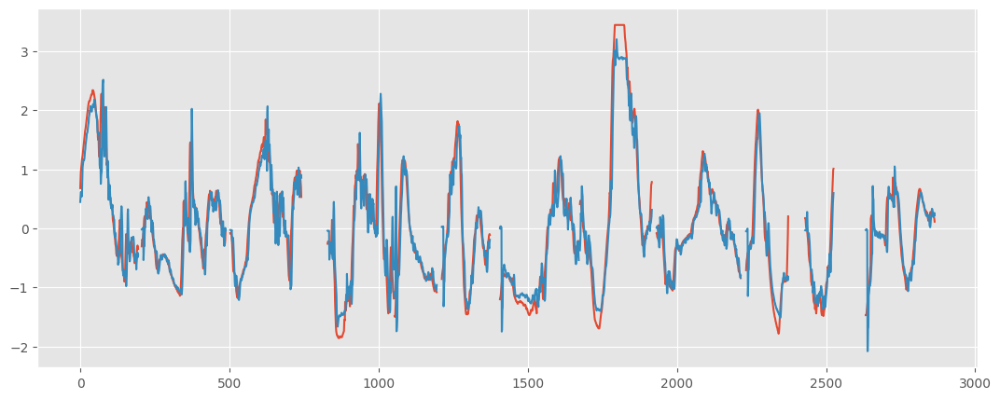

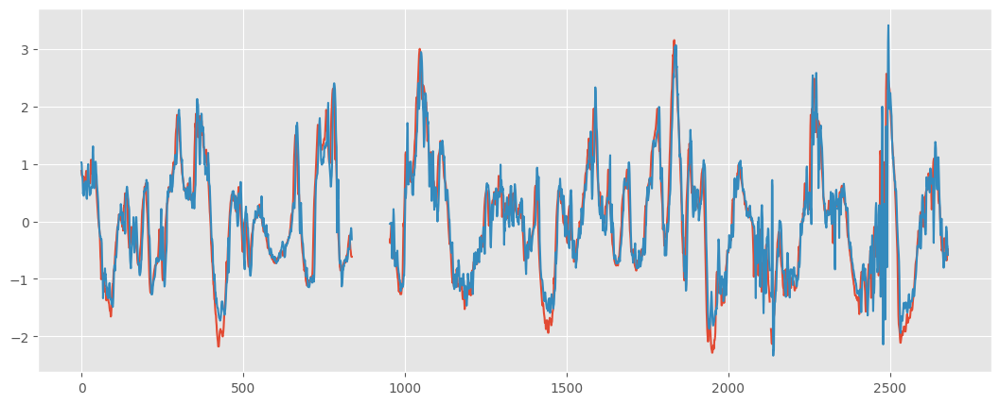

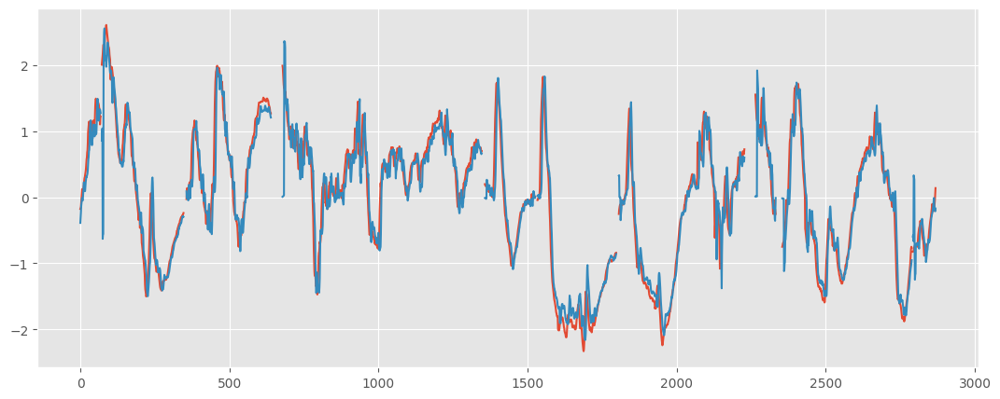

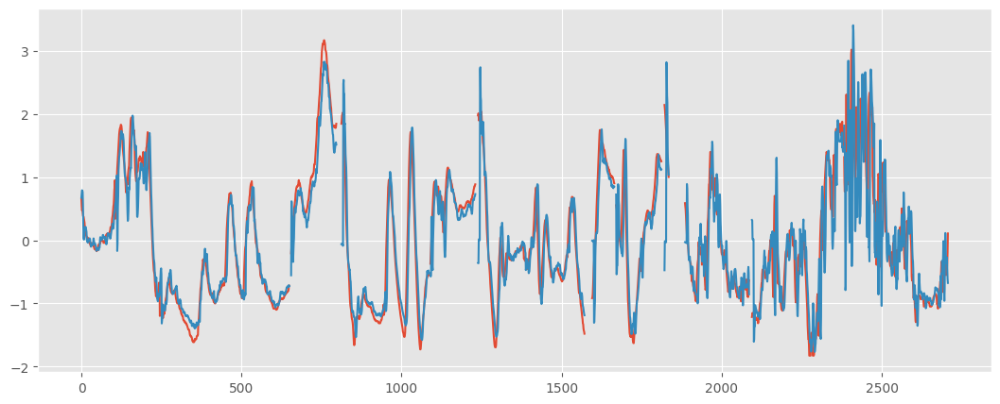

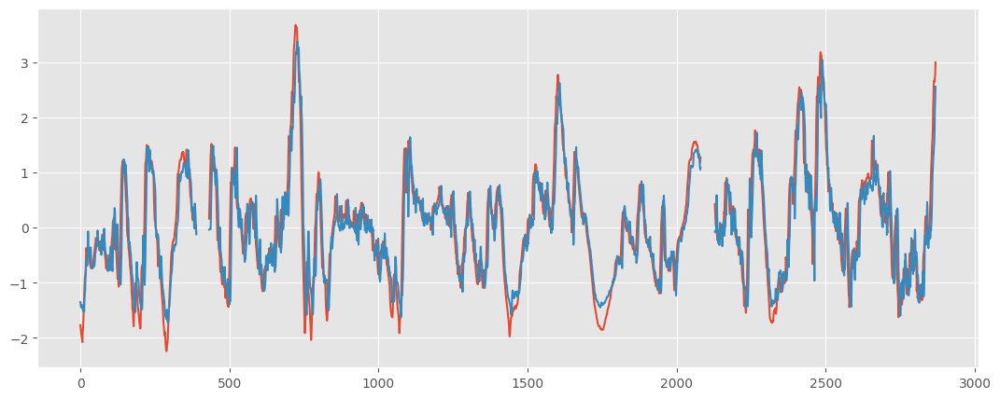

...

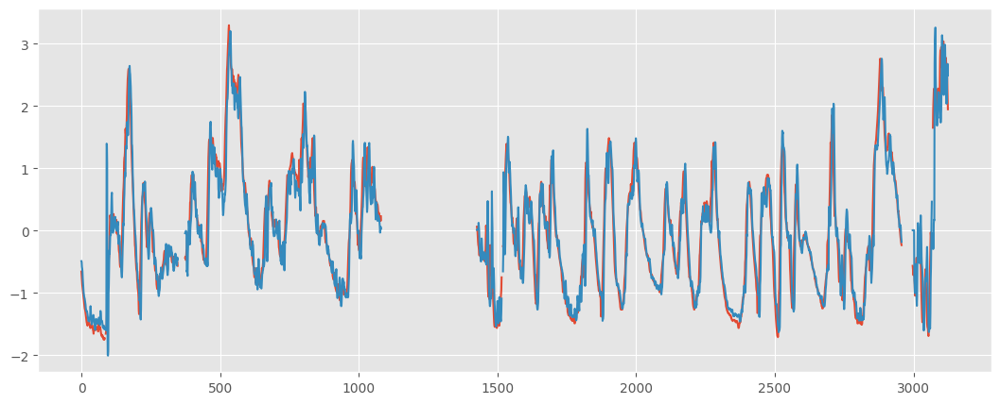

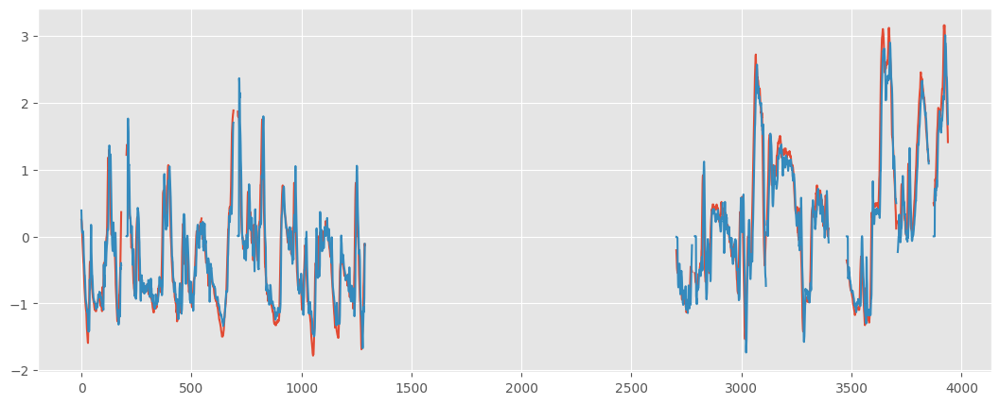

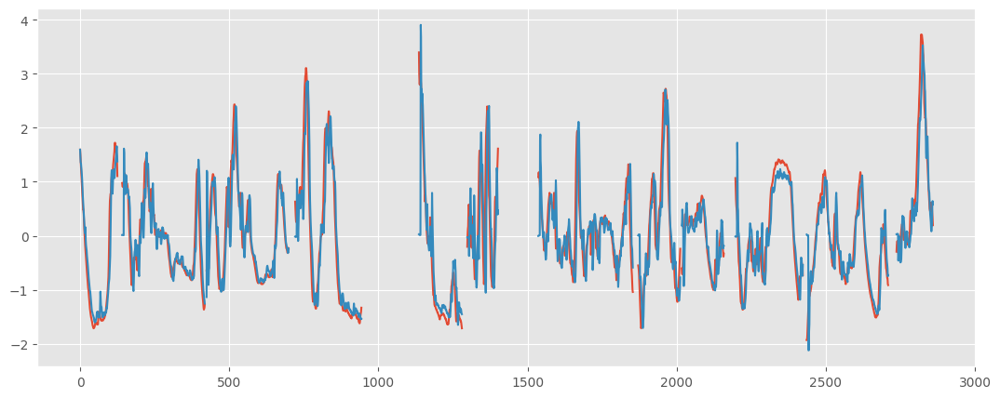

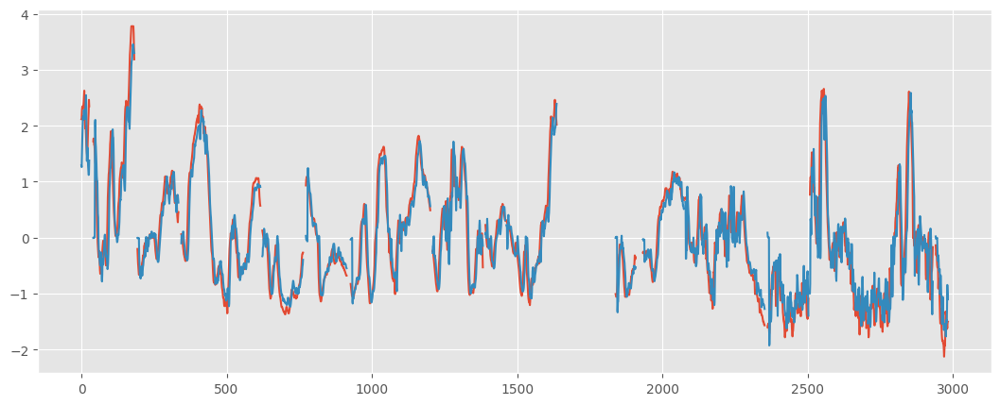

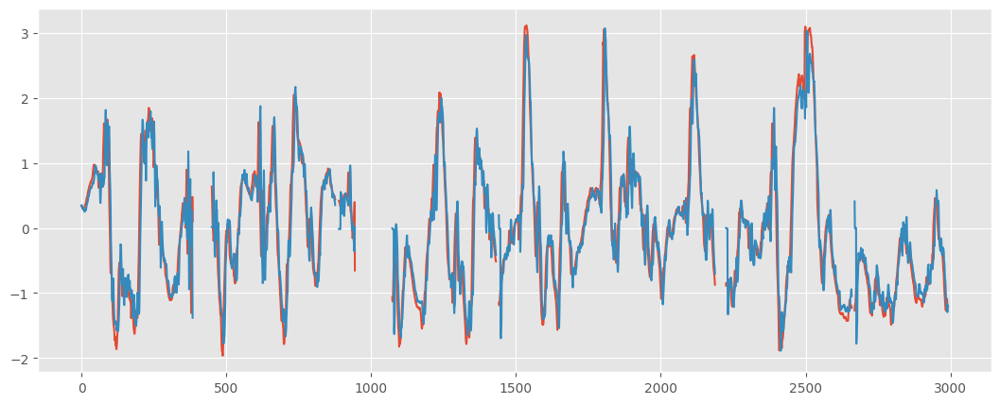

In [24]:
# index =4
for index in range(12):
    patient1_target = [sublist[index] for sublist in targets]
    patient1_output = [sublist[index]  for sublist in outputs]
    # patient1_output = outputs_all_batches[index]
    # patient1_target = targets_all_batches[index]

    # print(list(abs_patients_errors_PHs[6].values())[index])
    # print(list(squared_patients_errors_PHs[6].values())[index])

    plt.figure(figsize=(13,5))
    plt.plot(patient1_target)
    plt.plot(patient1_output)
    plt.show()

In [280]:
mae, rmse, each_patient_mae, each_patient_rmse= evaluate_test(model_all_train,test_loader, device ,scaler, mask_value, model_type = model_type)


d:\NISC\Glucose biomedical\shared layer project\biomedical-env\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
d:\NISC\Glucose biomedical\shared layer project\biomedical-env\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
d:\NISC\Glucose biomedical\shared layer project\biomedical-env\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
d:\NISC\Glucose biomedical\shared layer project\biomedical-env\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
d:\NISC\Glucose biomedical\shared layer project\biomedical-env\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, 

In [ ]:
squared_patients_errors_PHs_df = pd.DataFrame()
for i, patient_rmse in enumerate(squared_patients_errors_PHs.values()):
    # abs_patients_errors_PHs_df[i] = patient_mae
    squared_patients_errors_PHs_df[prediction_horizons[i]] = patient_rmse
    # print(patient_mae)
squared_patients_errors_PHs_df.loc[len(squared_patients_errors_PHs_df.index)] = list(RMSE_Patients_PHs.values())
# abs_patients_errors_PHs_df = abs_patients_errors_PHs_df.append(MAE_Patients_PHs,  ignore_index=True)
squared_patients_errors_PHs_df.index = patients_list+["Mean"]

squared_patients_errors_PHs_df

In [247]:
# test_list = [(patient1_target[i] - patient1_output[i])**2 if type(patient1_target[i]) != type(None) else None for i in range(len(patient1_target))]
# filtered_data = [x for x in test_list if x is not None]
# np.sqrt(np.mean(filtered_data))

In [20]:
summary(model, input_size=[(64, 1), (64, 1)])

Shape before output layer: torch.Size([2, 128])
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1               [-1, 64, 30]             320
               GRU-2  [[-1, 30, 128], [-1, 2, 128]]               0
            Conv1d-3               [-1, 64, 30]             320
               GRU-4  [[-1, 30, 128], [-1, 2, 128]]               0
            Linear-5                   [-1, 64]           8,256
           Dropout-6                   [-1, 64]               0
            Linear-7                   [-1, 64]           8,256
           Dropout-8                   [-1, 64]               0
            Linear-9                   [-1, 12]           1,548
Total params: 18,700
Trainable params: 18,700
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.02
Forward/backward pass size (MB): 14.97
Params size (MB): 0.07
Estimated Total Size

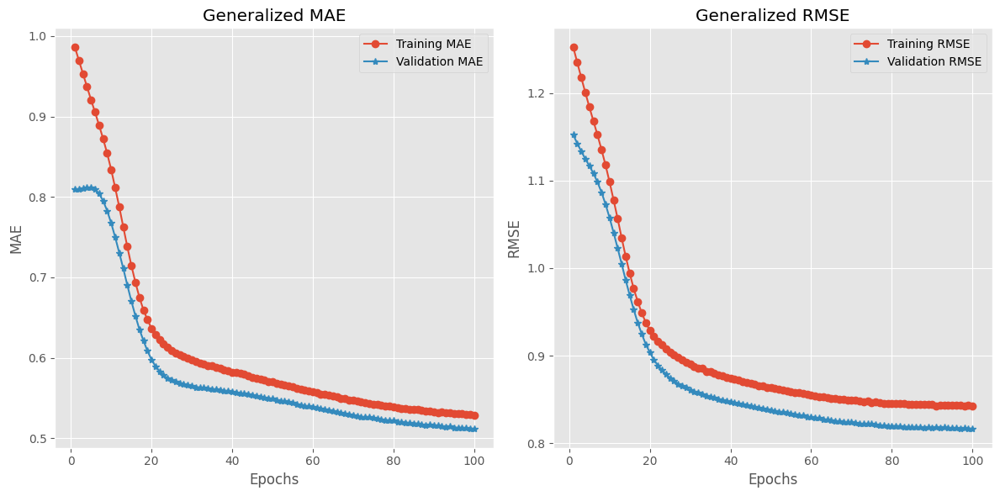

In [10]:
plot_loss_curves(history)

In [12]:
model_all_train = SharedLayerModel(input_shape =input_shape , output_shape=output_shape) 
model_all_train = model_all_train.to(device)
model_all_train, history2 = train_model(model_all_train, all_train_loader, val_loader = test_loader, epochs=100, learning_rate=0.00001, model_type = 'shared-layer')

Epoch 1/100: 100%|██████████| 213/213 [00:11<00:00, 18.93batch/s, mae_loss=0.873]


Epoch [1/100], Training MAE: 0.9355, Training RMSE: 1.2276
Epoch [1/100], Validation MAE: 0.7535, Validation RMSE: 1.0902


Epoch 2/100: 100%|██████████| 213/213 [00:11<00:00, 18.22batch/s, mae_loss=0.908]


Epoch [2/100], Training MAE: 0.9187, Training RMSE: 1.2079
Epoch [2/100], Validation MAE: 0.7512, Validation RMSE: 1.0770


Epoch 3/100: 100%|██████████| 213/213 [00:12<00:00, 17.67batch/s, mae_loss=0.905]


Epoch [3/100], Training MAE: 0.9019, Training RMSE: 1.1885
Epoch [3/100], Validation MAE: 0.7469, Validation RMSE: 1.0636


Epoch 4/100: 100%|██████████| 213/213 [00:11<00:00, 18.14batch/s, mae_loss=0.879]


Epoch [4/100], Training MAE: 0.8839, Training RMSE: 1.1679
Epoch [4/100], Validation MAE: 0.7402, Validation RMSE: 1.0491


Epoch 5/100: 100%|██████████| 213/213 [00:11<00:00, 18.16batch/s, mae_loss=0.83] 


Epoch [5/100], Training MAE: 0.8637, Training RMSE: 1.1460
Epoch [5/100], Validation MAE: 0.7284, Validation RMSE: 1.0323


Epoch 6/100: 100%|██████████| 213/213 [00:11<00:00, 18.74batch/s, mae_loss=0.875]


Epoch [6/100], Training MAE: 0.8405, Training RMSE: 1.1222
Epoch [6/100], Validation MAE: 0.7098, Validation RMSE: 1.0114


Epoch 7/100: 100%|██████████| 213/213 [00:11<00:00, 18.38batch/s, mae_loss=0.788]


Epoch [7/100], Training MAE: 0.8129, Training RMSE: 1.0947
Epoch [7/100], Validation MAE: 0.6860, Validation RMSE: 0.9871


Epoch 8/100: 100%|██████████| 213/213 [00:11<00:00, 18.25batch/s, mae_loss=0.759]


Epoch [8/100], Training MAE: 0.7805, Training RMSE: 1.0640
Epoch [8/100], Validation MAE: 0.6578, Validation RMSE: 0.9600


Epoch 9/100: 100%|██████████| 213/213 [00:11<00:00, 18.49batch/s, mae_loss=0.727]


Epoch [9/100], Training MAE: 0.7453, Training RMSE: 1.0321
Epoch [9/100], Validation MAE: 0.6258, Validation RMSE: 0.9309


Epoch 10/100: 100%|██████████| 213/213 [00:13<00:00, 15.51batch/s, mae_loss=0.682]


Epoch [10/100], Training MAE: 0.7094, Training RMSE: 1.0009
Epoch [10/100], Validation MAE: 0.5958, Validation RMSE: 0.9043


Epoch 11/100: 100%|██████████| 213/213 [00:11<00:00, 18.52batch/s, mae_loss=0.68] 


Epoch [11/100], Training MAE: 0.6759, Training RMSE: 0.9721
Epoch [11/100], Validation MAE: 0.5681, Validation RMSE: 0.8806


Epoch 12/100: 100%|██████████| 213/213 [00:11<00:00, 18.93batch/s, mae_loss=0.588]


Epoch [12/100], Training MAE: 0.6482, Training RMSE: 0.9495
Epoch [12/100], Validation MAE: 0.5465, Validation RMSE: 0.8625


Epoch 13/100: 100%|██████████| 213/213 [00:11<00:00, 17.78batch/s, mae_loss=0.588]


Epoch [13/100], Training MAE: 0.6258, Training RMSE: 0.9308
Epoch [13/100], Validation MAE: 0.5293, Validation RMSE: 0.8488


Epoch 14/100: 100%|██████████| 213/213 [00:10<00:00, 19.65batch/s, mae_loss=0.608]


Epoch [14/100], Training MAE: 0.6113, Training RMSE: 0.9190
Epoch [14/100], Validation MAE: 0.5179, Validation RMSE: 0.8400


Epoch 15/100: 100%|██████████| 213/213 [00:11<00:00, 18.89batch/s, mae_loss=0.614]


Epoch [15/100], Training MAE: 0.6007, Training RMSE: 0.9097
Epoch [15/100], Validation MAE: 0.5091, Validation RMSE: 0.8324


Epoch 16/100: 100%|██████████| 213/213 [00:11<00:00, 18.89batch/s, mae_loss=0.632]


Epoch [16/100], Training MAE: 0.5940, Training RMSE: 0.9036
Epoch [16/100], Validation MAE: 0.5047, Validation RMSE: 0.8284


Epoch 17/100: 100%|██████████| 213/213 [00:11<00:00, 18.14batch/s, mae_loss=0.547]


Epoch [17/100], Training MAE: 0.5895, Training RMSE: 0.8999
Epoch [17/100], Validation MAE: 0.5007, Validation RMSE: 0.8245


Epoch 18/100: 100%|██████████| 213/213 [00:11<00:00, 18.23batch/s, mae_loss=0.608]


Epoch [18/100], Training MAE: 0.5859, Training RMSE: 0.8966
Epoch [18/100], Validation MAE: 0.4982, Validation RMSE: 0.8211


Epoch 19/100: 100%|██████████| 213/213 [00:10<00:00, 19.39batch/s, mae_loss=0.576]


Epoch [19/100], Training MAE: 0.5833, Training RMSE: 0.8938
Epoch [19/100], Validation MAE: 0.4963, Validation RMSE: 0.8195


Epoch 20/100: 100%|██████████| 213/213 [00:10<00:00, 19.48batch/s, mae_loss=0.61] 


Epoch [20/100], Training MAE: 0.5811, Training RMSE: 0.8919
Epoch [20/100], Validation MAE: 0.4950, Validation RMSE: 0.8171


Epoch 21/100: 100%|██████████| 213/213 [00:10<00:00, 19.75batch/s, mae_loss=0.549]


Epoch [21/100], Training MAE: 0.5784, Training RMSE: 0.8888
Epoch [21/100], Validation MAE: 0.4932, Validation RMSE: 0.8149


Epoch 22/100: 100%|██████████| 213/213 [00:11<00:00, 19.18batch/s, mae_loss=0.576]


Epoch [22/100], Training MAE: 0.5772, Training RMSE: 0.8876
Epoch [22/100], Validation MAE: 0.4917, Validation RMSE: 0.8141


Epoch 23/100: 100%|██████████| 213/213 [00:11<00:00, 18.69batch/s, mae_loss=0.525]


Epoch [23/100], Training MAE: 0.5747, Training RMSE: 0.8859
Epoch [23/100], Validation MAE: 0.4911, Validation RMSE: 0.8137


Epoch 24/100: 100%|██████████| 213/213 [00:11<00:00, 17.77batch/s, mae_loss=0.543]


Epoch [24/100], Training MAE: 0.5732, Training RMSE: 0.8849
Epoch [24/100], Validation MAE: 0.4888, Validation RMSE: 0.8111


Epoch 25/100: 100%|██████████| 213/213 [00:11<00:00, 18.85batch/s, mae_loss=0.561]


Epoch [25/100], Training MAE: 0.5723, Training RMSE: 0.8840
Epoch [25/100], Validation MAE: 0.4880, Validation RMSE: 0.8106


Epoch 26/100: 100%|██████████| 213/213 [00:11<00:00, 18.48batch/s, mae_loss=0.609]


Epoch [26/100], Training MAE: 0.5704, Training RMSE: 0.8824
Epoch [26/100], Validation MAE: 0.4863, Validation RMSE: 0.8094


Epoch 27/100: 100%|██████████| 213/213 [00:11<00:00, 19.19batch/s, mae_loss=0.574]


Epoch [27/100], Training MAE: 0.5686, Training RMSE: 0.8810
Epoch [27/100], Validation MAE: 0.4852, Validation RMSE: 0.8080


Epoch 28/100: 100%|██████████| 213/213 [00:12<00:00, 17.70batch/s, mae_loss=0.584]


Epoch [28/100], Training MAE: 0.5659, Training RMSE: 0.8783
Epoch [28/100], Validation MAE: 0.4825, Validation RMSE: 0.8064


Epoch 29/100: 100%|██████████| 213/213 [00:11<00:00, 18.81batch/s, mae_loss=0.599]


Epoch [29/100], Training MAE: 0.5654, Training RMSE: 0.8787
Epoch [29/100], Validation MAE: 0.4820, Validation RMSE: 0.8064


Epoch 30/100: 100%|██████████| 213/213 [00:11<00:00, 18.84batch/s, mae_loss=0.532]


Epoch [30/100], Training MAE: 0.5634, Training RMSE: 0.8772
Epoch [30/100], Validation MAE: 0.4816, Validation RMSE: 0.8057


Epoch 31/100: 100%|██████████| 213/213 [00:11<00:00, 18.78batch/s, mae_loss=0.608]


Epoch [31/100], Training MAE: 0.5615, Training RMSE: 0.8753
Epoch [31/100], Validation MAE: 0.4796, Validation RMSE: 0.8042


Epoch 32/100: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.61] 


Epoch [32/100], Training MAE: 0.5601, Training RMSE: 0.8746
Epoch [32/100], Validation MAE: 0.4779, Validation RMSE: 0.8024


Epoch 33/100: 100%|██████████| 213/213 [00:11<00:00, 18.29batch/s, mae_loss=0.572]


Epoch [33/100], Training MAE: 0.5585, Training RMSE: 0.8737
Epoch [33/100], Validation MAE: 0.4777, Validation RMSE: 0.8023


Epoch 34/100: 100%|██████████| 213/213 [00:10<00:00, 19.43batch/s, mae_loss=0.515]


Epoch [34/100], Training MAE: 0.5571, Training RMSE: 0.8728
Epoch [34/100], Validation MAE: 0.4759, Validation RMSE: 0.8011


Epoch 35/100: 100%|██████████| 213/213 [00:11<00:00, 18.99batch/s, mae_loss=0.564]


Epoch [35/100], Training MAE: 0.5559, Training RMSE: 0.8717
Epoch [35/100], Validation MAE: 0.4749, Validation RMSE: 0.8008


Epoch 36/100: 100%|██████████| 213/213 [00:10<00:00, 19.64batch/s, mae_loss=0.554]


Epoch [36/100], Training MAE: 0.5539, Training RMSE: 0.8706
Epoch [36/100], Validation MAE: 0.4734, Validation RMSE: 0.7994


Epoch 37/100: 100%|██████████| 213/213 [00:11<00:00, 19.24batch/s, mae_loss=0.57] 


Epoch [37/100], Training MAE: 0.5518, Training RMSE: 0.8695
Epoch [37/100], Validation MAE: 0.4706, Validation RMSE: 0.7971


Epoch 38/100: 100%|██████████| 213/213 [00:11<00:00, 18.55batch/s, mae_loss=0.554]


Epoch [38/100], Training MAE: 0.5502, Training RMSE: 0.8679
Epoch [38/100], Validation MAE: 0.4690, Validation RMSE: 0.7967


Epoch 39/100: 100%|██████████| 213/213 [00:11<00:00, 19.10batch/s, mae_loss=0.533]


Epoch [39/100], Training MAE: 0.5492, Training RMSE: 0.8676
Epoch [39/100], Validation MAE: 0.4687, Validation RMSE: 0.7957


Epoch 40/100: 100%|██████████| 213/213 [00:10<00:00, 19.63batch/s, mae_loss=0.524]


Epoch [40/100], Training MAE: 0.5470, Training RMSE: 0.8660
Epoch [40/100], Validation MAE: 0.4681, Validation RMSE: 0.7959


Epoch 41/100: 100%|██████████| 213/213 [00:11<00:00, 19.30batch/s, mae_loss=0.514]


Epoch [41/100], Training MAE: 0.5453, Training RMSE: 0.8650
Epoch [41/100], Validation MAE: 0.4654, Validation RMSE: 0.7935


Epoch 42/100: 100%|██████████| 213/213 [00:11<00:00, 19.14batch/s, mae_loss=0.539]


Epoch [42/100], Training MAE: 0.5445, Training RMSE: 0.8644
Epoch [42/100], Validation MAE: 0.4645, Validation RMSE: 0.7936


Epoch 43/100: 100%|██████████| 213/213 [00:11<00:00, 18.40batch/s, mae_loss=0.528]


Epoch [43/100], Training MAE: 0.5423, Training RMSE: 0.8635
Epoch [43/100], Validation MAE: 0.4629, Validation RMSE: 0.7923


Epoch 44/100: 100%|██████████| 213/213 [00:11<00:00, 19.30batch/s, mae_loss=0.593]


Epoch [44/100], Training MAE: 0.5412, Training RMSE: 0.8630
Epoch [44/100], Validation MAE: 0.4620, Validation RMSE: 0.7926


Epoch 45/100: 100%|██████████| 213/213 [00:10<00:00, 19.62batch/s, mae_loss=0.499]


Epoch [45/100], Training MAE: 0.5396, Training RMSE: 0.8616
Epoch [45/100], Validation MAE: 0.4600, Validation RMSE: 0.7903


Epoch 46/100: 100%|██████████| 213/213 [00:11<00:00, 19.20batch/s, mae_loss=0.538]


Epoch [46/100], Training MAE: 0.5379, Training RMSE: 0.8606
Epoch [46/100], Validation MAE: 0.4591, Validation RMSE: 0.7907


Epoch 47/100: 100%|██████████| 213/213 [00:11<00:00, 18.86batch/s, mae_loss=0.576]


Epoch [47/100], Training MAE: 0.5366, Training RMSE: 0.8599
Epoch [47/100], Validation MAE: 0.4572, Validation RMSE: 0.7891


Epoch 48/100: 100%|██████████| 213/213 [00:11<00:00, 18.19batch/s, mae_loss=0.499]


Epoch [48/100], Training MAE: 0.5347, Training RMSE: 0.8596
Epoch [48/100], Validation MAE: 0.4566, Validation RMSE: 0.7891


Epoch 49/100: 100%|██████████| 213/213 [00:10<00:00, 19.57batch/s, mae_loss=0.538]


Epoch [49/100], Training MAE: 0.5333, Training RMSE: 0.8583
Epoch [49/100], Validation MAE: 0.4551, Validation RMSE: 0.7884


Epoch 50/100: 100%|██████████| 213/213 [00:11<00:00, 19.02batch/s, mae_loss=0.524]


Epoch [50/100], Training MAE: 0.5324, Training RMSE: 0.8580
Epoch [50/100], Validation MAE: 0.4535, Validation RMSE: 0.7870


Epoch 51/100: 100%|██████████| 213/213 [00:10<00:00, 19.38batch/s, mae_loss=0.513]


Epoch [51/100], Training MAE: 0.5302, Training RMSE: 0.8570
Epoch [51/100], Validation MAE: 0.4524, Validation RMSE: 0.7861


Epoch 52/100: 100%|██████████| 213/213 [00:11<00:00, 19.21batch/s, mae_loss=0.553]


Epoch [52/100], Training MAE: 0.5295, Training RMSE: 0.8572
Epoch [52/100], Validation MAE: 0.4514, Validation RMSE: 0.7858


Epoch 53/100: 100%|██████████| 213/213 [00:11<00:00, 18.80batch/s, mae_loss=0.593]


Epoch [53/100], Training MAE: 0.5275, Training RMSE: 0.8555
Epoch [53/100], Validation MAE: 0.4500, Validation RMSE: 0.7853


Epoch 54/100: 100%|██████████| 213/213 [00:11<00:00, 19.16batch/s, mae_loss=0.578]


Epoch [54/100], Training MAE: 0.5271, Training RMSE: 0.8558
Epoch [54/100], Validation MAE: 0.4489, Validation RMSE: 0.7848


Epoch 55/100: 100%|██████████| 213/213 [00:10<00:00, 19.64batch/s, mae_loss=0.533]


Epoch [55/100], Training MAE: 0.5254, Training RMSE: 0.8547
Epoch [55/100], Validation MAE: 0.4475, Validation RMSE: 0.7842


Epoch 56/100: 100%|██████████| 213/213 [00:11<00:00, 19.19batch/s, mae_loss=0.558]


Epoch [56/100], Training MAE: 0.5241, Training RMSE: 0.8546
Epoch [56/100], Validation MAE: 0.4464, Validation RMSE: 0.7850


Epoch 57/100: 100%|██████████| 213/213 [00:10<00:00, 19.69batch/s, mae_loss=0.517]


Epoch [57/100], Training MAE: 0.5236, Training RMSE: 0.8549
Epoch [57/100], Validation MAE: 0.4454, Validation RMSE: 0.7833


Epoch 58/100: 100%|██████████| 213/213 [00:11<00:00, 17.94batch/s, mae_loss=0.546]


Epoch [58/100], Training MAE: 0.5219, Training RMSE: 0.8539
Epoch [58/100], Validation MAE: 0.4440, Validation RMSE: 0.7824


Epoch 59/100: 100%|██████████| 213/213 [00:11<00:00, 19.08batch/s, mae_loss=0.533]


Epoch [59/100], Training MAE: 0.5212, Training RMSE: 0.8542
Epoch [59/100], Validation MAE: 0.4437, Validation RMSE: 0.7829


Epoch 60/100: 100%|██████████| 213/213 [00:10<00:00, 19.40batch/s, mae_loss=0.5]  


Epoch [60/100], Training MAE: 0.5203, Training RMSE: 0.8528
Epoch [60/100], Validation MAE: 0.4423, Validation RMSE: 0.7821


Epoch 61/100: 100%|██████████| 213/213 [00:11<00:00, 19.30batch/s, mae_loss=0.503]


Epoch [61/100], Training MAE: 0.5196, Training RMSE: 0.8530
Epoch [61/100], Validation MAE: 0.4415, Validation RMSE: 0.7818


Epoch 62/100: 100%|██████████| 213/213 [00:10<00:00, 19.58batch/s, mae_loss=0.487]


Epoch [62/100], Training MAE: 0.5191, Training RMSE: 0.8531
Epoch [62/100], Validation MAE: 0.4408, Validation RMSE: 0.7809


Epoch 63/100: 100%|██████████| 213/213 [00:11<00:00, 18.38batch/s, mae_loss=0.567]


Epoch [63/100], Training MAE: 0.5182, Training RMSE: 0.8529
Epoch [63/100], Validation MAE: 0.4402, Validation RMSE: 0.7814


Epoch 64/100: 100%|██████████| 213/213 [00:10<00:00, 19.70batch/s, mae_loss=0.543]


Epoch [64/100], Training MAE: 0.5167, Training RMSE: 0.8517
Epoch [64/100], Validation MAE: 0.4396, Validation RMSE: 0.7814


Epoch 65/100: 100%|██████████| 213/213 [00:11<00:00, 19.12batch/s, mae_loss=0.526]


Epoch [65/100], Training MAE: 0.5162, Training RMSE: 0.8523
Epoch [65/100], Validation MAE: 0.4385, Validation RMSE: 0.7804


Epoch 66/100: 100%|██████████| 213/213 [00:10<00:00, 19.41batch/s, mae_loss=0.501]


Epoch [66/100], Training MAE: 0.5160, Training RMSE: 0.8523
Epoch [66/100], Validation MAE: 0.4380, Validation RMSE: 0.7814


Epoch 67/100: 100%|██████████| 213/213 [00:11<00:00, 19.32batch/s, mae_loss=0.429]


Epoch [67/100], Training MAE: 0.5154, Training RMSE: 0.8524
Epoch [67/100], Validation MAE: 0.4375, Validation RMSE: 0.7807


Epoch 68/100: 100%|██████████| 213/213 [00:11<00:00, 18.87batch/s, mae_loss=0.523]


Epoch [68/100], Training MAE: 0.5147, Training RMSE: 0.8516
Epoch [68/100], Validation MAE: 0.4359, Validation RMSE: 0.7796


Epoch 69/100: 100%|██████████| 213/213 [00:11<00:00, 19.17batch/s, mae_loss=0.492]


Epoch [69/100], Training MAE: 0.5140, Training RMSE: 0.8521
Epoch [69/100], Validation MAE: 0.4352, Validation RMSE: 0.7798


Epoch 70/100: 100%|██████████| 213/213 [00:10<00:00, 19.60batch/s, mae_loss=0.544]


Epoch [70/100], Training MAE: 0.5135, Training RMSE: 0.8515
Epoch [70/100], Validation MAE: 0.4344, Validation RMSE: 0.7797


Epoch 71/100: 100%|██████████| 213/213 [00:12<00:00, 16.42batch/s, mae_loss=0.506]


Epoch [71/100], Training MAE: 0.5131, Training RMSE: 0.8517
Epoch [71/100], Validation MAE: 0.4340, Validation RMSE: 0.7786


Epoch 72/100: 100%|██████████| 213/213 [00:11<00:00, 18.59batch/s, mae_loss=0.524]


Epoch [72/100], Training MAE: 0.5127, Training RMSE: 0.8520
Epoch [72/100], Validation MAE: 0.4337, Validation RMSE: 0.7793


Epoch 73/100: 100%|██████████| 213/213 [00:12<00:00, 17.44batch/s, mae_loss=0.523]


Epoch [73/100], Training MAE: 0.5120, Training RMSE: 0.8516
Epoch [73/100], Validation MAE: 0.4338, Validation RMSE: 0.7797


Epoch 74/100: 100%|██████████| 213/213 [00:11<00:00, 18.42batch/s, mae_loss=0.471]


Epoch [74/100], Training MAE: 0.5119, Training RMSE: 0.8519
Epoch [74/100], Validation MAE: 0.4329, Validation RMSE: 0.7794


Epoch 75/100: 100%|██████████| 213/213 [00:11<00:00, 18.83batch/s, mae_loss=0.496]


Epoch [75/100], Training MAE: 0.5113, Training RMSE: 0.8518
Epoch [75/100], Validation MAE: 0.4323, Validation RMSE: 0.7795


Epoch 76/100: 100%|██████████| 213/213 [00:13<00:00, 15.71batch/s, mae_loss=0.486]


Epoch [76/100], Training MAE: 0.5112, Training RMSE: 0.8517
Epoch [76/100], Validation MAE: 0.4320, Validation RMSE: 0.7798


Epoch 77/100: 100%|██████████| 213/213 [00:13<00:00, 15.59batch/s, mae_loss=0.604]


Epoch [77/100], Training MAE: 0.5107, Training RMSE: 0.8519
Epoch [77/100], Validation MAE: 0.4321, Validation RMSE: 0.7787


Epoch 78/100: 100%|██████████| 213/213 [00:12<00:00, 16.62batch/s, mae_loss=0.473]


Epoch [78/100], Training MAE: 0.5100, Training RMSE: 0.8507
Epoch [78/100], Validation MAE: 0.4307, Validation RMSE: 0.7786


Epoch 79/100: 100%|██████████| 213/213 [00:11<00:00, 18.55batch/s, mae_loss=0.552]


Epoch [79/100], Training MAE: 0.5100, Training RMSE: 0.8518
Epoch [79/100], Validation MAE: 0.4304, Validation RMSE: 0.7788


Epoch 80/100: 100%|██████████| 213/213 [00:11<00:00, 18.22batch/s, mae_loss=0.562]


Epoch [80/100], Training MAE: 0.5099, Training RMSE: 0.8520
Epoch [80/100], Validation MAE: 0.4302, Validation RMSE: 0.7789


Epoch 81/100: 100%|██████████| 213/213 [00:11<00:00, 18.61batch/s, mae_loss=0.56] 


Epoch [81/100], Training MAE: 0.5099, Training RMSE: 0.8515
Epoch [81/100], Validation MAE: 0.4301, Validation RMSE: 0.7793


Epoch 82/100: 100%|██████████| 213/213 [00:11<00:00, 18.40batch/s, mae_loss=0.519]


Epoch [82/100], Training MAE: 0.5090, Training RMSE: 0.8512
Epoch [82/100], Validation MAE: 0.4299, Validation RMSE: 0.7796


Epoch 83/100: 100%|██████████| 213/213 [00:11<00:00, 18.06batch/s, mae_loss=0.504]


Epoch [83/100], Training MAE: 0.5090, Training RMSE: 0.8520
Epoch [83/100], Validation MAE: 0.4288, Validation RMSE: 0.7779


Epoch 84/100: 100%|██████████| 213/213 [00:11<00:00, 18.09batch/s, mae_loss=0.497]


Epoch [84/100], Training MAE: 0.5087, Training RMSE: 0.8515
Epoch [84/100], Validation MAE: 0.4285, Validation RMSE: 0.7780


Epoch 85/100: 100%|██████████| 213/213 [00:11<00:00, 17.93batch/s, mae_loss=0.533]


Epoch [85/100], Training MAE: 0.5085, Training RMSE: 0.8516
Epoch [85/100], Validation MAE: 0.4291, Validation RMSE: 0.7783


Epoch 86/100: 100%|██████████| 213/213 [00:11<00:00, 18.63batch/s, mae_loss=0.523]


Epoch [86/100], Training MAE: 0.5081, Training RMSE: 0.8512
Epoch [86/100], Validation MAE: 0.4291, Validation RMSE: 0.7792


Epoch 87/100: 100%|██████████| 213/213 [00:11<00:00, 17.94batch/s, mae_loss=0.492]


Epoch [87/100], Training MAE: 0.5081, Training RMSE: 0.8513
Epoch [87/100], Validation MAE: 0.4287, Validation RMSE: 0.7785


Epoch 88/100: 100%|██████████| 213/213 [00:11<00:00, 18.65batch/s, mae_loss=0.474]


Epoch [88/100], Training MAE: 0.5081, Training RMSE: 0.8512
Epoch [88/100], Validation MAE: 0.4283, Validation RMSE: 0.7792


Epoch 89/100: 100%|██████████| 213/213 [00:11<00:00, 18.19batch/s, mae_loss=0.496]


Epoch [89/100], Training MAE: 0.5074, Training RMSE: 0.8516
Epoch [89/100], Validation MAE: 0.4282, Validation RMSE: 0.7783


Epoch 90/100: 100%|██████████| 213/213 [00:11<00:00, 18.48batch/s, mae_loss=0.472]


Epoch [90/100], Training MAE: 0.5075, Training RMSE: 0.8511
Epoch [90/100], Validation MAE: 0.4286, Validation RMSE: 0.7787


Epoch 91/100: 100%|██████████| 213/213 [00:11<00:00, 18.11batch/s, mae_loss=0.549]


Epoch [91/100], Training MAE: 0.5070, Training RMSE: 0.8507
Epoch [91/100], Validation MAE: 0.4276, Validation RMSE: 0.7777


Epoch 92/100: 100%|██████████| 213/213 [00:11<00:00, 17.82batch/s, mae_loss=0.474]


Epoch [92/100], Training MAE: 0.5070, Training RMSE: 0.8512
Epoch [92/100], Validation MAE: 0.4277, Validation RMSE: 0.7781


Epoch 93/100: 100%|██████████| 213/213 [00:11<00:00, 18.28batch/s, mae_loss=0.488]


Epoch [93/100], Training MAE: 0.5068, Training RMSE: 0.8507
Epoch [93/100], Validation MAE: 0.4275, Validation RMSE: 0.7786


Epoch 94/100: 100%|██████████| 213/213 [00:11<00:00, 18.52batch/s, mae_loss=0.497]


Epoch [94/100], Training MAE: 0.5067, Training RMSE: 0.8509
Epoch [94/100], Validation MAE: 0.4280, Validation RMSE: 0.7790


Epoch 95/100: 100%|██████████| 213/213 [00:11<00:00, 18.09batch/s, mae_loss=0.492]


Epoch [95/100], Training MAE: 0.5062, Training RMSE: 0.8510
Epoch [95/100], Validation MAE: 0.4272, Validation RMSE: 0.7791


Epoch 96/100: 100%|██████████| 213/213 [00:11<00:00, 18.77batch/s, mae_loss=0.449]


Epoch [96/100], Training MAE: 0.5061, Training RMSE: 0.8509
Epoch [96/100], Validation MAE: 0.4266, Validation RMSE: 0.7778


Epoch 97/100: 100%|██████████| 213/213 [00:12<00:00, 17.34batch/s, mae_loss=0.456]


Epoch [97/100], Training MAE: 0.5060, Training RMSE: 0.8506
Epoch [97/100], Validation MAE: 0.4273, Validation RMSE: 0.7794


Epoch 98/100: 100%|██████████| 213/213 [00:11<00:00, 18.38batch/s, mae_loss=0.501]


Epoch [98/100], Training MAE: 0.5052, Training RMSE: 0.8500
Epoch [98/100], Validation MAE: 0.4269, Validation RMSE: 0.7789


Epoch 99/100: 100%|██████████| 213/213 [00:11<00:00, 18.27batch/s, mae_loss=0.524]


Epoch [99/100], Training MAE: 0.5058, Training RMSE: 0.8509
Epoch [99/100], Validation MAE: 0.4268, Validation RMSE: 0.7781


Epoch 100/100: 100%|██████████| 213/213 [00:11<00:00, 18.50batch/s, mae_loss=0.539]


Epoch [100/100], Training MAE: 0.5056, Training RMSE: 0.8507
Epoch [100/100], Validation MAE: 0.4268, Validation RMSE: 0.7791


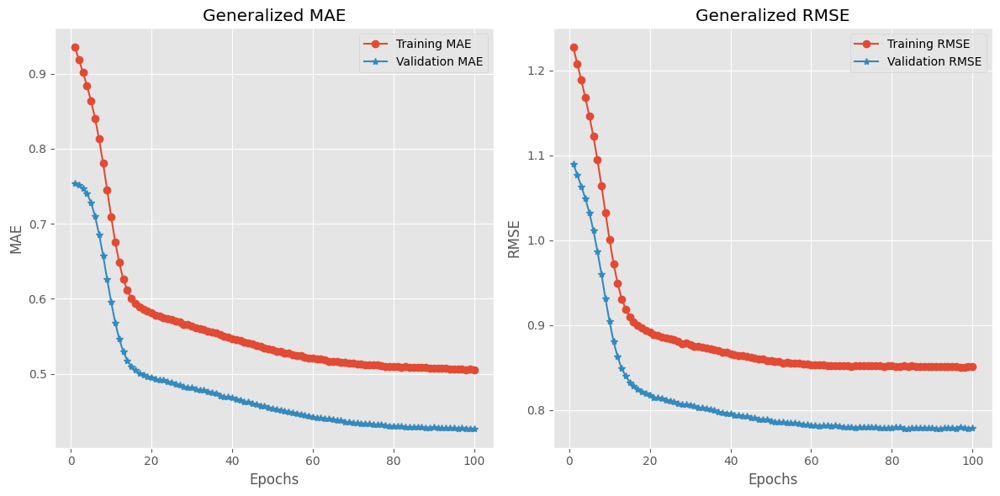

In [13]:
plot_loss_curves(history2)

In [17]:
model_all_train.eval()
abs_patients_errors, squared_patients_errors= evaluate_test(model_all_train,test_loader, device ,scaler, mask_value, model_type = model_type)


In [10]:
# model_all_train.eval()  # Set the model to evaluation mode
# criterion = nn.MSELoss(reduction='none')  # MSE without reduction (so we can manually exclude masked values)
# running_test_loss = 0.0
# valid_preds = []
# valid_targets = []
# mask_value = -2.5
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# model_all_train = model_all_train.to(device)
# rmse_patients_errors = {}
# mae_patients_errors = {}
# abs_patients_errors =  {key: [] for key in range(13)}
# squared_patients_errors =  {key: [] for key in range(13)}

# i=0
# with torch.no_grad():  # Disable gradient calculation for evaluation
#     for inputs, targets in test_loader:
#         i+=1
#         # Move data to device (GPU or CPU)
#         inputs = [inp.to(device) for inp in inputs]
#         targets = targets.to(device)
#         # print(targets[0])
#         # print(targets)
#         # Forward pass
#         outputs = model_all_train(inputs)
        
#         # # # Convert to numpy arrays for masking
#         outputs_np = outputs.cpu().numpy()
#         targets_np = targets.cpu().numpy()

#         for i in range(len(targets_np)): #this prints a list of 12 values of each patient
#             for j in range(len(targets_np[i])):
#                 if targets[i][j] != mask_value:
#                     sub_output = scaler.inverse_transform([[outputs_np[i][j]]])[0][0]
#                     sub_target = scaler.inverse_transform([[targets_np[i][j]]])[0][0]
#                     abs_patients_errors[j].append(abs(sub_output-sub_target))
#                     squared_patients_errors[j].append((sub_output-sub_target) ** 2)

In [19]:
patients_list = ['559', '563', '570', '575', '588', '591', '540', '544', '552', '567', '584', '596']
all_mae = []
all_rmse = []
for i in range(len(squared_patients_errors)-1):
    mae = np.mean(abs_patients_errors[i])
    rmse = np.sqrt(np.mean(squared_patients_errors[i]))
    all_mae.append(mae)
    all_rmse.append(rmse)
    print(f"{patients_list[i]}: RMSE: {rmse}, MAE: {mae}")
print(f"Average MAE: {np.mean(all_mae)}")
print(f"Average RMSE: {np.mean(all_rmse)}")


559: RMSE: 10.7892878791789, MAE: 8.134491284312814
563: RMSE: 15.864988953270464, MAE: 11.104398036610315
570: RMSE: 9.44019164483062, MAE: 6.730193080202984
575: RMSE: 19.179529405238775, MAE: 12.699248476284549
588: RMSE: 17.58048117944993, MAE: 12.753819199465097
591: RMSE: 17.933122740699307, MAE: 11.547077722432409
540: RMSE: 17.069087497336614, MAE: 12.689434651280996
544: RMSE: 16.087915565477807, MAE: 11.234599046075177
552: RMSE: 16.07376161696751, MAE: 12.850701684369467
567: RMSE: 26.235300465165842, MAE: 20.656728507850154
584: RMSE: 13.308503725980527, MAE: 10.743746769954258
596: RMSE: 24.78399173571093, MAE: 19.94710747708795
Average MAE: 12.590962161327182
Average RMSE: 17.02884686744227
